In [ ]:
import os
import glob
# import xml.etree.ElementTree as ET
import pandas as pd
!pip install "opencv-python-headless<4.3"
import csv
import cv2
import io
import scipy.misc
import numpy as np
import six
from six import BytesIO
import time
import glob
from IPython.display import display

import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf

%matplotlib inline

     |████████████████████████████████| 21.6 MB 374 kB/s 


In [ ]:
# Clone tensorflow models repository
!git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 3467, done.
remote: Counting objects: 100% (3467/3467), done.
remote: Compressing objects: 100% (2758/2758), done.
remote: Total 3467 (delta 1038), reused 1631 (delta 661), pack-reused 0
Receiving objects: 100% (3467/3467), 34.31 MiB | 34.24 MiB/s, done.
Resolving deltas: 100% (1038/1038), done.


In [ ]:
#install tenserflow object detection API
%%bash
sudo apt install -y protobuf-compiler
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Reading package lists...
Building dependency tree...
Reading state information...
protobuf-compiler is already the newest version (3.0.0-9.1ubuntu1).
0 upgraded, 0 newly installed, 0 to remove and 39 not upgraded.
Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1686356 sha256=114a5e4d85000baee957f318fc8ebb7ff5777c47175afd6a9d0a9b541b58460b
  Stored in directory: /tmp/pip-ephem-wheel-cache-bmxdnvle/wheels/fa/a4/d2/e9a5057e414fd46c8e543d2706cd836d64e1fcd9eccceb2329
  Created wheel for py-cpuinfo: filename=py_cpuinfo-8.0.0-py3-none-any.whl size=22257 sha256=0002a385d95c2df058527541dd5e3645068b775b96107ac7f5cf2e6fabfe28f2
  Stored in directory: /root/.cache/pip/wheels/d2/f1/1f/041add21dc9c4220157f1bd2bd6afe1f1a49524c3396b94401
  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78544 sha256=2e52aa170e42e41c549778f10c9a706991f62a76d975d3b4905a8d4615787293
  Stored in directory: /root/.cache/pip/w



  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
multiprocess 0.70.12.2 requires dill>=0.3.4, but you have dill 0.3.1.1 which is incompatible.
gym 0.17.3 requires cloudpickle<1.7.0,>=1.2.0, but you have cloudpickle 2.0.0 which is incompatible.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.27.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.


In [ ]:
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

In [ ]:
#get dataset
from google.colab import files
from google.colab import drive
drive.mount("/content/drive")
gdrive_path = "/content/drive/MyDrive/GarbageClassification/dataset_withO/"

MessageError: ignored

In [ ]:
#change the pipeline
pipeline_path = "/content/drive/MyDrive/GarbageClassification/dataset_withO/trained_model/pipeline.config"
model_path = "/content/drive/MyDrive/GarbageClassification/dataset_withO/trained_model"
num_classes = 5
batch_size = 64
fine_tune_checkpoint = '/content/drive/MyDrive/GarbageClassification/dataset_withO/pretrained_model/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpointckpt-0'
fine_tune_checkpoint_type = "detection"
use_bfloat16 = "false"
test_record_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/tfrecord/test_record.tfrecord'
train_record_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/tfrecord/train_record.tfrecord'
valid_record_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/tfrecord/train_record.tfrecord'
test_label_map_pbtxt_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/label/test_label_map.pbtxt'
train_label_map_pbtxt_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/label/train_label_map.pbtxt'
val_label_map_pbtxt_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/label/valid_label_map.pbtxt'

In [ ]:
# %load_ext tensorboard
# %tensorboard --logdir=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/trained_ssd_resnet50
%tensorboard --logdir=/content/drive/MyDrive/GarbageClassification/dataset_withO/trained_model
%reload_ext tensorboard

Reusing TensorBoard on port 6006 (pid 3206), started 15:39:15 ago. (Use '!kill 3206' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path=/content/drive/MyDrive/GarbageClassification/dataset_withO/trained_model/pipeline.config \
    --model_dir=/content/drive/MyDrive/GarbageClassification/dataset_withO/trained_model \
    --alsologtostderr \
    --num_train_steps=50000 \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps=100

Streaming output truncated to the last 5000 lines.
 'Loss/regularization_loss': 0.19984648,
 'Loss/total_loss': 0.46444735,
 'learning_rate': 0.76541823}
I0320 17:39:10.711110 140585778296704 model_lib_v2.py:708] {'Loss/classification_loss': 0.20201604,
 'Loss/localization_loss': 0.06258485,
 'Loss/regularization_loss': 0.19984648,
 'Loss/total_loss': 0.46444735,
 'learning_rate': 0.76541823}
INFO:tensorflow:Step 8500 per-step time 0.632s
I0320 17:40:13.907660 140585778296704 model_lib_v2.py:707] Step 8500 per-step time 0.632s
INFO:tensorflow:{'Loss/classification_loss': 0.17937255,
 'Loss/localization_loss': 0.06158078,
 'Loss/regularization_loss': 0.19884907,
 'Loss/total_loss': 0.4398024,
 'learning_rate': 0.7643456}
I0320 17:40:13.907938 140585778296704 model_lib_v2.py:708] {'Loss/classification_loss': 0.17937255,
 'Loss/localization_loss': 0.06158078,
 'Loss/regularization_loss': 0.19884907,
 'Loss/total_loss': 0.4398024,
 'learning_rate': 0.7643456}
INFO:tensorflow:Step 8600 per-

In [ ]:
!python /content/models/research/object_detection/exporter_main_v2.py \
  --input_type image_tensor \
  --pipeline_config_path /content/drive/MyDrive/GarbageClassification/dataset_withO/trained_model/pipeline.config \
  --trained_checkpoint_dir /content/drive/MyDrive/GarbageClassification/dataset_withO/trained_model \
  --output_directory /content/drive/MyDrive/GarbageClassification/dataset_withO/trained_model/exported_50000step

2022-03-21 07:44:55.869462: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0321 07:44:56.135658 140161537324928 deprecation.py:615] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:458: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
INFO:tensorflow:depth of addition

In [ ]:
def load_image_into_numpy_array(path):
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [ ]:
category_index = label_map_util.create_category_index_from_labelmap(test_label_map_pbtxt_path, use_display_name=True)

In [ ]:
tf.keras.backend.clear_session()
model = tf.saved_model.load(f'/content/drive/MyDrive/GarbageClassification/dataset_withO/trained_model/exported_50000step/saved_model')

In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  input_tensor = tf.convert_to_tensor(image)
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  if 'detection_masks' in output_dict:
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

metal217_jpg.rf.e5698e91edd8ce425b69bed132ba8327.jpg
True


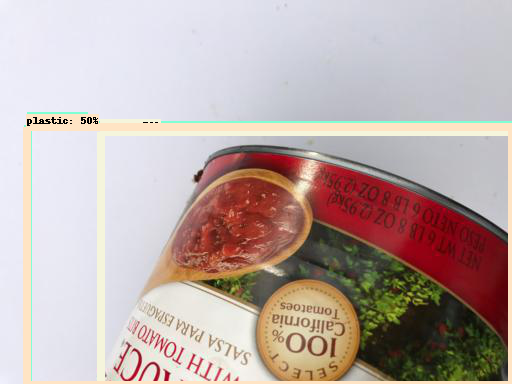

[0.62740004 0.5614103  0.5013109  0.30867296 0.24222359 0.15736657
 0.14040987 0.09681504 0.09600016 0.09213141 0.08820052 0.08609033
 0.06621571 0.06556457 0.06144841 0.05991429 0.05807565 0.05801865
 0.0568226  0.05238676 0.05090455 0.04900344 0.04878397 0.04858097
 0.04825509 0.04790466 0.04738244 0.04606178 0.04536021 0.04462986
 0.04428955 0.04378457 0.0435051  0.04335793 0.0411008  0.04040514
 0.03977189 0.03962566 0.03876493 0.03811515 0.03797155 0.03767311
 0.03761842 0.03754479 0.03752728 0.03748519 0.03731978 0.03730587
 0.03730356 0.03708889 0.03704024 0.03693732 0.03680017 0.03673559
 0.03662054 0.03629946 0.03607482 0.03569598 0.03537367 0.03525703
 0.03503694 0.03501271 0.03471834 0.03432262 0.03412399 0.03411527
 0.03406443 0.03404693 0.03380148 0.03357963 0.03307022 0.03291627
 0.03261752 0.03261751 0.03260123 0.03244917 0.03207523 0.03188504
 0.0316269  0.03129351 0.03107947 0.03105501 0.03080928 0.02986023
 0.02983255 0.02962315 0.02957558 0.02953645 0.02942068 0.0293

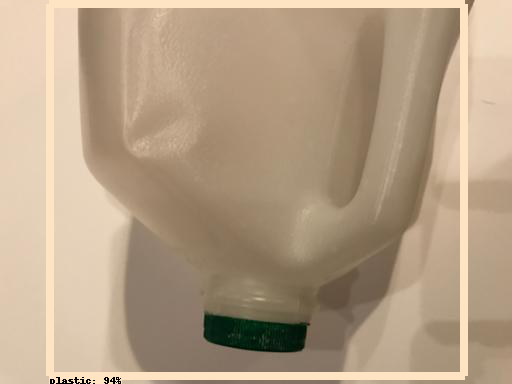

[0.94119716 0.18043756 0.13064526 0.11423727 0.09581935 0.08722307
 0.08482775 0.08073564 0.0742512  0.06580156 0.0613001  0.06012815
 0.05918927 0.05857001 0.05684692 0.05142373 0.05130928 0.04955973
 0.04864515 0.04762694 0.04610458 0.04574988 0.04534901 0.04259914
 0.04231912 0.04223219 0.04202989 0.04169229 0.04042582 0.03913618
 0.03746868 0.03713318 0.03710762 0.03652364 0.03618635 0.03592052
 0.03572631 0.0338341  0.03357726 0.03323009 0.03319307 0.03297562
 0.03243153 0.03242542 0.0320312  0.03172655 0.03168873 0.03150316
 0.03139588 0.03090142 0.03046844 0.03033954 0.03026837 0.0301242
 0.03004154 0.02992716 0.0283271  0.02819569 0.02784707 0.02734525
 0.02733472 0.02725118 0.02712606 0.02711686 0.0269663  0.02677741
 0.02660347 0.02642029 0.0262534  0.02616483 0.02611592 0.02598716
 0.02590619 0.02587234 0.02560967 0.0256062  0.0253637  0.02519998
 0.02482325 0.02451446 0.02449815 0.02434576 0.02433899 0.02430476
 0.02374473 0.02366063 0.02349068 0.02346486 0.02317372 0.02306

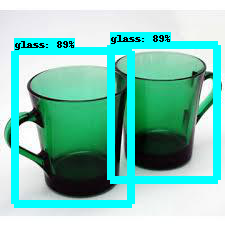

[0.8866848  0.88509667 0.28889588 0.2336481  0.17529626 0.14303355
 0.14136787 0.1366329  0.12600411 0.12305864 0.11981293 0.1193521
 0.10030003 0.095415   0.08756099 0.07925013 0.07435536 0.07052856
 0.07037667 0.0671991  0.06531258 0.06390163 0.06359158 0.06132151
 0.06069919 0.0587338  0.05806042 0.0557714  0.05574378 0.05566292
 0.05548309 0.05303742 0.05295253 0.05209378 0.05083934 0.05021793
 0.04980788 0.04945313 0.04796457 0.04741585 0.04648409 0.04606023
 0.04586449 0.04420007 0.04375356 0.04324136 0.04262261 0.04192802
 0.04020037 0.04007975 0.03987639 0.03976703 0.03950412 0.03886427
 0.03843936 0.03831197 0.03830867 0.0382362  0.03781399 0.03780491
 0.03697697 0.03673908 0.03646115 0.03608456 0.03590547 0.03570628
 0.0353644  0.03493924 0.03444157 0.03443728 0.03364664 0.03316142
 0.03306512 0.03262276 0.03249748 0.03237237 0.03213497 0.03203651
 0.0317984  0.03170551 0.03142568 0.03132781 0.03127633 0.03114
 0.03105989 0.03104222 0.0304877  0.03040954 0.03040752 0.03031291

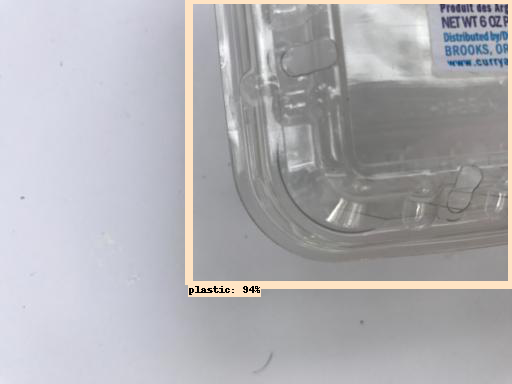

[0.94403666 0.17921107 0.14607066 0.13304795 0.10177918 0.09961861
 0.08199289 0.08041716 0.06019781 0.05690633 0.05662248 0.05306675
 0.05287604 0.05066977 0.04966475 0.04679266 0.0461697  0.04608351
 0.04393462 0.04370175 0.04355538 0.0425394  0.04199501 0.04058721
 0.04023298 0.03954225 0.03938975 0.03867725 0.03864536 0.03794905
 0.03692615 0.03655439 0.03648845 0.03629696 0.0361628  0.03604845
 0.03574546 0.03531157 0.03495356 0.03471597 0.03401371 0.03267037
 0.03254053 0.03253074 0.03248661 0.03215784 0.03201164 0.03165857
 0.03162833 0.03158861 0.0313615  0.03130198 0.03095151 0.03084991
 0.03056007 0.03044627 0.03040018 0.03022177 0.03008718 0.02993137
 0.02987564 0.02985227 0.02918052 0.02878743 0.02861781 0.02849725
 0.02840826 0.02838069 0.02803152 0.02786563 0.02762665 0.02761707
 0.0275929  0.02727908 0.02719492 0.02688814 0.02682337 0.02666787
 0.0266204  0.02645848 0.02618904 0.02608657 0.02587888 0.02582586
 0.02556774 0.0254243  0.02541371 0.02539857 0.02537286 0.0253

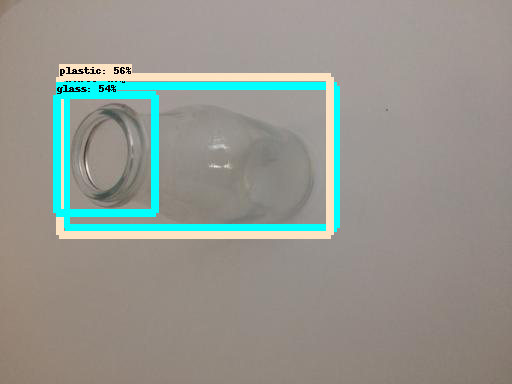

[0.6681421  0.5647191  0.5383803  0.41297916 0.30380258 0.29108325
 0.21933503 0.18247972 0.17120956 0.16642883 0.13563995 0.13503395
 0.13455792 0.13009664 0.12976696 0.1280508  0.12114835 0.11302148
 0.09675217 0.0949453  0.09278934 0.09037562 0.08795907 0.08651174
 0.0849845  0.08203448 0.08150762 0.07884385 0.0784847  0.07693247
 0.07274503 0.07226413 0.07140455 0.07068788 0.06818887 0.06684542
 0.06320974 0.06201267 0.06027303 0.06006796 0.05867124 0.0586573
 0.05853105 0.05831111 0.05806556 0.05726243 0.05589792 0.05520344
 0.05506091 0.0543272  0.05251212 0.0521142  0.05139951 0.0498553
 0.0496278  0.0493951  0.04890134 0.04882703 0.04876636 0.04798317
 0.04781761 0.04620813 0.04608505 0.04595621 0.04517946 0.04446392
 0.04431108 0.04396683 0.04386151 0.04327166 0.04322002 0.04303657
 0.04302527 0.04228721 0.04171386 0.0416192  0.04093759 0.04080018
 0.04053342 0.04032294 0.04017406 0.04011302 0.03975211 0.03949026
 0.03883064 0.03828846 0.03807805 0.03781837 0.03752986 0.037458

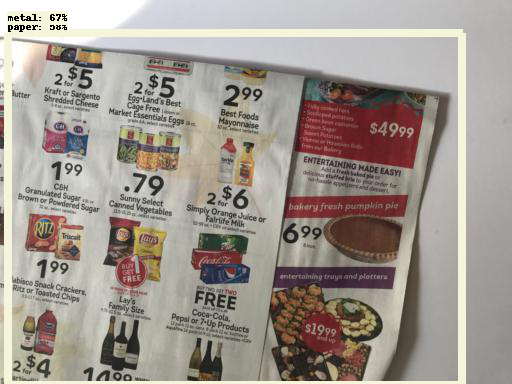

[0.6659893  0.5770477  0.25414482 0.1079074  0.10689573 0.0923141
 0.08210298 0.08124389 0.07896301 0.06185402 0.05672872 0.0470481
 0.04257423 0.03707358 0.03330807 0.03179961 0.0311616  0.03027541
 0.02951534 0.02926479 0.02900201 0.02847033 0.02839094 0.02760247
 0.02748692 0.02739032 0.02707099 0.02676746 0.02675675 0.02606088
 0.0259335  0.025881   0.02577874 0.0252647  0.02523124 0.02497195
 0.02477198 0.02399841 0.02373509 0.02326888 0.02317667 0.02290639
 0.02287251 0.02273024 0.02272858 0.02258771 0.02226189 0.0221172
 0.02183796 0.02180436 0.02169078 0.02163021 0.02140327 0.0213564
 0.02133178 0.02130464 0.02113452 0.02088015 0.02078892 0.02078619
 0.02070337 0.02053339 0.02038904 0.02035885 0.02035205 0.02035077
 0.02030312 0.02027905 0.02018062 0.02017232 0.02014191 0.02013966
 0.02007795 0.01999499 0.01985127 0.01984341 0.01977789 0.01971316
 0.01967697 0.0196399  0.01944022 0.01939106 0.01932703 0.0192035
 0.01908342 0.0190579  0.01905255 0.01902556 0.01901671 0.01900791


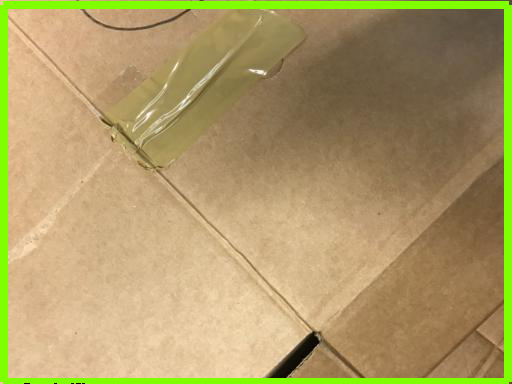

[0.9546032  0.10390987 0.08120045 0.07418322 0.07394679 0.07347327
 0.07120188 0.06579646 0.06421934 0.06075139 0.06006834 0.05716606
 0.05602233 0.0558306  0.05551836 0.04984229 0.04912809 0.04458858
 0.04447694 0.04314089 0.042704   0.04266433 0.04228389 0.04064825
 0.04054631 0.04008763 0.03992552 0.03936433 0.03875972 0.03769609
 0.03755556 0.03699803 0.0364587  0.03481105 0.03381458 0.03323246
 0.03253906 0.03250723 0.03217093 0.03183341 0.03182727 0.0315097
 0.03112014 0.03104326 0.03068811 0.03016091 0.02956779 0.0294608
 0.0292041  0.02904237 0.02893493 0.02889402 0.02885902 0.02885429
 0.0286296  0.0283216  0.02822667 0.02795891 0.02790574 0.02788649
 0.02773039 0.02739494 0.02739153 0.0272716  0.0271681  0.02694013
 0.02679789 0.02664284 0.0265489  0.02649359 0.02632076 0.02593903
 0.02584245 0.02566524 0.0256385  0.0255792  0.025419   0.02540096
 0.02516926 0.0250281  0.02487292 0.02440812 0.0243754  0.02433294
 0.02416277 0.0239497  0.02362514 0.02347199 0.02346655 0.023288

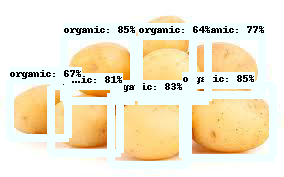

[0.85030395 0.84783065 0.8265015  0.81425923 0.76816684 0.6690906
 0.6362469  0.4105305  0.3474774  0.29372773 0.28785008 0.24188247
 0.23450664 0.22872838 0.21972135 0.1888646  0.18021044 0.1797945
 0.17413974 0.15890916 0.15466139 0.15227932 0.14378506 0.14233233
 0.13821435 0.13766871 0.13518046 0.13328674 0.13022009 0.12830067
 0.1262791  0.12622064 0.12617442 0.12274202 0.11264729 0.1120038
 0.11114362 0.10960452 0.10954908 0.10887542 0.10767934 0.10587135
 0.10488356 0.10480732 0.10256409 0.10142811 0.09854396 0.09744003
 0.09705286 0.0966846  0.09649623 0.09558059 0.09368674 0.09309528
 0.09279924 0.09138137 0.09117486 0.09087847 0.09025268 0.09007815
 0.09002829 0.08975571 0.08935631 0.08753759 0.08684669 0.0868175
 0.08386023 0.08344658 0.08342462 0.08202434 0.08174505 0.08103047
 0.08032019 0.07830471 0.0776324  0.07720868 0.07587332 0.07527217
 0.07473814 0.07352867 0.07343732 0.0731507  0.0730966  0.07283065
 0.07160635 0.07158899 0.07085349 0.07032025 0.06978595 0.06931445

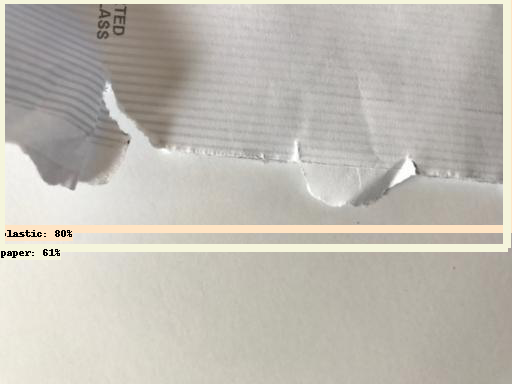

[0.7963074  0.6147155  0.28407657 0.2050804  0.18138908 0.15056063
 0.14733799 0.11485748 0.11469604 0.11267698 0.1071019  0.10141135
 0.09326975 0.08334415 0.07710283 0.07664124 0.07564513 0.07078756
 0.06692832 0.06497781 0.06475042 0.06439076 0.06333274 0.06228727
 0.06205026 0.06193905 0.06099466 0.05910847 0.05813346 0.05713794
 0.05446944 0.05392262 0.05336964 0.05240882 0.05192982 0.05167013
 0.0511608  0.04778756 0.04764921 0.04752929 0.0468945  0.04647469
 0.0452309  0.04472345 0.04344619 0.0429742  0.0419618  0.04194389
 0.04148046 0.04126834 0.04069931 0.04049014 0.04047982 0.04031198
 0.04030127 0.03938562 0.03922952 0.03912015 0.03837856 0.03800633
 0.03784974 0.03773344 0.03765143 0.03761129 0.03753113 0.03734315
 0.03710352 0.03701633 0.03700821 0.03643225 0.03613063 0.03573848
 0.03555708 0.03547897 0.03537833 0.03515187 0.03420829 0.03420028
 0.0341648  0.03403704 0.03375978 0.03340132 0.0333766  0.03334144
 0.03331131 0.03289888 0.03273997 0.03198479 0.03142844 0.0313

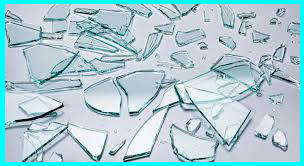

[0.9373401  0.3107317  0.27811593 0.23472285 0.22439148 0.20095412
 0.18624437 0.18324699 0.17289396 0.16381918 0.16106324 0.14958106
 0.12731999 0.12648259 0.11721714 0.1079015  0.10634411 0.10373797
 0.1026186  0.09593154 0.0955731  0.09416064 0.09310413 0.09251801
 0.09099232 0.08998293 0.08822598 0.08646718 0.08566386 0.08566268
 0.08445276 0.08300871 0.08225598 0.08217955 0.08097576 0.08027271
 0.07929531 0.07795834 0.07764065 0.07702288 0.07596789 0.07511195
 0.07442723 0.07429419 0.07179252 0.06949632 0.0688615  0.06861309
 0.06828272 0.06809347 0.06796813 0.06661231 0.06597319 0.06516048
 0.06408186 0.06335289 0.06312162 0.06212424 0.06077602 0.06039802
 0.05950078 0.05927171 0.05912962 0.05849214 0.05825441 0.05808115
 0.05762819 0.05705107 0.05687398 0.05680416 0.05595078 0.05584101
 0.05562698 0.05559304 0.05533161 0.05532632 0.055005   0.05412434
 0.0537977  0.05316212 0.05309311 0.052644   0.05252538 0.05230298
 0.05187285 0.05186908 0.0518563  0.05155103 0.05150944 0.0512

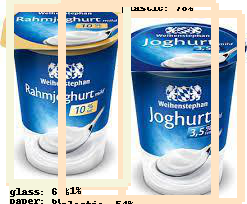

[0.8058938  0.78275555 0.60040766 0.59541136 0.538296   0.40873638
 0.3038796  0.3012447  0.2427846  0.22523159 0.21919031 0.21123934
 0.21030486 0.20312896 0.1619498  0.16063744 0.13707922 0.12790552
 0.12760064 0.10454819 0.09257177 0.08022098 0.07732584 0.06915593
 0.0689896  0.06430668 0.06146418 0.05853231 0.05460774 0.0527876
 0.05190655 0.05155771 0.04973923 0.04835947 0.04631013 0.04571184
 0.04446539 0.04366628 0.04134572 0.04108664 0.03876983 0.03785547
 0.03706373 0.03641967 0.03604487 0.0359922  0.03552879 0.03501391
 0.03471325 0.03413477 0.03377018 0.03370566 0.03339882 0.03312311
 0.03280022 0.03220863 0.03162815 0.03161148 0.0314868  0.03142776
 0.03129824 0.03114455 0.03092907 0.03003155 0.02996169 0.0297125
 0.02947455 0.02933619 0.02920162 0.02917699 0.02891811 0.02852594
 0.02850885 0.02838559 0.02808791 0.02763348 0.02758989 0.02744489
 0.02741935 0.02739687 0.02737771 0.0273467  0.02726898 0.02710723
 0.02708068 0.0268195  0.02673339 0.02663868 0.02646783 0.025905

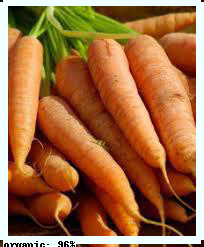

[0.95770586 0.3981853  0.18399803 0.17849231 0.17053647 0.16583101
 0.15910754 0.15746836 0.13437283 0.12738986 0.12582606 0.1244543
 0.12201768 0.11809665 0.11609458 0.11248423 0.1123558  0.10692352
 0.10662068 0.10200331 0.10081368 0.09978139 0.09855939 0.09774386
 0.09681853 0.09466386 0.0932464  0.0928852  0.089921   0.08989177
 0.08827555 0.08804782 0.08796829 0.08721898 0.08682044 0.08598606
 0.08557732 0.0852109  0.08475343 0.08427481 0.08327752 0.08303408
 0.08211569 0.08163688 0.08163268 0.08130572 0.07981867 0.07834717
 0.0780944  0.07652538 0.07636438 0.07581141 0.07326797 0.07298774
 0.0715476  0.07140253 0.07137987 0.07037582 0.0691129  0.06888849
 0.06850987 0.06801054 0.06774706 0.06687279 0.06647585 0.06607197
 0.06602912 0.06561232 0.06548244 0.06521323 0.06396218 0.06370366
 0.06362303 0.06296709 0.06271255 0.06139483 0.06134508 0.06024074
 0.05964164 0.05944141 0.05888302 0.05838266 0.05821737 0.05779688
 0.05614837 0.05557748 0.05527237 0.05505259 0.05483351 0.05403

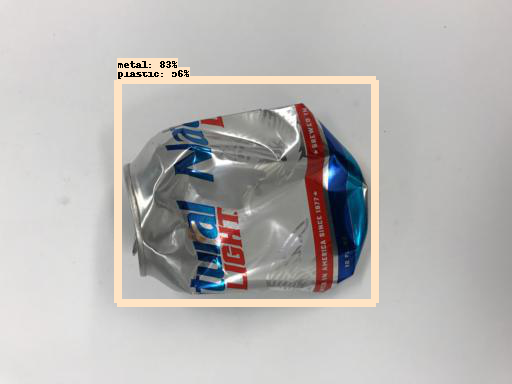

[0.8342906  0.55631626 0.24652588 0.23257858 0.21146102 0.18540153
 0.07201771 0.06772421 0.05324468 0.05152362 0.0449329  0.04306017
 0.04256843 0.04213562 0.04066271 0.03933068 0.03825444 0.03722169
 0.03645382 0.03559178 0.03549637 0.03490759 0.03327302 0.03303038
 0.03263845 0.03227657 0.03212547 0.03199474 0.03179906 0.03163125
 0.03139921 0.031083   0.03106893 0.03097048 0.03086646 0.03082681
 0.03007291 0.02978494 0.02896422 0.02879812 0.02875596 0.02815711
 0.02806076 0.02706113 0.02674476 0.02601781 0.02595317 0.02483091
 0.02478773 0.0244616  0.02439266 0.02429727 0.02396898 0.02378871
 0.02369201 0.02359682 0.02358343 0.0234913  0.02343839 0.02342172
 0.02322111 0.02314387 0.02295305 0.02290954 0.02277651 0.02268691
 0.02246371 0.02240764 0.022284   0.02226975 0.02216764 0.0220529
 0.02197877 0.02182021 0.02173412 0.02167284 0.0214859  0.02135169
 0.02109759 0.02099607 0.0208402  0.02068969 0.02066985 0.02062979
 0.02061958 0.02049604 0.02036781 0.02027759 0.02025469 0.02024

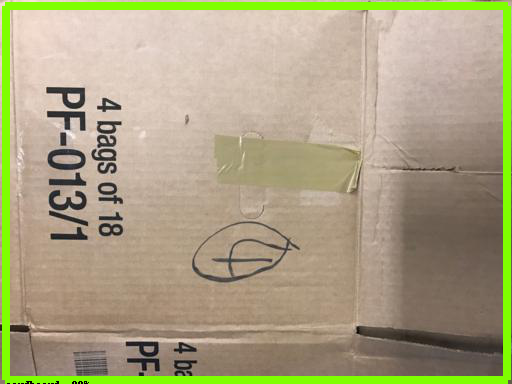

[0.9040587  0.16005848 0.12095293 0.11068685 0.09129683 0.05863399
 0.05702402 0.05688193 0.05558248 0.04900858 0.04750344 0.04721478
 0.04601932 0.04178748 0.04047252 0.04047102 0.03998709 0.03925334
 0.03684347 0.03595988 0.03586603 0.03458203 0.03454572 0.03452183
 0.03450761 0.03406959 0.03397085 0.03388218 0.03388198 0.03373084
 0.03342669 0.03260129 0.03258211 0.03155049 0.03117508 0.03111459
 0.03110139 0.03057456 0.03011742 0.0286088  0.02857322 0.02847348
 0.02832474 0.02805912 0.02797029 0.02756815 0.02699102 0.02630643
 0.02588459 0.025832   0.02499162 0.02494263 0.02491835 0.0249168
 0.02485773 0.02421614 0.02415281 0.02377667 0.02355834 0.02322342
 0.02264578 0.02221991 0.02208031 0.02181156 0.02177263 0.02158306
 0.02154599 0.02146293 0.02133431 0.02095393 0.02078313 0.02073041
 0.02060617 0.02048651 0.02022748 0.02013263 0.01996659 0.01996508
 0.01973552 0.01972795 0.01967431 0.0196388  0.01957536 0.01952459
 0.01941186 0.01938637 0.01930316 0.01916803 0.01912684 0.01904

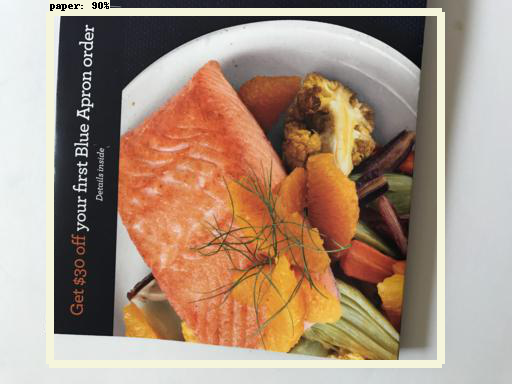

[0.89965594 0.18189779 0.16274732 0.16052958 0.13276781 0.11314788
 0.07224421 0.05660461 0.05496462 0.0477999  0.04696857 0.04680777
 0.04610549 0.0458903  0.044701   0.04416744 0.04253852 0.04071354
 0.04033531 0.03936321 0.03901811 0.03864309 0.0377314  0.03498331
 0.03430942 0.03376137 0.03313847 0.03301961 0.03224195 0.0306791
 0.03064642 0.0305977  0.03020356 0.03000372 0.02916116 0.02910119
 0.02885155 0.02855053 0.02824364 0.02784973 0.02665539 0.02621604
 0.02606124 0.02586811 0.02561272 0.02555321 0.02546505 0.02543651
 0.02489875 0.02426485 0.02410201 0.02391606 0.02357012 0.02336173
 0.02335631 0.02326229 0.02285764 0.02252587 0.02250255 0.02248815
 0.02235064 0.02233628 0.02191141 0.02185742 0.02177441 0.0217675
 0.02163166 0.02146882 0.0214435  0.02141929 0.02122953 0.02117831
 0.02117256 0.02093194 0.02076668 0.02056315 0.02043208 0.02022987
 0.02021128 0.02019359 0.01999231 0.01978554 0.01978027 0.01977452
 0.01973468 0.01938922 0.01928049 0.01906365 0.01894316 0.018923

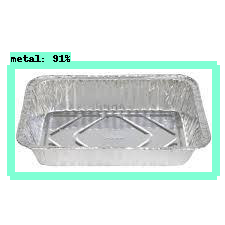

[0.91496354 0.22907126 0.18936478 0.14188592 0.10325711 0.0887164
 0.08676331 0.06542278 0.0644634  0.05010103 0.04648159 0.04610772
 0.04534345 0.04447307 0.04428105 0.0439024  0.04325365 0.04234644
 0.04211936 0.04207347 0.04163795 0.04157159 0.04107206 0.04089466
 0.03996429 0.03996258 0.03995847 0.03995632 0.0399538  0.03993853
 0.03990106 0.03990093 0.03982598 0.03972375 0.03954314 0.03865682
 0.03852628 0.03731985 0.03723323 0.03638507 0.03572418 0.03530646
 0.034712   0.03414175 0.03402804 0.0336562  0.032879   0.03139284
 0.03020918 0.03016267 0.03002492 0.02967047 0.02953075 0.02945061
 0.02941843 0.02934042 0.0291248  0.02880435 0.02821196 0.02793733
 0.02754101 0.0272106  0.02704214 0.02696845 0.02660899 0.02652618
 0.02637025 0.02632537 0.02596227 0.02594651 0.02582678 0.02573559
 0.02542887 0.02532644 0.02526517 0.02526022 0.02507533 0.025024
 0.02499621 0.02476428 0.02474424 0.02457263 0.02444996 0.02419521
 0.02415989 0.02415732 0.02392033 0.02391389 0.02375621 0.0236382

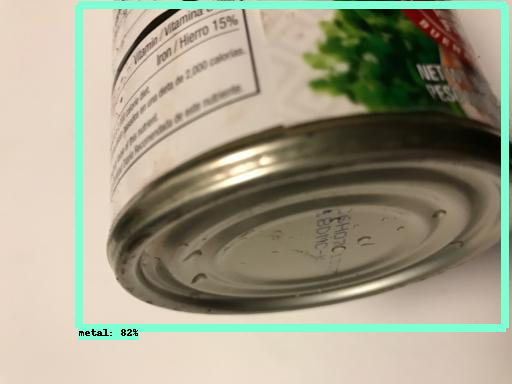

[0.81707543 0.33414203 0.31030577 0.24619347 0.18086368 0.165698
 0.08153806 0.07626739 0.07200939 0.07009644 0.06235183 0.05748544
 0.05450093 0.05398773 0.05296251 0.04769751 0.0465947  0.04634084
 0.04571692 0.04507875 0.04497534 0.04399041 0.04389379 0.04303316
 0.04264235 0.04157317 0.04103028 0.0410196  0.03991569 0.03950915
 0.03882984 0.03861541 0.03807805 0.03781695 0.03708245 0.03643531
 0.03574537 0.03567871 0.03516801 0.03516122 0.03509488 0.0348282
 0.03429961 0.03418542 0.03382817 0.03317029 0.03292282 0.03287742
 0.03165641 0.03138315 0.0303542  0.03005787 0.03002771 0.03002029
 0.02997745 0.02959532 0.02940192 0.02915846 0.02907626 0.02901349
 0.0288319  0.02873449 0.02837637 0.02836791 0.02827212 0.02815961
 0.02729742 0.02716157 0.02699077 0.02645621 0.02622664 0.02610675
 0.02605509 0.02594599 0.02570008 0.02556031 0.02549328 0.02540085
 0.02516983 0.0251626  0.02506172 0.0249227  0.02488043 0.02480876
 0.02479681 0.02460454 0.02454357 0.02449345 0.02440322 0.0242165

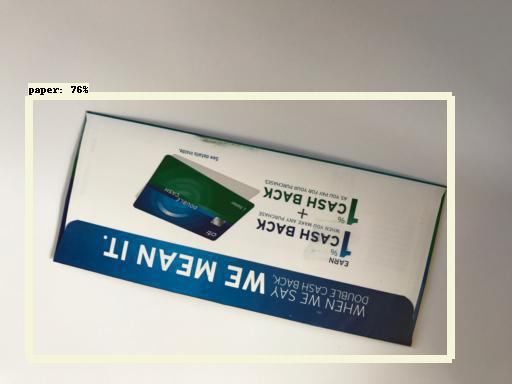

[0.75777745 0.4646204  0.33459663 0.18360327 0.12449452 0.11961346
 0.09044845 0.05687378 0.05438985 0.04603737 0.04430684 0.03985006
 0.0379914  0.03778899 0.03595627 0.03477975 0.03461397 0.03392903
 0.03361255 0.03360082 0.03254377 0.03181333 0.03127012 0.0310142
 0.03069383 0.03033117 0.02975828 0.0297367  0.02921745 0.02889532
 0.02871837 0.02830193 0.02820123 0.02772929 0.02766091 0.02765017
 0.02732892 0.02715342 0.02704979 0.02686725 0.02682209 0.02680265
 0.0267586  0.02619402 0.02618325 0.0261738  0.02583758 0.02579871
 0.02544641 0.02518887 0.02500861 0.02499877 0.02499608 0.02494801
 0.02487569 0.02476451 0.0246622  0.02422321 0.02399859 0.02375361
 0.0237464  0.02371653 0.02371155 0.02354497 0.0234875  0.02336964
 0.02334401 0.02313922 0.02288442 0.02277822 0.02272852 0.02271735
 0.02260423 0.02258593 0.02253756 0.0225334  0.02244367 0.02242953
 0.02195873 0.02187299 0.0218528  0.02176965 0.02160259 0.02157865
 0.02133271 0.02126061 0.02118043 0.02117066 0.02109376 0.02061

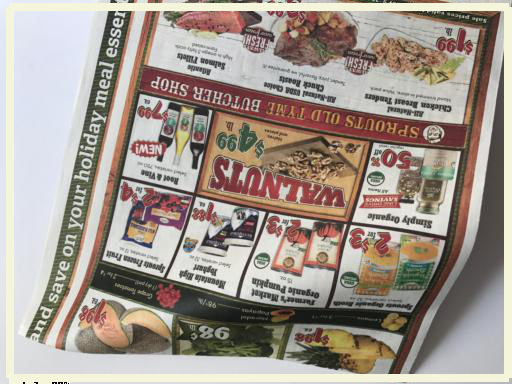

[0.77248096 0.5694524  0.25996733 0.15043138 0.12504451 0.0948916
 0.08450214 0.0818523  0.06966121 0.06147803 0.05305268 0.0516086
 0.0503756  0.04964565 0.04829682 0.04682764 0.04542143 0.04539927
 0.04275588 0.04121377 0.04081612 0.04001167 0.03930346 0.03876946
 0.03806804 0.03798977 0.03753714 0.03647237 0.03598831 0.03477548
 0.0347483  0.03427792 0.03418693 0.03342595 0.03333847 0.03297945
 0.03274683 0.03273721 0.0319173  0.03187486 0.03172336 0.03150497
 0.0312774  0.03078649 0.03077324 0.03031804 0.03013813 0.02958067
 0.02930504 0.02881273 0.02834754 0.02828174 0.02826159 0.02810976
 0.02800424 0.02795332 0.02764649 0.02761008 0.0275615  0.02739972
 0.0272312  0.0271424  0.02709753 0.02689278 0.02663282 0.02649467
 0.02627118 0.02600348 0.02575275 0.02561067 0.02559166 0.02552697
 0.02549417 0.02547876 0.02534912 0.02508634 0.02484727 0.02481353
 0.02460872 0.0242572  0.02409554 0.02404253 0.02403847 0.02386096
 0.02369462 0.02325311 0.02318309 0.02277027 0.02269668 0.022473

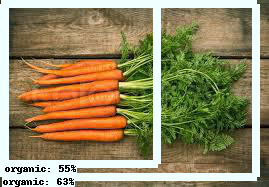

[0.632626   0.5516516  0.4489927  0.27502948 0.22726487 0.18394431
 0.17665452 0.17062591 0.16833611 0.1657816  0.16492657 0.16460988
 0.1398505  0.13744286 0.12711462 0.12133978 0.11913803 0.11544729
 0.10705674 0.10638979 0.10282641 0.09949474 0.09567218 0.09033503
 0.08907414 0.08718276 0.08607363 0.08362728 0.08051193 0.07684074
 0.07459411 0.07443713 0.06920569 0.06498449 0.06494614 0.06403349
 0.063004   0.0628476  0.06018757 0.06005315 0.0598559  0.05964119
 0.05959347 0.05955696 0.05824292 0.05807865 0.05801336 0.05775595
 0.05746805 0.05737437 0.05725459 0.0571057  0.05653802 0.05575954
 0.05455516 0.05448515 0.0533908  0.05319259 0.05304406 0.0518226
 0.05130077 0.05129692 0.05066878 0.05032567 0.05025285 0.04997914
 0.04982595 0.04973792 0.04914828 0.04910088 0.04878803 0.04871725
 0.04851489 0.04812714 0.04800392 0.04772926 0.04753865 0.04748137
 0.04699977 0.04681643 0.04648582 0.0464232  0.04446008 0.04438332
 0.04415447 0.0440715  0.04392596 0.04362091 0.04324808 0.04310

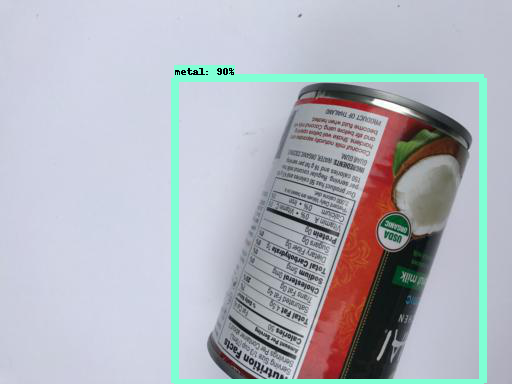

[0.8995174  0.1892976  0.16929537 0.12901816 0.12496752 0.11419097
 0.07766857 0.0512884  0.05003991 0.04973599 0.04901434 0.04814127
 0.04500107 0.04455048 0.04306358 0.04228835 0.04169455 0.04085723
 0.04083487 0.03830852 0.03765597 0.03755436 0.03624963 0.0355095
 0.03547533 0.03506417 0.03502084 0.03462555 0.03419584 0.03310566
 0.03289459 0.03287733 0.03236679 0.03201387 0.03129767 0.03122119
 0.0308282  0.03058931 0.02987351 0.02981297 0.02902388 0.02900392
 0.02771816 0.0275342  0.02733059 0.02673098 0.02662566 0.02625829
 0.02614852 0.02596202 0.02586526 0.02555201 0.02546553 0.02531902
 0.0251224  0.02506386 0.02481696 0.02479983 0.02475445 0.02473684
 0.02467665 0.02457619 0.0244233  0.02421033 0.0241034  0.02403038
 0.02402475 0.02377968 0.02369769 0.02357111 0.02353759 0.02350017
 0.02340149 0.02333788 0.02322227 0.02304835 0.02303815 0.02282889
 0.02272269 0.02261243 0.02240022 0.0221316  0.02200729 0.0218342
 0.02176096 0.02174514 0.02166879 0.02161458 0.02145565 0.021439

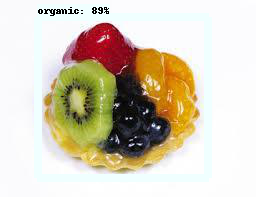

[0.89161766 0.3797954  0.18810822 0.17330375 0.15389667 0.14012334
 0.12932338 0.1251768  0.12483782 0.10823499 0.10640006 0.10626478
 0.09833676 0.08708408 0.08387329 0.08351089 0.08117599 0.07850733
 0.07544188 0.07266948 0.07122993 0.06256402 0.06127584 0.06035714
 0.05695357 0.05517606 0.05270912 0.05009836 0.04995697 0.04866261
 0.04810526 0.04631943 0.04562986 0.04534144 0.04375358 0.04351833
 0.04290082 0.04260396 0.04195159 0.04174018 0.04160953 0.04106083
 0.04040892 0.03978702 0.03926578 0.03893245 0.03824022 0.03800485
 0.03786897 0.03779092 0.03693884 0.03653194 0.03633342 0.0356614
 0.03536103 0.03532101 0.03498659 0.03457533 0.03456315 0.03451312
 0.03449297 0.03438577 0.03402808 0.03375501 0.03374309 0.03372387
 0.0336311  0.03317435 0.03309191 0.03280655 0.03249121 0.03231713
 0.03203138 0.03174728 0.03082792 0.03073051 0.03043818 0.03035944
 0.02994924 0.02960225 0.02945201 0.02936555 0.02934088 0.029291
 0.02920715 0.02900017 0.02879046 0.02845763 0.02813385 0.0279750

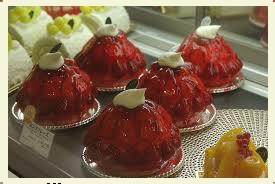

[0.8810083  0.31211287 0.2866297  0.15065373 0.1483666  0.13046798
 0.12041631 0.11064523 0.10052042 0.0902155  0.08007322 0.06743808
 0.06436463 0.06399698 0.06354558 0.06328918 0.06262448 0.06078373
 0.05967619 0.05631478 0.05508647 0.05484309 0.05446402 0.05366871
 0.05300915 0.05282244 0.05260785 0.0523926  0.0523444  0.05181444
 0.05166259 0.05077431 0.05072527 0.04785993 0.04693897 0.04692753
 0.04661058 0.04527655 0.0452159  0.04349508 0.04349242 0.04344282
 0.04277327 0.04238598 0.042296   0.04178468 0.04046526 0.04031872
 0.03990392 0.03900286 0.0386854  0.03822611 0.03808692 0.03774938
 0.0373993  0.03721464 0.03715585 0.03688118 0.03686392 0.03629024
 0.03624746 0.03551298 0.03548093 0.03515439 0.03444191 0.03409138
 0.03377548 0.03364323 0.0332913  0.03328624 0.03319234 0.03309213
 0.03279193 0.03268354 0.03268058 0.03265487 0.03251687 0.03223306
 0.03186742 0.03170192 0.03155369 0.0315016  0.03130523 0.03121419
 0.03109935 0.03102838 0.03101577 0.03090008 0.0308897  0.0307

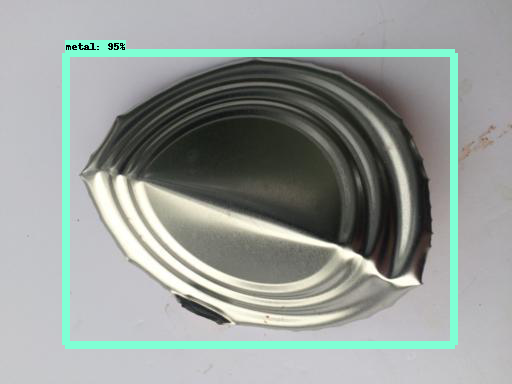

[0.9482283  0.20183243 0.14541304 0.11558073 0.11413984 0.06561475
 0.05469996 0.05456524 0.05451848 0.04613779 0.04598762 0.04070269
 0.03739696 0.03570581 0.03482648 0.03411429 0.03282924 0.03197951
 0.03185265 0.03108765 0.03095884 0.03035019 0.02968037 0.02963808
 0.0295613  0.02937625 0.02894727 0.0288048  0.02805248 0.0278581
 0.02685768 0.02666456 0.0264781  0.02574717 0.02546073 0.02537459
 0.02511038 0.02479579 0.02475218 0.02469821 0.02466869 0.02465143
 0.02448937 0.02445826 0.0240549  0.02384247 0.02382491 0.02376315
 0.02368979 0.023637   0.02354164 0.02351392 0.02338778 0.0233074
 0.02329983 0.02328201 0.02315788 0.02311831 0.02297699 0.02274297
 0.02247345 0.02244807 0.02227032 0.02225781 0.02220143 0.02216743
 0.02196065 0.02187433 0.02181044 0.02151969 0.02140101 0.02138289
 0.02131404 0.02126567 0.02122631 0.02109943 0.02096426 0.02080334
 0.02078149 0.02075216 0.0206988  0.02060107 0.02051369 0.02049743
 0.02039342 0.0202208  0.02010176 0.02006513 0.02004207 0.020029

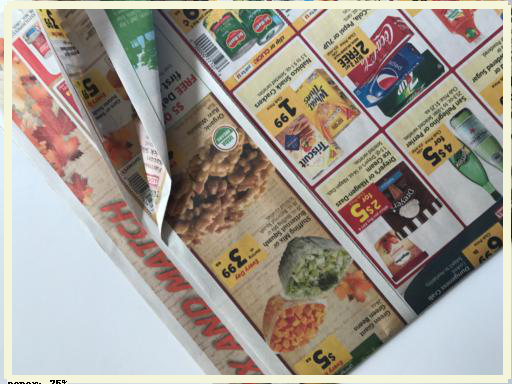

[0.74765897 0.38168898 0.37445796 0.18228336 0.16626208 0.09990938
 0.06357878 0.05848244 0.05656939 0.05094266 0.03977597 0.03562285
 0.03430397 0.03378358 0.03222211 0.03103232 0.03059533 0.03049348
 0.02976462 0.02938666 0.02930455 0.02879043 0.02867663 0.0285228
 0.02843246 0.02825496 0.02796588 0.02744526 0.027347   0.02693954
 0.02674893 0.026458   0.0261455  0.02601823 0.0258405  0.02577731
 0.02540812 0.02521106 0.02519036 0.02468249 0.02449911 0.02449476
 0.02427788 0.02402699 0.02400699 0.02379912 0.0231994  0.0231432
 0.02309776 0.02306814 0.02292662 0.02288282 0.02287271 0.02278699
 0.02277599 0.02264443 0.0226405  0.02263214 0.02243666 0.02237124
 0.0221558  0.02204908 0.02199341 0.02191981 0.02191645 0.02175655
 0.02147534 0.02145633 0.02140184 0.02123967 0.0204796  0.02036004
 0.02032415 0.02017717 0.02012813 0.02006793 0.01994966 0.01987117
 0.01985154 0.01967262 0.01918826 0.0190993  0.01906819 0.01906013
 0.01904303 0.01891182 0.01848506 0.01836683 0.01816751 0.018135

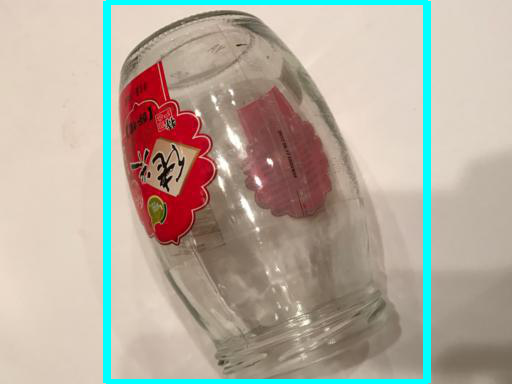

[0.93546    0.17278266 0.13470934 0.12582819 0.11680084 0.11398774
 0.0942366  0.09368991 0.09237088 0.09092194 0.08516717 0.08309236
 0.08243703 0.08153464 0.08059741 0.07994155 0.0769225  0.07549864
 0.06466949 0.06013079 0.05987903 0.05168058 0.04996918 0.04961306
 0.04894309 0.04784426 0.04554065 0.04487478 0.04446407 0.04018413
 0.03991361 0.03940863 0.03731121 0.03721555 0.03646975 0.03573312
 0.03558461 0.03491699 0.03426597 0.0341339  0.0341253  0.03270362
 0.03263853 0.03220906 0.03211882 0.0315037  0.03069864 0.02967279
 0.02955709 0.02934385 0.02926331 0.02885087 0.02875634 0.02858745
 0.02846994 0.02832753 0.02813439 0.02789697 0.0277493  0.02758835
 0.02755669 0.026943   0.02640235 0.02639805 0.02608185 0.0257941
 0.02572584 0.02561976 0.02557656 0.02554027 0.02501537 0.02501435
 0.02486929 0.0248106  0.02467356 0.02465563 0.02440968 0.02438965
 0.02435345 0.0242429  0.02386582 0.02385329 0.02368609 0.02368067
 0.02350103 0.02331984 0.02306765 0.02289613 0.02271948 0.02264

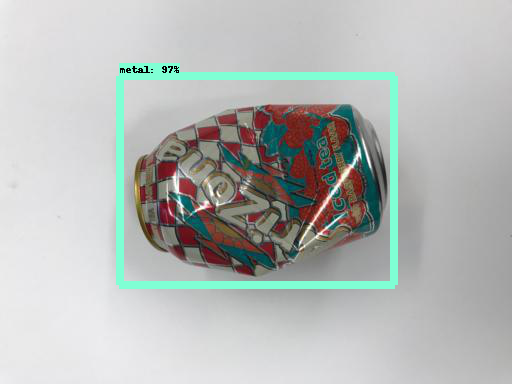

[0.9666899  0.36920428 0.23839264 0.21960318 0.17719464 0.10353938
 0.05451747 0.0503931  0.04817056 0.04298666 0.04204882 0.03897883
 0.038074   0.03688179 0.0365082  0.0363947  0.03441404 0.03427358
 0.03422508 0.0341347  0.03353421 0.0329028  0.0328565  0.03221134
 0.03145293 0.03067448 0.03037076 0.02992771 0.02899331 0.02849708
 0.02817638 0.02814263 0.02799368 0.02780143 0.02768035 0.0275772
 0.02704417 0.02676009 0.02626745 0.02619834 0.02593439 0.02584949
 0.02496981 0.02494417 0.02454716 0.02452703 0.02434477 0.02431343
 0.02386094 0.02379989 0.02374366 0.02373855 0.02367565 0.02363222
 0.02309361 0.02298857 0.0229854  0.02286805 0.0227561  0.02267654
 0.02257543 0.02256565 0.02240965 0.02239577 0.02233384 0.02232878
 0.02222312 0.02200289 0.02183892 0.02177559 0.02166584 0.02148732
 0.02147493 0.02137176 0.02135528 0.02130329 0.0212604  0.02119202
 0.02110563 0.02106869 0.02101358 0.0209106  0.02084761 0.02084245
 0.02080772 0.02075676 0.02069718 0.02061508 0.02055915 0.02051

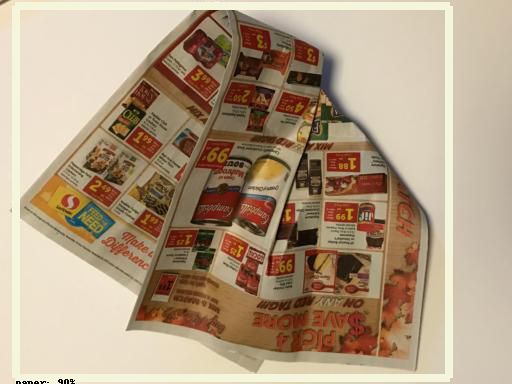

[0.90331554 0.12532184 0.11400262 0.11394385 0.07606085 0.06387063
 0.0505562  0.0454869  0.03784257 0.03740644 0.03694102 0.03506856
 0.03304848 0.0321307  0.03203865 0.0319225  0.03120732 0.03078903
 0.03041452 0.02965578 0.02955058 0.02915741 0.02893398 0.02892154
 0.02810598 0.02682032 0.02651898 0.02591558 0.02565202 0.02538164
 0.02506039 0.02496743 0.02474937 0.02444657 0.02425381 0.02412929
 0.02382146 0.02379905 0.02324169 0.0232234  0.02271438 0.02262422
 0.0223407  0.02233716 0.02214385 0.0220075  0.02186537 0.02185951
 0.02173598 0.02166958 0.0214474  0.0210996  0.02107548 0.02095148
 0.02092992 0.02071848 0.02066163 0.02051086 0.02050047 0.0204148
 0.02024826 0.02015704 0.02005673 0.01995728 0.01987767 0.0194778
 0.0194183  0.0193531  0.01928991 0.01917508 0.01913206 0.01912898
 0.01910271 0.01908013 0.01870212 0.01866889 0.01864465 0.0186189
 0.0185417  0.01843393 0.01842731 0.01829413 0.01804777 0.01793945
 0.01787713 0.01773809 0.01769324 0.0176903  0.01768136 0.0176756

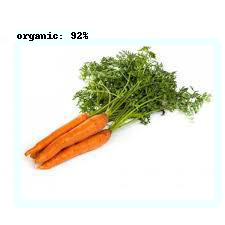

[0.92448545 0.10034601 0.09484506 0.08637445 0.08474014 0.0809917
 0.07846729 0.07803884 0.06207603 0.05485254 0.05321879 0.05295896
 0.05289526 0.04807915 0.04677695 0.04663299 0.04566334 0.04549446
 0.04519681 0.04344347 0.04300654 0.0422713  0.04120854 0.04110145
 0.0409497  0.04076781 0.04050487 0.04004034 0.03938562 0.03936439
 0.03826445 0.03805925 0.03796528 0.0376023  0.03692833 0.03663536
 0.03628853 0.03523333 0.03511939 0.03508104 0.03420041 0.03415212
 0.0341089  0.03405737 0.03403073 0.0333708  0.03325994 0.03316887
 0.03249766 0.03234563 0.03205796 0.03197268 0.03179839 0.03069485
 0.03041241 0.03032503 0.02946481 0.02941993 0.02937233 0.02882925
 0.02860752 0.02850813 0.02849457 0.0284482  0.02844208 0.0279765
 0.02778166 0.0276482  0.02757652 0.02754275 0.02753619 0.02712231
 0.0268558  0.02669532 0.02647208 0.02638338 0.02594193 0.02584815
 0.02582007 0.02542491 0.02529897 0.02526236 0.0249656  0.02496314
 0.02494147 0.0246717  0.02460225 0.02452185 0.02450842 0.024484

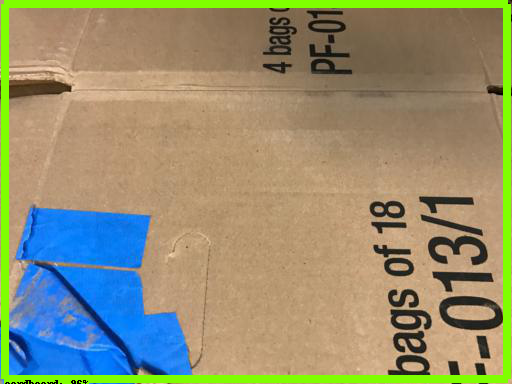

[0.9648981  0.11773738 0.07346745 0.07020549 0.05955696 0.05821323
 0.05663992 0.05630839 0.05579613 0.05524403 0.05512027 0.05331557
 0.052529   0.0504141  0.0502216  0.0483414  0.04802164 0.04687012
 0.04682847 0.04443656 0.04430177 0.04386784 0.04372321 0.04362971
 0.04154713 0.04041969 0.0401762  0.03999119 0.03843644 0.03839647
 0.03803286 0.03790636 0.03742826 0.03740116 0.0373931  0.03732065
 0.03662014 0.03613165 0.03552144 0.0344735  0.0341701  0.03252426
 0.03207854 0.0317023  0.03144561 0.03130305 0.0312464  0.03039767
 0.03022157 0.02993326 0.02955562 0.0295422  0.02903173 0.02894837
 0.02892674 0.0287138  0.02843867 0.02826363 0.02804892 0.0280039
 0.02765922 0.02761847 0.02732599 0.02700106 0.02672755 0.02668561
 0.02662439 0.02659029 0.02649286 0.02645887 0.02604957 0.02558725
 0.02553727 0.02552243 0.02541547 0.02538188 0.02532759 0.0248645
 0.02479045 0.0247265  0.02464687 0.0243968  0.02433961 0.02427201
 0.02421498 0.02387002 0.0237366  0.02365297 0.02357003 0.023439

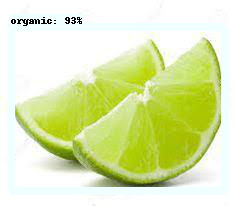

[0.930316   0.10371459 0.09289689 0.09033729 0.06613122 0.06497057
 0.06488071 0.06478173 0.06417282 0.05967672 0.05937188 0.05256095
 0.05167995 0.05145123 0.05034272 0.0471281  0.04476003 0.0437789
 0.0434726  0.04338048 0.04325291 0.04304358 0.04287735 0.04282783
 0.04267871 0.04260259 0.04222306 0.04185726 0.04170344 0.04144372
 0.04113751 0.04060972 0.0405405  0.04049744 0.04038088 0.04001723
 0.03964287 0.03954053 0.03940189 0.03923028 0.03896567 0.03888681
 0.03777071 0.03770778 0.03755671 0.03746421 0.03681721 0.03657074
 0.03589188 0.03586353 0.03585336 0.03542775 0.03519885 0.03518429
 0.03393038 0.03375854 0.03338001 0.03330716 0.03316928 0.03286146
 0.03271993 0.03262445 0.0321929  0.03155696 0.0315018  0.03082805
 0.03074329 0.03067275 0.030588   0.03057671 0.03048019 0.03035634
 0.03020603 0.02993072 0.02956382 0.02950431 0.02917331 0.02890042
 0.02880319 0.02796637 0.02766744 0.02715176 0.02714635 0.02701974
 0.02701499 0.02700123 0.02684794 0.02684651 0.02666875 0.02664

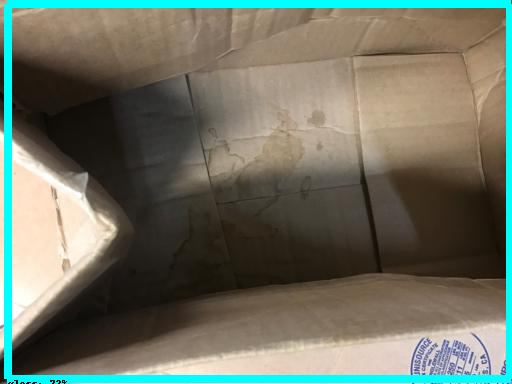

[0.72272    0.49402502 0.21380635 0.17889227 0.14551328 0.13637097
 0.11258116 0.11127914 0.09283695 0.08774125 0.08448431 0.08118426
 0.07745089 0.07605883 0.07597607 0.07124777 0.05958084 0.05936375
 0.05785128 0.05751007 0.05704423 0.05688407 0.05647402 0.05572021
 0.05556519 0.05543842 0.05354746 0.05229293 0.04959224 0.04878833
 0.04845881 0.04736963 0.04677322 0.04674076 0.04672044 0.04630256
 0.04529035 0.04436356 0.04361482 0.04319756 0.04292119 0.04291847
 0.0425274  0.04238138 0.04206029 0.04099044 0.04076669 0.0401975
 0.03873802 0.03863918 0.0377879  0.0368638  0.03593981 0.03581771
 0.03544503 0.03504604 0.03489097 0.03456543 0.03406433 0.03366975
 0.03336291 0.03322654 0.03239052 0.03235526 0.03205129 0.03166372
 0.03128552 0.03124613 0.03110095 0.03108995 0.03047839 0.03043451
 0.03027689 0.03020902 0.029579   0.02954535 0.02942329 0.02939994
 0.02900611 0.02889302 0.02883353 0.02881175 0.02879803 0.02867288
 0.02809786 0.02802109 0.02793524 0.02788987 0.02785068 0.02765

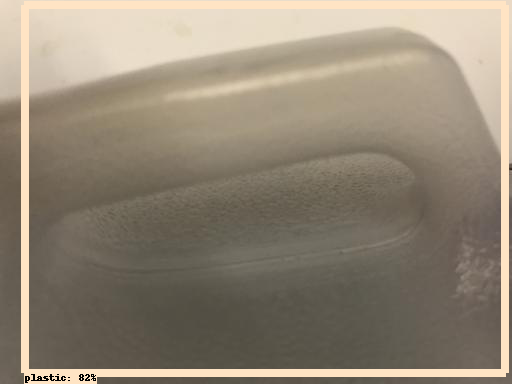

[0.81689817 0.27322832 0.19546108 0.16874364 0.16801323 0.13928333
 0.13101442 0.12934656 0.12350643 0.12043513 0.1165956  0.10741327
 0.10707484 0.0997795  0.09162953 0.08782768 0.07189386 0.07028848
 0.06930307 0.06662266 0.06597719 0.06290594 0.05878646 0.05503764
 0.05481789 0.0535001  0.05341695 0.0522934  0.05218754 0.05186702
 0.05078552 0.05031344 0.04628345 0.04502734 0.04468503 0.04422067
 0.04017508 0.03971168 0.03962976 0.03960788 0.03933063 0.03892852
 0.03867696 0.03810005 0.03759952 0.03735265 0.03653849 0.03614285
 0.03594357 0.03513744 0.03499371 0.03479767 0.03479495 0.03359908
 0.0335551  0.0332802  0.03303535 0.03291856 0.03290961 0.03265088
 0.0323843  0.03175868 0.03166818 0.03160754 0.03131265 0.03125586
 0.03111902 0.03110143 0.03100341 0.03085255 0.03079124 0.03055962
 0.03051109 0.03029228 0.03023444 0.0301752  0.03009797 0.03008433
 0.02998007 0.02993191 0.0295683  0.02942026 0.029006   0.0289672
 0.02884071 0.02870246 0.0286012  0.02855152 0.02852497 0.02845

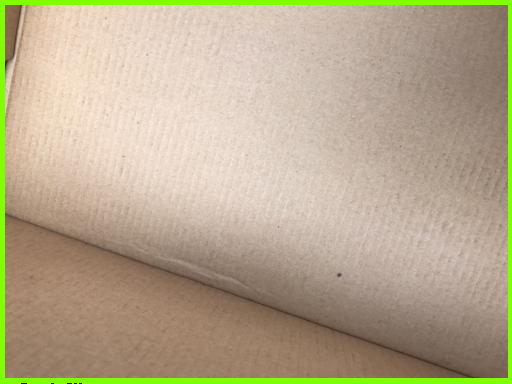

[0.7882223  0.4436268  0.11841566 0.11103678 0.09737168 0.06638648
 0.06531523 0.0652113  0.06258353 0.05815221 0.05742757 0.05635926
 0.05526926 0.05485957 0.0537471  0.0525922  0.05177636 0.04990426
 0.04878739 0.04765461 0.04753126 0.04703331 0.0469572  0.04685182
 0.0456945  0.04545284 0.04399315 0.04342652 0.04307891 0.04283748
 0.04277118 0.04206064 0.04125148 0.04109934 0.04056363 0.03946349
 0.03936694 0.03934713 0.03878665 0.03746911 0.03641414 0.03626982
 0.03617411 0.03590224 0.03582896 0.03560764 0.03545137 0.03524917
 0.03523689 0.03513359 0.03501404 0.03490121 0.03431193 0.03343935
 0.03340432 0.03336883 0.03321796 0.03308434 0.03175545 0.03171735
 0.03135458 0.03128847 0.03127384 0.03124942 0.03055457 0.03046147
 0.03006525 0.02985932 0.02968673 0.02961558 0.02915192 0.02892945
 0.02880149 0.02820561 0.02805755 0.02803918 0.02794085 0.02765823
 0.02764747 0.02729093 0.02713818 0.02713721 0.02704304 0.0269773
 0.02684162 0.02604687 0.02586186 0.02577112 0.02561863 0.02561

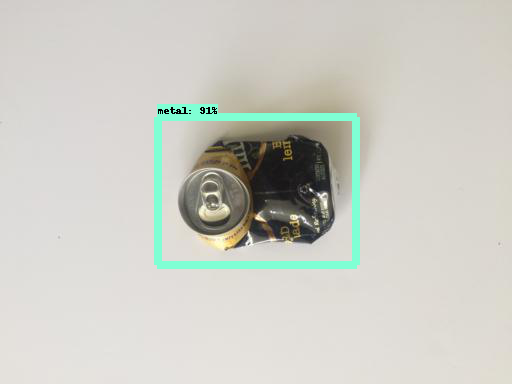

[0.9116752  0.20202664 0.15803482 0.13194296 0.11910933 0.11840466
 0.10399443 0.08925834 0.08546034 0.08369479 0.07763336 0.07725664
 0.06950279 0.06698246 0.06057453 0.05923498 0.0572584  0.05663196
 0.05245041 0.05219898 0.05097239 0.04995866 0.04953497 0.04949372
 0.04589523 0.04481414 0.04408743 0.04380623 0.04355587 0.04347319
 0.04300513 0.04252678 0.03898687 0.03816437 0.03808805 0.03747635
 0.03660857 0.03642567 0.03617602 0.03540514 0.03510548 0.03485107
 0.03481699 0.03458027 0.03410104 0.03377883 0.03352666 0.03335017
 0.03330142 0.03271906 0.03263986 0.03263238 0.03258638 0.03248011
 0.0324327  0.03209452 0.03197183 0.03194846 0.03154419 0.03148244
 0.0313994  0.03138452 0.03069247 0.03056489 0.03039244 0.03015341
 0.03000678 0.02990935 0.02988873 0.02988028 0.02955114 0.02950991
 0.02942771 0.02942273 0.02931874 0.02906604 0.02887259 0.02855541
 0.02841661 0.02823411 0.0282272  0.0281935  0.02810939 0.02770942
 0.02769234 0.02768239 0.0274284  0.0272373  0.02713537 0.0267

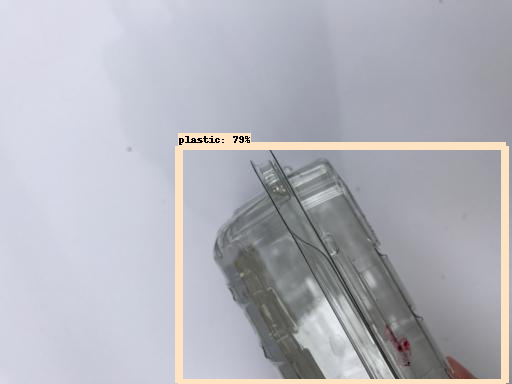

[0.78890395 0.28654778 0.2091822  0.14165644 0.13966988 0.12098223
 0.10140523 0.09928938 0.07596985 0.0718491  0.06472027 0.06358558
 0.06295494 0.05534888 0.05532885 0.05424781 0.05390725 0.05233106
 0.0513283  0.04852532 0.0482021  0.04755354 0.04573433 0.04516544
 0.04447123 0.04397313 0.04348563 0.04339204 0.04316419 0.04282868
 0.03989787 0.03986814 0.03967509 0.03948988 0.03897793 0.03847308
 0.03768181 0.03750335 0.03693157 0.03676045 0.0364863  0.0364628
 0.03645191 0.03598789 0.0355542  0.03511823 0.03504182 0.03457554
 0.03443446 0.03442838 0.0342032  0.03410732 0.03335493 0.03310525
 0.03297564 0.03286667 0.03203958 0.03200725 0.03181095 0.03157104
 0.0310744  0.03094581 0.03084944 0.03082107 0.03071422 0.03063711
 0.03057285 0.03038322 0.02959697 0.02951043 0.02950401 0.02948523
 0.02937369 0.02931611 0.02929141 0.02923265 0.02908209 0.02905218
 0.02896681 0.02889771 0.02863396 0.02847719 0.02801231 0.02773522
 0.02769621 0.0275905  0.02756396 0.02746006 0.02734175 0.02733

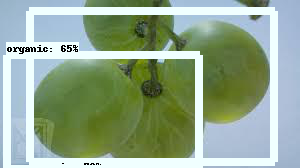

[0.7012843  0.6521572  0.421991   0.25436187 0.2218923  0.2205324
 0.21741083 0.20931733 0.19390082 0.1938113  0.1719001  0.1490384
 0.14084192 0.14046088 0.1368225  0.1319078  0.12758164 0.12687267
 0.12656243 0.12114126 0.11866533 0.11483468 0.11121192 0.1050335
 0.10433273 0.10366117 0.1003952  0.09807727 0.09622017 0.09456829
 0.08957018 0.08897282 0.08549442 0.08312429 0.08194719 0.0815181
 0.0807151  0.08029864 0.0794927  0.07940894 0.07471138 0.07357452
 0.07332548 0.07299449 0.07256726 0.07172792 0.07028016 0.06938396
 0.06876729 0.06821562 0.0661012  0.0641781  0.0640048  0.06266264
 0.06257889 0.06243974 0.06230594 0.06048859 0.05979427 0.05972577
 0.0589444  0.05883874 0.05830734 0.05777055 0.05691864 0.05645324
 0.05636977 0.05610724 0.05502464 0.05486673 0.05379094 0.05301264
 0.05275002 0.05219929 0.05083396 0.05018561 0.05017477 0.04918335
 0.04846785 0.04793141 0.04767087 0.04725019 0.04708232 0.04703353
 0.04641585 0.04622963 0.04548908 0.04506658 0.04472936 0.04470185

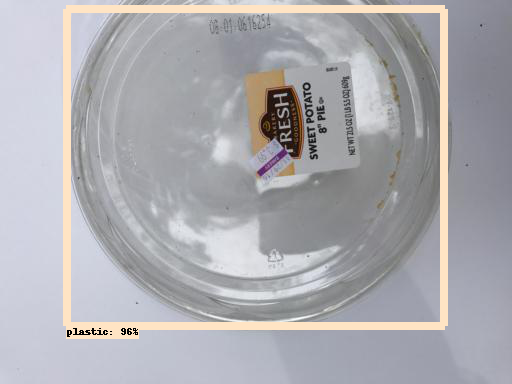

[0.9573769  0.11614133 0.1104179  0.07911076 0.06943891 0.05714116
 0.0534861  0.05316395 0.05211559 0.05202444 0.04715064 0.04545771
 0.04094692 0.03875727 0.0355767  0.03556094 0.03547091 0.03485869
 0.03441148 0.03439758 0.03213369 0.03060273 0.02909972 0.0286337
 0.0284638  0.02811535 0.02799432 0.02797518 0.02783737 0.02739244
 0.0273624  0.02730249 0.02727191 0.02696993 0.02640208 0.02604667
 0.02589235 0.02568761 0.02538381 0.02531358 0.0252392  0.02507322
 0.02473101 0.02425514 0.02371474 0.02362678 0.02353518 0.02331682
 0.02311607 0.0230434  0.02297222 0.02285852 0.02267666 0.0224377
 0.02239898 0.02229775 0.02209057 0.02204952 0.02196111 0.02187501
 0.02185311 0.02159278 0.02157887 0.02134575 0.02133977 0.02128623
 0.02101699 0.02072403 0.02050609 0.02042246 0.02031161 0.02030252
 0.0202481  0.02023585 0.02015426 0.02012094 0.02009968 0.01996207
 0.01979575 0.01940588 0.01921875 0.01920293 0.01911935 0.01903198
 0.01884191 0.01882027 0.01863968 0.018384   0.01834342 0.018248

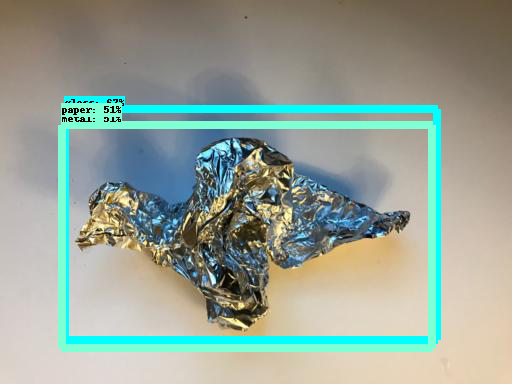

[0.6690379  0.5121007  0.5100748  0.47180262 0.23322812 0.16169925
 0.10434084 0.10315806 0.08072989 0.07873445 0.05532419 0.0536638
 0.05347858 0.05140578 0.0512449  0.05050617 0.04628026 0.04539204
 0.04444844 0.0427877  0.04107209 0.04069554 0.04058769 0.0386298
 0.03724118 0.03706681 0.03577973 0.03562076 0.03520627 0.03505957
 0.03481183 0.03459576 0.03438275 0.03332511 0.03328732 0.03323079
 0.03291755 0.03280244 0.03270463 0.03258657 0.0317081  0.03164822
 0.03149304 0.03133657 0.03116351 0.03081426 0.03070497 0.03056592
 0.03056033 0.03044066 0.03040828 0.03003473 0.03000389 0.02996084
 0.02931245 0.02930191 0.02925663 0.02912755 0.02891862 0.02822065
 0.02806638 0.02801571 0.0277611  0.02760115 0.02725026 0.02715957
 0.02714792 0.02692569 0.02663148 0.02635086 0.02621377 0.02601534
 0.02597547 0.02568678 0.02563431 0.02540979 0.02539638 0.02525006
 0.02523924 0.02521924 0.02506287 0.02504965 0.02498766 0.02490968
 0.02463773 0.02457098 0.02451275 0.02446786 0.02444749 0.024312

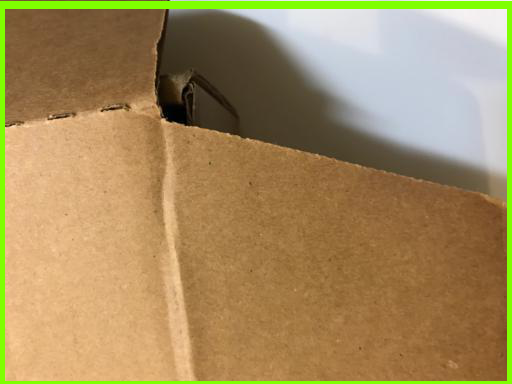

[0.95245713 0.15713264 0.11236608 0.10477704 0.09749956 0.08667533
 0.08522004 0.08505916 0.08039638 0.07994469 0.07986497 0.07921623
 0.07476153 0.07213098 0.06996177 0.06958403 0.06433177 0.06211352
 0.06087115 0.06070391 0.06037822 0.0603596  0.06035181 0.05950725
 0.05891598 0.05761929 0.05740954 0.05629196 0.05620652 0.05359206
 0.05262721 0.05083686 0.05070392 0.05021459 0.04995502 0.04941944
 0.04760212 0.04688839 0.04640531 0.0459679  0.04357695 0.04128405
 0.04118071 0.04107538 0.04067929 0.04029003 0.04003987 0.03982212
 0.03861793 0.03849643 0.03842925 0.03813743 0.0380703  0.03801924
 0.03797318 0.03783257 0.03734554 0.03704799 0.03692794 0.03688804
 0.0367091  0.03668933 0.03655312 0.0365365  0.03608247 0.03572252
 0.03513476 0.0350315  0.03493724 0.03484264 0.03472976 0.03460866
 0.03460183 0.03434391 0.03425237 0.03416039 0.03413646 0.03390885
 0.0338706  0.03290446 0.03280444 0.03259876 0.03233038 0.03215667
 0.03209739 0.03187424 0.03166008 0.03161383 0.03108876 0.0310

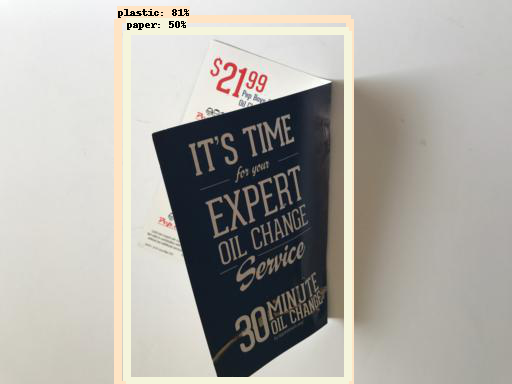

[0.8081269  0.5012002  0.38239577 0.24537995 0.1873162  0.1410854
 0.11372602 0.10486469 0.09147386 0.08505005 0.05788342 0.05677566
 0.05563314 0.05556431 0.05177182 0.0478925  0.04668136 0.04616179
 0.04315122 0.04294571 0.04024277 0.03953492 0.03758546 0.03729508
 0.03686146 0.03659159 0.03602263 0.03517375 0.03502957 0.03402143
 0.0338701  0.03333866 0.03254404 0.03183782 0.03174485 0.03171661
 0.03124306 0.03114795 0.03102328 0.03067535 0.03028359 0.03026949
 0.0299934  0.02962124 0.02931606 0.02926786 0.02879259 0.02863717
 0.02826704 0.02741424 0.02710655 0.0268628  0.02667022 0.02628024
 0.02626448 0.02558288 0.02544374 0.02516023 0.02512941 0.02510644
 0.02508777 0.02498277 0.02477525 0.02465015 0.02445542 0.02434396
 0.02426782 0.02421061 0.0237244  0.0236096  0.02347434 0.02346054
 0.02336165 0.02323471 0.02317797 0.02306056 0.02304807 0.02295944
 0.02286112 0.02265139 0.02264395 0.02261092 0.02259639 0.02258274
 0.02236741 0.02235803 0.02226714 0.02224944 0.02222554 0.02221

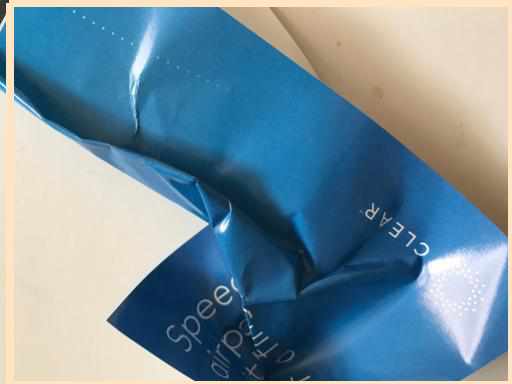

[0.7591653  0.4014594  0.39160836 0.31187004 0.21308672 0.14841665
 0.1475367  0.11324413 0.10181271 0.08998247 0.07642097 0.07590809
 0.07424495 0.07384427 0.06924551 0.06845488 0.06722803 0.0651886
 0.06313521 0.06154665 0.05951214 0.05827649 0.05803097 0.0579484
 0.05442894 0.05439778 0.05221112 0.05115483 0.05038569 0.04878383
 0.0476937  0.0468342  0.04634514 0.04533649 0.04478097 0.04360881
 0.04259937 0.04230113 0.04148072 0.04121949 0.04055238 0.04033342
 0.0402654  0.04020458 0.03975175 0.03906823 0.03813955 0.03813434
 0.03763332 0.03721281 0.03701476 0.03651976 0.03648018 0.03523594
 0.03503322 0.03443626 0.03386183 0.03359029 0.03287853 0.03258666
 0.03231769 0.03216075 0.03202792 0.03183245 0.03170718 0.03127778
 0.03123104 0.03082687 0.03066671 0.0305622  0.03026646 0.02968012
 0.02938306 0.02934425 0.02917695 0.0289817  0.02893475 0.02887861
 0.02887555 0.02876666 0.027754   0.02770124 0.02749804 0.0274638
 0.02742044 0.02730585 0.02724505 0.02720599 0.02710465 0.0266842

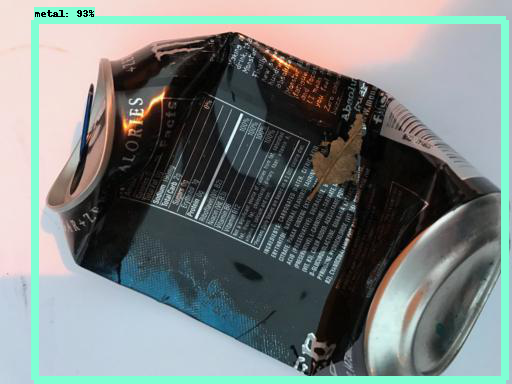

[0.93216395 0.13745843 0.09132247 0.06386628 0.05932302 0.05528583
 0.05269241 0.04192746 0.04190158 0.04129718 0.04120105 0.03959567
 0.03849665 0.03805928 0.03791733 0.03773789 0.03721448 0.037174
 0.03555442 0.03471802 0.03469134 0.03409695 0.03381399 0.03327513
 0.03090723 0.0304723  0.03034053 0.030256   0.03012217 0.02958306
 0.02905643 0.02889978 0.02880112 0.02869178 0.02864443 0.02833391
 0.02776914 0.02773682 0.02762158 0.02756394 0.02714992 0.02705662
 0.02695451 0.02672962 0.02618976 0.02595653 0.02547797 0.02542576
 0.02539772 0.02524913 0.02512252 0.02511823 0.02500329 0.02491476
 0.02486802 0.02479449 0.02477138 0.02470044 0.0243983  0.02414669
 0.02398949 0.02382314 0.02372378 0.02371317 0.0236754  0.02334246
 0.02332174 0.02325014 0.02315948 0.02308403 0.02271306 0.02258313
 0.02250285 0.0224968  0.0224856  0.022457   0.02207461 0.02207454
 0.02206076 0.02203711 0.02195675 0.02180432 0.0216297  0.02158524
 0.02158095 0.02148092 0.02142361 0.0214166  0.02126834 0.021217

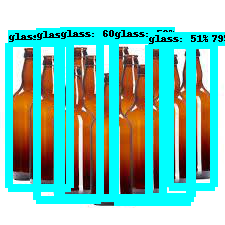

[0.78571326 0.7200911  0.69533294 0.6747411  0.60388553 0.5919792
 0.5146039  0.48027796 0.27132243 0.26848808 0.22806107 0.20221497
 0.18032242 0.16864288 0.16354525 0.1605095  0.15233383 0.14775485
 0.14575024 0.13535953 0.13099706 0.12710665 0.12690918 0.12689042
 0.12635317 0.11735287 0.11250323 0.11011783 0.10988666 0.10983963
 0.10975359 0.10882287 0.10259928 0.09676473 0.09578241 0.09565229
 0.09501263 0.0935054  0.09325761 0.0930393  0.09138021 0.09032156
 0.08847943 0.08711845 0.08624054 0.08607989 0.0859575  0.0859011
 0.08472255 0.08235279 0.08218292 0.08101203 0.08049443 0.07990333
 0.07975873 0.07954469 0.07900352 0.07867842 0.07844024 0.07683705
 0.07641301 0.07631861 0.07622671 0.07457606 0.07366006 0.07332217
 0.07203975 0.07197269 0.07183642 0.07179157 0.07129484 0.06990696
 0.06938136 0.06860904 0.06816089 0.06798441 0.06749079 0.06743832
 0.06722946 0.06660728 0.06577483 0.06529714 0.06473643 0.06387308
 0.06331369 0.06269311 0.06126174 0.06047082 0.06024061 0.060223

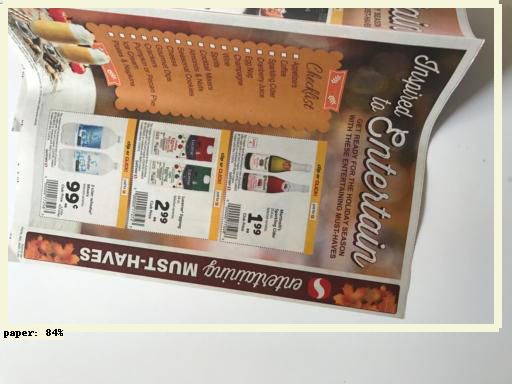

[0.84398556 0.28310788 0.20781754 0.18337512 0.16224407 0.10751936
 0.10079321 0.09525293 0.09325527 0.08781273 0.07819883 0.06753209
 0.05936177 0.05730997 0.05659543 0.05118701 0.04972069 0.04771473
 0.04370122 0.04312525 0.04217747 0.04207331 0.04056531 0.04047039
 0.03911879 0.0389547  0.0361838  0.03537926 0.03462398 0.03434659
 0.03425195 0.03347288 0.03279246 0.0319131  0.03186312 0.03139347
 0.03040624 0.030148   0.02984187 0.02914241 0.02881094 0.02799057
 0.02753788 0.02732137 0.02698057 0.02644199 0.02639212 0.02627834
 0.02624748 0.02613419 0.02611708 0.02595433 0.02566179 0.0256502
 0.0256064  0.02535774 0.02506048 0.0249719  0.02475995 0.0246133
 0.02428805 0.02415006 0.02394496 0.02375881 0.02370257 0.02354491
 0.02353095 0.02327926 0.02287659 0.02286895 0.02263933 0.02238984
 0.02215589 0.0220419  0.0219866  0.02175041 0.02161735 0.02158977
 0.02158245 0.02157285 0.02147392 0.02144535 0.02131732 0.02098343
 0.02094768 0.02082767 0.02072843 0.02057086 0.02054027 0.020415

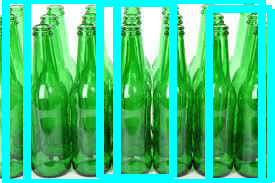

[0.7226368  0.6125471  0.60167015 0.5514373  0.49951887 0.4988481
 0.42749482 0.31437257 0.24993654 0.19640926 0.18171073 0.1712124
 0.16484646 0.14773089 0.1397625  0.13172533 0.12755176 0.11994901
 0.11402803 0.10938895 0.10790592 0.10760461 0.10657068 0.10381679
 0.09990397 0.0995402  0.09929052 0.09806711 0.09665311 0.0962494
 0.09341314 0.09334977 0.09267178 0.09225579 0.09149472 0.09074217
 0.08966472 0.08839572 0.08832558 0.0840843  0.07838129 0.07768232
 0.07673522 0.07602175 0.07580209 0.07561733 0.07488147 0.07449453
 0.07366361 0.07338636 0.0731685  0.07199835 0.07142432 0.07040243
 0.06938403 0.06770101 0.06700373 0.06660333 0.0651205  0.06419625
 0.06284025 0.06276043 0.06268706 0.06163992 0.0611199  0.06107577
 0.06043912 0.05968576 0.0594712  0.05762442 0.05739201 0.05625302
 0.05475317 0.05431885 0.05428475 0.05240872 0.05240693 0.05206532
 0.05121408 0.05097846 0.05061365 0.05051909 0.04982005 0.04974238
 0.04923602 0.04891019 0.04834267 0.04827374 0.04778225 0.0477049

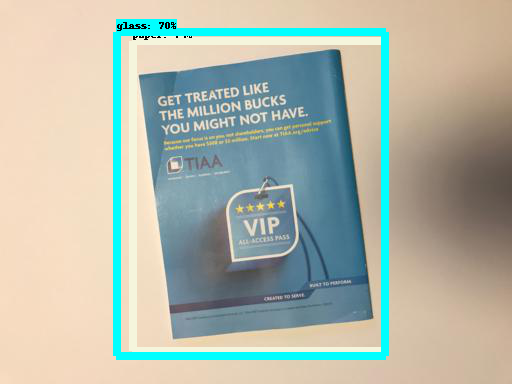

[0.74398726 0.7017719  0.3996358  0.3172834  0.12489917 0.12374575
 0.10018344 0.0699854  0.05942165 0.05751816 0.05184109 0.04972942
 0.04936022 0.04311022 0.03999352 0.03802998 0.03755184 0.03622577
 0.03616151 0.03324539 0.03324127 0.03122863 0.03093031 0.03087726
 0.03062672 0.03020569 0.03008454 0.02999977 0.02999196 0.02946599
 0.02909667 0.0290613  0.02862909 0.02780332 0.02771652 0.02762632
 0.02718112 0.02715856 0.02707931 0.02705044 0.02695264 0.02651163
 0.02641447 0.02634838 0.02631521 0.02613862 0.02579746 0.0257849
 0.02562507 0.02539525 0.02524165 0.02500242 0.02494252 0.02491882
 0.02481459 0.02477508 0.02476832 0.0243924  0.02428924 0.02411791
 0.02390932 0.02380239 0.02346805 0.02344346 0.02337701 0.02326191
 0.02296335 0.02284202 0.02279691 0.02254464 0.0225303  0.02243412
 0.02232111 0.02224025 0.02222705 0.02219315 0.0220573  0.02196673
 0.02196045 0.0218796  0.02170051 0.02153945 0.0214873  0.02141158
 0.02136633 0.02118148 0.02114229 0.02107213 0.02101272 0.02096

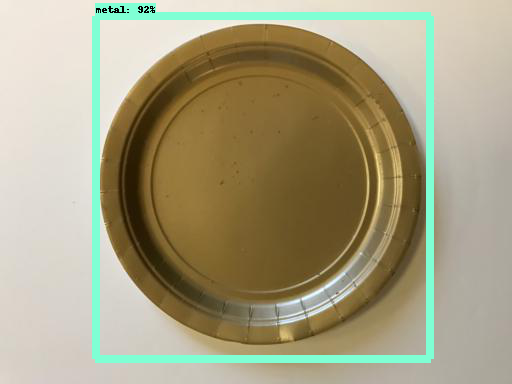

[0.9198125  0.29006162 0.27263168 0.15126629 0.1497871  0.0864378
 0.04592008 0.04440461 0.04259402 0.04041047 0.03734603 0.03497944
 0.03326137 0.03237421 0.03231727 0.03072396 0.03033317 0.0293323
 0.0287966  0.02841228 0.02801    0.02762948 0.02761011 0.02695562
 0.02664109 0.02652832 0.02578887 0.02571591 0.02504807 0.02483175
 0.02476998 0.02475287 0.02469244 0.0246897  0.02446675 0.02445271
 0.0241646  0.02415086 0.0238907  0.02353036 0.02337331 0.02324444
 0.02316164 0.02295865 0.02279982 0.02271855 0.02242281 0.02177141
 0.02173541 0.02149439 0.02121953 0.02117861 0.02068968 0.02065147
 0.02048619 0.02041519 0.02014985 0.02005299 0.01993937 0.01991572
 0.01985211 0.01972889 0.01972548 0.0195515  0.01944357 0.01938923
 0.01937214 0.01928758 0.01921086 0.01918852 0.01917814 0.01895642
 0.01893433 0.01889106 0.0188419  0.01867817 0.01859876 0.01856015
 0.01853628 0.01850919 0.018381   0.01825257 0.01823335 0.01817627
 0.018161   0.01815017 0.01813121 0.01812082 0.01808273 0.018026

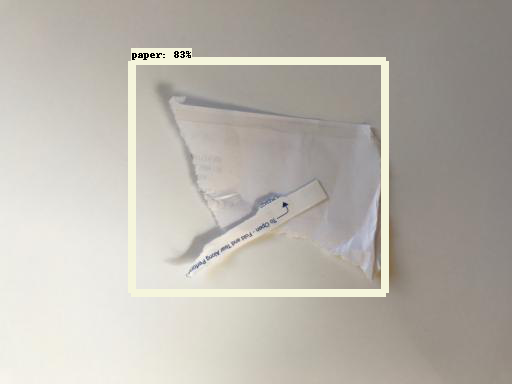

[0.8331334  0.37492883 0.24689403 0.16624112 0.12840827 0.12588556
 0.12264411 0.10058033 0.10052104 0.09365416 0.08298203 0.07367658
 0.06102605 0.05995866 0.0594486  0.05871401 0.05418529 0.05192997
 0.04984673 0.04885877 0.0482101  0.04619261 0.04433564 0.04343928
 0.04210575 0.04053244 0.03890325 0.03855826 0.03735565 0.03697725
 0.0367487  0.03621848 0.03604925 0.03574851 0.0353899  0.03516415
 0.03397047 0.03396968 0.03360895 0.03355415 0.03317147 0.0329349
 0.03256582 0.03250535 0.03212853 0.03192776 0.03153042 0.03146443
 0.03136306 0.03111618 0.03054156 0.03034992 0.03013864 0.03012942
 0.03011612 0.0300744  0.03002672 0.03002505 0.0300088  0.02995561
 0.02967758 0.02963435 0.02936853 0.02935054 0.02926322 0.02900457
 0.02899278 0.02891448 0.02887914 0.02885793 0.02874644 0.02816144
 0.02809055 0.02808809 0.02797698 0.02789769 0.02772467 0.02741366
 0.02715948 0.0268201  0.02680427 0.0265803  0.02640654 0.02610895
 0.0260102  0.02555079 0.0255332  0.0254732  0.02537445 0.02508

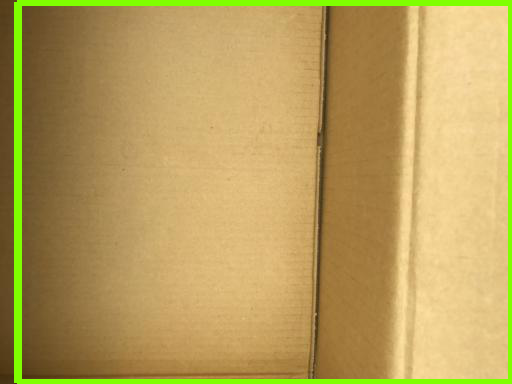

[0.88046986 0.19210657 0.1501138  0.119886   0.10244633 0.10165274
 0.10145053 0.09303308 0.09138155 0.08564643 0.08072191 0.07809049
 0.07768634 0.07707522 0.07688405 0.07269251 0.07005255 0.06635622
 0.06525449 0.06063366 0.060171   0.05541296 0.05487157 0.05474806
 0.05384848 0.05314036 0.05311344 0.05191651 0.0511358  0.05102524
 0.05087249 0.05020495 0.04981992 0.04750085 0.04535396 0.04532591
 0.04525664 0.04484791 0.04461735 0.04263869 0.04206522 0.04188368
 0.04172507 0.0416631  0.04142288 0.0414138  0.04133575 0.04126135
 0.04106105 0.04087127 0.04066464 0.04004178 0.03946301 0.03944865
 0.03901055 0.03900623 0.03847189 0.03801832 0.03786002 0.03769879
 0.0376327  0.03730152 0.03721244 0.03643704 0.03636171 0.03614167
 0.03575647 0.03548525 0.03430219 0.03392813 0.03370205 0.03355969
 0.03329739 0.03307379 0.03231576 0.03209598 0.03205527 0.03203256
 0.03201916 0.03191571 0.03156506 0.0314432  0.03118419 0.03118162
 0.03107139 0.03076578 0.03060449 0.03055738 0.03036276 0.0301

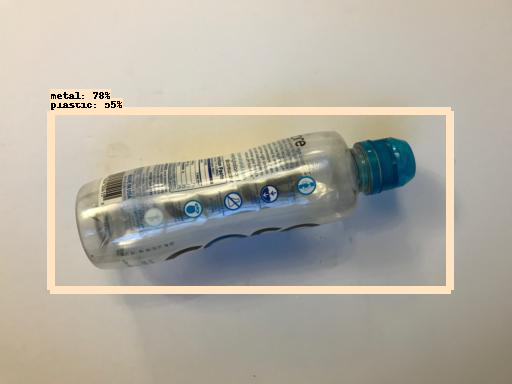

[0.7816245  0.5504431  0.15300731 0.152532   0.13758922 0.13282461
 0.11632447 0.10985051 0.08294299 0.07976531 0.07147048 0.06657855
 0.064931   0.05954887 0.05844361 0.05678711 0.05599417 0.05578112
 0.05318165 0.05310696 0.05278756 0.04454437 0.04393023 0.04345831
 0.04038551 0.03887148 0.03762165 0.03686143 0.03682498 0.03653651
 0.0364618  0.0364175  0.03630665 0.03588244 0.03453236 0.03450154
 0.03314366 0.0325692  0.03191165 0.0318369  0.03179631 0.03154531
 0.03120617 0.03087685 0.03081189 0.03041165 0.0302821  0.0295772
 0.02902379 0.02897267 0.02886951 0.02877234 0.02870387 0.02844229
 0.02836963 0.02830624 0.02801039 0.02737499 0.02722973 0.02719232
 0.02714738 0.02699025 0.02691175 0.02677871 0.02676588 0.02638944
 0.02629537 0.02623943 0.02607406 0.02603522 0.0260105  0.02594803
 0.02575821 0.0257387  0.02568088 0.02560942 0.02559496 0.02543456
 0.02533537 0.02521793 0.0251259  0.02506598 0.02488041 0.0248573
 0.02477849 0.02476224 0.02466779 0.02458447 0.02450402 0.024452

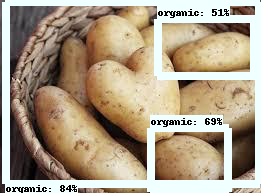

[0.83597195 0.6871797  0.5126704  0.4977508  0.372129   0.3457928
 0.28541166 0.2758958  0.23101944 0.22999586 0.20381413 0.19633366
 0.19612385 0.19477172 0.1848534  0.17425641 0.17424065 0.17127877
 0.16917546 0.16760409 0.16192032 0.15738559 0.15378527 0.14423414
 0.14289688 0.14264357 0.13996994 0.13988484 0.13909057 0.13024661
 0.12594688 0.12443356 0.12400255 0.12191349 0.12158094 0.11925106
 0.11643633 0.11193421 0.11090204 0.11040313 0.1081339  0.10223622
 0.10122134 0.10101893 0.09887797 0.09784248 0.096906   0.09610774
 0.0950297  0.09460796 0.09383442 0.092224   0.09218046 0.09052618
 0.09034279 0.09025793 0.08992337 0.08888613 0.08885453 0.0869684
 0.08673131 0.0850144  0.08479023 0.08449082 0.08437966 0.08433789
 0.08371783 0.08355638 0.08312846 0.08241576 0.08239188 0.08208515
 0.08205458 0.08202363 0.0812675  0.08115777 0.08057459 0.07873997
 0.07790178 0.07757287 0.07751872 0.07678199 0.07618263 0.07412881
 0.07349482 0.07344712 0.07320324 0.07285166 0.07234833 0.071897

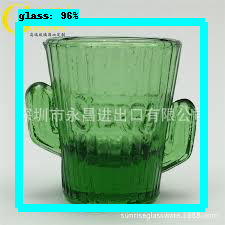

[0.96310157 0.20721805 0.19063824 0.14999008 0.1393265  0.10769434
 0.10350855 0.1000241  0.09682114 0.08852916 0.08728722 0.08579095
 0.08319174 0.0768927  0.07655149 0.07334334 0.07310599 0.06919052
 0.06837606 0.06625279 0.06110923 0.06087166 0.0598971  0.05667217
 0.05640863 0.05484816 0.053634   0.05337914 0.05285631 0.05190884
 0.05182954 0.05057592 0.05048966 0.04942128 0.04913941 0.04796981
 0.0465982  0.04584325 0.04573941 0.04456396 0.04455326 0.04437879
 0.04382813 0.0438205  0.04174122 0.04170574 0.04160632 0.04156685
 0.04120054 0.04114559 0.04088476 0.04077861 0.04051982 0.04035848
 0.04019825 0.04014029 0.04010144 0.039617   0.03946965 0.03909236
 0.03899889 0.0387467  0.0382846  0.03770076 0.03731029 0.03699388
 0.03642676 0.03604604 0.03589616 0.03568042 0.03544745 0.03514318
 0.03428128 0.03413875 0.03390076 0.03390024 0.03375665 0.03321668
 0.03300393 0.03284034 0.03218678 0.03201802 0.03181709 0.03163413
 0.03151221 0.03104441 0.0308147  0.0307606  0.03068848 0.0305

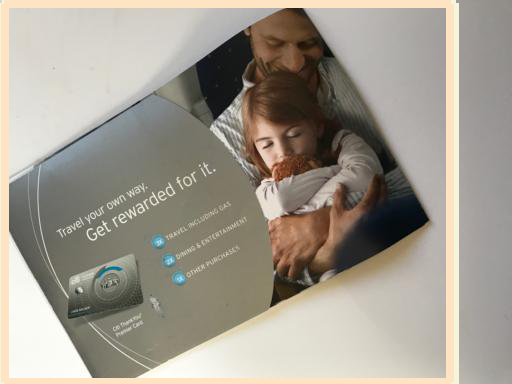

[0.56336343 0.5518934  0.505009   0.1584592  0.13736703 0.09036919
 0.08358923 0.07909603 0.04887693 0.04398494 0.03657252 0.03641754
 0.03578218 0.03529977 0.03446768 0.03293398 0.03125792 0.02912414
 0.02901936 0.0279392  0.0271923  0.0270242  0.02641468 0.02631241
 0.0257472  0.02569627 0.02555108 0.02543416 0.02500691 0.02476091
 0.02450419 0.0243363  0.02417615 0.0237655  0.02359999 0.023291
 0.02323643 0.02314441 0.02291755 0.0228986  0.022895   0.02282114
 0.0228198  0.0228068  0.02264643 0.02258209 0.02257772 0.02249488
 0.02240298 0.02226069 0.02225478 0.02222977 0.02211529 0.02199181
 0.02190592 0.02187284 0.02175774 0.02171234 0.02170398 0.02168704
 0.02161816 0.0213535  0.0213489  0.02126269 0.02121097 0.02103011
 0.02094587 0.02085279 0.02083734 0.02076184 0.02068603 0.02052668
 0.02032966 0.02028837 0.02008078 0.02003148 0.02002833 0.01995838
 0.01988409 0.01976818 0.01959673 0.01950559 0.01940411 0.01936522
 0.01930813 0.01920445 0.01919661 0.01903424 0.01895678 0.018909

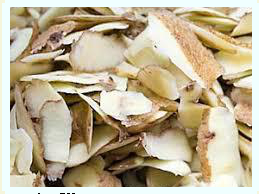

[0.7517561  0.55601364 0.12993562 0.11453266 0.1042421  0.08425601
 0.08364909 0.07897677 0.07681964 0.07631119 0.07397007 0.0616184
 0.05915676 0.05819089 0.0580293  0.0573484  0.05510201 0.05421159
 0.05270885 0.05195994 0.05138459 0.04737744 0.04544445 0.04531526
 0.04246394 0.04048884 0.03974329 0.03947424 0.03928877 0.03866326
 0.03811406 0.03771137 0.03754841 0.03596951 0.03590445 0.03559032
 0.03557823 0.03531509 0.03530774 0.03523472 0.03443219 0.03426047
 0.03423295 0.03409061 0.03394217 0.03386803 0.03365939 0.03321655
 0.03314904 0.03314303 0.03299953 0.03263507 0.03263156 0.0325621
 0.0325446  0.0322279  0.0319154  0.0319102  0.03176496 0.03162579
 0.03159511 0.03153268 0.03141575 0.0313137  0.03096158 0.0308589
 0.03079635 0.03062468 0.03020478 0.03017028 0.03013274 0.02967716
 0.0296754  0.02965488 0.02947403 0.02943476 0.0291584  0.0291221
 0.02876364 0.02866811 0.0286094  0.0285684  0.02835527 0.02831851
 0.0282845  0.02798512 0.02790721 0.02772656 0.02769238 0.02752694

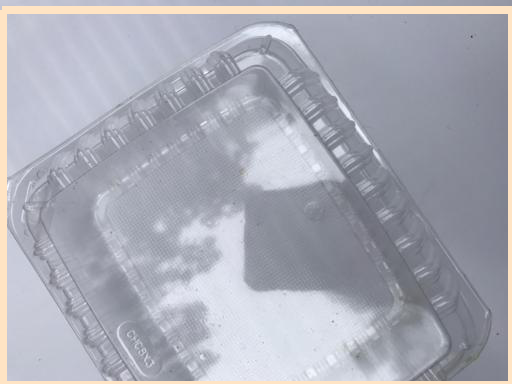

[0.9565263  0.12063119 0.08463818 0.08258072 0.07969467 0.07529466
 0.07289605 0.06452017 0.06395672 0.06156625 0.05881301 0.05723891
 0.05697741 0.05548769 0.05272334 0.05128916 0.05006575 0.04669846
 0.04625938 0.04614824 0.04455161 0.0430284  0.04256699 0.04250577
 0.04224093 0.04109588 0.04072397 0.03848234 0.03800033 0.03773841
 0.03732393 0.03724787 0.03678154 0.03605336 0.03596323 0.03581114
 0.03540742 0.0351097  0.03503235 0.03453775 0.03390636 0.0336813
 0.03357548 0.03351309 0.03221511 0.03216524 0.03182852 0.03160002
 0.0313274  0.03131743 0.03020803 0.03015462 0.0298951  0.029729
 0.02946215 0.02860633 0.02839947 0.02818272 0.02793939 0.02772114
 0.02734828 0.02726928 0.02710389 0.02695986 0.02690585 0.02689336
 0.02686949 0.02672762 0.02619289 0.02608403 0.02595702 0.02591945
 0.02565968 0.02563411 0.02545082 0.02521427 0.0251776  0.02486853
 0.02480415 0.0243485  0.02430525 0.02419381 0.02409129 0.0235389
 0.02331098 0.02323864 0.02322117 0.02302008 0.02284085 0.02281649

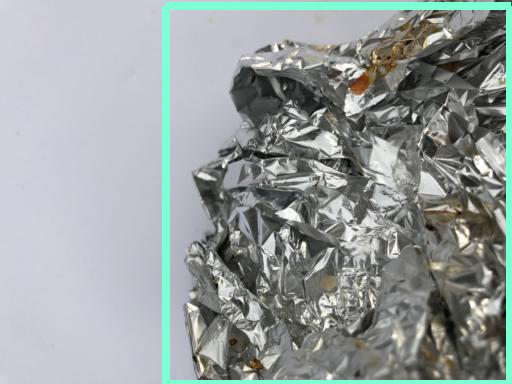

[0.8734466  0.18893822 0.17599048 0.1183849  0.11255941 0.09711723
 0.07501081 0.06542169 0.05531853 0.05177999 0.04859466 0.04649207
 0.04194022 0.04138165 0.04135388 0.04127873 0.04027619 0.03978514
 0.03945502 0.03934839 0.03873692 0.03853798 0.03794917 0.03788022
 0.03729381 0.03688427 0.03526242 0.03480896 0.03473203 0.03464352
 0.03423416 0.03363795 0.03317441 0.03290367 0.03231924 0.03158355
 0.03096551 0.03058462 0.03021192 0.03011612 0.02998463 0.029967
 0.02979632 0.02973634 0.0296475  0.02957647 0.02954351 0.02936243
 0.02935244 0.02928954 0.0291535  0.02889225 0.02876644 0.02876136
 0.02872878 0.02871013 0.02871008 0.02860552 0.02851425 0.02831972
 0.02829669 0.02821561 0.02791127 0.02788753 0.02754745 0.02750359
 0.02742783 0.02723117 0.02719744 0.02711163 0.02710719 0.02706104
 0.0269952  0.0269195  0.0268448  0.02676816 0.02658665 0.0264015
 0.02639394 0.02636306 0.02623083 0.02622675 0.02604981 0.02571326
 0.02568954 0.02539986 0.02534184 0.02525577 0.02513778 0.0247949

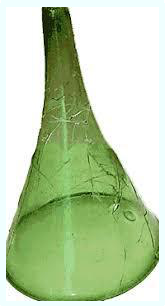

[0.8232357  0.47549248 0.13134716 0.12602745 0.1221924  0.09567304
 0.09177759 0.08847103 0.08141758 0.08019571 0.07386161 0.07113064
 0.05785301 0.05713439 0.05415637 0.05257059 0.05239291 0.05226747
 0.05202217 0.05152418 0.05066407 0.05011133 0.04995665 0.04898537
 0.04855219 0.04597067 0.0424448  0.04209555 0.04150816 0.03934411
 0.03921861 0.03819139 0.03777587 0.03759431 0.03751739 0.0372122
 0.03689377 0.03689261 0.03679135 0.03673292 0.03648036 0.0358226
 0.03505344 0.0346487  0.03448845 0.0342737  0.03390364 0.03379192
 0.03368149 0.03367859 0.0334495  0.03344336 0.03315461 0.03270174
 0.03263009 0.03239319 0.03236581 0.03211601 0.03184994 0.0317893
 0.03165166 0.03160382 0.0315255  0.03144368 0.0313502  0.03121919
 0.03119649 0.03111628 0.03107585 0.03106418 0.03024422 0.02994639
 0.02979674 0.02967253 0.02960299 0.02952308 0.0294643  0.02944847
 0.02935527 0.02935448 0.02919187 0.02907689 0.02881845 0.02873258
 0.02822262 0.0282177  0.02794347 0.02775003 0.02762769 0.0275632

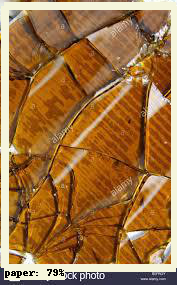

[0.78901684 0.48402187 0.21346965 0.1624796  0.15539262 0.1461172
 0.11925589 0.11081121 0.09691543 0.09613214 0.08817397 0.08720535
 0.0861912  0.08313684 0.08281656 0.08141655 0.07219702 0.06512277
 0.06171332 0.05652565 0.05477127 0.05206049 0.05033063 0.04931282
 0.04894607 0.04835651 0.04622433 0.04612513 0.04588965 0.04515324
 0.04394994 0.04321332 0.04309084 0.04279664 0.0427679  0.04261297
 0.04167778 0.04106335 0.04037155 0.03998761 0.03996465 0.03925254
 0.03924472 0.03915627 0.03854688 0.03774934 0.03769568 0.03656238
 0.03533097 0.03531617 0.03519867 0.03458428 0.03428959 0.03422705
 0.03387671 0.03355142 0.03320797 0.03318335 0.03308142 0.03303408
 0.03267748 0.03262581 0.03227373 0.03192764 0.0315544  0.0314834
 0.03145067 0.03122673 0.03116314 0.03115742 0.03102298 0.03091234
 0.03090189 0.03073579 0.03051626 0.03042588 0.02985754 0.02971448
 0.02950359 0.02946244 0.02914824 0.0289315  0.02888645 0.02888358
 0.02861859 0.02856171 0.02821046 0.02809415 0.02797738 0.027628

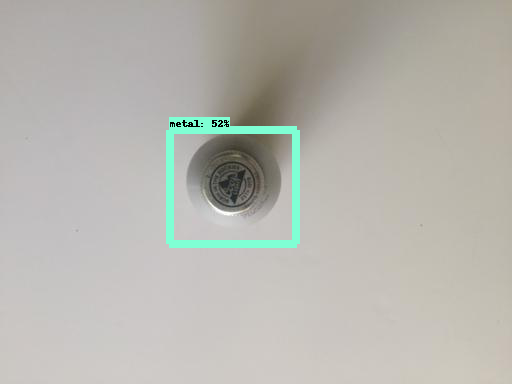

[0.5215027  0.31495473 0.2402122  0.1959939  0.13893187 0.13203758
 0.11682611 0.11537411 0.11456842 0.11378445 0.11151684 0.09400523
 0.08653761 0.08564693 0.08120694 0.07304898 0.0728214  0.06854824
 0.06746425 0.06627151 0.06598355 0.06515832 0.06229033 0.06173266
 0.0602875  0.06015094 0.06003805 0.05987265 0.05780962 0.05767382
 0.0560815  0.05601684 0.054819   0.05290434 0.0511078  0.05102632
 0.04980167 0.04937825 0.04836647 0.04792754 0.04786226 0.04769942
 0.04737293 0.04700924 0.04664391 0.04646901 0.04628813 0.04622084
 0.04609844 0.04545337 0.0448832  0.04408066 0.04356425 0.04333787
 0.04261133 0.04258566 0.04255902 0.0421226  0.04187301 0.04122207
 0.04072947 0.04063906 0.0401953  0.039417   0.03935105 0.03914512
 0.03902945 0.03890487 0.03883835 0.03849759 0.03827379 0.03822164
 0.03808624 0.03789168 0.03765256 0.03753332 0.03751039 0.03748835
 0.03725785 0.03724188 0.03702658 0.03680567 0.0366936  0.0364631
 0.03617757 0.03606186 0.03605063 0.03585767 0.03561087 0.03535

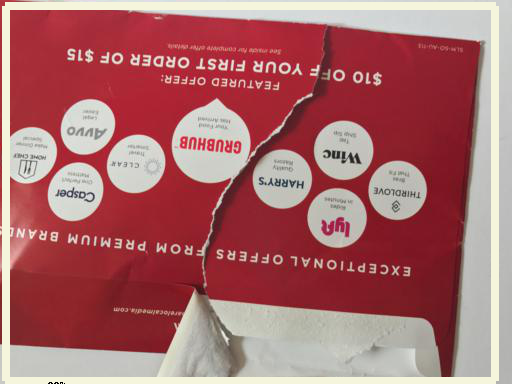

[0.8771945  0.22708419 0.20911554 0.13863496 0.1376827  0.09481445
 0.06268214 0.05574226 0.04888067 0.04811166 0.04609316 0.04523836
 0.04307311 0.04113634 0.04089915 0.04088672 0.03945746 0.03924814
 0.03859758 0.03784012 0.03580193 0.0349341  0.03467119 0.03428351
 0.03406273 0.03249459 0.03068176 0.02854427 0.0283722  0.02779018
 0.0276469  0.02697721 0.02693826 0.02655809 0.02626954 0.02607648
 0.0258184  0.02574984 0.02570658 0.02514484 0.02452995 0.02411911
 0.02411461 0.02392928 0.02349374 0.02344229 0.02297981 0.02294521
 0.02278783 0.02271341 0.02266816 0.02265995 0.02235211 0.02224795
 0.02210296 0.0219362  0.02193242 0.02180323 0.02165326 0.0215017
 0.02148863 0.02146613 0.02145558 0.02116434 0.02111126 0.02093084
 0.02060817 0.02035634 0.02033805 0.02031662 0.02028694 0.02024516
 0.02024107 0.02019693 0.02007586 0.02005561 0.01993223 0.01985213
 0.01981889 0.0198159  0.01965792 0.01962389 0.01931376 0.01930091
 0.01929196 0.0192708  0.01917979 0.01910895 0.01898407 0.01895

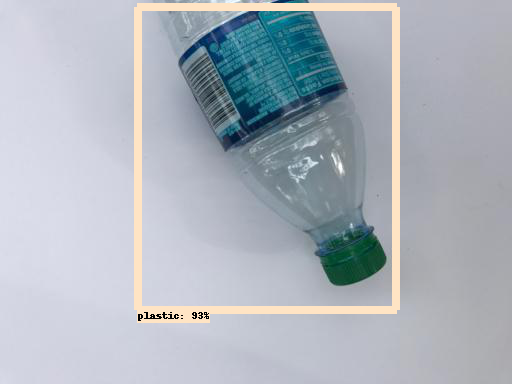

[0.9322187  0.26097918 0.17128694 0.15302366 0.1266455  0.11968685
 0.11867304 0.10604507 0.10359791 0.08804516 0.08073773 0.07627848
 0.06845992 0.06737837 0.06473683 0.06206924 0.06109568 0.05832454
 0.05644607 0.05562706 0.0548296  0.0544127  0.0531142  0.05246976
 0.05182441 0.04921895 0.04694843 0.04683416 0.04645204 0.04528446
 0.04493908 0.04459335 0.04137329 0.04128197 0.04069193 0.04043199
 0.04004654 0.03979375 0.03968121 0.03964637 0.03948465 0.03888166
 0.03885051 0.03829544 0.03790119 0.03781655 0.03739773 0.03706872
 0.03689476 0.03678175 0.03603204 0.03595396 0.03565651 0.03562056
 0.03489764 0.03460993 0.03420622 0.03407164 0.03384502 0.033703
 0.0335909  0.0335811  0.03328126 0.03267609 0.0322638  0.03225982
 0.03214414 0.03194221 0.03191152 0.03182704 0.03137609 0.03086594
 0.03061062 0.03011935 0.03009785 0.02964586 0.02922663 0.02920185
 0.02919591 0.02869133 0.02839974 0.02834838 0.02829617 0.02825278
 0.02812794 0.0281253  0.02794562 0.02784    0.02782867 0.027695

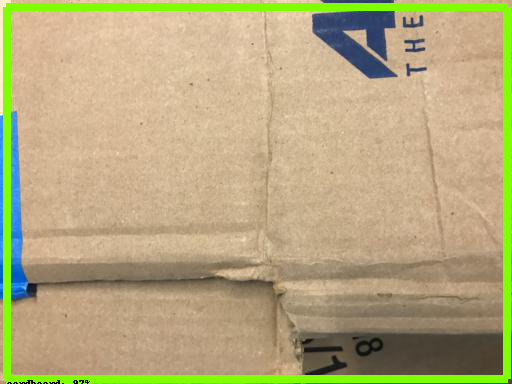

[0.97218925 0.06291187 0.05983273 0.05977813 0.05606215 0.05592256
 0.05075938 0.04903123 0.04817948 0.04729061 0.04659702 0.04295785
 0.04268875 0.04214844 0.03926053 0.03874443 0.03640023 0.03453896
 0.0345163  0.03444687 0.03253069 0.03252138 0.03238585 0.03215109
 0.03206335 0.03125703 0.03054845 0.03046205 0.02931105 0.02910578
 0.02898488 0.02879175 0.02870198 0.0285547  0.02831676 0.02826225
 0.02720766 0.02717925 0.02716306 0.02695836 0.02657311 0.02636173
 0.02636088 0.02610818 0.02609883 0.02588148 0.02577807 0.02576227
 0.02559704 0.0255117  0.02548494 0.0243876  0.02404842 0.02402561
 0.02398568 0.02396265 0.02384875 0.02352792 0.02348101 0.02344538
 0.02304643 0.02296834 0.02294924 0.02283472 0.02278267 0.02275617
 0.0226892  0.02250473 0.02218116 0.02211247 0.02210683 0.02205953
 0.02196604 0.02185621 0.02180121 0.02149946 0.02142442 0.02114583
 0.02098738 0.0208806  0.02077146 0.02077129 0.02073232 0.02069771
 0.02069371 0.02066967 0.02060186 0.02054652 0.02048321 0.0204

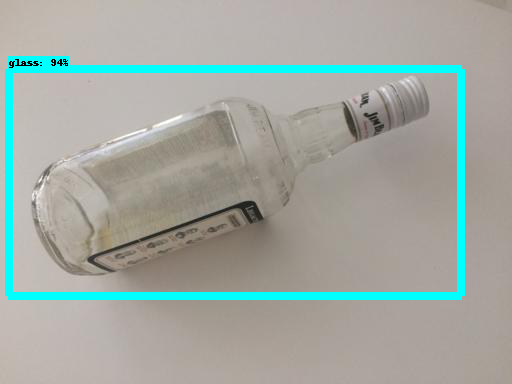

[0.94090503 0.25690177 0.24002685 0.1905991  0.16598788 0.11401802
 0.08470353 0.07636043 0.06977422 0.06645192 0.06585221 0.06114882
 0.05525978 0.0521583  0.05161866 0.05025142 0.04975588 0.04921642
 0.04723184 0.04480826 0.0446228  0.04263081 0.04169314 0.04120679
 0.04109291 0.04077405 0.04029147 0.04001844 0.03979023 0.03852687
 0.03802363 0.03768701 0.0369718  0.03626683 0.03551419 0.03538071
 0.03518052 0.03392727 0.03362621 0.03303359 0.03283862 0.0325698
 0.03146865 0.03145487 0.03135107 0.03121121 0.03105571 0.03102852
 0.03009019 0.0299828  0.0299294  0.02962795 0.02962173 0.02954707
 0.02905226 0.02887657 0.02867238 0.02859302 0.02857569 0.02851335
 0.02840022 0.02828455 0.02801056 0.02800286 0.0277262  0.0276497
 0.02751764 0.02750673 0.02727621 0.02719256 0.02692411 0.02675088
 0.02665115 0.02631259 0.02620647 0.02620453 0.02618556 0.02617284
 0.02604233 0.02551501 0.02540922 0.02538058 0.02528446 0.0252238
 0.02517414 0.02513162 0.02508024 0.02500582 0.02491542 0.0248965

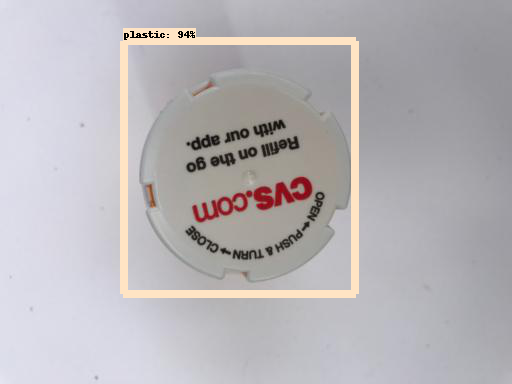

[0.9371852  0.26287472 0.21840462 0.16882323 0.14493059 0.12271993
 0.08492998 0.0801859  0.06450518 0.05977769 0.05432402 0.05015881
 0.04864531 0.04745202 0.04741275 0.04503361 0.04478863 0.04060762
 0.03985541 0.03971788 0.03944857 0.03883251 0.03491277 0.03434047
 0.03226243 0.03197346 0.03131595 0.03030062 0.02903252 0.02896755
 0.028943   0.02882569 0.0288051  0.02876875 0.02874946 0.0282191
 0.0281435  0.02753898 0.02699135 0.02689422 0.02653827 0.0263543
 0.02568865 0.02545066 0.02536945 0.02473754 0.02467733 0.02430538
 0.02425252 0.02407574 0.02404592 0.02402687 0.0237886  0.02378039
 0.02374187 0.02369126 0.02361966 0.02359643 0.02342443 0.02337142
 0.02329276 0.02322011 0.02317465 0.02299305 0.02298742 0.02294333
 0.02294198 0.02285645 0.02282369 0.02274746 0.02273993 0.02263002
 0.02256785 0.02255756 0.0224892  0.02246586 0.02238471 0.02231166
 0.02230979 0.02228321 0.02212609 0.02204505 0.02201037 0.02198182
 0.02189575 0.02178737 0.02177733 0.02169758 0.02156002 0.021482

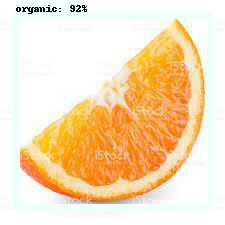

[0.9207091  0.29640803 0.12395424 0.12245568 0.08527871 0.08305552
 0.07604629 0.07196417 0.06163793 0.05963495 0.05870885 0.05600471
 0.05469549 0.05279888 0.05205597 0.05166427 0.05100144 0.05043919
 0.04894253 0.0456266  0.04494682 0.04488949 0.04447811 0.04443913
 0.04399943 0.04195808 0.04137601 0.04120871 0.04035569 0.03969829
 0.03914418 0.03911274 0.03903319 0.0386629  0.03830282 0.03787189
 0.03694349 0.03685561 0.03679409 0.03660687 0.03648004 0.03627934
 0.03604081 0.03594282 0.03571165 0.03547492 0.03545731 0.03516311
 0.03512857 0.03507531 0.03501686 0.03499531 0.0348985  0.0348127
 0.03480454 0.03475495 0.03440702 0.03406118 0.03393875 0.03378239
 0.03371781 0.03361391 0.03346041 0.03299552 0.03266165 0.03237281
 0.03218931 0.03194964 0.0318848  0.03176197 0.03132601 0.03115655
 0.03098028 0.03079037 0.03071096 0.03027186 0.030163   0.03013666
 0.02948837 0.02920969 0.02920044 0.02919149 0.02901074 0.02899039
 0.02898378 0.02867327 0.02857082 0.02835774 0.02833583 0.02830

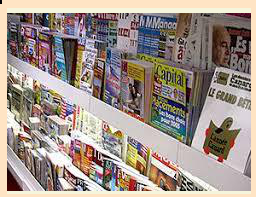

[0.6552994  0.5837627  0.4389047  0.23391967 0.17943127 0.14038987
 0.13275222 0.11651647 0.10918673 0.10558551 0.10304902 0.10121517
 0.09267344 0.09160843 0.07785095 0.07420151 0.07386528 0.07325743
 0.07302515 0.07082241 0.07037741 0.06996174 0.06926365 0.06911553
 0.06675213 0.06563951 0.06542096 0.06424987 0.06250238 0.06162029
 0.06143053 0.06076111 0.05825055 0.05824319 0.05490075 0.05303582
 0.05217779 0.05097564 0.05079027 0.04961132 0.04956238 0.04909354
 0.04863476 0.04852683 0.0476242  0.04716952 0.04668871 0.04666439
 0.04645176 0.04500363 0.04463224 0.04443653 0.04363981 0.04269493
 0.04268392 0.04258928 0.04245993 0.04240341 0.04212683 0.04166842
 0.04165032 0.04147231 0.04136457 0.04103078 0.0406386  0.0406361
 0.04052117 0.04049602 0.04047536 0.04015217 0.04007269 0.03977933
 0.03963094 0.03960723 0.03947781 0.03911644 0.03902882 0.03879151
 0.03840333 0.03839866 0.03825687 0.03807288 0.03750708 0.03729413
 0.03721305 0.03709401 0.03705574 0.03683488 0.03678642 0.03622

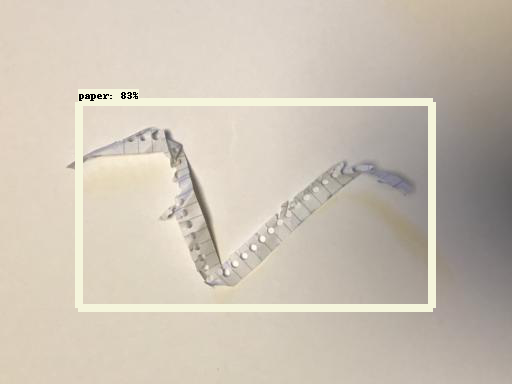

[0.8286423  0.26058647 0.22371566 0.1721229  0.12497763 0.11965959
 0.11043227 0.10737337 0.07359073 0.0724646  0.06009372 0.059048
 0.05540242 0.05431539 0.05386672 0.0521597  0.05119415 0.05088514
 0.05007995 0.04893968 0.04860304 0.04805637 0.047229   0.0437851
 0.04315843 0.0412461  0.04075135 0.03991668 0.03932584 0.03908268
 0.0383904  0.03595298 0.03411321 0.03282309 0.03233996 0.03195483
 0.03083774 0.02933247 0.02918679 0.02885166 0.02851406 0.0279433
 0.02786223 0.02755384 0.02704097 0.02700715 0.02680438 0.02656394
 0.02615323 0.02591255 0.02573176 0.02562663 0.02548784 0.02546053
 0.02523821 0.02512146 0.02498534 0.02483355 0.02468073 0.02463382
 0.02457623 0.02442197 0.02440115 0.02419494 0.024132   0.02399574
 0.02397213 0.02396885 0.02387745 0.02373436 0.02369968 0.02354393
 0.02325364 0.02311984 0.02302645 0.02285415 0.02277471 0.02274126
 0.02265168 0.02258053 0.02254864 0.02232654 0.02232225 0.02227573
 0.0221777  0.02214004 0.022044   0.02202572 0.02193249 0.02187849

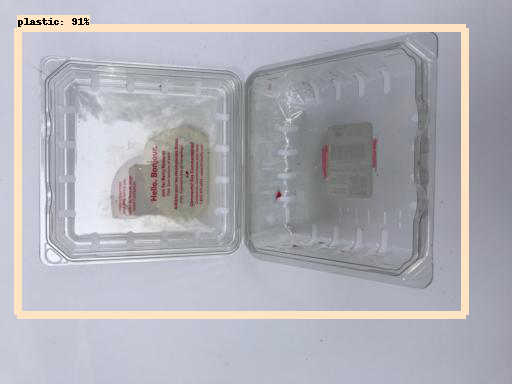

[0.9112445  0.39652565 0.35157    0.20586307 0.16018525 0.1355649
 0.11805002 0.10831317 0.10817699 0.10652129 0.09263538 0.08950869
 0.07682068 0.07320277 0.06586093 0.06502583 0.06239705 0.05817975
 0.0544843  0.04981699 0.04892307 0.04861069 0.04601446 0.04301543
 0.04152896 0.0392158  0.03887456 0.03847738 0.03750486 0.03747534
 0.03744886 0.03706915 0.03682275 0.03563504 0.03508497 0.03477935
 0.03430898 0.03425375 0.03414759 0.03412947 0.03267936 0.03259447
 0.03252197 0.03244176 0.03092069 0.03029294 0.0302661  0.0301355
 0.02849104 0.02832827 0.0274302  0.02732998 0.02708221 0.02611084
 0.02610921 0.02605734 0.02591077 0.02565662 0.02542828 0.02520379
 0.02514366 0.02511719 0.02474773 0.02454514 0.02438647 0.02430963
 0.02429745 0.02425005 0.02424663 0.02408313 0.0238692  0.02378395
 0.02358232 0.02337244 0.0232324  0.02307151 0.02299514 0.02297912
 0.02271471 0.02249013 0.02240758 0.02197086 0.0219364  0.0218168
 0.02166954 0.02149084 0.02147043 0.02144317 0.02143231 0.0213889

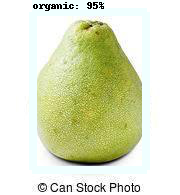

[0.9505469  0.17703876 0.17425828 0.15104295 0.13772342 0.08274798
 0.07443394 0.07419666 0.0696593  0.06289003 0.06218313 0.06175524
 0.05223423 0.04819551 0.04626277 0.04458283 0.04225804 0.040248
 0.03846856 0.03819939 0.03817298 0.03707466 0.03651514 0.03649497
 0.03645156 0.03631836 0.03603126 0.03547655 0.03542497 0.03498269
 0.0347881  0.03464888 0.03427423 0.03417065 0.03393262 0.03344432
 0.03343073 0.03337538 0.03326754 0.03299156 0.03258318 0.03248204
 0.03198889 0.03182199 0.03135622 0.03126348 0.03054967 0.02994437
 0.02990473 0.02978541 0.02947918 0.02933621 0.0287461  0.02837506
 0.02824629 0.02776971 0.02775532 0.02720564 0.0271996  0.02708757
 0.02699382 0.02691369 0.0264134  0.02608479 0.02578241 0.02563786
 0.02562167 0.02556135 0.02552308 0.02551741 0.02549259 0.02543912
 0.02539298 0.02522751 0.02519431 0.02515645 0.0244176  0.02434919
 0.0243205  0.02422326 0.02414206 0.02403148 0.0239661  0.02384804
 0.02353313 0.02349856 0.02346695 0.0234276  0.02338335 0.023355

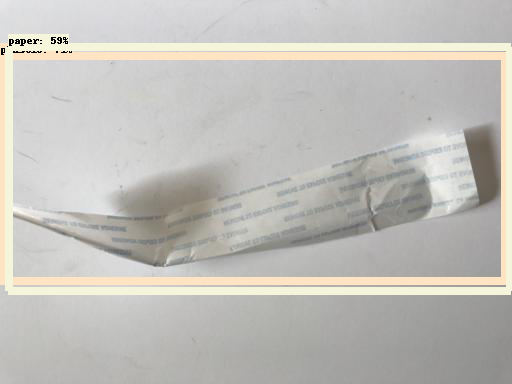

[0.7114882  0.5947277  0.32887107 0.23821041 0.16544762 0.14759152
 0.13301009 0.13170515 0.1095114  0.09735729 0.09709965 0.09709433
 0.08774601 0.08753777 0.07337186 0.06644284 0.0653435  0.06365977
 0.06183951 0.06005033 0.05888088 0.05811565 0.05395037 0.04951895
 0.0479245  0.04468771 0.04384986 0.04378722 0.04352463 0.04313415
 0.0429852  0.04225813 0.04191058 0.04130593 0.04019416 0.0397638
 0.0394796  0.03943748 0.03868987 0.03866876 0.03765091 0.0374858
 0.0374803  0.03742112 0.03717481 0.03685873 0.03672609 0.03638529
 0.03510017 0.03502361 0.0349867  0.03494017 0.03434208 0.03403971
 0.0338336  0.0335033  0.03314213 0.03297742 0.03262557 0.03248733
 0.03245823 0.0322605  0.03212893 0.03207359 0.03165578 0.03138616
 0.03115968 0.03115861 0.03059603 0.03054038 0.03048605 0.03045474
 0.03039847 0.02993509 0.02988722 0.02978104 0.02975354 0.02970374
 0.02958686 0.02958133 0.02952811 0.0294053  0.02916974 0.02886719
 0.02871623 0.02854688 0.02835112 0.02827372 0.02826567 0.028222

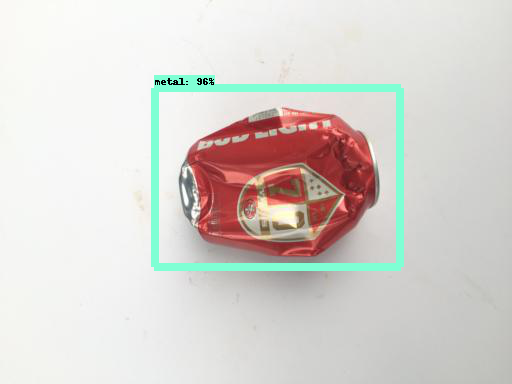

[0.9601387  0.21021327 0.18759711 0.1770736  0.1646131  0.13912176
 0.09263147 0.08207881 0.06864896 0.05470021 0.05185087 0.05033624
 0.04803664 0.04686847 0.04665619 0.04345703 0.04325061 0.04303494
 0.04172807 0.04062967 0.04039729 0.04008396 0.0399726  0.03970397
 0.03969453 0.03838347 0.03827808 0.03817815 0.0377133  0.03738836
 0.03708246 0.03678966 0.03640673 0.03634864 0.03501126 0.03492676
 0.03464328 0.03372734 0.03357972 0.03357668 0.03339636 0.03326773
 0.0329747  0.03283137 0.03268475 0.03246127 0.03241099 0.03228233
 0.03220904 0.03207608 0.03188353 0.03165377 0.03160019 0.03156701
 0.03155006 0.03140246 0.03125432 0.03110719 0.03048705 0.0303967
 0.02976838 0.02970848 0.02944063 0.02921803 0.02910051 0.02889751
 0.02886659 0.02879399 0.02859863 0.02852917 0.02843579 0.02783889
 0.02738948 0.0272216  0.0268771  0.02683372 0.02680154 0.02667771
 0.02663838 0.02662783 0.02635559 0.02634866 0.02630679 0.02605727
 0.02580909 0.02574974 0.02552064 0.02534662 0.02515505 0.02512

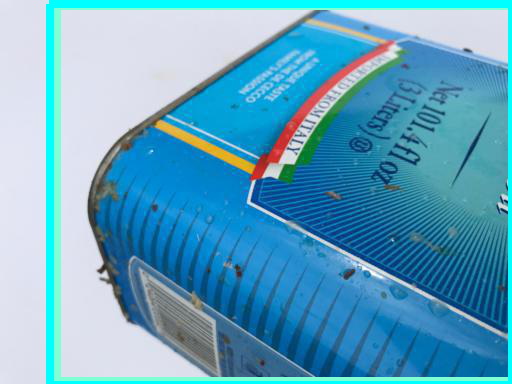

[0.6774986  0.54855317 0.4967564  0.38674104 0.27257678 0.19167276
 0.09418807 0.07429724 0.0625892  0.05517336 0.0530038  0.0527133
 0.04961075 0.0495989  0.04762763 0.04592466 0.04461097 0.04332536
 0.04244651 0.04201884 0.04150635 0.04125874 0.04062562 0.04050014
 0.0401231  0.03993487 0.0397191  0.039547   0.03725733 0.03566892
 0.03451399 0.03449286 0.03410583 0.03408449 0.03380386 0.03367352
 0.03359281 0.03344333 0.03341496 0.03287363 0.03270587 0.03247999
 0.03229007 0.03227127 0.03192368 0.03127452 0.03103725 0.03095528
 0.03093732 0.03049833 0.03017097 0.02920128 0.02851974 0.02838797
 0.02837896 0.0279419  0.02781912 0.02725996 0.0265559  0.02627796
 0.02595408 0.02568032 0.02559068 0.02545644 0.02514626 0.02512693
 0.02488974 0.02488    0.02471583 0.02469733 0.0245327  0.0244609
 0.02444066 0.02441407 0.02436508 0.02435977 0.02422063 0.02412079
 0.0241164  0.02410975 0.02393024 0.02382537 0.02371518 0.02361214
 0.02343412 0.02323103 0.02309082 0.02308666 0.02305989 0.022893

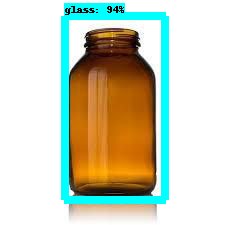

[0.9356991  0.20449813 0.11503939 0.10000686 0.07895698 0.07522058
 0.07220717 0.06705068 0.06686939 0.06051027 0.05630659 0.05164852
 0.0451941  0.04477381 0.0428475  0.04039524 0.04036064 0.04014117
 0.03966713 0.03940089 0.03930495 0.03798775 0.03765577 0.03754903
 0.03724292 0.03689068 0.03640895 0.03627397 0.03620619 0.03617291
 0.03606724 0.03601601 0.03585234 0.03558719 0.0353778  0.0352804
 0.03512263 0.03473804 0.03454028 0.0343773  0.03416372 0.03409719
 0.03403716 0.03373158 0.03323151 0.03314014 0.0324435  0.03206338
 0.0319551  0.03189498 0.03182992 0.0317638  0.03154097 0.0314057
 0.03136497 0.03134762 0.03132512 0.03073447 0.03067405 0.03018468
 0.02961312 0.02944294 0.02942557 0.02932704 0.02899083 0.02898743
 0.02881555 0.02879321 0.0285998  0.02812665 0.02805662 0.02797171
 0.0274787  0.02743047 0.02732327 0.0273083  0.02719018 0.0271888
 0.02715053 0.02689715 0.02688284 0.02652325 0.02649414 0.02630261
 0.02625946 0.02623849 0.02589858 0.02569759 0.02560921 0.0255697

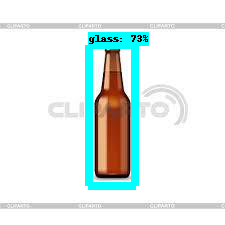

[0.7305402  0.21297036 0.21015213 0.20217387 0.15928209 0.14012814
 0.11919805 0.11592807 0.10892626 0.10248669 0.10048988 0.08724739
 0.08529308 0.08053549 0.07932571 0.07912248 0.0698332  0.06968183
 0.06540991 0.06228551 0.06202103 0.06123236 0.06053726 0.06001312
 0.05148023 0.04961376 0.04754702 0.04663405 0.04618378 0.04529332
 0.0452754  0.04494779 0.04411481 0.0432189  0.04297927 0.04295747
 0.04194177 0.04189998 0.04182681 0.0418178  0.04107634 0.04106982
 0.0403208  0.04013552 0.04010031 0.03985231 0.03963358 0.03951238
 0.03919218 0.03828881 0.03797146 0.03781056 0.03769615 0.03763382
 0.03709005 0.03672787 0.03666903 0.0364681  0.03626554 0.0361548
 0.03606829 0.03590081 0.03531164 0.03524485 0.03516334 0.03506859
 0.03504408 0.03488885 0.03488044 0.03485319 0.0347215  0.0347046
 0.03467588 0.03424242 0.03422846 0.034168   0.03406016 0.03394071
 0.03380916 0.03376171 0.03349197 0.03340202 0.03323756 0.03295989
 0.03269352 0.03261204 0.03239141 0.03235284 0.03228948 0.032274

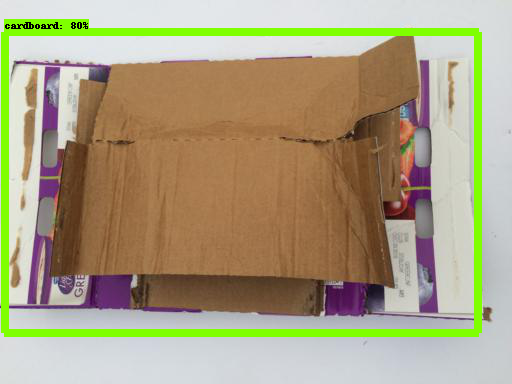

[0.79933846 0.40911406 0.2718148  0.24886258 0.16852015 0.13262652
 0.07831947 0.07051107 0.06826133 0.05277656 0.05176786 0.05154969
 0.04663466 0.04419247 0.04315098 0.04268329 0.04186367 0.03975581
 0.03792436 0.03703573 0.03655008 0.0362387  0.03564039 0.0356094
 0.03514162 0.03474053 0.0345262  0.03452331 0.03389075 0.03380895
 0.03363207 0.03318145 0.03293788 0.03284936 0.03271965 0.03222967
 0.03221358 0.03032462 0.03012827 0.03006979 0.02989357 0.02960509
 0.02956634 0.02882565 0.02852438 0.02833074 0.0282249  0.02791721
 0.02785265 0.02766879 0.02736918 0.02726225 0.02708914 0.02672942
 0.02655846 0.02650102 0.02641025 0.02636366 0.02636151 0.02636115
 0.02592935 0.02541105 0.02501193 0.02445338 0.02432012 0.02422742
 0.02417361 0.02415457 0.0240018  0.02397103 0.02395133 0.02391204
 0.02389805 0.02363177 0.02358532 0.02331214 0.02303768 0.02293486
 0.02292563 0.0228395  0.02260797 0.02249364 0.02248815 0.02221464
 0.02215894 0.02199227 0.02192658 0.02191517 0.02188213 0.02181

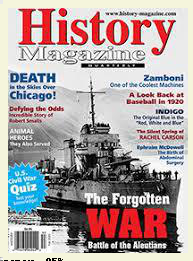

[0.9487781  0.16827303 0.16653486 0.1548949  0.1166654  0.10620362
 0.10218382 0.08811568 0.08283629 0.08280864 0.08076058 0.07832643
 0.07432225 0.06955487 0.06923133 0.06306086 0.06057893 0.05946558
 0.05927007 0.05843347 0.05589315 0.05560447 0.05540062 0.05386927
 0.05353969 0.05134461 0.05088161 0.05009474 0.04983049 0.04964555
 0.04935922 0.04744925 0.04733168 0.04652381 0.04458397 0.04413836
 0.04394811 0.04344827 0.04307177 0.04272769 0.04236162 0.04209774
 0.04169287 0.04159338 0.04107936 0.04104379 0.04087836 0.03913132
 0.03891568 0.03857117 0.03808326 0.03733906 0.03718752 0.03713212
 0.03690468 0.0368655  0.03682039 0.03657232 0.03593127 0.03556727
 0.03451994 0.0344167  0.03434379 0.03424978 0.03392785 0.0338642
 0.03348367 0.03292052 0.03250401 0.03203134 0.03202674 0.03176466
 0.03174066 0.03058306 0.02990182 0.02974886 0.02970683 0.02952545
 0.02946419 0.02929395 0.02922115 0.02918522 0.02911145 0.02892806
 0.02885741 0.02884829 0.02880776 0.02878874 0.02842252 0.02836

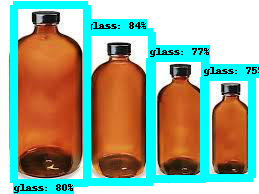

[0.84479177 0.79865694 0.7735635  0.7533125  0.22881892 0.19192405
 0.17861752 0.15841594 0.1564337  0.14737704 0.14534794 0.14479142
 0.13168678 0.1263771  0.11419008 0.11363453 0.1073839  0.1053547
 0.09925126 0.09689773 0.09459893 0.09127887 0.09000395 0.08815326
 0.08735751 0.08675798 0.08512748 0.08474009 0.08454984 0.08363813
 0.08025584 0.07793337 0.07737668 0.07152519 0.07077089 0.07053515
 0.06886011 0.06433392 0.063568   0.06286593 0.06061531 0.05935518
 0.05905039 0.05898448 0.05896404 0.05879162 0.05831972 0.05790458
 0.05747553 0.05743551 0.05582704 0.05460884 0.05381979 0.05327852
 0.05273898 0.05151472 0.05041518 0.04984343 0.04950263 0.04803227
 0.04742023 0.04730576 0.04706492 0.04698484 0.04657812 0.04541481
 0.04410616 0.04389953 0.04372789 0.04358967 0.04327124 0.04324656
 0.04250325 0.04219675 0.04176638 0.04108438 0.04092377 0.04085803
 0.04025084 0.03983516 0.03976905 0.03968602 0.03964159 0.03937662
 0.03883984 0.03868537 0.03854956 0.03835281 0.03804383 0.03779

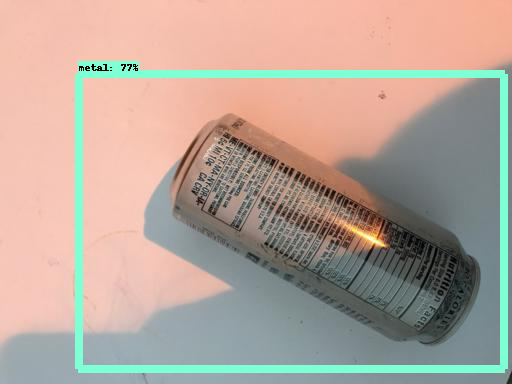

[0.77022934 0.4487075  0.29505363 0.21913676 0.18737355 0.17877391
 0.09704643 0.08544688 0.07341252 0.06887954 0.05671033 0.05422318
 0.05169211 0.05116349 0.05013251 0.04960403 0.04929259 0.04839092
 0.04810763 0.04810427 0.04636738 0.04577465 0.04573388 0.04568972
 0.04472993 0.04455341 0.04435692 0.0427465  0.0418087  0.03976813
 0.03953314 0.03867698 0.03686943 0.03686881 0.0365178  0.03613968
 0.03587025 0.03564774 0.03514963 0.03485009 0.03436921 0.03398312
 0.03352239 0.03318509 0.03295891 0.03238751 0.0313356  0.03109469
 0.0310263  0.03046829 0.03039204 0.0300442  0.02988674 0.02987854
 0.02984688 0.02966432 0.0294246  0.0290047  0.02894664 0.02845662
 0.02842176 0.02789736 0.0275336  0.02732065 0.02728113 0.02716725
 0.02699773 0.02687641 0.02682936 0.02662383 0.02659617 0.02656062
 0.02625682 0.02621254 0.02603747 0.02591829 0.02581231 0.02572019
 0.02568654 0.02559086 0.02538742 0.02524014 0.02511675 0.02509779
 0.02494374 0.02489468 0.02476964 0.02476408 0.02472897 0.0246

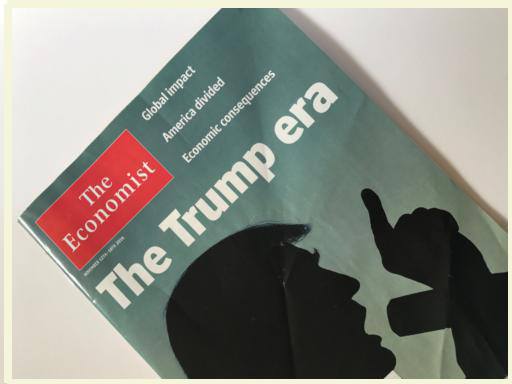

[0.8332859  0.4838452  0.30055362 0.28104874 0.18533935 0.14446814
 0.10721225 0.10368969 0.08131897 0.07508401 0.0735469  0.07292641
 0.07013679 0.06388766 0.06362874 0.06335464 0.06168274 0.05827046
 0.05722442 0.05619679 0.05581855 0.05556384 0.05507638 0.0537356
 0.05197586 0.05171595 0.05088179 0.0506498  0.05037188 0.04942447
 0.04910553 0.04897138 0.04824199 0.04676879 0.04551359 0.04479049
 0.04477712 0.04422507 0.04397936 0.04341049 0.04339953 0.04207641
 0.04099084 0.0391765  0.03900449 0.03866449 0.0382807  0.03779363
 0.03633365 0.03605592 0.03484884 0.03467296 0.03466018 0.03371638
 0.03346138 0.03289872 0.03276657 0.03251511 0.03212195 0.03182366
 0.03180062 0.03174061 0.0311183  0.03103132 0.0310232  0.030952
 0.03060747 0.03033802 0.03002478 0.02994118 0.02955235 0.02938454
 0.02933657 0.02930135 0.02925851 0.02909292 0.02879941 0.02870362
 0.02860193 0.02826179 0.02798267 0.02755269 0.02748554 0.02745746
 0.02676935 0.02673746 0.02661186 0.02660277 0.0264572  0.0260936

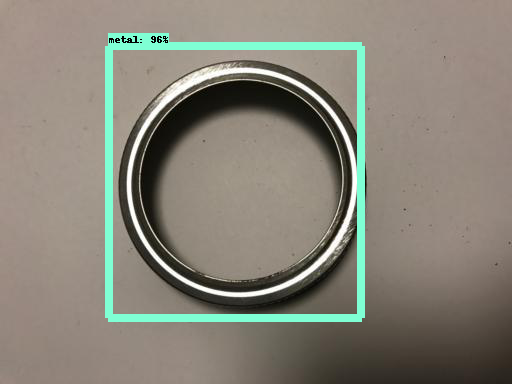

[0.9626988  0.27223697 0.22653332 0.21222931 0.18605223 0.16545878
 0.09055017 0.07270174 0.06498382 0.05108202 0.04594453 0.04355913
 0.03892316 0.03775339 0.03749022 0.03614272 0.03504877 0.03496035
 0.03445264 0.03322949 0.03272817 0.03078381 0.03058547 0.03044733
 0.03040869 0.02982395 0.02961499 0.0294846  0.02928073 0.02895822
 0.02874234 0.027927   0.02786737 0.02784717 0.02764953 0.02726589
 0.02720598 0.02693758 0.02667978 0.02655523 0.02586815 0.02565295
 0.0253643  0.02521884 0.02501338 0.02490553 0.02488147 0.02487647
 0.02484658 0.02477727 0.0243312  0.02420448 0.02413965 0.02408929
 0.02379779 0.02317303 0.02310483 0.02302803 0.0229218  0.0226448
 0.02244025 0.02209998 0.02202766 0.02193896 0.0218267  0.02180274
 0.02177267 0.02152023 0.0212009  0.02120067 0.02107228 0.02102119
 0.02090675 0.02080739 0.02080077 0.02072843 0.02067409 0.02065722
 0.02057765 0.02042639 0.02038541 0.02024978 0.02024757 0.02003754
 0.02000855 0.01984604 0.01976655 0.01974423 0.01964249 0.01955

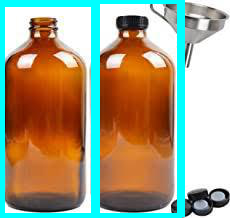

[0.83291113 0.8323897  0.15787879 0.15342712 0.14909206 0.14131133
 0.14034152 0.12986907 0.11138874 0.10773485 0.10240714 0.09970374
 0.09704309 0.09556414 0.094788   0.09444035 0.09050553 0.08989815
 0.08822425 0.08504719 0.08163309 0.07936271 0.07822227 0.0763265
 0.07471576 0.07443324 0.07377271 0.07116222 0.071086   0.06979582
 0.06933375 0.06777166 0.06541285 0.06522391 0.06231355 0.05990222
 0.05982298 0.05753166 0.05641798 0.05574333 0.05515735 0.05342862
 0.05118647 0.05065717 0.05054287 0.05013606 0.04988431 0.04931264
 0.04925832 0.04864299 0.04855194 0.04837117 0.04778389 0.04711971
 0.04705282 0.04658745 0.04653625 0.04583899 0.04582875 0.04542096
 0.04540534 0.0453652  0.04528702 0.04484239 0.0432873  0.0431644
 0.04227458 0.04187467 0.04136019 0.04120602 0.04065341 0.04056345
 0.04017323 0.03990125 0.03960415 0.0395713  0.03955405 0.039487
 0.03913206 0.03905153 0.03901115 0.03890176 0.03854306 0.03816539
 0.03801617 0.03798889 0.03776257 0.0375613  0.03740245 0.03739717

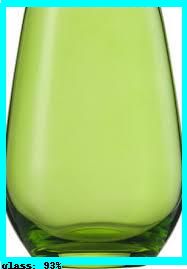

[0.92695826 0.21498159 0.13218729 0.10718485 0.10127249 0.09163728
 0.08998089 0.08559189 0.07884768 0.07389944 0.07284699 0.06639008
 0.06166703 0.05944107 0.05674049 0.05603455 0.05280759 0.05269869
 0.05234426 0.05100331 0.04887896 0.04839632 0.04494771 0.0447711
 0.04354816 0.04322992 0.04277264 0.04242846 0.04231079 0.0415528
 0.04128271 0.04086562 0.04074525 0.04024977 0.04012545 0.03991086
 0.03966754 0.03937121 0.03648607 0.03546238 0.03529813 0.03452688
 0.03420877 0.03381092 0.03289257 0.03270064 0.03257645 0.03224641
 0.03223703 0.03162595 0.03140905 0.03134201 0.03096989 0.03090405
 0.03085358 0.03077683 0.03076321 0.0307154  0.03023527 0.03019187
 0.02989549 0.02973077 0.02963982 0.02924455 0.02903358 0.02873865
 0.02871967 0.02863683 0.02862995 0.02829425 0.02827861 0.02803492
 0.02786464 0.02774247 0.0275918  0.02757489 0.02745077 0.02733576
 0.02711525 0.02670891 0.02664622 0.02661994 0.02654135 0.0263723
 0.02635689 0.02634724 0.02633374 0.02620318 0.026102   0.0260572

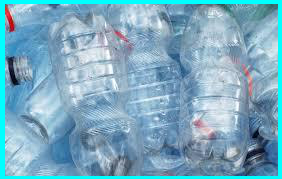

[0.8688144  0.34849587 0.19839081 0.18639475 0.16312839 0.13524325
 0.12168947 0.11830977 0.1176573  0.10694281 0.10117393 0.10111637
 0.09972304 0.09185655 0.09101263 0.0900011  0.0859769  0.08443259
 0.0814495  0.07971657 0.07740146 0.07726974 0.07254539 0.07190889
 0.07135685 0.07120508 0.06663793 0.06640887 0.06624863 0.06492046
 0.06482032 0.06316883 0.06234328 0.06209946 0.06188805 0.06119543
 0.06104625 0.06035355 0.06030953 0.06002361 0.05986919 0.05911467
 0.05907599 0.05903202 0.05881036 0.05864823 0.05784172 0.05765366
 0.05756526 0.056713   0.05628214 0.05570833 0.05497612 0.05467651
 0.05395387 0.05344888 0.0527024  0.05261562 0.05224038 0.05173545
 0.05157778 0.05141918 0.05117921 0.05112582 0.05089469 0.0497483
 0.0494024  0.04876002 0.0481276  0.04797086 0.04784114 0.04755555
 0.04744142 0.04669094 0.04667858 0.04609226 0.04606372 0.04568437
 0.0455035  0.04517044 0.04512756 0.04485769 0.0443248  0.04423659
 0.04421503 0.04400214 0.04371789 0.04371252 0.04358576 0.04355

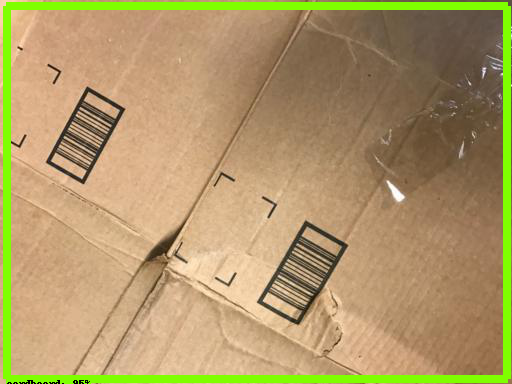

[0.95218575 0.12691073 0.08477579 0.08070624 0.07550838 0.07344517
 0.06983756 0.06789254 0.06671171 0.06620692 0.05888208 0.05840371
 0.05697641 0.05622944 0.05614837 0.05440184 0.0533356  0.05303951
 0.052363   0.05115952 0.04769795 0.04518859 0.04432341 0.04297102
 0.0424782  0.04237835 0.04167785 0.04079051 0.03873711 0.03848936
 0.03838295 0.03704848 0.03566434 0.0354661  0.03536999 0.03509425
 0.03478928 0.03460352 0.03399587 0.03314009 0.03302063 0.03233862
 0.03229066 0.03224717 0.03219879 0.03202236 0.03195308 0.03164438
 0.03152152 0.03146463 0.03131738 0.03129693 0.03125534 0.0310229
 0.03002354 0.02999755 0.02950812 0.02940993 0.02935966 0.02894705
 0.02878597 0.02865299 0.02852787 0.02834612 0.0281317  0.02811956
 0.02805646 0.02800578 0.02776421 0.02776337 0.02734076 0.02730803
 0.02721735 0.02718632 0.02691833 0.02689488 0.02672664 0.02659628
 0.02654348 0.02624667 0.02619461 0.02591035 0.02578604 0.02565785
 0.02551175 0.02541036 0.02507235 0.0250161  0.02479178 0.02467

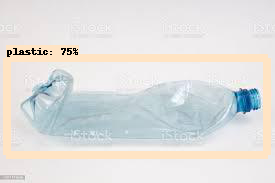

[0.7542132  0.48329476 0.33403546 0.31842187 0.17301004 0.16012506
 0.14873244 0.14188632 0.1404419  0.12266    0.12062167 0.11931711
 0.11856749 0.11228236 0.09947052 0.09730849 0.09728873 0.09705027
 0.09279289 0.09202158 0.08996426 0.08819108 0.08815387 0.08810221
 0.08798384 0.08672012 0.08629827 0.08357923 0.08124138 0.07679131
 0.07634522 0.07484519 0.07236182 0.0721485  0.0714427  0.06869736
 0.0679726  0.06770806 0.06746626 0.06690411 0.06589414 0.06362689
 0.06165857 0.06150092 0.06131369 0.06057734 0.06040964 0.05987884
 0.05960907 0.05948344 0.05745061 0.05729763 0.0571134  0.05649145
 0.05547159 0.05544295 0.05528624 0.05422861 0.05417854 0.05399701
 0.0526102  0.05213603 0.05177836 0.05142324 0.05005927 0.05004602
 0.04887149 0.04819831 0.04755099 0.04704531 0.04697294 0.04647901
 0.04603462 0.04595135 0.04588742 0.04582281 0.0440238  0.04398824
 0.04358508 0.0435796  0.0433544  0.04286752 0.04256389 0.04207641
 0.04199246 0.04165544 0.04148291 0.04108857 0.04049616 0.0402

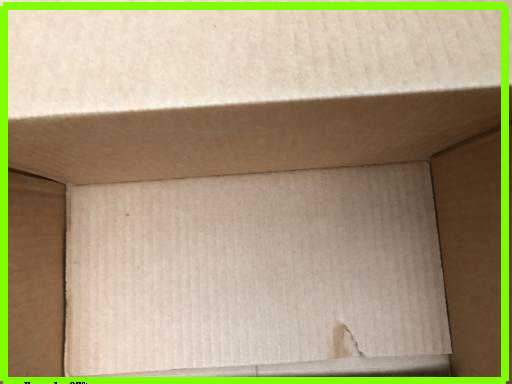

[0.97055966 0.17959845 0.15090522 0.13273787 0.10288817 0.09939604
 0.08641846 0.08059956 0.07983963 0.0631758  0.05849029 0.05774542
 0.05568125 0.05488575 0.0546779  0.05254129 0.0499295  0.04947597
 0.04912727 0.04746685 0.04610777 0.0452476  0.04484145 0.04417002
 0.04233997 0.04224082 0.0420226  0.04151865 0.04146639 0.04098969
 0.04098544 0.03888372 0.03844542 0.03840205 0.03833448 0.03732449
 0.03724356 0.03704846 0.03680295 0.0368     0.03571511 0.03512168
 0.03508912 0.0343751  0.03437449 0.03398319 0.03358335 0.03320558
 0.03307192 0.03293417 0.03287458 0.03255077 0.03208143 0.0320767
 0.03144325 0.03143599 0.03115683 0.03075148 0.03034666 0.03006196
 0.02992009 0.0299029  0.02988744 0.02967346 0.02936642 0.0292259
 0.0287782  0.0286475  0.02850437 0.02829672 0.02820031 0.02813103
 0.02802309 0.02797909 0.02775712 0.02718151 0.02701019 0.0269601
 0.02680062 0.02655715 0.02654491 0.02651222 0.02616553 0.02578928
 0.02558694 0.0255494  0.02546589 0.02507809 0.02496722 0.0246842

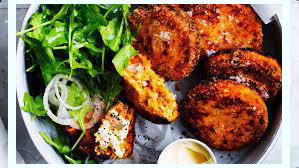

[0.9170777  0.256832   0.21150261 0.17284602 0.14132336 0.12815292
 0.10040731 0.10022601 0.09903207 0.08567633 0.08275308 0.08052875
 0.07941303 0.07863374 0.07537176 0.07391254 0.07219808 0.07125511
 0.06974325 0.06373847 0.06334648 0.06124133 0.05822087 0.05788732
 0.05720235 0.05496616 0.0547784  0.05400841 0.05358766 0.05283283
 0.05263084 0.05152172 0.0514527  0.04955244 0.04827068 0.04802457
 0.04773457 0.04754029 0.0466057  0.0463484  0.04552076 0.04502054
 0.04501006 0.04486918 0.04369287 0.04361327 0.0436006  0.04336695
 0.04288065 0.04240665 0.04173759 0.04168084 0.04142686 0.04041986
 0.04016691 0.0398887  0.03970822 0.03876265 0.03831328 0.03769741
 0.03744368 0.03731902 0.03718478 0.0371779  0.03715871 0.03686711
 0.03661853 0.03644162 0.03632621 0.03620371 0.03606293 0.03586715
 0.03530257 0.03466212 0.03443463 0.03439293 0.03411889 0.03402871
 0.03378635 0.0337557  0.03368521 0.03361885 0.03326485 0.03314518
 0.03300328 0.03209734 0.03196922 0.03191219 0.03187404 0.0318

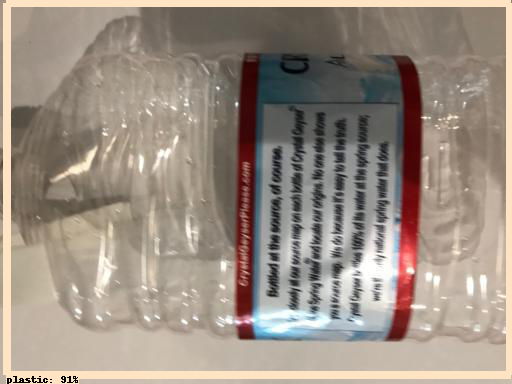

[0.91430223 0.3197013  0.21172829 0.18287517 0.16015308 0.11658472
 0.10264595 0.10209877 0.08289973 0.08115916 0.08056135 0.07732733
 0.07185583 0.06943291 0.06582787 0.06507736 0.06344515 0.05787832
 0.05757211 0.05580957 0.05475172 0.05455454 0.05427646 0.05237941
 0.04953627 0.04937303 0.04561865 0.04480936 0.04422104 0.04280277
 0.04192721 0.04147406 0.04136682 0.040973   0.04090214 0.04088689
 0.04071239 0.03990931 0.03918287 0.0391566  0.03861593 0.03801866
 0.03700686 0.03690502 0.03677667 0.03488017 0.0346238  0.03438064
 0.03426028 0.03413793 0.03403551 0.03399097 0.03394918 0.0338704
 0.03365327 0.03349456 0.03319201 0.03311066 0.03281442 0.03249828
 0.03249812 0.0321818  0.03206392 0.03190845 0.03171986 0.03167571
 0.03162026 0.03125283 0.03106871 0.0307609  0.03067611 0.02994926
 0.02994527 0.02985468 0.02910724 0.02901403 0.0287342  0.02849622
 0.0284564  0.02837219 0.02814159 0.02800566 0.02768656 0.02767684
 0.02712888 0.02695966 0.0266096  0.02620835 0.02618791 0.02599

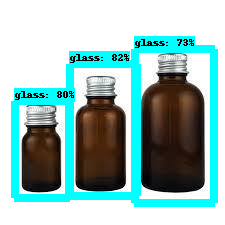

[0.8239761  0.80043006 0.7311011  0.2138165  0.2110436  0.18938291
 0.16778415 0.16471249 0.13284723 0.13141634 0.10624079 0.10241284
 0.0994376  0.09883874 0.0985959  0.09773587 0.09459344 0.08987244
 0.08548413 0.08483776 0.08366004 0.08112629 0.08009381 0.07965403
 0.07931554 0.07910042 0.07796118 0.07450844 0.07406913 0.07092623
 0.07067695 0.0669734  0.06329206 0.06303958 0.06178976 0.06062115
 0.05950392 0.05939597 0.05920719 0.05825464 0.05806613 0.05782965
 0.05470505 0.05180287 0.05169641 0.04903334 0.04888546 0.04706128
 0.04651281 0.04640003 0.04634063 0.04567257 0.04550884 0.04548545
 0.04421514 0.04349249 0.04344684 0.04323298 0.04290313 0.04202027
 0.04172098 0.04094816 0.04020327 0.04007059 0.04006346 0.03991892
 0.03979227 0.03915503 0.03855636 0.03843809 0.03805178 0.03804712
 0.03795734 0.03778653 0.0376774  0.03754888 0.03742366 0.03737291
 0.03727233 0.03717836 0.03695413 0.03682622 0.03661386 0.0366108
 0.03658187 0.03652371 0.03651607 0.03643838 0.03628193 0.03623

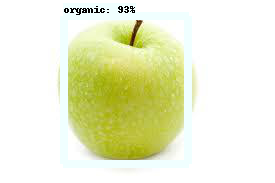

[0.9289758  0.2013462  0.19548942 0.1352293  0.118717   0.11662915
 0.108897   0.10478169 0.09084869 0.08858665 0.07103369 0.06851175
 0.05843621 0.05766159 0.05756822 0.05480893 0.05338946 0.05068868
 0.04837552 0.04740421 0.04697149 0.0468656  0.04571782 0.0422429
 0.04148785 0.04099046 0.04061107 0.04052677 0.03970304 0.03906531
 0.03879391 0.03874024 0.03864702 0.03847589 0.03784055 0.03750591
 0.03738243 0.03730178 0.03726714 0.03658488 0.03638588 0.03589971
 0.03536447 0.03507312 0.03506657 0.03473827 0.03451124 0.03448218
 0.0343218  0.03426886 0.03426599 0.0341118  0.03384312 0.03343107
 0.03342868 0.03340032 0.0333139  0.0331895  0.03304678 0.03258494
 0.0325205  0.03211588 0.03160652 0.0312856  0.03118953 0.03100961
 0.03074462 0.03055347 0.03055173 0.03004793 0.02993339 0.02985263
 0.02975665 0.02969784 0.02944755 0.02927379 0.02925513 0.02924481
 0.02889919 0.02879561 0.02871519 0.02868947 0.02865384 0.02840487
 0.0282705  0.02823419 0.02822049 0.02811793 0.027845   0.02772

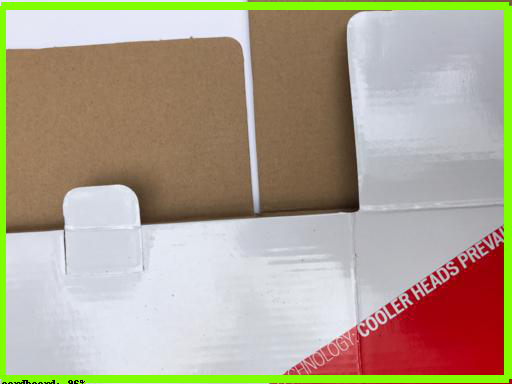

[0.95633054 0.2328903  0.11268572 0.08645068 0.0784748  0.07780941
 0.06990207 0.06904301 0.06192853 0.06168138 0.0595888  0.05855766
 0.05629843 0.05100107 0.05004201 0.04948975 0.0492034  0.04486327
 0.04409868 0.04384545 0.0405821  0.03921253 0.03894688 0.03780774
 0.03771328 0.03755054 0.03749345 0.03716374 0.03709094 0.03699282
 0.03692231 0.03686084 0.03671833 0.03669072 0.03591451 0.03471627
 0.03406158 0.03378625 0.03368546 0.03344039 0.03299749 0.03279285
 0.03272221 0.0318894  0.03158104 0.0315771  0.03137946 0.03101808
 0.03076047 0.03073698 0.03037146 0.02995551 0.02978974 0.02973297
 0.02966421 0.02941284 0.02926376 0.02891664 0.02840194 0.02832876
 0.02793481 0.02759043 0.02745163 0.02720436 0.02715751 0.02711572
 0.02678168 0.02675309 0.02673279 0.02670416 0.02648452 0.02641258
 0.02634234 0.02613276 0.02611151 0.02586291 0.02579496 0.02559341
 0.02551601 0.02547794 0.02543757 0.02525147 0.02519802 0.02513932
 0.02485648 0.02466355 0.02462719 0.02461126 0.02396235 0.0234

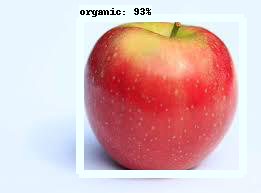

[0.92573744 0.20222214 0.125834   0.09545168 0.09005229 0.06346096
 0.05433701 0.05051675 0.05047741 0.05037135 0.04879387 0.04490656
 0.04387324 0.0426346  0.0407351  0.03969592 0.03858303 0.03702586
 0.03570659 0.03532799 0.03345496 0.03306066 0.03296186 0.03228465
 0.03208774 0.03196203 0.03153757 0.03133231 0.03115524 0.03108086
 0.0304274  0.02982572 0.0294483  0.02926499 0.0291223  0.02902961
 0.02892419 0.02859674 0.02845486 0.02845256 0.02818102 0.02765875
 0.02741662 0.02732313 0.02730902 0.02719721 0.02699429 0.02690913
 0.02679808 0.02670607 0.02639444 0.02630563 0.02627759 0.0260757
 0.02581126 0.02576502 0.02571909 0.02545671 0.02544244 0.02540702
 0.02527754 0.02501123 0.02486887 0.02456484 0.02409924 0.02380637
 0.02379368 0.0237887  0.02353288 0.02334652 0.02327623 0.02298507
 0.02291801 0.02264884 0.02260871 0.0224038  0.02240032 0.02222995
 0.02198739 0.02194116 0.02183061 0.02181847 0.02170145 0.02159445
 0.02135719 0.02104859 0.02076934 0.02072393 0.02070881 0.02056

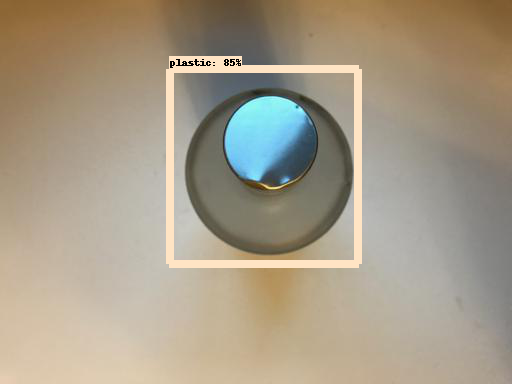

[0.8471399  0.28531528 0.26042405 0.25322872 0.18815807 0.11254574
 0.10983657 0.09615819 0.08006189 0.07934128 0.07472358 0.07284955
 0.0710948  0.06590368 0.0635885  0.06144392 0.05958534 0.05512057
 0.05219097 0.05132433 0.04900083 0.04820846 0.04735309 0.04474245
 0.04347566 0.04322014 0.042805   0.04249692 0.0411537  0.04102018
 0.04009839 0.03983463 0.03940168 0.03630628 0.03583289 0.0350643
 0.03489222 0.03483042 0.03481316 0.03481179 0.03469677 0.03468597
 0.03431129 0.03420929 0.03409926 0.03408275 0.03393562 0.03364193
 0.03343612 0.03322451 0.03310862 0.03267997 0.03253552 0.0324766
 0.032347   0.03230826 0.03158382 0.0312961  0.03114759 0.03114191
 0.03113685 0.03107956 0.03064479 0.03046605 0.03039022 0.03019909
 0.02999663 0.02998827 0.02981143 0.02975259 0.02948726 0.02935651
 0.02919431 0.02898156 0.028836   0.02842392 0.02793265 0.02774325
 0.02762357 0.02720681 0.02720329 0.02695293 0.02672265 0.02636433
 0.02633327 0.02606484 0.02577727 0.02574282 0.02573279 0.025627

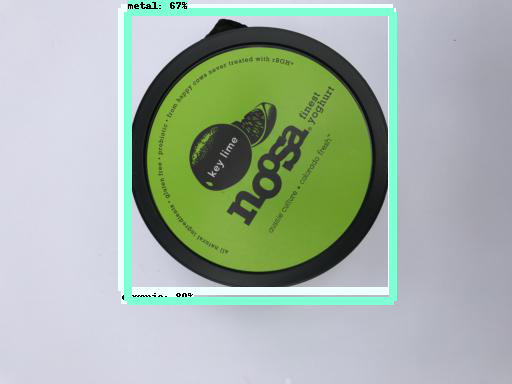

[0.7962638  0.6688337  0.4235762  0.2522899  0.18079963 0.14125033
 0.10096091 0.06158395 0.05944224 0.05843541 0.05739619 0.05374409
 0.04370397 0.04200731 0.04165904 0.04049627 0.03904377 0.03785741
 0.03765648 0.03764774 0.03679101 0.0349816  0.03485676 0.03480721
 0.03448605 0.03233967 0.03181954 0.03130089 0.03116828 0.03053951
 0.03015854 0.02974489 0.02941566 0.02919973 0.02891483 0.02858242
 0.02857617 0.0283238  0.02820173 0.02780621 0.02710404 0.02649591
 0.02648749 0.02637292 0.02621449 0.02616171 0.02605586 0.02549971
 0.02534306 0.0252565  0.02514453 0.02490902 0.02460468 0.02453723
 0.02408732 0.02400504 0.02392769 0.02387291 0.02385142 0.02350003
 0.02347991 0.02347914 0.02339084 0.02326924 0.02303085 0.02302782
 0.02298137 0.02267845 0.02257369 0.02252307 0.02252075 0.02216383
 0.02212889 0.02208985 0.02208236 0.02206757 0.02185841 0.02184796
 0.02179184 0.0214635  0.02144513 0.02117414 0.02115184 0.02111194
 0.02102357 0.02094807 0.02086535 0.02084035 0.02075933 0.0207

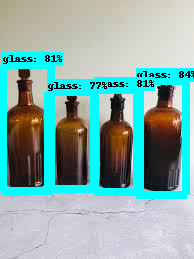

[0.8363929  0.81076103 0.80965245 0.774979   0.432351   0.24772419
 0.2183038  0.21555054 0.20491987 0.20286423 0.19663325 0.18728064
 0.18505186 0.17414235 0.17206186 0.17159393 0.16064659 0.144992
 0.13429904 0.13076767 0.12560922 0.1255668  0.12303738 0.12227453
 0.11377867 0.11067932 0.10917066 0.10583267 0.10369215 0.10177203
 0.10059702 0.10007877 0.09944651 0.09916444 0.09041292 0.08921455
 0.08896047 0.08778965 0.08683183 0.08540554 0.08155072 0.08115602
 0.08033349 0.08007475 0.07913657 0.07830803 0.0778072  0.07686567
 0.07501289 0.07444105 0.07117977 0.0682204  0.06821712 0.06661347
 0.06538488 0.06383822 0.06331768 0.06295609 0.06215683 0.05932274
 0.05778642 0.05716667 0.05699172 0.05694797 0.05651204 0.05645012
 0.0560987  0.05601141 0.0555985  0.05521206 0.05500678 0.05367595
 0.05364567 0.05322041 0.05311588 0.05272838 0.05241958 0.05216582
 0.05150881 0.05146867 0.05139914 0.05120306 0.05056925 0.05022164
 0.04993093 0.04989672 0.0497739  0.04816977 0.04764309 0.047269

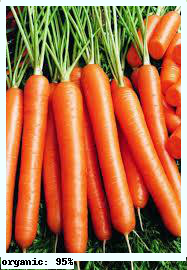

[0.94742393 0.3576347  0.27934194 0.24537016 0.23887585 0.23813473
 0.22915396 0.21290703 0.21180572 0.18520173 0.17175803 0.15679082
 0.14465407 0.13791062 0.13765608 0.13756086 0.13591081 0.13256752
 0.13160688 0.13097705 0.12753628 0.12579203 0.119354   0.11902528
 0.1178744  0.11576211 0.11365884 0.11236466 0.11224415 0.11049988
 0.10960498 0.10857    0.10812047 0.10492976 0.10491136 0.10374057
 0.10351597 0.10279931 0.10224923 0.09749406 0.09641266 0.09502236
 0.09435397 0.09285548 0.09194914 0.09127198 0.09109511 0.09054574
 0.08874691 0.08782556 0.08664501 0.08654761 0.08394357 0.08294694
 0.08266239 0.08005112 0.07904507 0.07815381 0.07811607 0.07793891
 0.07501963 0.07484969 0.0747515  0.07422473 0.07247207 0.07194041
 0.07053056 0.07035199 0.07029074 0.06991468 0.06930442 0.06894415
 0.06890365 0.06838145 0.06812492 0.06796683 0.06796423 0.06735328
 0.06673125 0.06659503 0.06650604 0.06610279 0.0659475  0.06593639
 0.06535686 0.065275   0.06489434 0.06386783 0.06353206 0.0634

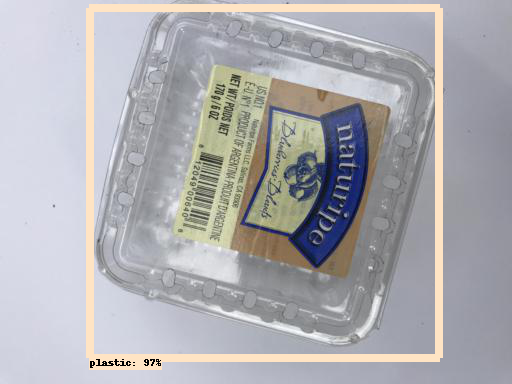

[0.97432446 0.08038177 0.06417903 0.06102195 0.06010623 0.0549911
 0.05231741 0.0510956  0.04972701 0.04864185 0.04357911 0.04225952
 0.04063079 0.03950327 0.03750495 0.03743945 0.03701966 0.03673771
 0.03300658 0.0295702  0.02882514 0.02871658 0.02770097 0.02597766
 0.02564021 0.0254903  0.02535602 0.02499556 0.0246807  0.02445986
 0.024257   0.02341074 0.0231286  0.02297135 0.02219865 0.02214287
 0.02211102 0.0219813  0.02186283 0.02141585 0.02137293 0.02118984
 0.02073536 0.02067092 0.02046436 0.02042514 0.01987232 0.01978255
 0.01953667 0.01952412 0.01951935 0.0195024  0.01940431 0.01933066
 0.01933064 0.01926265 0.01868872 0.01867656 0.01866079 0.01861859
 0.01860375 0.01851376 0.01843089 0.01835467 0.01834744 0.01813164
 0.01790944 0.01773468 0.01765937 0.01759239 0.01758664 0.01755097
 0.01755006 0.0173931  0.0171527  0.01705074 0.01698594 0.01690798
 0.01672753 0.01667275 0.0166201  0.01655784 0.01646093 0.01645075
 0.01642644 0.01642202 0.01636421 0.01628162 0.01623473 0.01621

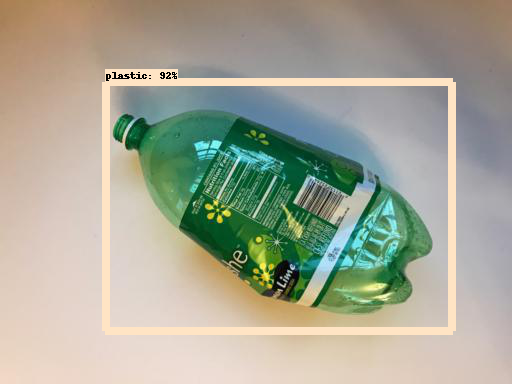

[0.92210424 0.31369892 0.2917184  0.20365435 0.15903579 0.11760924
 0.08317432 0.05394315 0.05330822 0.05261385 0.05217577 0.04334385
 0.0407841  0.04022225 0.03983165 0.03873255 0.03872535 0.03676349
 0.03639543 0.03627574 0.03624044 0.03556297 0.03527286 0.03524689
 0.03375257 0.03290682 0.03270667 0.0322772  0.03137053 0.03097982
 0.03096333 0.03049639 0.03022835 0.0301419  0.03008659 0.02964311
 0.02958638 0.02953991 0.02944677 0.02928014 0.02892767 0.02891814
 0.02889786 0.02865472 0.02863754 0.02841404 0.02829466 0.02743939
 0.02712079 0.02710751 0.02670057 0.02658482 0.0264914  0.02643139
 0.02640958 0.0263054  0.02614581 0.0259329  0.02538509 0.02538331
 0.02524622 0.02509888 0.02496544 0.02491593 0.02477852 0.02476439
 0.02469881 0.02432297 0.02427776 0.02424487 0.02406594 0.02395167
 0.02389229 0.02379117 0.02374111 0.02369339 0.02356452 0.02351213
 0.02328514 0.02321431 0.02320188 0.02307601 0.02304245 0.02290951
 0.02271406 0.02269488 0.02254792 0.02253391 0.02244892 0.0223

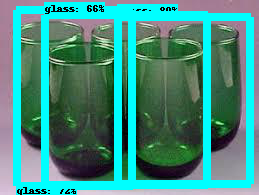

[0.8037722  0.7177183  0.65786886 0.31052834 0.3104259  0.21200798
 0.20267072 0.19270806 0.16439794 0.15281774 0.14411794 0.14122868
 0.13742442 0.13706097 0.12772895 0.12666523 0.1257334  0.1257058
 0.12221852 0.11258998 0.10666594 0.10456744 0.10179566 0.10133648
 0.10044298 0.09620665 0.09587964 0.08649282 0.08617537 0.08408359
 0.08206759 0.08186897 0.080609   0.07690882 0.0756802  0.07560065
 0.07543889 0.0740147  0.073807   0.07371648 0.07328065 0.07064328
 0.07050643 0.06843785 0.06681123 0.06671707 0.06601463 0.06466247
 0.06202842 0.06162925 0.05873411 0.05730337 0.05696856 0.05676652
 0.05636063 0.05591832 0.05453229 0.05404275 0.05245334 0.05194906
 0.05132853 0.05128939 0.05064015 0.04973799 0.04925216 0.04886962
 0.04796164 0.0475026  0.04745907 0.04719715 0.04653442 0.04642269
 0.04575339 0.04552648 0.0453673  0.04506046 0.04443659 0.04421916
 0.04415363 0.04391368 0.04342061 0.04305077 0.04295061 0.04259147
 0.04228936 0.04062283 0.03868974 0.03847014 0.03830442 0.03769

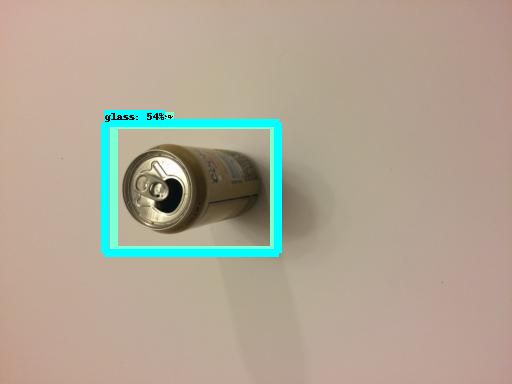

[0.76395226 0.5394716  0.2885588  0.253232   0.17507398 0.16842641
 0.15737647 0.15206815 0.13935249 0.11128788 0.1078913  0.10004253
 0.08588994 0.08244825 0.0762438  0.06941099 0.06677249 0.06660046
 0.06640514 0.06527913 0.06234685 0.0597571  0.05925835 0.05826106
 0.05788531 0.05733346 0.05527717 0.05507775 0.05228402 0.05220186
 0.05144719 0.05099555 0.04840187 0.04830651 0.04799756 0.04762639
 0.04704129 0.04620668 0.04534775 0.04486157 0.04473264 0.04410306
 0.04401523 0.04355691 0.04354629 0.04352091 0.0431562  0.04295081
 0.04229726 0.04174917 0.04149922 0.04079447 0.0405128  0.0399974
 0.03971982 0.03913478 0.03827345 0.03799629 0.03773357 0.0377068
 0.03751449 0.03728728 0.03727423 0.0371929  0.03716579 0.03692212
 0.0361428  0.03585749 0.03546192 0.03518099 0.03491662 0.03480849
 0.03461774 0.03445865 0.03442668 0.03397307 0.03392537 0.0336108
 0.03340771 0.03340456 0.03337009 0.03257184 0.03256616 0.03253335
 0.03251612 0.03251412 0.03248579 0.03242927 0.0323916  0.0323720

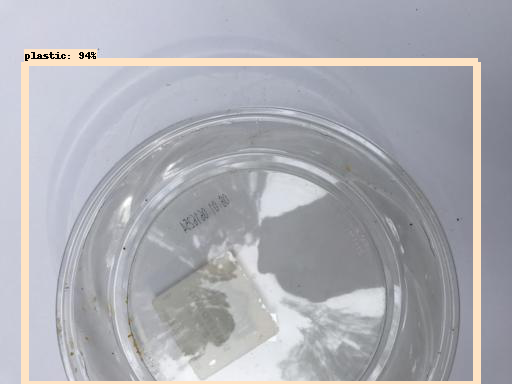

[0.9425452  0.07823335 0.07230639 0.06145343 0.05725113 0.04711151
 0.04628843 0.04421705 0.04404537 0.04389309 0.04323971 0.04023669
 0.03930044 0.03844506 0.03823082 0.03807254 0.03615739 0.03609849
 0.03573886 0.03494361 0.03491003 0.03475333 0.0340078  0.03351082
 0.03131672 0.02982941 0.02928137 0.02874873 0.02828913 0.02818337
 0.02809244 0.02760956 0.02751766 0.02744764 0.02736973 0.0272031
 0.02673806 0.02630159 0.02607488 0.02606907 0.02590862 0.0257684
 0.0256516  0.02545083 0.02524514 0.02523234 0.02487224 0.02454217
 0.02449732 0.02418816 0.02417238 0.02416037 0.02381959 0.02323806
 0.02312608 0.0230358  0.02300812 0.02289831 0.02283593 0.02277333
 0.0226576  0.02244125 0.02211721 0.02211357 0.02187923 0.0217108
 0.02170272 0.02159932 0.0215835  0.02138845 0.02118102 0.02115099
 0.02091561 0.0208519  0.02067763 0.02063805 0.02062631 0.02038145
 0.02032235 0.02029707 0.0201633  0.02012566 0.02003101 0.01983078
 0.01978348 0.01956742 0.01939205 0.01910218 0.01908362 0.0190590

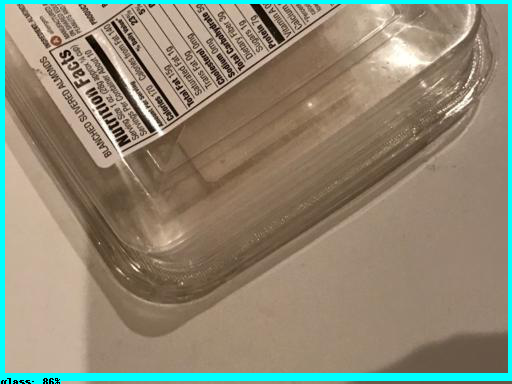

[0.86135864 0.31263536 0.26055658 0.16414414 0.14758097 0.13497767
 0.10985838 0.08614811 0.06773669 0.06517166 0.06172984 0.06074608
 0.06039988 0.05972282 0.0503225  0.04521172 0.04478778 0.04364741
 0.04155189 0.03804612 0.03798665 0.03694779 0.03411464 0.03366578
 0.03272585 0.03218572 0.03214463 0.03172491 0.03117691 0.03105884
 0.03098837 0.03084547 0.03024704 0.02960706 0.02957883 0.02921588
 0.02920932 0.02795415 0.02789609 0.02748966 0.02734092 0.02692343
 0.02692108 0.02690837 0.02690628 0.02668892 0.0263728  0.026125
 0.02582085 0.02573369 0.02441844 0.02437189 0.02369345 0.02346222
 0.02315618 0.02311102 0.02289707 0.0228758  0.02281498 0.02275056
 0.02264904 0.02262698 0.02258084 0.0222012  0.02218802 0.02208667
 0.02202073 0.02199656 0.02193553 0.02193095 0.02188869 0.02187519
 0.02156764 0.02140116 0.02126454 0.02126181 0.02121612 0.02107249
 0.02101912 0.0209832  0.0209205  0.02079562 0.02075276 0.0207331
 0.02067106 0.02057659 0.02055859 0.02055366 0.02046667 0.0202299

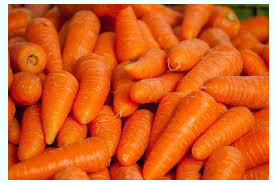

[0.92834467 0.32613397 0.2675176  0.24484582 0.24295358 0.23627174
 0.21701722 0.21676025 0.20379111 0.20169787 0.195925   0.19585297
 0.1953217  0.19121158 0.18460658 0.1801042  0.17344546 0.17326403
 0.16396089 0.16229002 0.16121028 0.15558186 0.15323278 0.15213591
 0.14884274 0.14867319 0.14835158 0.14827515 0.14745931 0.14551541
 0.14371388 0.13704191 0.13566855 0.13448298 0.1344085  0.1342951
 0.13415453 0.13324966 0.13275161 0.13143316 0.12708612 0.12410803
 0.1234082  0.12308639 0.12302263 0.12238145 0.12008646 0.11946344
 0.11898433 0.11691523 0.11609407 0.11526696 0.11179702 0.11153489
 0.11151931 0.1106628  0.10763302 0.10712043 0.10635028 0.10602269
 0.1060052  0.10459829 0.10448369 0.10446789 0.10332118 0.10266291
 0.10210574 0.10187368 0.1004014  0.10012594 0.09931304 0.09839277
 0.09772173 0.09749144 0.0973624  0.09719512 0.09628881 0.09627305
 0.0962711  0.09587057 0.09540462 0.09488965 0.09485019 0.09432552
 0.09424476 0.0940451  0.09288263 0.09225926 0.09102825 0.09058

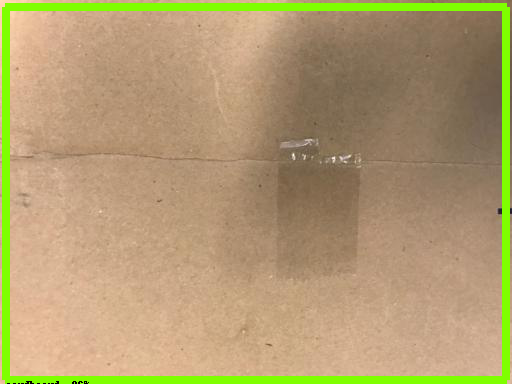

[0.9604441  0.10077992 0.08417226 0.08161322 0.07585291 0.07231894
 0.06243905 0.0609551  0.05843197 0.0549306  0.05363265 0.05086488
 0.04760654 0.0454214  0.04425726 0.04368603 0.0427949  0.04151076
 0.04033571 0.04011038 0.03999722 0.03919555 0.03911202 0.03885697
 0.03825624 0.03742679 0.03740485 0.03658966 0.0360654  0.03496961
 0.03496605 0.03491767 0.03420997 0.03388627 0.03388193 0.03386744
 0.03359289 0.03340943 0.0330945  0.03308418 0.03300974 0.03297589
 0.03286518 0.03283465 0.03241619 0.03127089 0.03099718 0.03082151
 0.03066106 0.03064579 0.03025124 0.03006875 0.02998323 0.02963625
 0.02915439 0.02913981 0.02910285 0.02899129 0.02894279 0.02889537
 0.02867253 0.02861028 0.02852269 0.02839274 0.02828713 0.02820036
 0.02802689 0.02796238 0.02786596 0.02772239 0.02766567 0.02732466
 0.02721469 0.02718744 0.02716197 0.0269781  0.02682948 0.02681419
 0.02675454 0.02670961 0.02667577 0.02654946 0.02624448 0.0259982
 0.02589249 0.02571944 0.02568696 0.02556797 0.02542429 0.02541

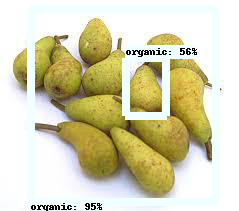

[0.9518381  0.5620955  0.40540478 0.4021989  0.39208168 0.3918496
 0.3681583  0.28364778 0.2660582  0.19254328 0.18028595 0.17425467
 0.16468744 0.14703201 0.14116722 0.14087167 0.13921528 0.12758192
 0.11827453 0.11562527 0.11310767 0.11305071 0.10611171 0.10086814
 0.09917498 0.09888931 0.09656539 0.09557162 0.09527782 0.0911324
 0.09000358 0.08856367 0.08826011 0.08514238 0.08116885 0.07961252
 0.0792844  0.07927605 0.07919534 0.07888267 0.07851817 0.07691322
 0.07606586 0.07524379 0.07288748 0.07276557 0.07271295 0.07148909
 0.06781807 0.06667273 0.06588861 0.0653212  0.06526509 0.06500031
 0.06476398 0.06458498 0.0631916  0.06302457 0.0619736  0.06179795
 0.06146038 0.06129314 0.0612309  0.06009182 0.05900507 0.05721331
 0.05667268 0.05663214 0.05640404 0.05587482 0.05521247 0.05517786
 0.05471992 0.05461896 0.05441782 0.05436621 0.0540479  0.0537508
 0.05359633 0.0523684  0.0505344  0.05038914 0.05023174 0.04920689
 0.04765744 0.04666613 0.04657252 0.04626244 0.04586151 0.0458386

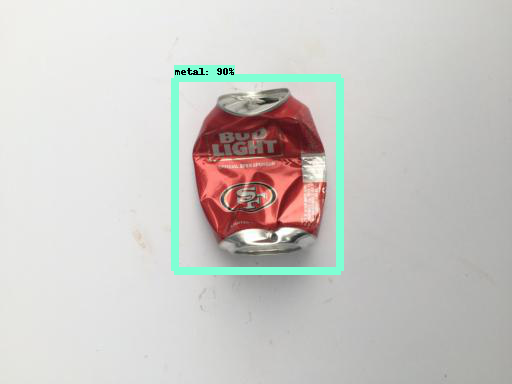

[0.9003427  0.2268346  0.22323598 0.19891058 0.1980811  0.10159798
 0.08300733 0.07109825 0.06412331 0.05856312 0.05384753 0.05295234
 0.04659837 0.04507173 0.0447308  0.04386566 0.04270091 0.042055
 0.04123751 0.04112853 0.04076374 0.04071908 0.04066708 0.04064014
 0.03982143 0.03800851 0.03722557 0.03653039 0.03594633 0.035637
 0.035421   0.03537649 0.03531358 0.03516459 0.0350287  0.03487227
 0.03453757 0.03378855 0.03348344 0.03346691 0.03295023 0.03201291
 0.0319279  0.03175881 0.0315418  0.03139588 0.03104379 0.02987416
 0.02977415 0.02961473 0.02957206 0.02940329 0.02913124 0.02909335
 0.0290713  0.02899706 0.02879125 0.02839565 0.02839022 0.02822755
 0.02804454 0.02786597 0.02778332 0.02771762 0.02766242 0.02760324
 0.02695624 0.02686042 0.02682517 0.026816   0.02655205 0.02640503
 0.02614514 0.02587564 0.0258532  0.02581809 0.0257309  0.02555574
 0.02546903 0.02538923 0.0253795  0.02535208 0.02530299 0.02524212
 0.02515058 0.02502659 0.02457838 0.02453567 0.02443539 0.02438939

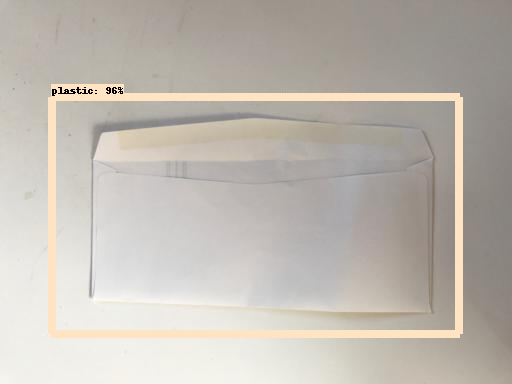

[0.96099764 0.12372821 0.12341373 0.11189316 0.09142755 0.06495038
 0.05602849 0.05399299 0.05379645 0.05164336 0.04721528 0.04338641
 0.04268647 0.03513295 0.03411536 0.03395213 0.0321286  0.03154545
 0.03121285 0.03091819 0.03012919 0.03000407 0.02982018 0.02919726
 0.02835837 0.02795507 0.02761828 0.02758414 0.02757881 0.02691504
 0.02688239 0.02674746 0.02641627 0.02570508 0.02482257 0.02477678
 0.02464211 0.0246326  0.02459638 0.02453225 0.02430179 0.02430036
 0.02406703 0.02400265 0.02395131 0.0239355  0.02373721 0.02357748
 0.02356535 0.0231718  0.02312103 0.02303753 0.02302576 0.02299755
 0.02298221 0.02291297 0.02290738 0.02261066 0.02245454 0.02231454
 0.0222782  0.02139707 0.02134878 0.02111917 0.02105405 0.021025
 0.02101208 0.02100515 0.02100325 0.02090627 0.02056784 0.02050259
 0.02000747 0.01990166 0.01986904 0.01985511 0.01958939 0.01954888
 0.0195437  0.01948885 0.01938186 0.01933985 0.0193283  0.01924623
 0.01913716 0.01912276 0.01909423 0.01902655 0.01895709 0.018868

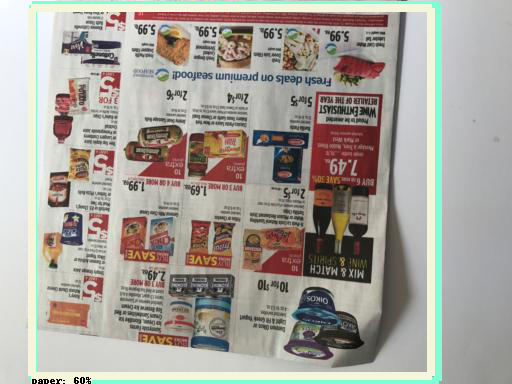

[0.62719333 0.60243833 0.40270036 0.16692111 0.1458872  0.09794194
 0.09466857 0.07852263 0.0723929  0.06098336 0.05817612 0.05435232
 0.05221841 0.0515452  0.05031144 0.04582383 0.04339816 0.04277773
 0.04258651 0.04204351 0.04178004 0.04115772 0.04069066 0.04008669
 0.03909614 0.03803619 0.03686738 0.03599694 0.03520232 0.03378581
 0.03312246 0.03222105 0.03212836 0.03135658 0.03008345 0.029456
 0.02944362 0.02936103 0.02930829 0.02922121 0.0287398  0.02823099
 0.02819006 0.02817533 0.02815902 0.02788028 0.02775246 0.02772031
 0.02768652 0.02751271 0.02737823 0.02724001 0.02705486 0.02700894
 0.02683934 0.0266824  0.0266604  0.02660859 0.02641065 0.02630417
 0.02625972 0.02593662 0.0259097  0.02589175 0.0256588  0.02560507
 0.02544319 0.02536022 0.02516775 0.02485345 0.02474706 0.02463005
 0.02452445 0.02449048 0.02402623 0.02362934 0.02357154 0.02340552
 0.02335753 0.023319   0.02317051 0.02314767 0.02301115 0.02278601
 0.02275882 0.02272842 0.02266214 0.02251535 0.02245053 0.022438

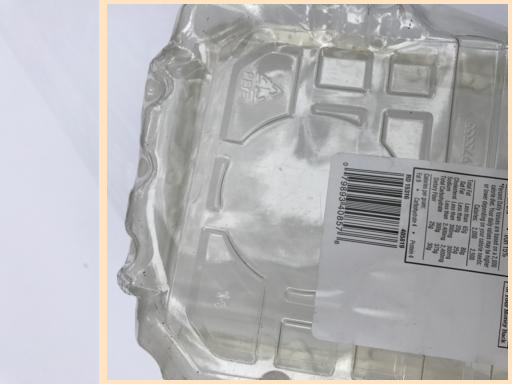

[0.9467306  0.11541943 0.1077304  0.09163382 0.08310559 0.08159088
 0.07506462 0.07326564 0.06883251 0.06563097 0.0653286  0.05501229
 0.0512365  0.04993324 0.0471177  0.04707064 0.04684348 0.04596667
 0.04546143 0.04410755 0.04383575 0.04294895 0.04243464 0.04207111
 0.0416446  0.04055686 0.03969612 0.03963197 0.03922705 0.03866873
 0.03849644 0.03790912 0.03782431 0.0376374  0.03524648 0.03483688
 0.03373595 0.03363148 0.03315927 0.03278245 0.03213144 0.03170449
 0.03151108 0.03138034 0.03102957 0.03096418 0.03081811 0.0303889
 0.0302774  0.0299994  0.02996641 0.02977504 0.02899417 0.02842031
 0.02804686 0.02802861 0.02715344 0.02714736 0.0267059  0.02621494
 0.02602487 0.02601715 0.02576437 0.02571591 0.02551146 0.02529974
 0.02527472 0.0252555  0.02508046 0.02504875 0.02502992 0.02494478
 0.02489838 0.02486179 0.02468976 0.02457433 0.02457105 0.02452147
 0.02446175 0.02445552 0.02438759 0.02435998 0.02425594 0.0241542
 0.02407507 0.02400804 0.02390797 0.0237965  0.02379162 0.023655

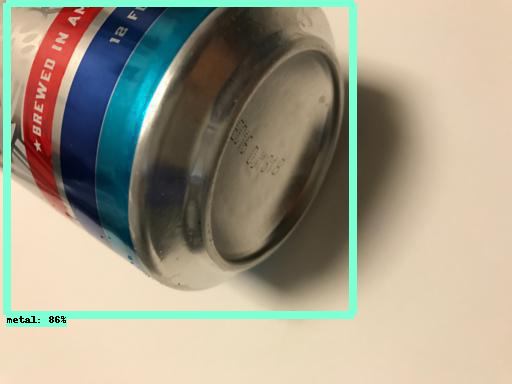

[0.863629   0.3086991  0.29533216 0.23078682 0.1972307  0.10597767
 0.0824388  0.06800684 0.06357151 0.05530213 0.05460746 0.05448447
 0.05074796 0.05034526 0.04837002 0.04654908 0.04574954 0.04505235
 0.04489435 0.04277352 0.04245049 0.04238613 0.040843   0.0391743
 0.03880724 0.03828484 0.03797164 0.03658337 0.03549785 0.03527031
 0.03507242 0.034655   0.03425323 0.03404656 0.03359165 0.03316673
 0.03263845 0.03262458 0.03254111 0.03230762 0.03212163 0.03182125
 0.03175336 0.0308     0.03061135 0.0304271  0.03019181 0.03017379
 0.02912303 0.02900374 0.02899277 0.02840436 0.02808765 0.02808562
 0.02801803 0.02761338 0.02745108 0.02733064 0.02720509 0.02719384
 0.02699286 0.02662748 0.02627823 0.02626685 0.02611137 0.02583141
 0.0256856  0.02544364 0.02543133 0.02541016 0.02535911 0.02514607
 0.0251404  0.02510675 0.02508755 0.02507912 0.02463109 0.02424735
 0.02419382 0.02416304 0.02410652 0.02402745 0.02399306 0.02387369
 0.02381184 0.02377809 0.0236883  0.0236121  0.02324026 0.02318

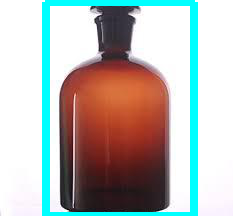

[0.9379892  0.35860977 0.22349799 0.16825484 0.12223043 0.10627858
 0.10255209 0.06849295 0.06842169 0.06760125 0.06700955 0.06630727
 0.05462663 0.0536783  0.03996438 0.03982195 0.03981249 0.03914394
 0.03893343 0.03884569 0.03849193 0.03827429 0.03780258 0.03754049
 0.03685203 0.036435   0.03643034 0.03614622 0.03584421 0.03583465
 0.03512288 0.0347098  0.03438162 0.03435223 0.03431873 0.03425756
 0.03415857 0.03410558 0.03403546 0.03403191 0.03299288 0.03251069
 0.03197562 0.03184837 0.03184271 0.03170865 0.0315925  0.03151068
 0.03147848 0.03105964 0.03033107 0.0300479  0.02979462 0.0296921
 0.02944183 0.02925785 0.02915636 0.02911431 0.02870139 0.02858113
 0.02808707 0.02789533 0.0277428  0.02768885 0.02741727 0.0273738
 0.0271962  0.02687185 0.02645686 0.02632183 0.02625302 0.02619917
 0.02609807 0.02606309 0.02581013 0.02571144 0.02531526 0.02510681
 0.02473867 0.02468228 0.02460438 0.02453867 0.02440738 0.02425101
 0.02407177 0.02392161 0.02385525 0.0238031  0.02379534 0.023516

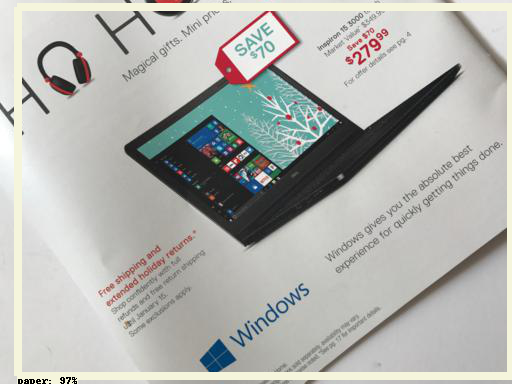

[0.9656084  0.15396975 0.09189654 0.08404636 0.07567939 0.06585742
 0.060855   0.05578654 0.05354043 0.05345438 0.0522171  0.05198781
 0.05138441 0.0512728  0.05020189 0.05003041 0.04806623 0.04585228
 0.04404511 0.03989675 0.03971064 0.03932442 0.03864418 0.03634913
 0.03589708 0.0340201  0.03326962 0.03071805 0.03061688 0.03021263
 0.02992652 0.02973611 0.02950896 0.02891162 0.02867501 0.02837022
 0.02800847 0.02717027 0.02709629 0.02707782 0.02660864 0.02653374
 0.02642744 0.02589104 0.02574907 0.02563698 0.02540552 0.02522145
 0.02492091 0.02483684 0.02478915 0.02420165 0.02409179 0.0239564
 0.02388434 0.0238779  0.0237986  0.02374956 0.02373426 0.02364537
 0.02339005 0.0231357  0.0230484  0.02256878 0.02235643 0.0222603
 0.02204576 0.02186477 0.0218562  0.02185226 0.02182487 0.02141088
 0.02140311 0.02138283 0.02121912 0.02105127 0.02104865 0.02094748
 0.02077253 0.02067438 0.02045104 0.02039605 0.02019483 0.0201332
 0.02005832 0.01998216 0.01995561 0.01982964 0.01974697 0.0196860

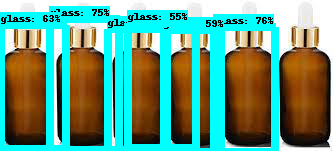

[0.75566167 0.74605227 0.6432337  0.63392913 0.5933416  0.5538692
 0.4791622  0.41138068 0.39565346 0.25605002 0.21998762 0.19210443
 0.18719329 0.17725287 0.15469399 0.1537677  0.15131712 0.15102643
 0.15094021 0.1506956  0.14837292 0.1397029  0.13721213 0.13651815
 0.13617449 0.1305533  0.12897685 0.12747586 0.12704758 0.1261618
 0.12597993 0.1252043  0.12498468 0.12400153 0.1239623  0.12377918
 0.12287436 0.12234057 0.11823542 0.1178963  0.11701884 0.11599223
 0.11546215 0.11388543 0.11361138 0.11176756 0.10951667 0.10917378
 0.1058771  0.10352251 0.10201987 0.10178301 0.10114648 0.10030061
 0.09985989 0.09979785 0.0991027  0.09792298 0.09761205 0.09747344
 0.09739781 0.09726507 0.09455889 0.09437368 0.09317726 0.09177922
 0.08884499 0.08836157 0.08808557 0.08749735 0.08731648 0.08710753
 0.08508462 0.08465189 0.08300897 0.08213739 0.0813841  0.08110267
 0.08048143 0.08045866 0.07876386 0.07847928 0.07830345 0.07736062
 0.07687931 0.07662652 0.07511348 0.07329132 0.07256153 0.072509

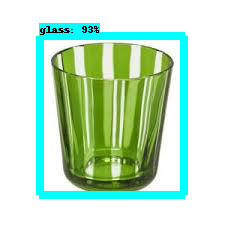

[0.9271017  0.3249681  0.12116363 0.1181738  0.10190135 0.08516444
 0.06306168 0.06204993 0.06122519 0.06074903 0.05981736 0.05019892
 0.05008723 0.04988154 0.04963183 0.04929043 0.04916127 0.04859895
 0.04842051 0.04775643 0.04589777 0.04578177 0.04543358 0.04538545
 0.04454867 0.04386545 0.04271865 0.04173904 0.04114743 0.04088369
 0.04065435 0.03923963 0.03783743 0.03742642 0.03664793 0.03644923
 0.03580276 0.0350097  0.03443189 0.03432751 0.03353836 0.03270252
 0.03258231 0.03237485 0.03221274 0.03195058 0.03176954 0.03145837
 0.03081225 0.03057455 0.03055677 0.03049526 0.03032171 0.03028016
 0.02987017 0.02979059 0.02949517 0.02943364 0.02931801 0.02919778
 0.02905782 0.02858823 0.02850277 0.0283264  0.02800442 0.02745408
 0.02739621 0.02724315 0.02710968 0.02682428 0.02669297 0.02642275
 0.02633725 0.02619857 0.02572162 0.0257119  0.02569296 0.02552482
 0.02547297 0.02525412 0.02518834 0.02511139 0.02492816 0.02466001
 0.02463857 0.02456384 0.02447641 0.02438388 0.02420183 0.0241

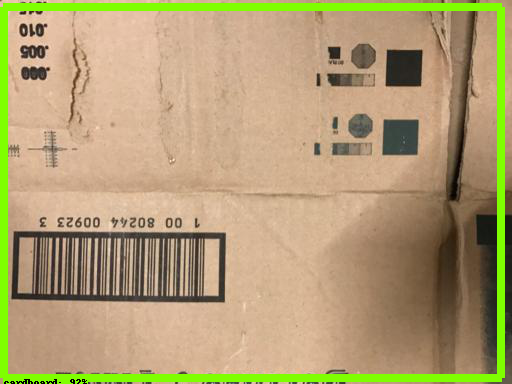

[0.9208112  0.26063707 0.16761155 0.1039887  0.1009234  0.10068859
 0.10053586 0.08563538 0.07186452 0.07071307 0.06852261 0.0664303
 0.06440438 0.06333026 0.06230343 0.04766868 0.047624   0.04622117
 0.04610655 0.04486299 0.04412117 0.04384625 0.04207629 0.04192111
 0.04050642 0.04005973 0.03965095 0.03895031 0.03827789 0.03760398
 0.03760239 0.03594955 0.03503721 0.0349957  0.03372811 0.03342604
 0.03320685 0.03262931 0.03261568 0.03247859 0.03227172 0.03197044
 0.03191688 0.03121178 0.03107519 0.03049696 0.03048277 0.03042857
 0.03030355 0.03019666 0.03008709 0.02952019 0.02946414 0.02897248
 0.02890144 0.02799785 0.02780631 0.02779925 0.02742237 0.02705829
 0.02671153 0.02642441 0.02621534 0.02615307 0.02580939 0.02550277
 0.02529003 0.02505848 0.02491298 0.02481258 0.02477451 0.0242491
 0.02408963 0.02355069 0.02342347 0.0233979  0.02324584 0.02311701
 0.02302923 0.02302723 0.02302114 0.0228398  0.022817   0.02268557
 0.02268383 0.02264411 0.02247099 0.0224232  0.02232875 0.022302

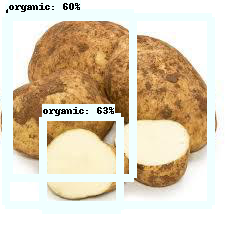

[0.90851146 0.6251277  0.59757924 0.38721284 0.3450543  0.28163266
 0.22953343 0.1811565  0.17439902 0.17007461 0.13315381 0.12055054
 0.11505219 0.11115845 0.10285367 0.09877957 0.09133862 0.09118528
 0.08859504 0.08789697 0.08751287 0.08217751 0.0767335  0.07544518
 0.07288877 0.07088715 0.06929264 0.06815223 0.06779603 0.06515555
 0.0647778  0.06443955 0.05917448 0.05812217 0.05725439 0.05703115
 0.0562868  0.05505127 0.05454683 0.05423398 0.05285269 0.05268924
 0.05157517 0.05067789 0.04755523 0.04720129 0.047006   0.04614964
 0.04570501 0.04340309 0.04330869 0.04304567 0.04265171 0.04232888
 0.04129095 0.04115063 0.04062274 0.04031468 0.04014735 0.04004947
 0.03983029 0.03954063 0.03953011 0.03937765 0.03928018 0.03900401
 0.03889774 0.03878744 0.03808989 0.03795898 0.03785232 0.03761815
 0.03749009 0.03746745 0.03732743 0.03578143 0.03428509 0.03402378
 0.0336656  0.03327845 0.03239686 0.03239118 0.03172667 0.0316722
 0.03154612 0.03144151 0.03139569 0.03109143 0.03077305 0.03055

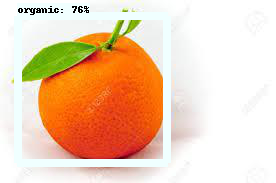

[0.75527513 0.27277848 0.1167797  0.11437411 0.09809309 0.09486517
 0.094429   0.08045577 0.07203136 0.05945589 0.05611509 0.05212489
 0.05073735 0.04813531 0.04768653 0.04501969 0.04243766 0.04207787
 0.04124673 0.04035798 0.04027779 0.03997508 0.03989493 0.03988478
 0.03963888 0.03942416 0.03876161 0.0386576  0.037909   0.03785914
 0.03756311 0.03747914 0.03734215 0.03682148 0.03646007 0.03623902
 0.03620515 0.03589699 0.03585521 0.03552033 0.03516506 0.03456828
 0.03454929 0.03441802 0.03430436 0.03398321 0.03387952 0.03383983
 0.03373477 0.03326278 0.03310615 0.03305312 0.03289766 0.03286026
 0.03268836 0.03156366 0.0312677  0.03116977 0.0311351  0.03092713
 0.03077513 0.03076997 0.030677   0.03063507 0.03057316 0.03046136
 0.03029926 0.02964515 0.02922134 0.02902347 0.02889121 0.02876382
 0.02833789 0.02800292 0.02795345 0.02754912 0.02742189 0.02733837
 0.02709231 0.02686693 0.02682552 0.02673153 0.02650055 0.02636228
 0.02627674 0.02620755 0.02619205 0.0261304  0.026122   0.0259

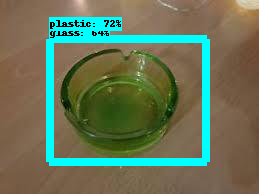

[0.723354   0.63513756 0.21249756 0.16481091 0.16458356 0.1637179
 0.13277282 0.12852699 0.12659545 0.09198481 0.08342335 0.08340713
 0.08243535 0.07754836 0.07594837 0.07492239 0.07013477 0.06885587
 0.06840578 0.06678882 0.06346031 0.06132405 0.06013499 0.05941754
 0.05884297 0.05701163 0.05672058 0.05554993 0.05545256 0.05518956
 0.05321547 0.05082577 0.05058632 0.05058569 0.05032366 0.0501539
 0.04838705 0.04817093 0.04700727 0.04498291 0.04471996 0.04454533
 0.0441393  0.04398137 0.04348179 0.04311505 0.04184024 0.04154416
 0.04060092 0.04040375 0.04020878 0.03955096 0.03945038 0.03899831
 0.03829746 0.03825044 0.03807618 0.03736067 0.03733211 0.03705939
 0.03687938 0.03657005 0.03642956 0.0359649  0.03548041 0.0352712
 0.0347673  0.03401452 0.03381686 0.03375563 0.0334852  0.03326216
 0.03310024 0.03305243 0.03284914 0.03266035 0.03250243 0.03229406
 0.03145408 0.03130166 0.0312403  0.03108571 0.03086888 0.03080229
 0.0306714  0.03063373 0.03050893 0.02999383 0.02997075 0.0298912

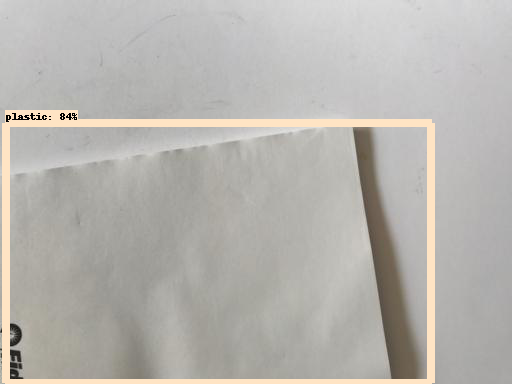

[0.8417648  0.47465777 0.23234768 0.22856958 0.2157614  0.20175578
 0.19260338 0.146539   0.11336426 0.08947226 0.08270286 0.08161501
 0.07149108 0.07146355 0.07074685 0.06754266 0.06080905 0.05793055
 0.05665981 0.05654873 0.05619958 0.04843238 0.04835742 0.04666777
 0.04449027 0.04398699 0.0435503  0.04343653 0.04321594 0.04246375
 0.04127903 0.04105304 0.04024661 0.03991289 0.03970816 0.03860798
 0.03795806 0.03721699 0.03680208 0.0367927  0.0363795  0.0360088
 0.03562202 0.03550679 0.03549369 0.03549289 0.03463121 0.0346094
 0.03452348 0.03436046 0.03430985 0.03359508 0.03336043 0.03315922
 0.03304275 0.03281342 0.03268442 0.03251411 0.03242213 0.03241014
 0.03224904 0.03208549 0.03166176 0.03136548 0.03115436 0.03114342
 0.03106841 0.03089681 0.03088676 0.03066751 0.03049789 0.02997019
 0.02989523 0.02943687 0.02898572 0.02896057 0.02891409 0.02882081
 0.02875079 0.02868938 0.02837013 0.02804995 0.02803982 0.0280185
 0.0280114  0.02800634 0.02756952 0.02756309 0.0271579  0.0268521

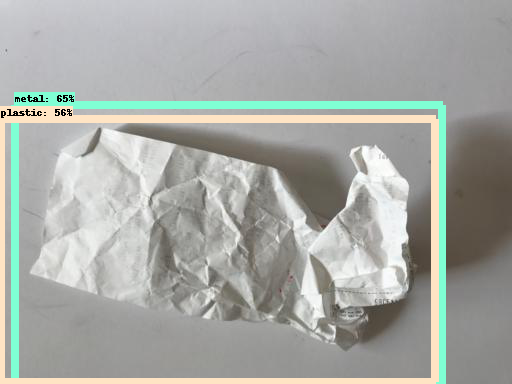

[0.6479444  0.55684745 0.44372243 0.14135796 0.1381162  0.1000172
 0.07407437 0.07279557 0.06235657 0.05911298 0.05809982 0.05334339
 0.04590679 0.04546857 0.04104402 0.04083341 0.04024022 0.03954793
 0.03939503 0.03791371 0.03745999 0.03706191 0.03642275 0.03609939
 0.0356674  0.0354245  0.03445119 0.03439389 0.03435417 0.03360352
 0.03351944 0.0334854  0.03317435 0.03207091 0.03204007 0.03137923
 0.03097376 0.0309296  0.03041325 0.02981124 0.02966109 0.02955464
 0.0295533  0.0295445  0.02950484 0.02923747 0.02840365 0.02822046
 0.0281824  0.02809322 0.02784204 0.02771292 0.02764685 0.02758318
 0.02756651 0.02737083 0.02694011 0.02648952 0.02641519 0.02621323
 0.0261238  0.02601664 0.02592981 0.02555228 0.02543552 0.02539195
 0.02524921 0.0251157  0.02508108 0.02485455 0.02474943 0.02474282
 0.02468937 0.02453933 0.02426211 0.02425794 0.02417112 0.02414658
 0.02411562 0.02407664 0.02399505 0.02389506 0.02378642 0.02377908
 0.02376417 0.0236973  0.02369503 0.02361333 0.0235464  0.02341

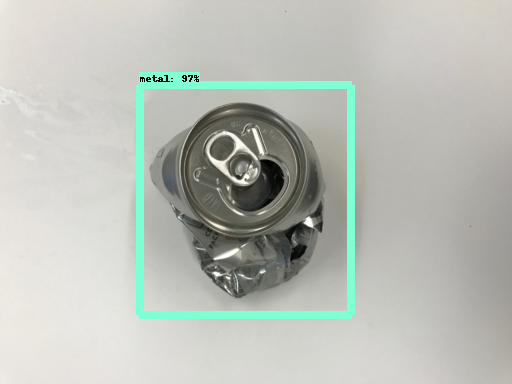

[0.9688083  0.25708175 0.2163759  0.17524195 0.15845059 0.14001754
 0.07054695 0.07019061 0.06803779 0.06586272 0.05444265 0.05392295
 0.0526646  0.05039013 0.05036185 0.04791518 0.04615888 0.04583547
 0.04570355 0.04487346 0.04423147 0.04096503 0.04078995 0.04020615
 0.03934396 0.03907727 0.03870128 0.03823976 0.03771289 0.03748709
 0.0372869  0.03668118 0.03627469 0.03543336 0.03514097 0.0343009
 0.03425861 0.03373275 0.03364021 0.03349975 0.03295822 0.03250292
 0.03237335 0.03230058 0.03212357 0.03172966 0.03126917 0.03115772
 0.03102949 0.03096627 0.0309162  0.03072969 0.03069273 0.03066898
 0.03048041 0.03022215 0.02984358 0.02974624 0.02964471 0.02954897
 0.02924684 0.0292397  0.02921291 0.02911458 0.02883049 0.02852539
 0.02811817 0.02796299 0.02760555 0.0274186  0.02725995 0.02716744
 0.02711818 0.02707064 0.02705837 0.02681883 0.02678789 0.02677822
 0.02631799 0.02630897 0.02604302 0.02597092 0.02589029 0.02570668
 0.02558672 0.02557633 0.02535567 0.02534155 0.02516736 0.02515

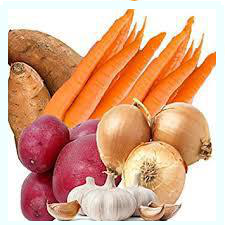

[0.9193577  0.2957958  0.25751063 0.2483552  0.1792542  0.16204403
 0.14522117 0.13617958 0.12731397 0.12714669 0.123624   0.12295368
 0.12159868 0.11660441 0.11283108 0.10288162 0.10156094 0.09070642
 0.09049085 0.09028115 0.08328653 0.08239085 0.07997125 0.0741922
 0.07244124 0.07219431 0.07096139 0.07064473 0.06939776 0.06891155
 0.06879404 0.06800035 0.06796715 0.06284411 0.06215209 0.06162037
 0.06148152 0.05934558 0.05917667 0.05875531 0.05842262 0.05654456
 0.05555513 0.05543103 0.05524275 0.05515474 0.05498641 0.05490945
 0.05123945 0.05098095 0.05021758 0.04974284 0.04944617 0.04831857
 0.04830982 0.04723826 0.04636377 0.04583953 0.04550334 0.04526413
 0.04481752 0.04473285 0.04331882 0.04263923 0.04260289 0.04200353
 0.04159752 0.04122951 0.04122748 0.04115254 0.04053659 0.04036609
 0.040176   0.03961403 0.03880165 0.03869135 0.03861555 0.03859777
 0.03847492 0.03818225 0.03808496 0.03724953 0.03695277 0.03694724
 0.03675732 0.0363069  0.03590371 0.03563384 0.03555149 0.03544

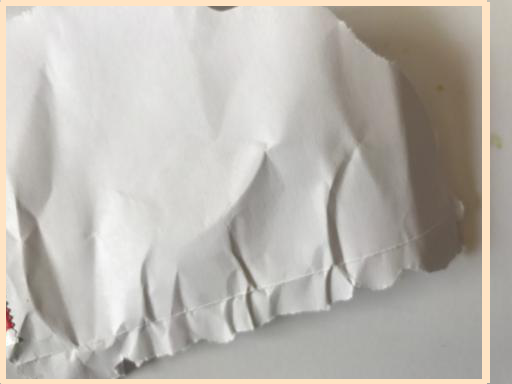

[0.7614019  0.3958489  0.3740853  0.23935279 0.20102319 0.16991974
 0.15607256 0.1213914  0.10820089 0.10565402 0.0996095  0.09922455
 0.09613511 0.09426892 0.08353736 0.08189065 0.07270914 0.06678358
 0.06676343 0.06670659 0.06568515 0.06461659 0.06139018 0.0575086
 0.05716206 0.05533573 0.0525337  0.05164845 0.05153765 0.05069233
 0.05055264 0.05019531 0.04892312 0.04843101 0.04783904 0.04736989
 0.04719667 0.04709889 0.04542962 0.04406179 0.04273367 0.04226378
 0.0410109  0.04090556 0.0405885  0.0405673  0.04052305 0.040358
 0.03982171 0.03964595 0.03957258 0.03945914 0.03889222 0.03801005
 0.03788582 0.03602098 0.03496707 0.03481266 0.03476512 0.03426013
 0.03399228 0.03383423 0.03376736 0.03368336 0.03328047 0.03306505
 0.03277539 0.03276075 0.0326899  0.03243513 0.03241047 0.031329
 0.03112815 0.03105411 0.03101185 0.03087959 0.03087889 0.03082768
 0.03080308 0.03063428 0.03060058 0.0304325  0.02997441 0.0297992
 0.02967435 0.02921472 0.02913863 0.02899333 0.02879585 0.02879333
 

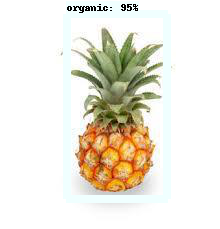

[0.94610685 0.19324985 0.16659851 0.13798773 0.13697872 0.10257801
 0.09296164 0.09041714 0.08577136 0.08141785 0.06154811 0.05584209
 0.05532248 0.0505176  0.04944892 0.0466058  0.04500727 0.04449821
 0.04386577 0.04271573 0.04242101 0.04234391 0.04128422 0.04120506
 0.04118597 0.04117261 0.04093047 0.04045691 0.0404154  0.03986311
 0.03891774 0.03864929 0.03845679 0.03810121 0.03808972 0.03660808
 0.03623429 0.03599594 0.03578244 0.03497353 0.03488157 0.03487517
 0.03487399 0.03462448 0.03450469 0.03440262 0.0341818  0.03411538
 0.03399631 0.03385088 0.03376279 0.03375537 0.03359311 0.03353965
 0.03297077 0.03224145 0.03178901 0.03156101 0.03141607 0.0313224
 0.03115084 0.03060561 0.03039174 0.03022222 0.02946414 0.02944433
 0.02931104 0.02904353 0.02887484 0.02880942 0.02869435 0.02859717
 0.02843327 0.02837183 0.02820601 0.02800016 0.02771613 0.02770119
 0.0275533  0.02719845 0.02699567 0.02660429 0.02648111 0.0263167
 0.02601586 0.02580981 0.0256852  0.02564148 0.02560252 0.025525

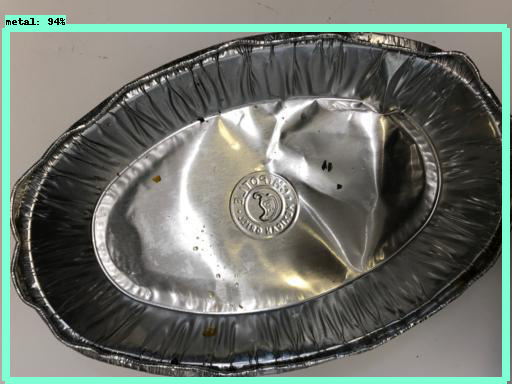

[0.9416297  0.14657494 0.10523763 0.08802133 0.06606771 0.05385444
 0.04974573 0.04897852 0.04709696 0.03490732 0.03457283 0.03433537
 0.0322575  0.03197673 0.03196446 0.03161372 0.03068215 0.02968331
 0.02943638 0.02934012 0.0291326  0.02849089 0.02818595 0.02801939
 0.02798107 0.02795629 0.02764749 0.02755323 0.02720805 0.02701729
 0.02687002 0.0265449  0.02634953 0.02628727 0.02627883 0.02612235
 0.0259893  0.02581953 0.02555815 0.02540985 0.02537349 0.02507237
 0.02435992 0.02435805 0.02430057 0.02414087 0.02323565 0.02315031
 0.02295191 0.02294425 0.02241022 0.02221937 0.02220182 0.02217791
 0.02214333 0.02211374 0.0219806  0.02187088 0.02174029 0.02166502
 0.02153007 0.02149312 0.02135203 0.02127391 0.02123606 0.02091281
 0.02050502 0.02036943 0.02018766 0.020171   0.02012562 0.01995773
 0.01989236 0.01982033 0.01980268 0.01967864 0.01962795 0.01960923
 0.0196017  0.01947416 0.0194582  0.01943193 0.01935261 0.01921552
 0.01915983 0.01912516 0.01893188 0.01891677 0.01891089 0.0188

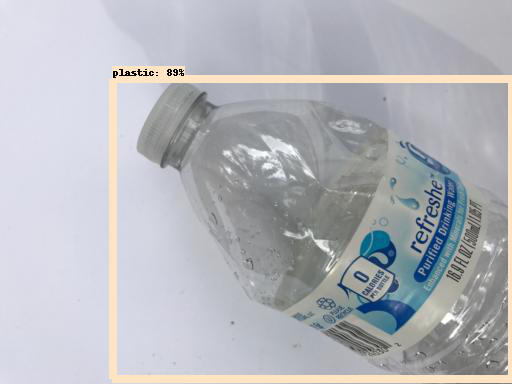

[0.89162606 0.13906516 0.08083514 0.07923914 0.07909609 0.07288108
 0.06910126 0.0678393  0.06570092 0.0580112  0.05337054 0.04880845
 0.04767775 0.04766428 0.04618752 0.04240234 0.04096387 0.04050049
 0.04034286 0.04033231 0.03902768 0.0384174  0.03822191 0.03781244
 0.03633106 0.03572034 0.03551362 0.03538819 0.03531829 0.03485048
 0.03481475 0.03478615 0.03474299 0.03372735 0.03286621 0.03243638
 0.03177342 0.03129476 0.03118465 0.03117546 0.03094874 0.03085597
 0.03077591 0.03065798 0.03035756 0.03025424 0.0301135  0.02986691
 0.02974563 0.02971167 0.02964353 0.02875475 0.02873275 0.0285699
 0.02831708 0.02806083 0.02795877 0.02790399 0.0277504  0.02767695
 0.02707608 0.02707137 0.02578447 0.0253558  0.02530656 0.02527653
 0.02493113 0.02484383 0.02446826 0.02431702 0.02386149 0.02371759
 0.02361003 0.02359745 0.02344063 0.02341934 0.02328847 0.02295945
 0.02291225 0.02285592 0.02271136 0.02261032 0.0224616  0.02233201
 0.02225311 0.0221465  0.02211629 0.02207017 0.02193494 0.02188

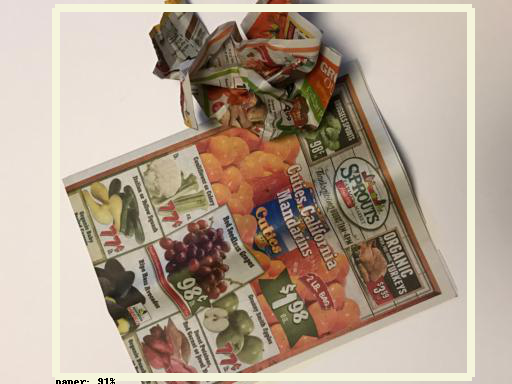

[0.90565854 0.22787061 0.17258379 0.17076696 0.15198863 0.13354199
 0.09875528 0.08585881 0.05407826 0.04355459 0.04093827 0.03971109
 0.03961906 0.03757067 0.03622426 0.03528011 0.03406812 0.03383795
 0.03264839 0.03190181 0.03086342 0.03047419 0.03036683 0.02931661
 0.02898115 0.02890367 0.02849477 0.02832436 0.02819454 0.02816836
 0.02768406 0.0275127  0.02737674 0.02706633 0.0267667  0.02669811
 0.02647557 0.02624767 0.02594346 0.02562072 0.0254946  0.02511207
 0.02506332 0.02494387 0.02487553 0.02485631 0.0247758  0.02476345
 0.02475452 0.02472386 0.02471689 0.02438928 0.02429026 0.0242454
 0.02397792 0.02337229 0.02335256 0.02332587 0.02280908 0.02274493
 0.02264149 0.0222629  0.0221205  0.02166132 0.02163994 0.02154832
 0.02153808 0.02151038 0.02142765 0.02116496 0.02112801 0.02103258
 0.02099339 0.02091867 0.02047465 0.02042314 0.02040665 0.02040153
 0.02036449 0.02029902 0.02017184 0.02015792 0.02004858 0.02000074
 0.0198747  0.01986085 0.01979989 0.01969222 0.01956294 0.01956

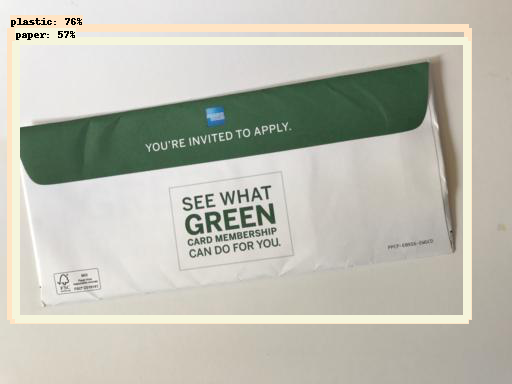

[0.7639426  0.5682898  0.35404196 0.17691296 0.11746255 0.10420153
 0.04377434 0.04316996 0.04184037 0.04111375 0.039023   0.03481148
 0.03453152 0.03440242 0.033412   0.03260344 0.03189404 0.031421
 0.03135961 0.03134796 0.03129557 0.02982333 0.02963633 0.02912543
 0.02902437 0.02871484 0.028497   0.0282952  0.02827881 0.02822774
 0.02806112 0.02796339 0.02775668 0.02767697 0.02764986 0.02745362
 0.027432   0.02741379 0.0273619  0.02686552 0.02666585 0.02665607
 0.02648959 0.02624514 0.02618668 0.02592152 0.0252959  0.02504841
 0.02500373 0.02485248 0.02475369 0.02463865 0.02443777 0.02410265
 0.02406936 0.02405458 0.02380539 0.0237128  0.0236149  0.02338848
 0.02322694 0.02317861 0.02311651 0.02292228 0.02274758 0.02260961
 0.02257932 0.02237442 0.02235402 0.02232501 0.02219369 0.02203405
 0.02197017 0.02189274 0.02180918 0.02179063 0.02172337 0.02157798
 0.02135068 0.02121134 0.02119796 0.02119277 0.02110932 0.02109676
 0.02087229 0.02085728 0.02085355 0.02085052 0.0204776  0.020417

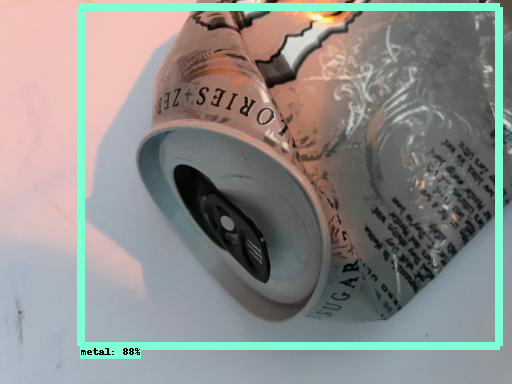

[0.8791123  0.25297016 0.21804212 0.15824926 0.13870753 0.11989357
 0.06171066 0.04898667 0.04637894 0.03968585 0.03844122 0.03817488
 0.03727939 0.0369723  0.03559561 0.03534935 0.03530875 0.0342075
 0.03402093 0.03356155 0.03338614 0.03294946 0.03281428 0.03277355
 0.0325641  0.03209763 0.03193972 0.03100737 0.03098882 0.03057713
 0.03031966 0.03025864 0.03020393 0.02991259 0.02969774 0.02949626
 0.02947727 0.02915226 0.02903691 0.02895675 0.02837144 0.02811734
 0.02793254 0.02789862 0.02726635 0.026557   0.02645441 0.02617162
 0.02589324 0.02561536 0.02554731 0.02510205 0.02500825 0.0249803
 0.02473691 0.02469478 0.02464857 0.02441683 0.02427265 0.02425268
 0.02418346 0.02408488 0.02401458 0.02400625 0.02390606 0.02385332
 0.02372011 0.02365513 0.02333464 0.02330483 0.02327862 0.02322689
 0.02308523 0.02307496 0.02284718 0.02270726 0.02260431 0.02255026
 0.0225427  0.02251132 0.02223892 0.02205644 0.02203739 0.02198727
 0.02196394 0.0219506  0.0219246  0.02183782 0.02142028 0.021009

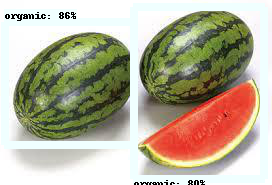

[0.8602773  0.8007867  0.46178663 0.29637975 0.20692804 0.18940462
 0.17793353 0.16047004 0.1558348  0.15468186 0.1497383  0.14939705
 0.14358583 0.10943626 0.10814862 0.09968086 0.08916009 0.08887719
 0.08289278 0.08073302 0.06800301 0.06525106 0.06368519 0.06252313
 0.06156453 0.06103348 0.05079763 0.04674913 0.04659114 0.0438697
 0.04372195 0.04339431 0.04296105 0.04259153 0.0424224  0.04228739
 0.039897   0.03964022 0.03940156 0.03777753 0.03768538 0.03676352
 0.03642121 0.0361335  0.03595588 0.03591061 0.03539189 0.03534907
 0.0344595  0.0343616  0.03429089 0.0337875  0.03350388 0.03279838
 0.03214904 0.03209458 0.0311109  0.03085856 0.03079621 0.03044887
 0.03031161 0.03020504 0.0296348  0.02953299 0.02945967 0.02908328
 0.02890658 0.02869794 0.02825101 0.0281313  0.02809703 0.02792446
 0.0275344  0.02751364 0.02744763 0.0274446  0.0273823  0.02726508
 0.02717219 0.02716891 0.02698351 0.02678413 0.0266468  0.02658234
 0.02644463 0.02641822 0.02637931 0.02604566 0.02578085 0.02572

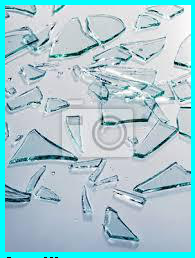

[0.91537297 0.18540485 0.17629904 0.15403834 0.14125259 0.13240765
 0.11237974 0.11185295 0.10996356 0.10690014 0.10286929 0.10121341
 0.09722266 0.09689999 0.09268852 0.09079073 0.08428795 0.08202203
 0.07696744 0.07559709 0.07530998 0.0723463  0.06934067 0.06813516
 0.0679105  0.06656443 0.06596129 0.06505746 0.06503452 0.06405864
 0.06392747 0.06338219 0.06268594 0.06240073 0.06221915 0.06212164
 0.06124058 0.0604157  0.06012534 0.05987925 0.0592718  0.05897537
 0.05772411 0.05721968 0.05619156 0.05604474 0.05510336 0.05458579
 0.05451427 0.05440159 0.05405696 0.0538736  0.05293583 0.05279156
 0.05263853 0.05248591 0.05164521 0.0513967  0.05136359 0.05006965
 0.04958952 0.04923664 0.04892275 0.04845861 0.04834827 0.04794026
 0.04763278 0.04755745 0.04714921 0.04707048 0.04652978 0.04640274
 0.04545552 0.04524914 0.04518526 0.04474984 0.04471049 0.04471048
 0.04441413 0.04419244 0.04370237 0.04340272 0.04325981 0.04310943
 0.04266546 0.04218665 0.04188782 0.0418679  0.04138307 0.0412

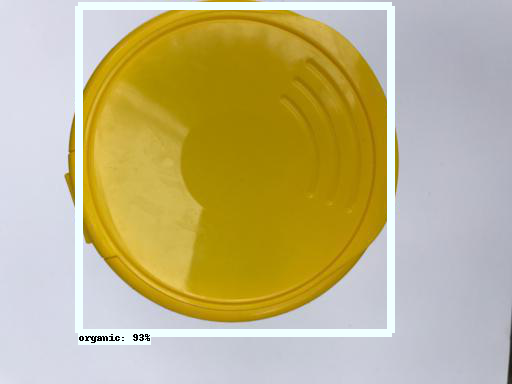

[0.92564136 0.37625453 0.24255182 0.22351688 0.13460039 0.10442114
 0.09201975 0.08084221 0.05786693 0.05650394 0.05163141 0.0499623
 0.04769325 0.04548048 0.04538935 0.04476919 0.04308227 0.04106246
 0.04064158 0.04003615 0.04001281 0.03900625 0.0381126  0.03749024
 0.03624272 0.0358997  0.03345397 0.03304239 0.03282437 0.03104119
 0.03072993 0.02953622 0.02923906 0.02912881 0.02890593 0.02889328
 0.02856958 0.02783962 0.02750158 0.02722602 0.02714732 0.02657976
 0.02610161 0.02603462 0.02602118 0.02538405 0.02501786 0.02477781
 0.02476505 0.02453768 0.02452785 0.0243875  0.02432801 0.02389916
 0.0238144  0.02352892 0.02338105 0.02330765 0.02319307 0.0229648
 0.02280861 0.02235742 0.02218928 0.02217157 0.02206973 0.02201539
 0.02196923 0.02180801 0.02169407 0.02140303 0.02139831 0.0213466
 0.02121446 0.02095474 0.02082535 0.02080505 0.0204218  0.02030673
 0.02025098 0.02018228 0.02014346 0.01985895 0.01983067 0.01976066
 0.01961418 0.01956277 0.01939421 0.01934852 0.0193213  0.0192911

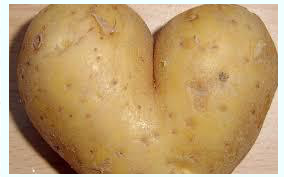

[0.8637155  0.20818761 0.18601039 0.18013075 0.14528377 0.11782351
 0.09982966 0.0958176  0.08899426 0.08816534 0.08584899 0.08172625
 0.07735084 0.0772364  0.07484926 0.07435556 0.07299723 0.07233854
 0.06279775 0.06075943 0.05878915 0.05748012 0.05730235 0.0569366
 0.05647045 0.05632334 0.05247684 0.05202833 0.04948576 0.04943379
 0.04927931 0.04777498 0.04599762 0.04598601 0.04559144 0.04554896
 0.04554614 0.04538019 0.0448024  0.04479572 0.04463059 0.04389801
 0.04361676 0.04295154 0.04287098 0.04239504 0.04208402 0.04206395
 0.04202994 0.04196793 0.04177047 0.04171657 0.04120186 0.04108866
 0.04042112 0.04017954 0.03981742 0.03964745 0.03901662 0.03900618
 0.03895069 0.03843552 0.03810504 0.03805364 0.03777249 0.03769474
 0.03766205 0.03757602 0.03753035 0.03698407 0.03691805 0.03660985
 0.03650789 0.03493838 0.03475953 0.0343309  0.03406168 0.03403462
 0.03398994 0.03333035 0.03332086 0.03327598 0.03321359 0.03314086
 0.03294225 0.03291132 0.0321777  0.03108398 0.03098892 0.03024

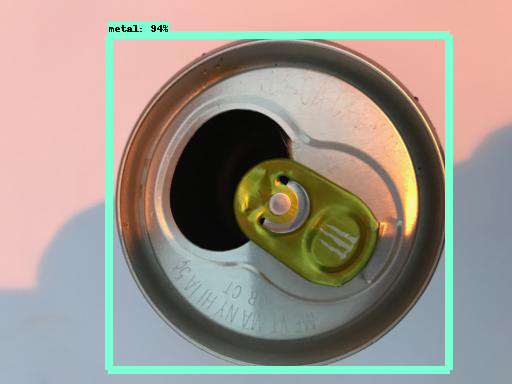

[0.94334555 0.22842166 0.14502819 0.13597251 0.10359516 0.10200641
 0.06767822 0.05716858 0.04491743 0.04358644 0.0422975  0.04143675
 0.0410373  0.03747318 0.03735821 0.03510396 0.03421229 0.03409396
 0.03175265 0.03140019 0.03102654 0.02777465 0.02776812 0.0277506
 0.02758939 0.0273923  0.02632207 0.02571335 0.02570938 0.02448021
 0.02420895 0.02406151 0.02403999 0.02396994 0.02370771 0.02367678
 0.02348035 0.0234338  0.02340918 0.02340495 0.02316485 0.02313397
 0.02308767 0.02295595 0.02290711 0.02287708 0.02253995 0.0224859
 0.02227904 0.02198066 0.02184642 0.02175388 0.02162799 0.02159677
 0.02156259 0.02144368 0.02134637 0.02128892 0.02099088 0.02093746
 0.02080924 0.02069787 0.02063233 0.02061213 0.02038675 0.02027443
 0.0202492  0.01998936 0.01989787 0.01975057 0.01972275 0.0193782
 0.01928584 0.01922073 0.01917433 0.01908933 0.01908428 0.01904927
 0.01891773 0.01889183 0.01887172 0.01886167 0.01879264 0.01862078
 0.01859754 0.01840538 0.01830797 0.01813193 0.01809586 0.0179901

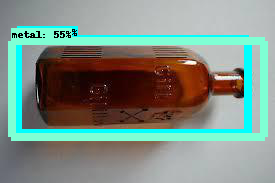

[0.85978574 0.5452576  0.23352738 0.18128774 0.14682896 0.13938761
 0.12743233 0.1142375  0.10286836 0.09720482 0.09148276 0.08279835
 0.0817474  0.0774113  0.07551915 0.07469243 0.07028612 0.06596356
 0.059806   0.05888771 0.05879151 0.05556125 0.05498211 0.05417467
 0.053989   0.05192043 0.05162778 0.05152185 0.05035418 0.04968336
 0.04848397 0.04806117 0.04576253 0.04565684 0.04442736 0.04403937
 0.04364423 0.04336931 0.04254346 0.04107996 0.04085526 0.04079346
 0.03996495 0.03993896 0.03834757 0.03679875 0.03664638 0.03629779
 0.0355373  0.03549787 0.03520569 0.0346581  0.03417217 0.0340073
 0.03393343 0.03379844 0.03376985 0.03372742 0.03320861 0.03309867
 0.03301344 0.03232927 0.03203122 0.03176841 0.03156622 0.03113339
 0.0308159  0.03076201 0.03022974 0.03018618 0.03000073 0.02990095
 0.02944362 0.02884409 0.02874447 0.02871862 0.02848458 0.02810987
 0.02807081 0.02764117 0.02760934 0.0274437  0.02738848 0.02727122
 0.02711133 0.02698621 0.02695947 0.02691855 0.02691299 0.02688

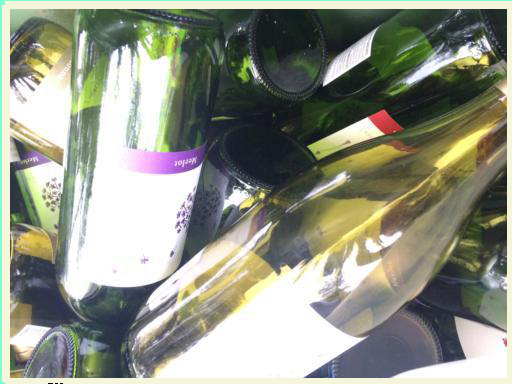

[0.7379948  0.7210551  0.13357158 0.13171741 0.12919225 0.12596044
 0.12366018 0.11980927 0.11559165 0.09999292 0.09165683 0.08792981
 0.08668349 0.0822628  0.07699187 0.07587914 0.07455443 0.07113345
 0.0695344  0.06623565 0.0652422  0.06480679 0.06135178 0.05979955
 0.05956224 0.05821572 0.05773219 0.05513358 0.05425538 0.05387542
 0.05382782 0.05353357 0.05301022 0.05250518 0.05237529 0.05220916
 0.05119477 0.04939438 0.04812689 0.04773121 0.04751555 0.04732108
 0.04649953 0.04628451 0.04554592 0.04537795 0.04526243 0.04515003
 0.04490281 0.04452633 0.04350892 0.0431787  0.04272125 0.04221488
 0.04206895 0.04195872 0.04149811 0.04141407 0.04120356 0.04117748
 0.04094257 0.04087432 0.04084695 0.04030903 0.0403042  0.040107
 0.04000474 0.03975762 0.03873415 0.03866245 0.03805975 0.03798339
 0.03774176 0.03745728 0.03738301 0.03734478 0.03722955 0.03703264
 0.03689294 0.03679775 0.03679718 0.03672078 0.03666427 0.03663415
 0.03649601 0.03634031 0.03605811 0.03589483 0.03577113 0.035705

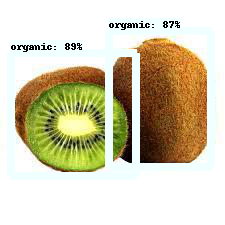

[0.89015234 0.8732185  0.31124535 0.14784165 0.14555569 0.13775468
 0.13528442 0.1303438  0.12781258 0.12216413 0.10804145 0.09924251
 0.08746067 0.08444943 0.08337315 0.0792628  0.0711519  0.06824644
 0.066248   0.06245905 0.05943787 0.05863472 0.05830179 0.05532277
 0.04988413 0.0489023  0.0471705  0.04497508 0.04378567 0.04259848
 0.04218343 0.04181541 0.04154741 0.04150578 0.04128799 0.04124926
 0.04091078 0.04060293 0.04011097 0.03993499 0.03993077 0.03901851
 0.0390011  0.03897939 0.03854059 0.03819723 0.0380032  0.0379944
 0.03718568 0.03707636 0.03698383 0.03671436 0.03655325 0.0363086
 0.03614765 0.03598101 0.03596429 0.03444812 0.0341892  0.03412975
 0.03404242 0.03396961 0.03384393 0.03383758 0.03366448 0.03349847
 0.03323334 0.03254134 0.03239462 0.03100978 0.03064486 0.03002989
 0.02990269 0.02889833 0.02876659 0.02858965 0.02858203 0.02790698
 0.02789722 0.02757086 0.02746408 0.02742303 0.02735033 0.02689159
 0.02658212 0.02649009 0.02623694 0.0261242  0.02586878 0.025772

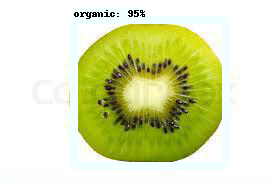

[0.9460045  0.2604589  0.17044568 0.11718588 0.11551355 0.07604998
 0.06939942 0.06013361 0.05251287 0.0499203  0.04973994 0.0497017
 0.04611034 0.04213658 0.04067893 0.04013598 0.03739459 0.03721033
 0.03670644 0.03629585 0.03607072 0.03546385 0.03466909 0.03457125
 0.03430466 0.03416403 0.03399368 0.03358366 0.03345572 0.03293676
 0.03230336 0.03197698 0.03128098 0.0305323  0.03046013 0.03015885
 0.03010014 0.02945234 0.02937651 0.02848732 0.02847475 0.02831386
 0.02805703 0.02772613 0.0275991  0.02757633 0.02728275 0.02724241
 0.02723789 0.02720269 0.02641457 0.02608677 0.02600275 0.02598628
 0.0258117  0.02576471 0.02557856 0.02557038 0.02554972 0.0255164
 0.02539568 0.02531369 0.02530141 0.02525016 0.02509941 0.02489401
 0.02474147 0.0247248  0.02448366 0.02428738 0.02410501 0.023976
 0.02376725 0.02374248 0.02362583 0.02357251 0.02344667 0.02340073
 0.02321898 0.02320544 0.02319334 0.02316977 0.02313765 0.02312537
 0.02311606 0.02305175 0.0225318  0.02230928 0.02229585 0.02214125

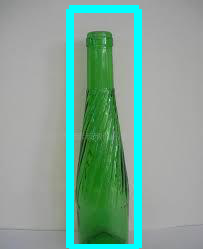

[0.90097463 0.264639   0.21203747 0.18017252 0.16457735 0.15354921
 0.12983657 0.12154714 0.11594406 0.10985787 0.10486928 0.09311418
 0.0899343  0.08825006 0.07671925 0.07060572 0.06837445 0.0667784
 0.06101895 0.0602513  0.05904957 0.05673866 0.05651568 0.05569198
 0.05476965 0.05374828 0.05337569 0.05167957 0.05020854 0.04917511
 0.048624   0.04835419 0.04788034 0.04760514 0.04674463 0.04361186
 0.04289103 0.04173336 0.04128731 0.04095155 0.04085646 0.03998178
 0.03973608 0.03960909 0.03952422 0.03950576 0.03935759 0.03916234
 0.03848854 0.03827106 0.03826058 0.03726448 0.03665115 0.03620384
 0.03617994 0.03615661 0.03607434 0.03558315 0.03543448 0.035425
 0.03497323 0.03495628 0.03464305 0.03420049 0.0338353  0.0334556
 0.0328949  0.03285279 0.03284295 0.0321586  0.03191755 0.03189233
 0.03183173 0.03161091 0.03146324 0.03133626 0.03119548 0.03094219
 0.03071165 0.03067996 0.03055762 0.03053782 0.03037648 0.03036059
 0.03035448 0.03024796 0.03007695 0.0298162  0.0297842  0.02951568

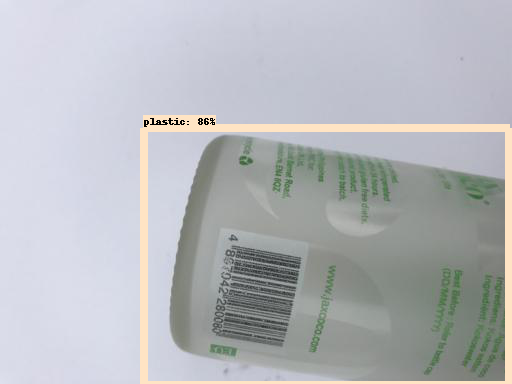

[0.8557995  0.3443899  0.2145062  0.18584162 0.14894325 0.10864139
 0.07959376 0.06524907 0.06250469 0.06037818 0.05862215 0.05598842
 0.05595667 0.05278039 0.05193952 0.05112233 0.04813159 0.04763576
 0.04436599 0.04375656 0.04169678 0.04027197 0.03922804 0.03914573
 0.03873438 0.03871568 0.03764099 0.03579768 0.03547761 0.0354324
 0.03507717 0.03486636 0.03394842 0.03289976 0.03284254 0.03248244
 0.03244396 0.03233333 0.03229065 0.03209549 0.03149772 0.03115581
 0.03097183 0.03096823 0.03047431 0.03039483 0.02998102 0.02995586
 0.02974064 0.02952711 0.02934705 0.02870116 0.02858978 0.02857365
 0.02843469 0.02823495 0.02820184 0.02814003 0.02806875 0.02806258
 0.02780214 0.02772581 0.02751368 0.02748878 0.02747338 0.0269189
 0.0267714  0.02662135 0.02657446 0.02656513 0.02651186 0.0265024
 0.0263183  0.02623054 0.02612653 0.02604793 0.02598097 0.02549857
 0.02531879 0.02524065 0.02507558 0.02505618 0.02495264 0.02474972
 0.02474011 0.02473888 0.02453992 0.02450336 0.02449588 0.0242585

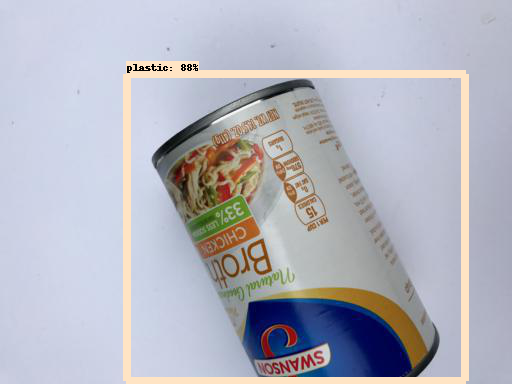

[0.8800905  0.45590827 0.23169754 0.18936911 0.1380022  0.12541033
 0.05714566 0.053165   0.04571356 0.04328691 0.03380217 0.03294226
 0.03162769 0.03141132 0.03101694 0.03038931 0.03032436 0.02976524
 0.02944801 0.02851854 0.02833625 0.02820085 0.02779704 0.02762651
 0.02688642 0.02683481 0.02667475 0.02664892 0.02663196 0.02640274
 0.02584816 0.0253273  0.0253091  0.02530014 0.02525154 0.0251134
 0.02495358 0.02485299 0.02472842 0.02445651 0.0239818  0.0239597
 0.02393567 0.02372189 0.02359994 0.0235675  0.0231469  0.02293484
 0.02282684 0.0228194  0.02265035 0.02219274 0.02214409 0.02199535
 0.02183201 0.02173004 0.02142346 0.02132344 0.02128111 0.02120139
 0.02062715 0.02058871 0.02052102 0.02036655 0.02029159 0.02024934
 0.02021697 0.0202006  0.02019137 0.02009675 0.01995557 0.01987675
 0.01946542 0.01944524 0.01933787 0.01920163 0.01918869 0.01914715
 0.01911037 0.01903598 0.01902738 0.01900334 0.01895382 0.01885798
 0.01871182 0.01866483 0.01864047 0.01863686 0.01855783 0.018554

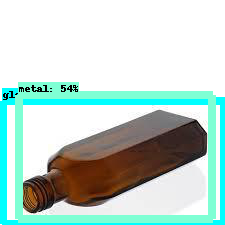

[0.7565346  0.53675103 0.44154993 0.31031665 0.28085855 0.20949408
 0.20704661 0.15499936 0.13542879 0.12829229 0.10686465 0.07989992
 0.07903459 0.07526822 0.07371011 0.06598583 0.06563714 0.06448951
 0.06438975 0.05922223 0.05785118 0.05769855 0.05759457 0.05211227
 0.04906914 0.04895832 0.04852389 0.04697905 0.04692069 0.04685279
 0.04628759 0.04611231 0.04576409 0.04525144 0.04443162 0.04430873
 0.04426998 0.04418802 0.04393914 0.0433748  0.04336052 0.04335838
 0.04305109 0.04253324 0.04186342 0.04166959 0.04165499 0.04118088
 0.04093571 0.04007642 0.03973841 0.03963241 0.03887216 0.03849956
 0.03814942 0.03801097 0.03770871 0.03759603 0.03756069 0.03744491
 0.03743956 0.03733684 0.03732733 0.03732646 0.03732645 0.03732645
 0.03732644 0.03732641 0.03731771 0.03730066 0.03716806 0.03716657
 0.0370416  0.03697103 0.03683264 0.03653688 0.03651296 0.0362355
 0.03611702 0.03500632 0.03471295 0.03467063 0.0344893  0.03443337
 0.03433477 0.03418882 0.03414991 0.03404475 0.03377472 0.03340

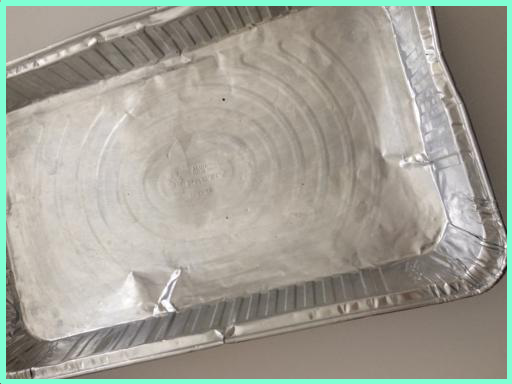

[0.84249234 0.46856412 0.22186169 0.12237408 0.12164322 0.11221845
 0.09404365 0.0736316  0.06580576 0.0580809  0.057515   0.05464697
 0.04972307 0.04808663 0.04689198 0.04637774 0.04400606 0.04309776
 0.04286843 0.04096921 0.04095284 0.04060909 0.03967936 0.03942334
 0.0393009  0.0391175  0.03742628 0.03497324 0.03310283 0.0330008
 0.03169847 0.03136259 0.03106038 0.03075828 0.03070367 0.03027874
 0.02985059 0.02976154 0.02956565 0.02880366 0.02854389 0.02797822
 0.02712209 0.02697829 0.0257082  0.02532167 0.0252378  0.02488023
 0.02472465 0.02458236 0.02457103 0.02452433 0.02412838 0.02405879
 0.02393464 0.0238354  0.02377525 0.02360883 0.02344041 0.02324648
 0.0232364  0.02309432 0.02269786 0.02256066 0.02251817 0.02250483
 0.02247602 0.02230494 0.02208773 0.02203038 0.02185944 0.02151521
 0.02102598 0.02102269 0.02097734 0.02097559 0.02092038 0.02086071
 0.02069435 0.0204422  0.02032992 0.02031875 0.02029317 0.02017984
 0.02017646 0.02002782 0.01998438 0.01996632 0.01990387 0.01989

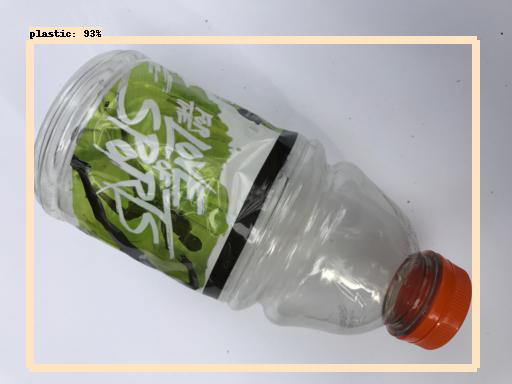

[0.93495095 0.1555092  0.14752589 0.12299198 0.05761803 0.05488699
 0.05429897 0.04872517 0.04806003 0.04732576 0.0457274  0.04572739
 0.04496251 0.04410064 0.04357916 0.04203793 0.04062453 0.03788597
 0.03576259 0.0348557  0.03425194 0.03153056 0.03105106 0.0306839
 0.03038418 0.03013597 0.0296599  0.02906281 0.02854727 0.02811855
 0.02753803 0.02741825 0.02731971 0.02707006 0.02618205 0.02616579
 0.0256336  0.02560472 0.02546648 0.02533403 0.02526176 0.02430137
 0.02426277 0.02326852 0.02323379 0.02292759 0.02285765 0.02271082
 0.02269153 0.02251419 0.02234572 0.02225654 0.02219279 0.02213894
 0.02209464 0.02208214 0.02190464 0.02189502 0.02178041 0.02157806
 0.02154049 0.02134399 0.02118802 0.02107979 0.0210735  0.02082518
 0.02078914 0.0207327  0.02068753 0.02062445 0.02051821 0.02047434
 0.02039067 0.02038032 0.02036105 0.02033966 0.01989549 0.01987082
 0.01986899 0.01982451 0.01980114 0.01979384 0.01973869 0.01960301
 0.01949348 0.01949052 0.01916265 0.01909604 0.01906332 0.01863

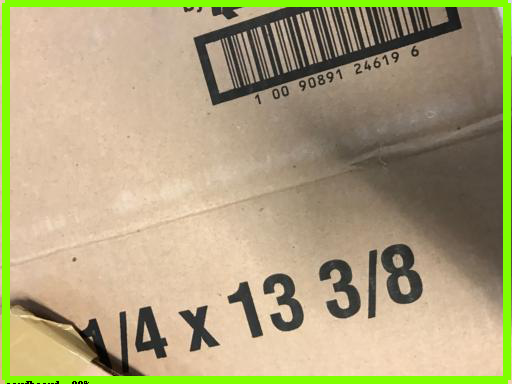

[0.8924354  0.2890154  0.19203542 0.13888684 0.13852358 0.1265405
 0.11660453 0.11060437 0.09974935 0.09744048 0.0965815  0.091554
 0.07783347 0.06845592 0.0673219  0.06629203 0.06533246 0.06477808
 0.06472071 0.06468206 0.06274997 0.05913448 0.05721888 0.0559521
 0.05528624 0.05201706 0.04928089 0.04879511 0.04823306 0.04708292
 0.04667036 0.04611568 0.04548357 0.04527619 0.04494227 0.04491554
 0.04489824 0.04334482 0.04255649 0.04225416 0.0421751  0.04213566
 0.04198382 0.04176915 0.04077249 0.04017599 0.03999583 0.03955688
 0.03939922 0.03882826 0.03800678 0.03719958 0.03679665 0.03621674
 0.0356748  0.03527246 0.03522855 0.03489549 0.0346173  0.03390091
 0.03375222 0.03361687 0.03302283 0.03288489 0.03285271 0.03272657
 0.0326978  0.03256505 0.03134748 0.03134491 0.03128568 0.0311123
 0.03089814 0.03058063 0.03033149 0.02987085 0.02965711 0.02962913
 0.02958626 0.02942257 0.02920045 0.02822834 0.02818177 0.02812478
 0.02798639 0.02773422 0.02763342 0.02762869 0.02761204 0.02737596


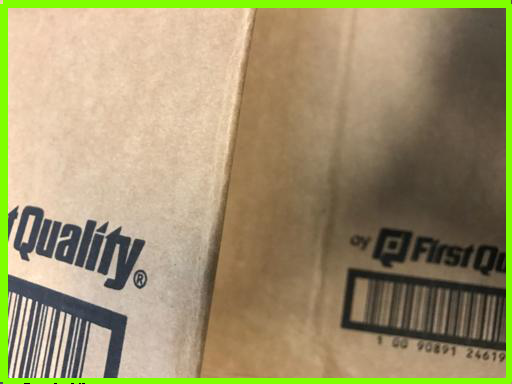

[0.8417446  0.2768833  0.2558385  0.18280798 0.17170139 0.15396252
 0.15176128 0.12601756 0.11167498 0.09359857 0.0824616  0.08176597
 0.07948022 0.07597779 0.07430372 0.073842   0.07038312 0.06695282
 0.06559548 0.06468971 0.06263076 0.06065239 0.06056036 0.05996456
 0.05902266 0.05798191 0.0563301  0.05510116 0.05323002 0.05244556
 0.050719   0.05070636 0.05       0.04976224 0.04915482 0.04901425
 0.04770008 0.04677236 0.0465999  0.04644647 0.04636809 0.04636035
 0.04433345 0.04399943 0.04239432 0.04207264 0.04194623 0.04130407
 0.04129788 0.04076982 0.03939029 0.03934987 0.03918879 0.0390676
 0.03877318 0.03864636 0.03803027 0.03787932 0.03784496 0.0373879
 0.0368594  0.03664611 0.03647995 0.03620047 0.03590613 0.03534297
 0.03513153 0.03512362 0.0351122  0.0350941  0.03499741 0.03438998
 0.03427394 0.03401905 0.03384846 0.03337273 0.03303028 0.03287454
 0.03263974 0.03253023 0.03224132 0.03176295 0.03169292 0.03160807
 0.03117231 0.03096115 0.03092602 0.03066194 0.03051827 0.030183

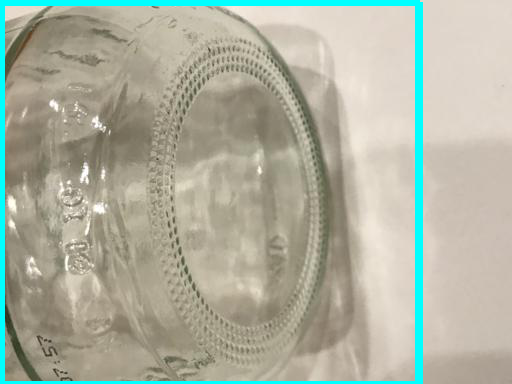

[0.92473096 0.13976242 0.10363495 0.09928618 0.09322155 0.08801118
 0.08412081 0.08094565 0.07938835 0.07677596 0.07622226 0.0758865
 0.07530817 0.07100271 0.06764038 0.061805   0.05791274 0.05736162
 0.05306629 0.05138282 0.05061425 0.04993406 0.04944999 0.04874202
 0.04750852 0.04666833 0.04560113 0.04441418 0.04395514 0.04387964
 0.04345126 0.04321851 0.04263591 0.0418358  0.03997004 0.03908637
 0.03883167 0.03762814 0.0371665  0.03681076 0.03649825 0.03524766
 0.03517412 0.0351611  0.03491733 0.03461615 0.03398144 0.03372397
 0.03359141 0.03304124 0.03275648 0.03172238 0.03131095 0.03123925
 0.03117262 0.03025597 0.02976088 0.02965614 0.02960975 0.02956248
 0.02893988 0.02847181 0.02777506 0.02704818 0.02691512 0.0268783
 0.02653923 0.02653652 0.02650858 0.02630497 0.02627127 0.02604783
 0.0258396  0.02545997 0.02542615 0.02536859 0.02512232 0.02500458
 0.02469099 0.02420155 0.02413832 0.02393212 0.02362868 0.02332979
 0.02332735 0.02324359 0.02315477 0.02300504 0.02285847 0.022684

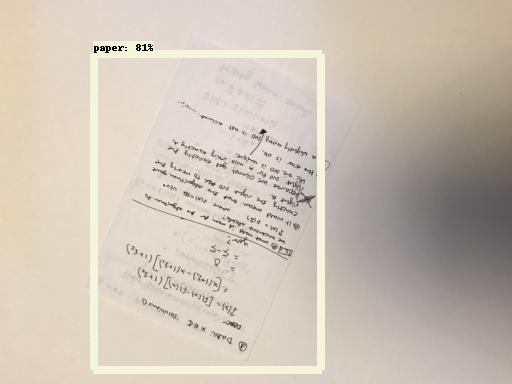

[0.8051469  0.222579   0.16507974 0.15523067 0.14139506 0.13741986
 0.13174312 0.10267405 0.09818816 0.0820754  0.06992667 0.06002746
 0.05875216 0.05848136 0.05847408 0.05789565 0.05315557 0.05303623
 0.05187177 0.05131345 0.0509488  0.04617712 0.04539844 0.04533337
 0.04476709 0.04314813 0.04293393 0.04192634 0.04190641 0.04163055
 0.04038801 0.03938466 0.03866199 0.03786598 0.03692789 0.03692107
 0.03650896 0.03613505 0.03611825 0.03552493 0.03516906 0.03504397
 0.03484902 0.03401631 0.0339502  0.03358262 0.03324736 0.03309299
 0.03250501 0.03192858 0.03144052 0.03140461 0.03117625 0.03106422
 0.03081534 0.03036883 0.03029221 0.03004093 0.02941711 0.02938402
 0.02933305 0.02930214 0.02912969 0.02900905 0.02892558 0.02825827
 0.02812165 0.02788753 0.02772943 0.02756866 0.0274688  0.02742405
 0.02731628 0.02729643 0.02721775 0.02720748 0.0271696  0.02700547
 0.02698447 0.02695546 0.02684439 0.0265628  0.02652033 0.02614797
 0.02613412 0.02604122 0.02583242 0.0256589  0.02562475 0.0255

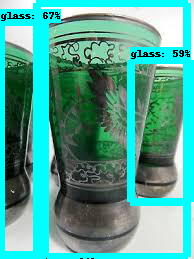

[0.9131201  0.67403966 0.5876089  0.47033674 0.28352055 0.25468388
 0.23150623 0.22856435 0.17707534 0.15093015 0.13572998 0.13544083
 0.131311   0.12838614 0.12820904 0.12624088 0.12127206 0.10707121
 0.10538893 0.10378364 0.09921095 0.09373944 0.09179001 0.09002152
 0.08803692 0.08790867 0.08388437 0.08078142 0.08006017 0.07997292
 0.07845131 0.07755012 0.07238884 0.07136817 0.07133244 0.06967704
 0.06965037 0.06562615 0.0642556  0.06254464 0.05780504 0.05762412
 0.0557735  0.05523342 0.05480193 0.05454237 0.0538161  0.0535261
 0.05342177 0.05320999 0.05285155 0.05216302 0.05066046 0.05005167
 0.04993564 0.04908098 0.04838909 0.04769469 0.04735475 0.04719383
 0.04699452 0.04604495 0.04575399 0.04506416 0.04504802 0.04496283
 0.04443295 0.04404404 0.04380378 0.04377306 0.04360414 0.04322335
 0.04269332 0.04159004 0.04075957 0.04018821 0.03999126 0.03991173
 0.03970418 0.03918804 0.03820046 0.03807679 0.03785315 0.03785236
 0.03772867 0.03764921 0.03719081 0.03699315 0.03697852 0.03689

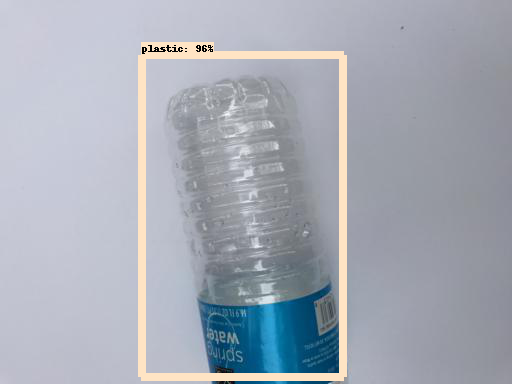

[0.9563353  0.28400132 0.22002825 0.14485118 0.13957796 0.135788
 0.09731434 0.08646599 0.06876647 0.06823047 0.05972753 0.05652728
 0.05372898 0.05274934 0.05229546 0.05149236 0.0494121  0.04772324
 0.04757917 0.04030133 0.03891273 0.03871046 0.03760656 0.03613304
 0.03611138 0.03607519 0.03536947 0.03516212 0.03508632 0.03504626
 0.03438251 0.03305224 0.03290051 0.0325469  0.03230149 0.03228582
 0.03169991 0.03105729 0.0306683  0.03035133 0.02998468 0.02937163
 0.02920335 0.02793324 0.02781467 0.02755717 0.02742281 0.02730465
 0.02689019 0.02677552 0.02667919 0.02644585 0.02622525 0.02585381
 0.02574858 0.02568383 0.02545381 0.02513673 0.0250476  0.02503623
 0.02496704 0.02488185 0.02482901 0.02412772 0.02411699 0.02410846
 0.02400495 0.02393052 0.02378322 0.02331214 0.02328949 0.02324431
 0.02323939 0.02319876 0.02310287 0.02267492 0.02265245 0.02252583
 0.02220649 0.02217951 0.02207631 0.0220623  0.02184188 0.02174558
 0.0217131  0.02171021 0.02170126 0.0216904  0.02164434 0.021631

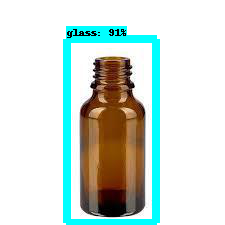

[0.91300654 0.26307726 0.19341025 0.13263471 0.13032149 0.08404329
 0.07960561 0.07798815 0.07630736 0.07228031 0.06164496 0.06020014
 0.05663724 0.0548753  0.0524758  0.05031727 0.04768337 0.04557943
 0.04482835 0.04453721 0.04435281 0.04362035 0.04356729 0.04323353
 0.04260597 0.04246817 0.04112899 0.0409423  0.04072614 0.04072351
 0.04064314 0.04053536 0.04021882 0.04006493 0.04004038 0.03987668
 0.03961913 0.03912833 0.03909839 0.03873405 0.03863191 0.03851034
 0.03807121 0.03796811 0.03791447 0.03767145 0.03759957 0.03755584
 0.03740615 0.0373745  0.03719969 0.03697582 0.0368658  0.03623213
 0.03595822 0.03562583 0.03554453 0.03543385 0.03525688 0.0346666
 0.03448652 0.03432842 0.0341499  0.03404471 0.03376026 0.03362991
 0.03348545 0.03348486 0.03345533 0.03340894 0.03324421 0.03251059
 0.0323589  0.03231594 0.03228293 0.03225028 0.03197761 0.03156234
 0.0312459  0.03064672 0.03046155 0.03036901 0.03020925 0.03011014
 0.02983302 0.02959883 0.02944845 0.02931415 0.02841862 0.02836

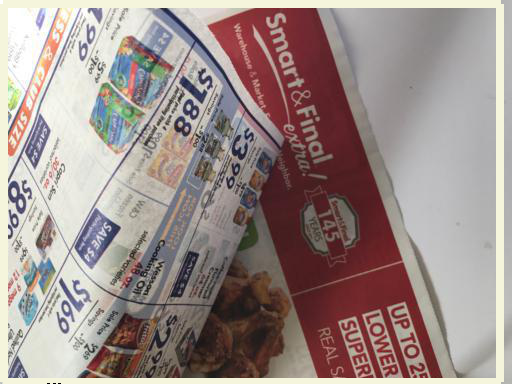

[0.8578039  0.39878923 0.279052   0.14000103 0.12778924 0.10239408
 0.0924655  0.08390409 0.07520165 0.06620551 0.06108773 0.06108452
 0.05278696 0.0493775  0.04645364 0.04549703 0.04120739 0.0409508
 0.04048641 0.04044906 0.04021827 0.0401267  0.03994395 0.03976972
 0.03975192 0.03971645 0.03775233 0.03679996 0.03611521 0.03592198
 0.03560644 0.03477705 0.03335901 0.03327897 0.03312591 0.03279658
 0.03279113 0.03264774 0.03259104 0.03226329 0.03211347 0.03200284
 0.0315743  0.0310681  0.02956766 0.02912918 0.02894944 0.02889977
 0.02857052 0.02766464 0.02675635 0.02668323 0.02622763 0.02622533
 0.02621965 0.02612234 0.02604763 0.02567399 0.02556249 0.02526718
 0.0252071  0.02471638 0.0245272  0.02431938 0.02425008 0.02394386
 0.02383653 0.02368861 0.02352616 0.02350448 0.02334071 0.02331307
 0.02257215 0.02223884 0.02215551 0.02189858 0.02178904 0.02169192
 0.02166453 0.02158145 0.02154738 0.02152887 0.02145792 0.02133214
 0.02110606 0.02106918 0.02104475 0.02103308 0.02094411 0.02093

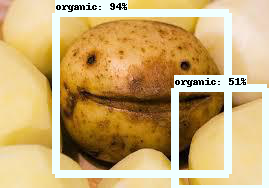

[0.9417153  0.5066555  0.45349112 0.42846176 0.42234066 0.29892123
 0.2945694  0.25842342 0.22721961 0.21702687 0.21684228 0.20303527
 0.20278272 0.2006766  0.19194752 0.18141802 0.17742217 0.17499834
 0.16547556 0.16520694 0.16347611 0.1593202  0.15787409 0.15194996
 0.1491548  0.14833665 0.14224336 0.13341725 0.13299529 0.13285913
 0.13037525 0.12907362 0.12458189 0.12419523 0.11976333 0.11969904
 0.1162504  0.11508189 0.11263403 0.11167032 0.11036953 0.10968146
 0.10883825 0.10868511 0.10810502 0.10710819 0.10647832 0.10521561
 0.10520283 0.10341523 0.10229269 0.10175747 0.10143226 0.10020722
 0.09974723 0.09893865 0.09813481 0.09795936 0.09785235 0.09650263
 0.09497437 0.09223185 0.09154147 0.09070396 0.08956081 0.08955231
 0.08865237 0.08635631 0.08607224 0.08577579 0.0856339  0.08486178
 0.08422995 0.08371748 0.08321357 0.0815395  0.08047102 0.08046804
 0.08028647 0.07993018 0.07519437 0.07487157 0.07442459 0.07248553
 0.07208863 0.07204703 0.07203681 0.07198298 0.07135977 0.0704

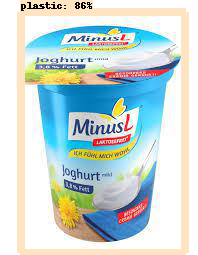

[0.8604868  0.35082498 0.21417333 0.15532942 0.09329507 0.08650994
 0.08501072 0.08031517 0.04878935 0.04382558 0.04265195 0.03986685
 0.03711155 0.03493866 0.0349094  0.03444915 0.03421829 0.03414829
 0.03318318 0.03317158 0.03261154 0.03254239 0.0311607  0.03115876
 0.03107382 0.03077254 0.03070874 0.03031163 0.03012813 0.02948591
 0.02943214 0.02936678 0.0292681  0.02899529 0.02883475 0.02868925
 0.02798677 0.02790861 0.02787736 0.0277312  0.02745246 0.02719543
 0.02670692 0.02670206 0.02625961 0.026004   0.02539953 0.02528564
 0.02517085 0.02497371 0.02493602 0.02492861 0.02474663 0.0247368
 0.0247307  0.02469399 0.02461249 0.02434304 0.02423597 0.02415088
 0.02402391 0.0239966  0.02395761 0.02388669 0.02369883 0.02333689
 0.02321581 0.02307588 0.02285705 0.02264981 0.02261906 0.02246159
 0.02229518 0.02209112 0.0220856  0.02185244 0.0218423  0.02181893
 0.02176817 0.02175618 0.0217047  0.02166508 0.02164436 0.02162476
 0.02150962 0.02142488 0.02131833 0.02128686 0.02122199 0.02121

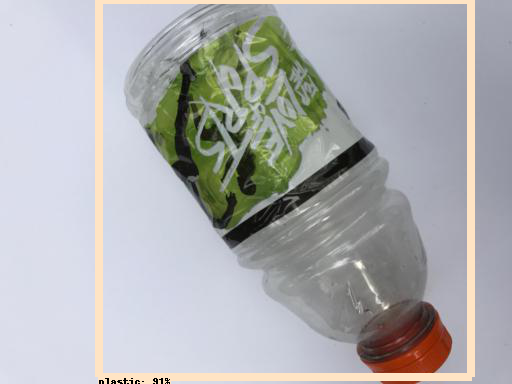

[0.91223776 0.18193984 0.17279889 0.16925894 0.16393673 0.14133728
 0.11127888 0.09907458 0.08386016 0.0808922  0.05359371 0.05183529
 0.04817976 0.04631656 0.04317712 0.04304871 0.04172412 0.04021923
 0.03803457 0.03640072 0.03611683 0.03578467 0.03343945 0.03263953
 0.03251138 0.03224698 0.03161618 0.03102617 0.03071158 0.03055011
 0.03012715 0.03002588 0.02992156 0.02970839 0.02931256 0.02923698
 0.02890866 0.02865986 0.02820356 0.02754069 0.02685559 0.02682299
 0.0264884  0.02626048 0.02610771 0.02595357 0.02593014 0.02592182
 0.02558722 0.02549462 0.02528841 0.02519018 0.02511966 0.02482733
 0.02446261 0.02390165 0.02374672 0.02360935 0.02337323 0.02325975
 0.02295217 0.02294592 0.02272925 0.02271143 0.02260592 0.02244037
 0.02232472 0.02225059 0.02221067 0.02202122 0.02195922 0.02187549
 0.02159514 0.02153048 0.02151449 0.02141537 0.02121087 0.02113844
 0.02107216 0.02103847 0.02090543 0.02075431 0.02060493 0.02060234
 0.02033007 0.02030443 0.02021431 0.02016014 0.0199833  0.0195

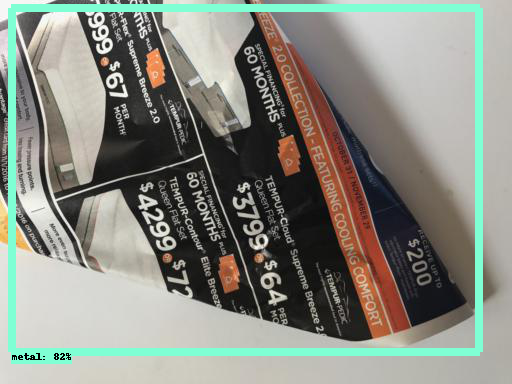

[0.8181772  0.38650003 0.3618379  0.18250786 0.16427273 0.16172215
 0.07664976 0.07573298 0.06252436 0.05840814 0.05132705 0.04861843
 0.04692149 0.04615032 0.04601506 0.04504007 0.04502703 0.04472979
 0.04362093 0.04094227 0.04081503 0.03852241 0.03531273 0.03528888
 0.03486134 0.03259566 0.03223407 0.03195154 0.03147434 0.03143422
 0.03059424 0.03022187 0.03021262 0.02980821 0.0297973  0.02976892
 0.02964923 0.02912571 0.02872966 0.02828308 0.02822299 0.02796303
 0.02795915 0.02791361 0.02776338 0.02716331 0.02714968 0.02713901
 0.02639868 0.02610219 0.0259262  0.02569111 0.02535709 0.02528766
 0.0249016  0.0245088  0.02450619 0.02439966 0.02421359 0.02417133
 0.02408627 0.02391408 0.02366572 0.02356979 0.02321566 0.02318445
 0.02296495 0.02274094 0.02266413 0.02254893 0.02216661 0.02209183
 0.0220289  0.02181195 0.02176379 0.02173856 0.02167408 0.0216373
 0.02154773 0.0214565  0.02133908 0.02133143 0.02124635 0.02113615
 0.02082384 0.02076514 0.02074027 0.02067839 0.02059658 0.02059

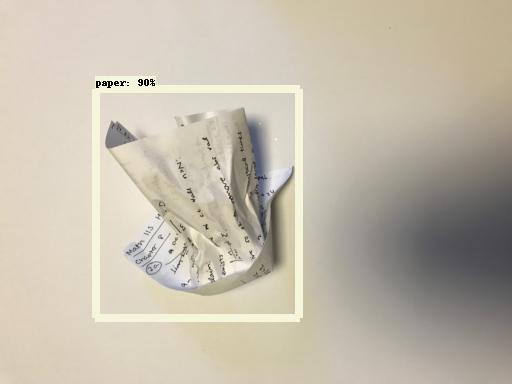

[0.9023235  0.26321223 0.19294415 0.17483827 0.12381858 0.11949669
 0.11734703 0.07320593 0.07210359 0.06472585 0.0621319  0.0610696
 0.06035096 0.05132256 0.05024897 0.04766426 0.04630788 0.045479
 0.04519689 0.04451412 0.04376553 0.04292982 0.03979195 0.03963873
 0.03790247 0.03773826 0.03741937 0.03717039 0.03640629 0.03589845
 0.03499063 0.03493232 0.03489884 0.03408999 0.03406505 0.03373303
 0.03272071 0.03270382 0.03244388 0.03242605 0.03199659 0.03110437
 0.03091563 0.03047306 0.03022028 0.02989806 0.02913894 0.02896713
 0.02887019 0.02855612 0.02804917 0.0277822  0.02765715 0.02760674
 0.02750807 0.02709632 0.02693429 0.02669949 0.02666912 0.02656519
 0.02654055 0.02643813 0.02638895 0.02634247 0.02625008 0.02572916
 0.02572144 0.02519394 0.02408301 0.02395451 0.0239393  0.02369769
 0.023528   0.02351366 0.02334177 0.02325398 0.02322858 0.02315578
 0.0230173  0.02301201 0.0229265  0.02285277 0.0228312  0.02280583
 0.02261285 0.02259389 0.02259027 0.02254422 0.02247535 0.0224041

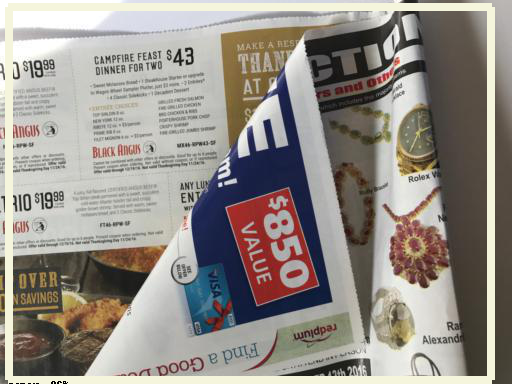

[0.9558386  0.14359628 0.08221321 0.07917262 0.07246146 0.05406599
 0.05124771 0.04730841 0.04512298 0.04158497 0.04065615 0.03795687
 0.03762818 0.034313   0.03262457 0.03202498 0.03184383 0.03131335
 0.03109767 0.03092906 0.03040524 0.03030129 0.02864278 0.02853885
 0.02763325 0.02736227 0.02680397 0.02585454 0.02547453 0.02510889
 0.02474192 0.02469225 0.02454288 0.024067   0.02391407 0.02382028
 0.02370804 0.02349321 0.02225909 0.02208532 0.02179534 0.0215222
 0.02134668 0.02119943 0.02046613 0.02042501 0.02010443 0.0199792
 0.01969126 0.01966086 0.01951403 0.01947897 0.01942336 0.01920893
 0.01912617 0.01912379 0.01891064 0.01883662 0.0188213  0.0186632
 0.01865927 0.01850702 0.01849893 0.0184253  0.01830371 0.01820504
 0.01818288 0.01814077 0.01809327 0.01798437 0.01767421 0.01766333
 0.01746645 0.01736203 0.01733232 0.01733113 0.01726736 0.01714776
 0.01705772 0.01702914 0.01702507 0.01678529 0.0166913  0.01655985
 0.01653982 0.01650235 0.01650002 0.01649503 0.01649391 0.0164197

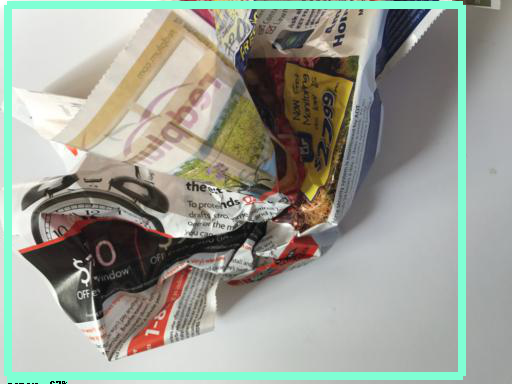

[0.67346007 0.66862327 0.21239607 0.1493201  0.13869326 0.10929531
 0.09019599 0.07891573 0.06568708 0.06488844 0.06133983 0.05015184
 0.04938255 0.04811293 0.04757092 0.0427731  0.04110654 0.0399705
 0.03976189 0.03893209 0.03821285 0.0379018  0.0369178  0.03675127
 0.03620571 0.03610629 0.03609401 0.0358313  0.03575533 0.03483482
 0.0348127  0.03478765 0.03473347 0.03435089 0.03294793 0.03236921
 0.03229791 0.03167885 0.03167672 0.03114711 0.03079424 0.03072933
 0.03044859 0.03040999 0.02913708 0.02894345 0.02814454 0.02764016
 0.02754531 0.0273384  0.02730624 0.02701501 0.02695042 0.02685739
 0.02678844 0.02623146 0.02603632 0.02599441 0.02563415 0.02560161
 0.02557195 0.02556016 0.02552838 0.02552504 0.02552468 0.02518886
 0.02507352 0.02487797 0.02470971 0.02466238 0.02458663 0.02447704
 0.02445919 0.02441369 0.02421179 0.0235075  0.02332914 0.02330137
 0.02319424 0.02299945 0.02293094 0.02278654 0.02249445 0.02247588
 0.02231056 0.02220202 0.02214971 0.02187972 0.02176712 0.02143

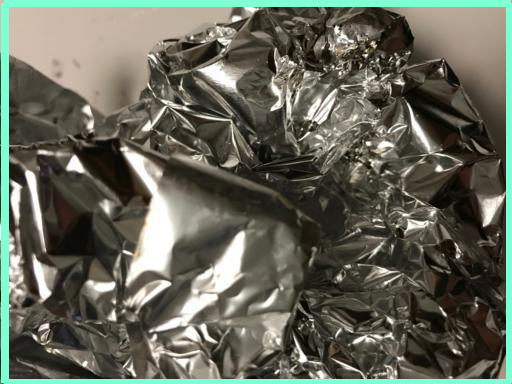

[0.9212815  0.3160864  0.11411974 0.11397436 0.11176008 0.10938939
 0.1039088  0.09633725 0.08971114 0.08917845 0.08295736 0.07784101
 0.07606199 0.07553606 0.07330231 0.07061301 0.06912628 0.06893248
 0.06821782 0.06774472 0.06710105 0.06445877 0.0636918  0.05944411
 0.05831337 0.05724771 0.05724668 0.05710961 0.0542147  0.05418547
 0.05238608 0.05025667 0.05017632 0.0493217  0.04887135 0.04858793
 0.04833606 0.04800682 0.04786114 0.0470887  0.04686232 0.04676667
 0.04656448 0.04594685 0.04582078 0.04556105 0.04431851 0.04326798
 0.04300304 0.0425345  0.04246134 0.04196257 0.04170543 0.04162173
 0.04110988 0.04050491 0.04049837 0.04049255 0.04041487 0.03982408
 0.03978288 0.03918349 0.03910408 0.03898777 0.03885025 0.03860353
 0.03794837 0.03768163 0.03764605 0.03731605 0.0369069  0.03669628
 0.03625789 0.03594361 0.03592911 0.03588015 0.03548915 0.03548282
 0.03537662 0.03522741 0.03522459 0.03517259 0.03503414 0.03496349
 0.03468456 0.0345654  0.03449796 0.03433535 0.03429849 0.0342

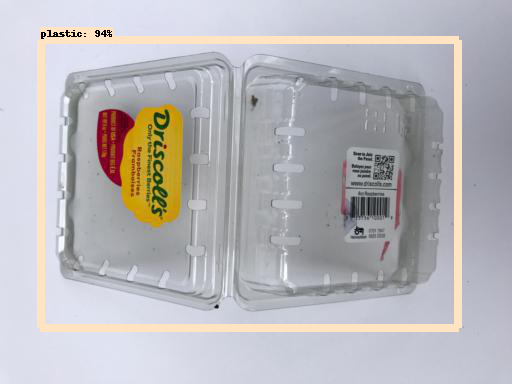

[0.9421022  0.16731235 0.15278962 0.14351532 0.13709243 0.09058286
 0.07069146 0.06750323 0.04937742 0.04354518 0.04313931 0.04097066
 0.03918421 0.03674709 0.03592926 0.03398122 0.03364827 0.03272359
 0.03268944 0.03263997 0.03116543 0.03035869 0.02983193 0.02974203
 0.0292534  0.02899685 0.02895602 0.02885677 0.02845298 0.02826205
 0.02798523 0.02635791 0.02589742 0.02553991 0.02444325 0.02347582
 0.02308325 0.02296293 0.02289029 0.0228424  0.0228398  0.02277261
 0.02275732 0.02218922 0.02205949 0.022034   0.02172613 0.02149859
 0.0214223  0.02136675 0.02132627 0.02104107 0.02100567 0.0209765
 0.02095784 0.02072074 0.02048266 0.02048162 0.02044419 0.02038609
 0.0201325  0.02011784 0.02008117 0.01973102 0.0196027  0.01950517
 0.01920943 0.01916767 0.01899879 0.01896559 0.01894361 0.0187978
 0.01850096 0.0184934  0.01844062 0.01837995 0.01835407 0.0183402
 0.01832402 0.01823356 0.01808296 0.01798097 0.01793207 0.01783886
 0.01759422 0.01757795 0.01755729 0.01740834 0.01740148 0.0173985

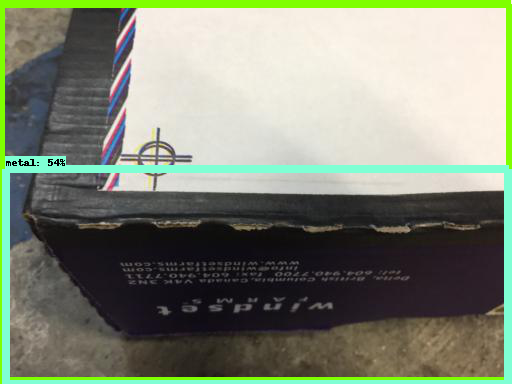

[0.56504124 0.5444092  0.46930757 0.3191769  0.2966356  0.22201142
 0.17806426 0.14531855 0.13033447 0.1219984  0.11494579 0.10700799
 0.10521825 0.1022926  0.09253226 0.08998385 0.08749099 0.07826667
 0.07685897 0.06723268 0.06590246 0.06237936 0.06187961 0.05959089
 0.05697967 0.05486692 0.05158613 0.05140931 0.05029592 0.05009579
 0.04967352 0.04758646 0.04673875 0.04666912 0.04595387 0.04575688
 0.04506761 0.04169679 0.04082344 0.03983666 0.03979765 0.0397883
 0.03978295 0.03959232 0.03914282 0.03885246 0.03852803 0.03813317
 0.0374491  0.03727115 0.03718871 0.03662276 0.03656013 0.03655716
 0.03648745 0.03632116 0.03625772 0.03603953 0.03555173 0.03552981
 0.03503336 0.03502586 0.03500844 0.03485308 0.03457856 0.03430283
 0.03388023 0.03376079 0.03321733 0.03301353 0.03274174 0.03262599
 0.03226008 0.03211604 0.03189644 0.03177628 0.03176605 0.03114117
 0.03104269 0.03077724 0.03070275 0.03008397 0.02999949 0.02992927
 0.02977074 0.02966473 0.0295878  0.02956193 0.02947372 0.02933

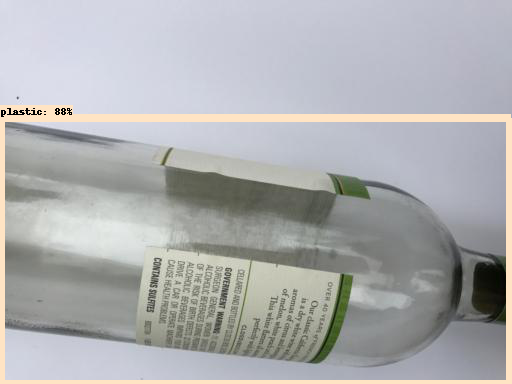

[0.8836372  0.20177282 0.10339678 0.09594662 0.09506042 0.08952083
 0.08274673 0.0802827  0.07862684 0.07799101 0.07674911 0.0663216
 0.06403153 0.06339511 0.06314407 0.06076883 0.05999355 0.0576314
 0.05583849 0.04887195 0.04843408 0.04754103 0.04696099 0.04679107
 0.04615721 0.04576235 0.04473614 0.04461281 0.04438107 0.04430861
 0.04362327 0.0434006  0.04288896 0.04187409 0.0417239  0.04106819
 0.04066828 0.03933209 0.03910097 0.03894635 0.03885037 0.0385485
 0.03839992 0.03831759 0.03645038 0.03628828 0.0347978  0.03464485
 0.03426252 0.0341699  0.03405407 0.03400482 0.03390629 0.03370553
 0.03358693 0.03318645 0.03268341 0.03175106 0.03162951 0.03154813
 0.03120344 0.03120181 0.0311016  0.03090308 0.03038176 0.03031985
 0.03024499 0.03019221 0.03017591 0.02994946 0.02948635 0.02931939
 0.02927898 0.02916937 0.02914572 0.02903955 0.02898907 0.02896151
 0.02880351 0.02844276 0.02840043 0.02838688 0.02837566 0.02835676
 0.02830576 0.02802607 0.0280033  0.02761544 0.02753835 0.0274464

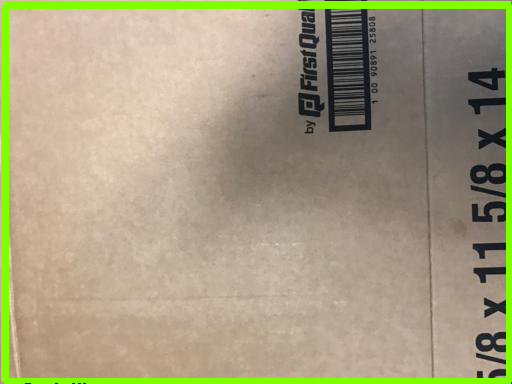

[0.90075576 0.19360295 0.18442747 0.09966971 0.09462046 0.06899732
 0.06616227 0.06608616 0.05749289 0.05696056 0.05370444 0.05294547
 0.05233853 0.05145077 0.05092353 0.04999685 0.04967307 0.04875873
 0.04859425 0.04766446 0.04384099 0.04246335 0.04242688 0.04181245
 0.04057133 0.04019586 0.03974395 0.03665742 0.03646422 0.03634148
 0.03559475 0.03493838 0.03477863 0.03450683 0.03441405 0.03379558
 0.03365535 0.03351268 0.03316177 0.03221025 0.03208751 0.03199153
 0.03184967 0.03159903 0.03147585 0.03122142 0.03122031 0.03120533
 0.03097124 0.03090306 0.03081347 0.03075441 0.03055147 0.03043785
 0.03035685 0.0296991  0.02961507 0.02858461 0.02838715 0.028345
 0.02830639 0.02828698 0.02808296 0.02804836 0.02800142 0.02792937
 0.02778105 0.0275543  0.02722281 0.02711619 0.02708039 0.02707558
 0.02701068 0.02700561 0.02697537 0.02688664 0.02669545 0.02651663
 0.02635408 0.02628934 0.02625479 0.02622381 0.02617799 0.02611177
 0.02567119 0.02565208 0.02522206 0.02508575 0.02491917 0.024812

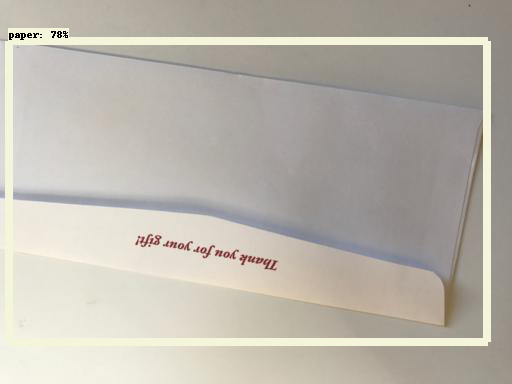

[0.776584   0.45842463 0.22637862 0.19110021 0.18657586 0.14122799
 0.12884994 0.09003209 0.0819646  0.08134878 0.07501922 0.07361171
 0.06078997 0.04973788 0.04973423 0.04958582 0.0488648  0.04671067
 0.0455857  0.04158569 0.04107711 0.04087393 0.0400182  0.03783144
 0.03642618 0.03623832 0.0356636  0.03546959 0.03438205 0.0335537
 0.03333617 0.03333403 0.03259838 0.03252868 0.03175869 0.03171936
 0.03107833 0.03032848 0.0302643  0.03023758 0.02978055 0.02920637
 0.02870086 0.02861188 0.02833175 0.0274577  0.02728873 0.02714458
 0.02682423 0.02671073 0.02654025 0.02643268 0.02624724 0.02607648
 0.02604855 0.02579065 0.0256923  0.02568384 0.02551831 0.02548127
 0.02536462 0.02535038 0.02534856 0.02533126 0.02530243 0.02524452
 0.0252029  0.02507583 0.02504375 0.02503923 0.02482666 0.02457298
 0.02456878 0.02451789 0.02427253 0.02424298 0.02419451 0.02418813
 0.02414475 0.02414449 0.02410265 0.02402092 0.02399216 0.02395787
 0.02389158 0.0238876  0.02379388 0.02362925 0.02329736 0.02316

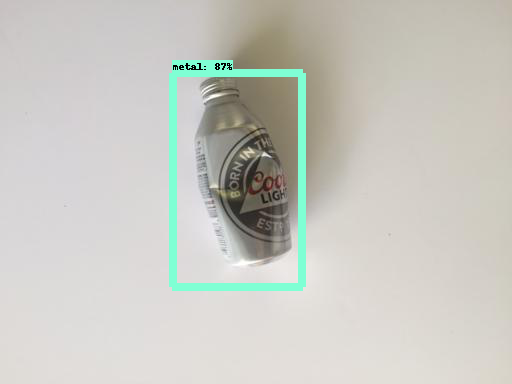

[0.8654376  0.3080444  0.2949434  0.20934407 0.15918395 0.11629681
 0.11063807 0.10040225 0.07821952 0.06888167 0.06838213 0.06524552
 0.06290972 0.06224665 0.05912099 0.05441049 0.0534551  0.05308902
 0.0525853  0.05210971 0.05123182 0.0507203  0.04784887 0.04778738
 0.04610416 0.04574236 0.04561543 0.04522601 0.04487783 0.04406395
 0.04366717 0.04291908 0.04238123 0.0421113  0.04155502 0.04132604
 0.04102642 0.04065321 0.04032027 0.03956776 0.0393338  0.03911873
 0.03881874 0.03866966 0.03864403 0.03859632 0.03848493 0.03836022
 0.03830413 0.03813805 0.0378809  0.03786156 0.037698   0.03697921
 0.03691408 0.03672824 0.03671996 0.03670869 0.03661923 0.036487
 0.03612018 0.03587985 0.03585336 0.03583533 0.0358232  0.03518346
 0.03499599 0.03485348 0.03461154 0.0345335  0.03449358 0.03424111
 0.03397031 0.03392553 0.03376083 0.03363033 0.03353807 0.03340396
 0.03330413 0.03302389 0.03287829 0.03247136 0.03217954 0.03192839
 0.03191345 0.03189683 0.03182191 0.0318147  0.03163414 0.031226

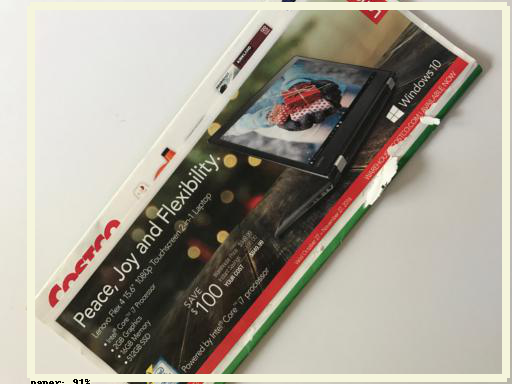

[0.9087471  0.32484555 0.11635677 0.0957381  0.09161757 0.0846618
 0.07679348 0.06600632 0.05998727 0.05604888 0.04572898 0.04266375
 0.03447234 0.03159346 0.03101082 0.03099996 0.0307635  0.02970948
 0.02966873 0.02925337 0.02907594 0.0284008  0.0282538  0.02809598
 0.02753601 0.02748085 0.02744769 0.02729051 0.02713828 0.02667092
 0.02658    0.02657142 0.02642952 0.02638006 0.02617452 0.02581336
 0.02523182 0.02516086 0.02508279 0.02507879 0.02479517 0.02454305
 0.0242846  0.02412565 0.02316215 0.02257294 0.0224728  0.02232741
 0.0222985  0.02218264 0.02205312 0.02179049 0.02170268 0.02154959
 0.0215345  0.02149457 0.02144461 0.0210943  0.02096462 0.02085996
 0.02059188 0.02056677 0.0204192  0.02030986 0.02021081 0.02001522
 0.01999884 0.01984366 0.01981216 0.01980852 0.01965518 0.01964203
 0.01963501 0.01949228 0.01948681 0.01940073 0.01939443 0.01924201
 0.01914336 0.01904733 0.01894083 0.01886443 0.01886293 0.01879926
 0.01879477 0.01873799 0.01872654 0.01862055 0.01856922 0.01835

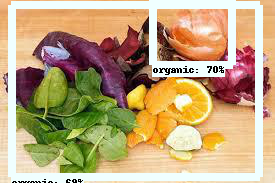

[0.7000347  0.68737626 0.4238916  0.23782611 0.22708392 0.21845074
 0.21403359 0.1723527  0.17066921 0.16619898 0.13147202 0.12585528
 0.12336853 0.11583837 0.11399682 0.10973033 0.1018963  0.10137364
 0.0956777  0.09449976 0.09211501 0.09158851 0.08947597 0.08911886
 0.08524965 0.08441072 0.08356114 0.08167288 0.08114661 0.07949092
 0.0751424  0.07488786 0.07480864 0.07472679 0.07029032 0.07015995
 0.06966998 0.06884535 0.06628435 0.06586403 0.06448413 0.06418505
 0.06304632 0.06262723 0.06158092 0.06090372 0.06026478 0.06024993
 0.05965069 0.05887019 0.05788243 0.05644689 0.05615931 0.0556941
 0.05551866 0.05482874 0.05429954 0.05403481 0.05400086 0.0539705
 0.05343217 0.05319584 0.05266342 0.05230666 0.05066518 0.05016072
 0.05007262 0.04896511 0.04760511 0.04758316 0.04737487 0.04652673
 0.04509098 0.04271149 0.04260587 0.04200318 0.04034709 0.04031635
 0.03991876 0.03937699 0.03829284 0.03825909 0.03825758 0.03815025
 0.03798026 0.0377785  0.03729843 0.03720779 0.03638417 0.036216

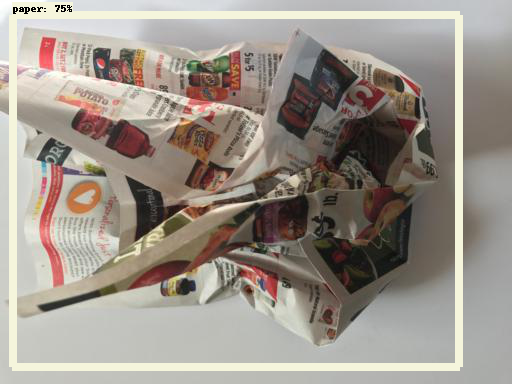

[0.7483031  0.41796914 0.4070717  0.128586   0.12640493 0.11186414
 0.06173682 0.06109392 0.04436087 0.04314628 0.03704433 0.03646471
 0.03622964 0.03280111 0.03181563 0.03178874 0.03152419 0.03071725
 0.03047216 0.03045403 0.02974896 0.02954694 0.02948717 0.02896291
 0.02821052 0.02809387 0.02782182 0.02769299 0.02686093 0.02668672
 0.02625351 0.02624156 0.02589398 0.02568499 0.02558307 0.02539726
 0.02504133 0.02493871 0.0247571  0.02468644 0.02450862 0.02448948
 0.02441738 0.02431636 0.02414795 0.02403838 0.02398514 0.02389589
 0.02383    0.02355595 0.02355296 0.02349337 0.02349004 0.02313959
 0.02303859 0.02302903 0.02254637 0.02181038 0.02176314 0.02154738
 0.02149423 0.02148679 0.02139737 0.021367   0.02136531 0.02099524
 0.02082864 0.02073782 0.0206955  0.02064483 0.02060478 0.02058911
 0.02050731 0.02031446 0.02028504 0.02023367 0.02020217 0.02015243
 0.01994708 0.01976045 0.01966324 0.01958657 0.01952819 0.01950747
 0.01923921 0.01917648 0.01913448 0.01913415 0.0191252  0.0190

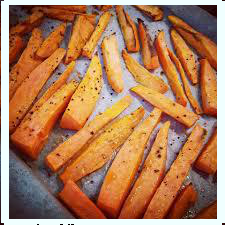

[0.9447048  0.11071125 0.09864168 0.08027881 0.08004087 0.07305597
 0.06666104 0.06534549 0.06349447 0.06252383 0.062029   0.06175364
 0.06098324 0.06088749 0.05962185 0.05890863 0.05863813 0.05829128
 0.05317453 0.0527615  0.05172928 0.05124515 0.05049188 0.05024632
 0.04976502 0.04969275 0.04777583 0.04709862 0.04653155 0.04573748
 0.04480757 0.04461233 0.04432821 0.04423379 0.04409014 0.0436196
 0.04316873 0.04309138 0.04288562 0.04286719 0.04266857 0.04244065
 0.04168604 0.04146974 0.04102968 0.04086138 0.04076768 0.04073257
 0.04049869 0.04015251 0.03995534 0.03955621 0.03937064 0.03870778
 0.03833928 0.03817348 0.03812712 0.03759112 0.03757463 0.03727865
 0.03685047 0.03653748 0.03638967 0.0362497  0.03624478 0.03623413
 0.03616266 0.03574808 0.03570974 0.03562558 0.03559426 0.03532216
 0.0352554  0.03515    0.03506662 0.0349035  0.03470995 0.03433701
 0.03401    0.03363268 0.03360163 0.03346332 0.03279546 0.03229303
 0.03220397 0.03211396 0.03188632 0.03180913 0.03145788 0.03138

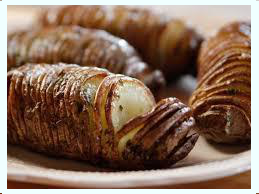

[0.71043223 0.34467998 0.27008522 0.20285171 0.17085162 0.16104443
 0.15983443 0.12639594 0.11933803 0.11408309 0.10937308 0.10931348
 0.1021305  0.098567   0.09542365 0.09465922 0.08723645 0.08432248
 0.08178372 0.07990901 0.07135867 0.07118069 0.07038596 0.07002728
 0.0696314  0.06940044 0.06804887 0.06694296 0.06658806 0.06657193
 0.06494692 0.06309172 0.06174068 0.0604266  0.06041741 0.06039804
 0.0596847  0.05914826 0.05817299 0.05799382 0.05669455 0.05586566
 0.05579221 0.05508363 0.05462312 0.05458293 0.05416622 0.05323703
 0.05313385 0.0530564  0.05262202 0.05215959 0.05174753 0.05161043
 0.0515967  0.05108916 0.0509438  0.05043222 0.05013935 0.04981925
 0.04962884 0.04925421 0.04862177 0.04831441 0.04821637 0.04799167
 0.04785885 0.0476442  0.04762916 0.04745396 0.04731179 0.04675871
 0.04667183 0.04589794 0.0456621  0.04542206 0.04511927 0.04425149
 0.04388474 0.04353848 0.0430801  0.04286496 0.04260185 0.04258916
 0.04204137 0.04177411 0.04168527 0.04112561 0.04107978 0.0406

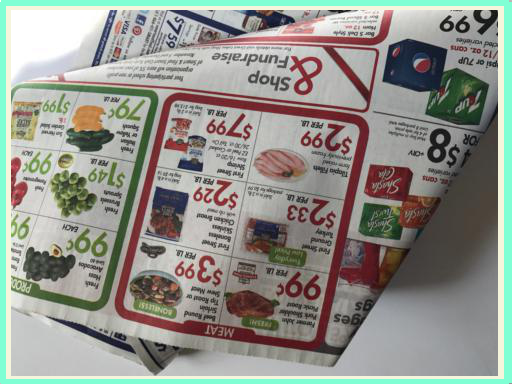

[0.7410435  0.5853047  0.3154754  0.12432168 0.10130847 0.07526334
 0.07040621 0.05780083 0.05393516 0.05330657 0.04683201 0.04099979
 0.03955906 0.03913014 0.0390747  0.03832203 0.0366867  0.03597583
 0.03376929 0.0329858  0.0323829  0.03215024 0.03192113 0.03132102
 0.03099195 0.03096837 0.02998544 0.02990564 0.02984435 0.02971152
 0.02926954 0.02897202 0.02894704 0.02878073 0.0279493  0.02768674
 0.02709286 0.02664318 0.02626581 0.02595285 0.02590558 0.0258474
 0.02573023 0.02571367 0.02556162 0.0254364  0.0251168  0.02473876
 0.02466075 0.02428359 0.02424764 0.02410434 0.02408632 0.02407704
 0.02367865 0.02357485 0.02353527 0.02347202 0.02345998 0.02341274
 0.02338691 0.02331335 0.02312315 0.0230744  0.02285385 0.02285033
 0.02283869 0.02261119 0.02258529 0.02251138 0.02248379 0.02227805
 0.02226648 0.0222106  0.02207121 0.02200219 0.02192028 0.02182382
 0.02175808 0.02173724 0.0214349  0.02134236 0.02133172 0.02122732
 0.02119964 0.02119344 0.02108438 0.02104181 0.02103577 0.02090

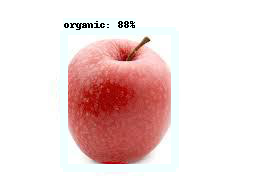

[0.8772052  0.23041975 0.2016495  0.15103695 0.14513466 0.13467367
 0.12853844 0.12666194 0.10959264 0.09319207 0.07541525 0.06980772
 0.06187895 0.06172819 0.05947971 0.05803178 0.05777682 0.05588133
 0.05566711 0.05463501 0.05010618 0.04973187 0.04886995 0.04884845
 0.04782588 0.04686574 0.04648084 0.04604464 0.0446166  0.04403222
 0.04401311 0.043943   0.04301458 0.04264778 0.04222337 0.04195284
 0.04144999 0.04092835 0.04075823 0.04057768 0.04038757 0.04037519
 0.04022421 0.03914392 0.03898815 0.03833391 0.03824843 0.03819176
 0.03808729 0.03752661 0.03735552 0.03728034 0.037188   0.03716417
 0.03687472 0.03620079 0.03576696 0.03534191 0.03527389 0.03471717
 0.03448202 0.03435019 0.03416415 0.03406169 0.03398127 0.03372709
 0.03368733 0.0335339  0.03352122 0.03334806 0.03316177 0.03303718
 0.0328147  0.03243444 0.03230362 0.03217928 0.0321173  0.03124067
 0.03116512 0.03112355 0.03086217 0.03080934 0.03045768 0.0304266
 0.03010629 0.0298533  0.02944846 0.0292809  0.02919909 0.02848

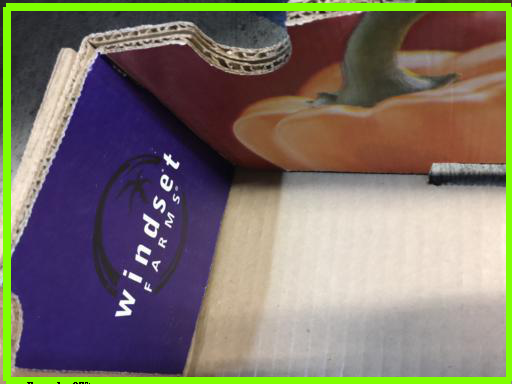

[0.87016886 0.23071949 0.20672937 0.08984438 0.08870654 0.08832334
 0.08080101 0.0801327  0.0756773  0.07383581 0.07137308 0.06821103
 0.06731658 0.06727399 0.06140323 0.05915251 0.05776311 0.0552789
 0.05131293 0.04674796 0.04582634 0.04530238 0.04401542 0.04395845
 0.04269117 0.04258677 0.04195288 0.04185336 0.04143736 0.04143235
 0.0394163  0.03801189 0.03773478 0.03762536 0.03741704 0.03703572
 0.03609191 0.03568012 0.03563365 0.03485645 0.03484635 0.03447589
 0.03431655 0.03424993 0.0341763  0.03413501 0.03357836 0.03334709
 0.03305326 0.03290634 0.0328059  0.03270183 0.03267023 0.03259878
 0.03222227 0.03196761 0.03172955 0.03094276 0.03076997 0.03025209
 0.03023699 0.0301161  0.02981449 0.02965184 0.02907082 0.02901959
 0.02878708 0.02851682 0.02774321 0.02745924 0.02719358 0.02706154
 0.0270506  0.02701755 0.02666264 0.02652507 0.02646818 0.02624615
 0.02624038 0.02584642 0.0257851  0.02558475 0.02529936 0.02525423
 0.02519869 0.02504652 0.02499057 0.02487841 0.02462555 0.02456

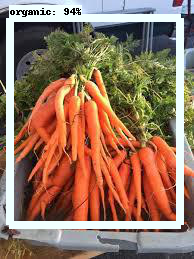

[0.9380732  0.14558296 0.14495064 0.13277206 0.09641939 0.07713771
 0.06722149 0.06200063 0.05958622 0.05868886 0.05828805 0.0552634
 0.0542445  0.05009715 0.04705279 0.04364961 0.04326892 0.04299026
 0.04222905 0.0383735  0.03829529 0.0379767  0.03772428 0.03751426
 0.0369634  0.03620009 0.03585896 0.03531254 0.03504339 0.0350114
 0.03499071 0.03482839 0.03428584 0.03377498 0.03373655 0.03360822
 0.03302279 0.03288982 0.03279196 0.03275954 0.03272053 0.03221619
 0.03133569 0.03122007 0.03076055 0.03068116 0.03057732 0.0304865
 0.03022484 0.03014651 0.0298461  0.0294098  0.02935871 0.02906753
 0.02906698 0.02891456 0.02836042 0.02804277 0.02772459 0.02770521
 0.02770252 0.02766316 0.02751981 0.02740921 0.02735729 0.02729958
 0.02722071 0.02674954 0.0267469  0.02667213 0.02651756 0.02632986
 0.02611432 0.02609545 0.02601344 0.02558992 0.02554979 0.02550158
 0.02537099 0.02536378 0.02530576 0.02525363 0.02490812 0.02484436
 0.02471967 0.02464301 0.02423431 0.02401884 0.02399451 0.0239808

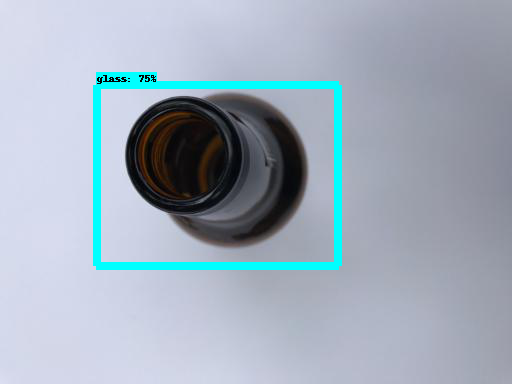

[0.7480574  0.27053002 0.19855107 0.19755745 0.17957419 0.16593854
 0.11834369 0.11626849 0.10958396 0.10672422 0.08013669 0.07723685
 0.07525556 0.07211894 0.06830616 0.06561467 0.0653297  0.06207176
 0.06192394 0.05973423 0.05729453 0.05643642 0.05103632 0.04831891
 0.0478121  0.04754559 0.04611522 0.04603202 0.04488396 0.04465153
 0.04391917 0.04387685 0.04378778 0.04367709 0.0426141  0.04233408
 0.04230238 0.04183618 0.04167689 0.0402387  0.03907811 0.0390416
 0.03900133 0.0386573  0.03781874 0.03741733 0.03726601 0.03668803
 0.036663   0.03656846 0.03647791 0.03599419 0.03585639 0.03565259
 0.03543697 0.03477376 0.0345979  0.0342272  0.03403293 0.03356382
 0.03354388 0.03305583 0.03292275 0.03286157 0.03247255 0.03223361
 0.03199856 0.03193985 0.03190567 0.03126611 0.03083898 0.03052266
 0.03017244 0.02975671 0.02965361 0.0294464  0.0294145  0.02937801
 0.02921852 0.02915122 0.02898398 0.02897623 0.02865504 0.02862803
 0.02835366 0.02824222 0.02823032 0.02810709 0.02801543 0.02781

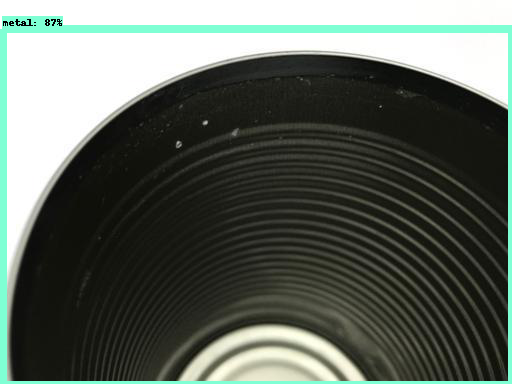

[0.87018293 0.35688192 0.20641424 0.12250487 0.09259243 0.09070279
 0.0791391  0.06720283 0.06708802 0.06490181 0.05865221 0.05787306
 0.05623832 0.0557767  0.05441139 0.05423135 0.05250068 0.05004259
 0.04787307 0.04782249 0.04628872 0.04624314 0.04492561 0.04453359
 0.0440715  0.04279948 0.04198174 0.04176839 0.03998292 0.03866083
 0.0385901  0.03768504 0.03742428 0.0372499  0.03683545 0.03673225
 0.03635268 0.03630901 0.03580511 0.03577604 0.03558339 0.03530893
 0.03451245 0.0343403  0.03417251 0.0341693  0.0341358  0.03396384
 0.03330326 0.03324656 0.03303382 0.03260795 0.03188007 0.0317018
 0.03150789 0.03131181 0.03127483 0.03114272 0.03051652 0.03044619
 0.02990187 0.02954964 0.02946739 0.02938541 0.02937589 0.02933927
 0.02879744 0.0287504  0.02829047 0.02827489 0.02826178 0.0282306
 0.02793211 0.02770166 0.0275799  0.02684497 0.02665914 0.02654279
 0.02646033 0.02622423 0.02599669 0.02551876 0.02549779 0.02540197
 0.02528056 0.02526161 0.02523601 0.02523213 0.02488798 0.024713

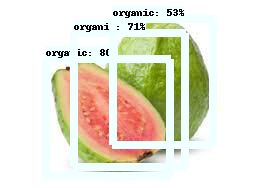

[0.80104643 0.7130409  0.5283239  0.1746208  0.15474816 0.14609605
 0.1451801  0.14498138 0.13156377 0.12829003 0.10765932 0.10324305
 0.09315041 0.09091149 0.08957656 0.08821718 0.08647041 0.08616282
 0.08435515 0.08261663 0.0811469  0.08109157 0.07967026 0.06873062
 0.06743252 0.06560321 0.06498781 0.06206472 0.06160485 0.06082958
 0.05966835 0.0590129  0.058959   0.05571459 0.05279885 0.05190941
 0.05073725 0.04880085 0.04818098 0.04784789 0.04706353 0.04205278
 0.04092763 0.04007021 0.04002634 0.03957635 0.03806609 0.03766722
 0.03749518 0.03732784 0.03730565 0.0371188  0.03672215 0.03621846
 0.03530506 0.03519308 0.03462989 0.03440515 0.03423464 0.0341446
 0.03412846 0.0339924  0.03393471 0.0339206  0.03366702 0.03322188
 0.03274393 0.03265027 0.03243588 0.031469   0.03089451 0.03072049
 0.03071358 0.0306931  0.03045436 0.02992646 0.02983944 0.02982087
 0.02973754 0.02964369 0.02949995 0.02947368 0.02944632 0.02927483
 0.02909579 0.02908171 0.02906339 0.02898586 0.02889666 0.02880

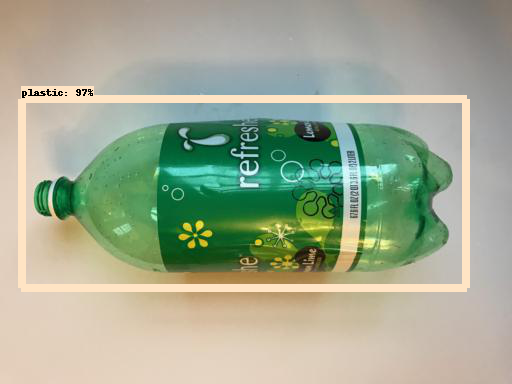

[0.97166824 0.20618701 0.11042806 0.10761734 0.10531419 0.08902235
 0.08489948 0.07829752 0.06099381 0.05699785 0.0543607  0.05434461
 0.0485526  0.04847703 0.04710768 0.04611641 0.0416509  0.04024421
 0.03925945 0.03821363 0.03801965 0.03798771 0.03521795 0.03506049
 0.03463561 0.03427304 0.03375918 0.03360612 0.03315319 0.03247282
 0.0321889  0.03203757 0.03136268 0.03121501 0.0308336  0.03045761
 0.02962315 0.02894752 0.02880032 0.02807483 0.02759415 0.02754236
 0.02674655 0.02671047 0.02654494 0.02628171 0.02613047 0.02549393
 0.0253671  0.02533347 0.02532944 0.02519099 0.02513789 0.02505975
 0.02486365 0.02484507 0.02455459 0.02447973 0.02446278 0.02439869
 0.02427157 0.02424959 0.0241554  0.02406913 0.02401178 0.02389031
 0.02385923 0.02377288 0.02370337 0.02360034 0.02350254 0.02339705
 0.02333131 0.02331376 0.02325647 0.02318878 0.0231642  0.02313141
 0.02304038 0.02295302 0.0228809  0.0228552  0.02276039 0.02258863
 0.02242318 0.02238837 0.0223709  0.02227346 0.0221857  0.0220

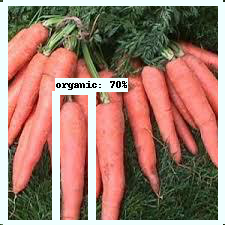

[0.8600986  0.700272   0.4653991  0.33685076 0.32743743 0.31500974
 0.31170183 0.29812565 0.2949545  0.27673557 0.24932276 0.2416467
 0.22949019 0.22633645 0.22267225 0.2045511  0.20397903 0.186275
 0.18393488 0.17971875 0.17942278 0.1741049  0.17314991 0.17267641
 0.17189167 0.17045397 0.16868755 0.1686136  0.16576062 0.1605821
 0.15604793 0.14855787 0.14260505 0.13802467 0.13397525 0.13241115
 0.13167435 0.12667432 0.12114336 0.11490546 0.11143108 0.11056446
 0.10709383 0.10614439 0.10463834 0.10461077 0.10258938 0.10062395
 0.09982983 0.09844124 0.09802581 0.09736969 0.09652133 0.09468363
 0.09458429 0.09391496 0.09368442 0.09364949 0.0932822  0.09218027
 0.09053085 0.08965515 0.08916427 0.08835807 0.08428204 0.08338758
 0.08303342 0.08281863 0.08273437 0.08263635 0.08235025 0.08174679
 0.08163878 0.08136419 0.07729551 0.07614757 0.07363807 0.07346923
 0.0709982  0.07094534 0.06917814 0.06894819 0.06894587 0.0687381
 0.06860352 0.06704497 0.06646884 0.0657642  0.06552591 0.06547607


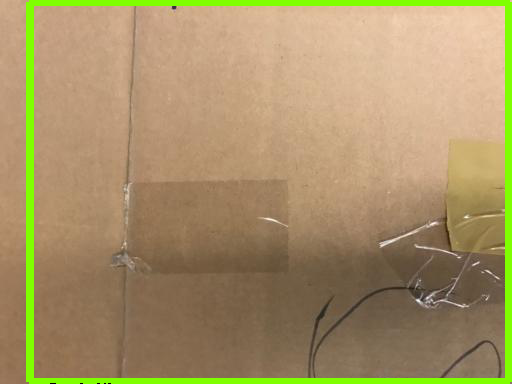

[0.8141908  0.24692136 0.19867551 0.18235727 0.12900399 0.1153487
 0.11364894 0.11201216 0.09776195 0.08042679 0.07588792 0.07527842
 0.07295825 0.07171585 0.06384508 0.06153563 0.05984805 0.0593637
 0.05915184 0.05565366 0.05521531 0.05382647 0.05285629 0.05121059
 0.05093221 0.05009597 0.04964279 0.04904722 0.04798118 0.0479541
 0.04733021 0.04636973 0.04629596 0.0459057  0.04589726 0.04585438
 0.04558941 0.04433569 0.04405593 0.04296559 0.04232911 0.0423035
 0.04199242 0.04138893 0.041376   0.04122184 0.0407416  0.03941537
 0.0384021  0.03801624 0.0379588  0.03738447 0.03688001 0.03680698
 0.03676673 0.03665534 0.03648771 0.03599357 0.03585911 0.03553662
 0.03538357 0.03458029 0.0345209  0.0343093  0.03416725 0.03409866
 0.03405506 0.03378904 0.03358881 0.03357819 0.03352692 0.03329195
 0.03271228 0.03229376 0.03197633 0.03160219 0.03142446 0.03141577
 0.03119286 0.03059541 0.03051764 0.03039614 0.03015842 0.03012053
 0.03003176 0.03001474 0.02997421 0.02993669 0.02959837 0.02957734

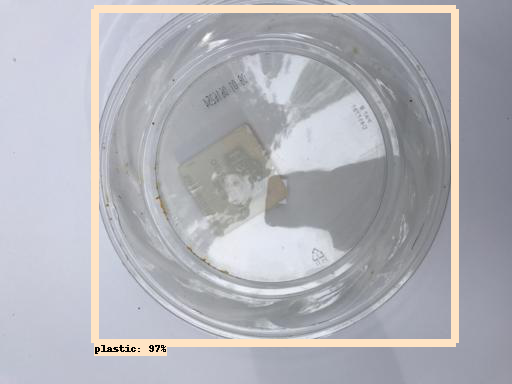

[0.9698214  0.10850942 0.08368708 0.07152397 0.05367465 0.05134524
 0.05091133 0.04998156 0.04938589 0.04663791 0.03986532 0.03618673
 0.03595277 0.03580955 0.03519111 0.03421752 0.03380078 0.03317413
 0.0327666  0.03272087 0.03064973 0.03030296 0.02959664 0.02835893
 0.02801193 0.02772437 0.02551932 0.02546744 0.0242013  0.02390511
 0.02385147 0.02362006 0.02357013 0.02349397 0.02344808 0.02330208
 0.02329181 0.02323865 0.02320962 0.02305356 0.02299512 0.02224643
 0.02211899 0.0219356  0.0218547  0.0213621  0.02111264 0.02081477
 0.02077437 0.0206407  0.02033701 0.02018354 0.02016301 0.02015784
 0.01974811 0.01957571 0.01936914 0.01918263 0.01901848 0.01875412
 0.0187414  0.01857358 0.01855026 0.01852219 0.01837123 0.01833499
 0.01829427 0.01817834 0.01814911 0.01811811 0.01811441 0.0180636
 0.01780758 0.01778396 0.01774367 0.01771682 0.01768135 0.01750268
 0.01743202 0.0174284  0.0174017  0.01738413 0.0173136  0.01725397
 0.01700865 0.01694787 0.01694461 0.01684065 0.01675364 0.01670

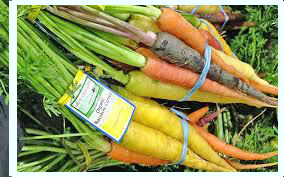

[0.83951926 0.32883513 0.16935313 0.15275039 0.14236493 0.11948582
 0.11713781 0.11291897 0.11022539 0.10448631 0.10403069 0.10020178
 0.09439209 0.09061251 0.08933531 0.08459673 0.08276114 0.07068895
 0.07042451 0.07024957 0.06836011 0.06829051 0.0662678  0.06551328
 0.06521906 0.06398865 0.0638045  0.06368704 0.06367302 0.06236934
 0.06079708 0.05965912 0.05788044 0.05522793 0.0540944  0.05330233
 0.05159595 0.05121388 0.0511477  0.05068791 0.0502911  0.05000137
 0.04975666 0.04975067 0.04954703 0.04917978 0.04914368 0.04875909
 0.04857379 0.04768085 0.04548127 0.04524917 0.04524278 0.04519314
 0.04502398 0.04345401 0.0429126  0.04267175 0.04244935 0.04172323
 0.04171688 0.04137384 0.04136517 0.04094829 0.04093002 0.0406198
 0.04036902 0.04034623 0.0399405  0.03985462 0.03882095 0.03782548
 0.03744997 0.03666483 0.0365723  0.03637638 0.03582108 0.03566458
 0.03555734 0.03530783 0.03518798 0.03517484 0.03506756 0.03498449
 0.03434381 0.03366569 0.0336341  0.03362541 0.03361611 0.03342

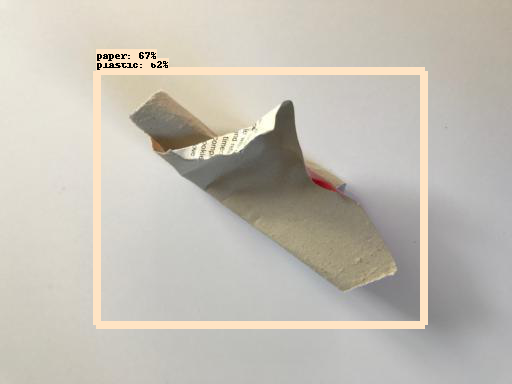

[0.6665705  0.6215232  0.28447673 0.22944097 0.18958838 0.15504986
 0.07131651 0.06434667 0.05501394 0.05481062 0.05197039 0.05117436
 0.05039967 0.04930783 0.04837942 0.04784854 0.0477528  0.04762084
 0.04644324 0.04523933 0.04127844 0.04061169 0.03991103 0.03978352
 0.03972019 0.03821845 0.03769296 0.03755989 0.0373491  0.03642257
 0.03570792 0.0356164  0.03557176 0.035356   0.03532176 0.03526231
 0.03498929 0.03481084 0.03428501 0.03367163 0.03359642 0.03297136
 0.03256306 0.032308   0.03225473 0.03218321 0.03207407 0.03205745
 0.03174527 0.0316091  0.03156252 0.03147607 0.03108559 0.03107221
 0.03041561 0.0300981  0.03001465 0.03000338 0.0299529  0.02986743
 0.02977305 0.02936677 0.02930165 0.02919822 0.0291149  0.02890925
 0.02886113 0.02842763 0.02838714 0.02824202 0.02803516 0.02746449
 0.0274252  0.0273897  0.02715965 0.02708835 0.02708298 0.02704463
 0.02696232 0.02693762 0.0267968  0.02677651 0.0265428  0.02653089
 0.02624984 0.02583498 0.02568964 0.02561145 0.025599   0.0255

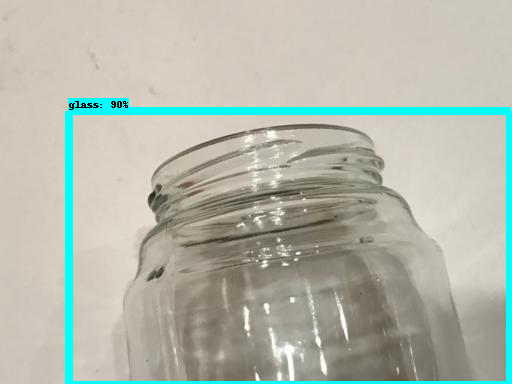

[0.8972008  0.21854016 0.18448395 0.15063177 0.1343596  0.12194805
 0.11430886 0.09577431 0.0947396  0.08777612 0.07996863 0.07931587
 0.07704522 0.07136241 0.0598133  0.05949185 0.05910213 0.05835092
 0.05701791 0.05657031 0.0526135  0.04945441 0.04857982 0.04852624
 0.04806871 0.04650024 0.04497011 0.04348211 0.04197352 0.04181402
 0.04145419 0.0413078  0.04122188 0.04067484 0.03970638 0.03948482
 0.03947368 0.03913099 0.03836959 0.03784001 0.03782412 0.03745499
 0.03733993 0.03729742 0.03681753 0.03611036 0.03601217 0.0356423
 0.0349792  0.03494165 0.03433441 0.03393035 0.03324438 0.03243181
 0.03228059 0.03201645 0.03184656 0.03183177 0.03180964 0.03161107
 0.03097196 0.03076957 0.03026855 0.03017612 0.02972654 0.02963236
 0.02930203 0.02867297 0.02814661 0.02814486 0.02782924 0.02781769
 0.02760125 0.02759792 0.02748479 0.02705962 0.02691052 0.02671235
 0.02667454 0.02652358 0.02649724 0.02627592 0.02613884 0.02583574
 0.02575942 0.02568289 0.02564784 0.02548242 0.02541672 0.02536

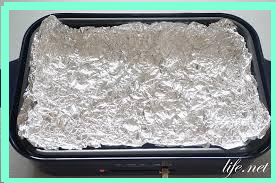

[0.94926757 0.13661662 0.12077295 0.09594896 0.09589458 0.08231905
 0.06589828 0.06550089 0.06437357 0.05995172 0.05536325 0.05533427
 0.05357414 0.05020374 0.04982784 0.04960692 0.0485271  0.04617951
 0.04382676 0.04331447 0.04301711 0.04176758 0.04149054 0.04125931
 0.03946932 0.03844339 0.03822789 0.03673543 0.03370002 0.0333548
 0.03335143 0.03278245 0.03234179 0.03181985 0.03061448 0.02943584
 0.02874239 0.02851284 0.02805724 0.02772168 0.02657226 0.02656735
 0.02656386 0.02645692 0.02636729 0.02628393 0.02619205 0.02579863
 0.02540488 0.02530281 0.02509063 0.02496523 0.02483471 0.02470698
 0.02465821 0.02454111 0.02431632 0.02397509 0.02393929 0.02369579
 0.02364941 0.0235849  0.02293188 0.02265985 0.02264383 0.02240618
 0.02204633 0.02197587 0.02193205 0.02186875 0.02181965 0.02177439
 0.02158492 0.02144158 0.02128463 0.02115251 0.02107196 0.02096841
 0.02090977 0.02085148 0.0207185  0.02069615 0.02057993 0.02055993
 0.0204693  0.02043804 0.02039502 0.02032978 0.02027589 0.02022

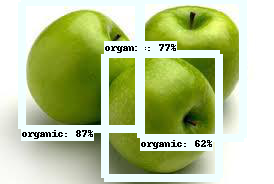

[0.8749939  0.7652929  0.6176565  0.41348442 0.40386987 0.27496603
 0.21948643 0.17149602 0.1635097  0.137888   0.13584326 0.13139501
 0.13097622 0.1291775  0.12774351 0.11597706 0.11542585 0.1139316
 0.10710571 0.09868355 0.0969714  0.09417878 0.0934041  0.08950989
 0.08747827 0.08551976 0.08383192 0.07928917 0.07783803 0.07244778
 0.06803335 0.06780367 0.06687781 0.06560231 0.06463447 0.06403781
 0.06294139 0.06245676 0.06171604 0.06160148 0.06098482 0.05916598
 0.05581236 0.05548426 0.05481321 0.05254715 0.05246729 0.05150375
 0.05117586 0.0510042  0.05099958 0.04995823 0.04894672 0.04867021
 0.04769729 0.04690029 0.0462648  0.04605826 0.04526228 0.04479701
 0.0429838  0.04285303 0.0425694  0.04170546 0.04116388 0.04104926
 0.04018158 0.03960005 0.03946607 0.03935751 0.03931705 0.03900469
 0.03899039 0.03803192 0.0376658  0.0374807  0.03737583 0.03728916
 0.03673148 0.03663914 0.03654372 0.03640616 0.03578107 0.03550355
 0.03547389 0.03433808 0.03432637 0.0341608  0.03402166 0.03367

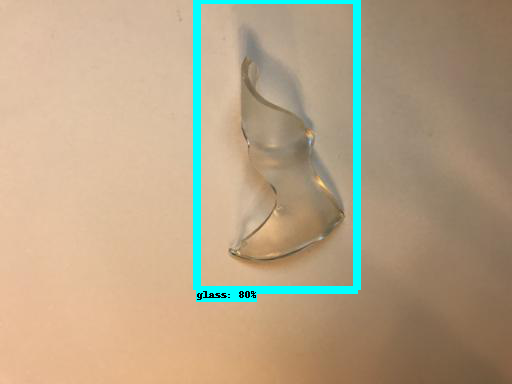

[0.80373144 0.37857825 0.1987841  0.17092974 0.15612927 0.12138212
 0.11620752 0.11304414 0.10112873 0.10072087 0.0996104  0.09796925
 0.08071042 0.07999688 0.07647255 0.07604561 0.07453764 0.07332225
 0.07171927 0.07150532 0.06964635 0.06961305 0.06643552 0.06564554
 0.06470812 0.06352203 0.06281739 0.06281137 0.06187179 0.0609952
 0.06017257 0.0597035  0.05954189 0.05846685 0.0569498  0.05614529
 0.05525319 0.05501403 0.05484692 0.05450354 0.05439312 0.05435192
 0.05323088 0.05169684 0.05069103 0.05031666 0.05013812 0.04972731
 0.04908967 0.04887095 0.04871714 0.04827854 0.04691708 0.04604417
 0.04602795 0.04583216 0.04526016 0.04516577 0.04388246 0.04322281
 0.04304405 0.04220565 0.04122394 0.04098065 0.04091096 0.04077861
 0.04063988 0.04039267 0.04015185 0.03993141 0.03939071 0.0393102
 0.03912218 0.03907054 0.03902688 0.0388287  0.03873516 0.03871873
 0.03867016 0.03824697 0.03816625 0.03809386 0.03793431 0.03759003
 0.03746485 0.03690968 0.03670605 0.0364073  0.03598309 0.035776

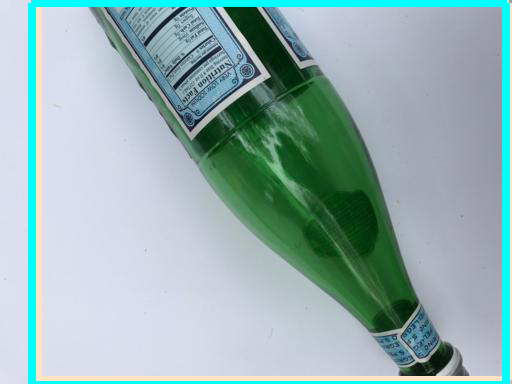

[0.69171464 0.59963393 0.47577912 0.26198393 0.25119412 0.16147606
 0.11911236 0.09822877 0.09415076 0.0917633  0.08006118 0.07295991
 0.06742453 0.0673953  0.06312267 0.0624182  0.06036799 0.05517457
 0.05320813 0.0480536  0.04530617 0.04514685 0.04281131 0.04167729
 0.04156503 0.04134535 0.04072065 0.04035699 0.04003656 0.03948019
 0.03875639 0.03734541 0.03709238 0.0370458  0.03566338 0.03547256
 0.03546961 0.03536554 0.03521072 0.03458392 0.03431926 0.03405397
 0.03383008 0.03382794 0.03368074 0.03340149 0.03335023 0.03331104
 0.03296102 0.03288698 0.03168284 0.03154381 0.03130969 0.03117978
 0.031016   0.03078175 0.03046831 0.03022884 0.03021965 0.03015464
 0.02990682 0.0297539  0.02936412 0.02924939 0.02922849 0.02914165
 0.02905988 0.02902859 0.02873814 0.02868607 0.02842302 0.02805368
 0.02796746 0.02791848 0.02791686 0.02777754 0.02763791 0.02763026
 0.02756854 0.02708628 0.02633729 0.02631931 0.02625564 0.02625284
 0.0261914  0.02585576 0.02583896 0.0256866  0.02561257 0.0254

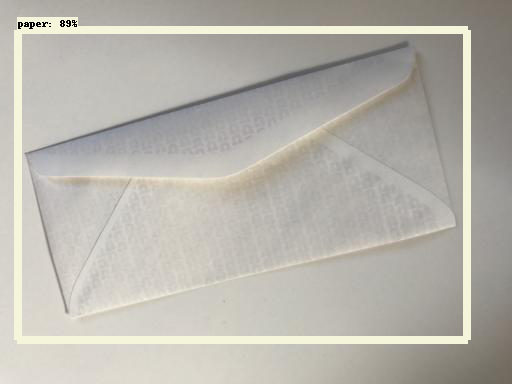

[0.88609403 0.26648542 0.19821729 0.1843713  0.13476135 0.1247835
 0.08157141 0.06123547 0.05352889 0.04455858 0.0433658  0.04046353
 0.03957231 0.03870976 0.03857408 0.03839552 0.03828949 0.03728944
 0.03566288 0.03489838 0.03466306 0.03441317 0.03385322 0.0306254
 0.02998353 0.02995823 0.02969848 0.02905034 0.02891566 0.02883429
 0.0285631  0.02847807 0.02775695 0.02775577 0.02704646 0.02686884
 0.02654888 0.0263699  0.02636802 0.02596755 0.02580198 0.02548487
 0.02545736 0.02496091 0.02466348 0.02461137 0.02459156 0.02444581
 0.02430315 0.0242975  0.02408859 0.02402207 0.02392353 0.02390699
 0.02373832 0.02371876 0.02368729 0.0236354  0.02345921 0.02343461
 0.02315109 0.02274397 0.0227411  0.02236036 0.02221113 0.02219926
 0.02204676 0.02195301 0.02189521 0.02178915 0.02174816 0.02170172
 0.02156065 0.02150035 0.02140034 0.02121682 0.02111811 0.02078076
 0.02069246 0.02066123 0.02058383 0.02058117 0.02056441 0.02043493
 0.02042758 0.02038719 0.02027643 0.02027068 0.02020677 0.020051

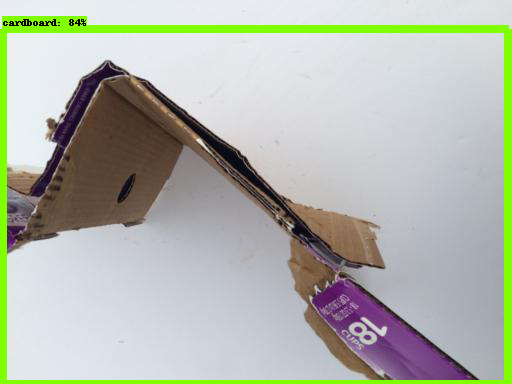

[0.8394588  0.39301187 0.16244523 0.13199906 0.12594777 0.10512093
 0.09478511 0.09455144 0.0857536  0.07923272 0.07357971 0.07010075
 0.06695785 0.06386893 0.06171871 0.05946431 0.0583562  0.0581767
 0.05322627 0.05110278 0.05037479 0.04981013 0.049425   0.04833153
 0.04686946 0.04686438 0.04628095 0.04522285 0.04326854 0.0431251
 0.04295729 0.04279267 0.04180917 0.04057895 0.03990904 0.03930105
 0.03925933 0.03857128 0.0383308  0.03725751 0.03710252 0.0370106
 0.0368064  0.03659843 0.03613083 0.03597353 0.03551587 0.03485917
 0.03408965 0.03407582 0.03363694 0.03343617 0.03237484 0.03236998
 0.03232344 0.03210269 0.03202319 0.03184864 0.03168226 0.03128315
 0.03127438 0.0310511  0.03094781 0.03091084 0.03074622 0.03070204
 0.03064003 0.03047438 0.03019168 0.03008734 0.0298908  0.02986824
 0.02953011 0.02948727 0.02931602 0.02896588 0.02889903 0.02874685
 0.02866078 0.027853   0.02778054 0.02764332 0.02759008 0.02716335
 0.02708886 0.02706726 0.02704905 0.02700611 0.02689705 0.0265531

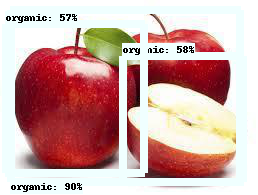

[0.89978427 0.57873726 0.5659864  0.29728144 0.25510916 0.24739464
 0.19939317 0.19051464 0.18840751 0.17969157 0.15677518 0.15608196
 0.12784405 0.12240325 0.12234984 0.117072   0.09433965 0.09403242
 0.09333287 0.09224124 0.09092517 0.08626272 0.08563402 0.08561479
 0.08559221 0.08257202 0.08247623 0.08148481 0.0804242  0.07795098
 0.07703002 0.07636555 0.07585716 0.07226354 0.07186589 0.0708751
 0.07072536 0.06967788 0.06889249 0.06856302 0.06530186 0.06392081
 0.063719   0.06364642 0.06262781 0.06208665 0.05920368 0.05639466
 0.05632788 0.05585693 0.05542303 0.05518818 0.05500103 0.05372151
 0.05277444 0.05272367 0.05254092 0.05134654 0.0511543  0.05083995
 0.04987362 0.04965631 0.04894541 0.04889221 0.04827896 0.04741064
 0.04682712 0.04659805 0.04590845 0.04532396 0.04528599 0.04499245
 0.04450598 0.0443691  0.04435133 0.04419659 0.04419572 0.04334204
 0.04328686 0.0429146  0.0419587  0.04193079 0.0419202  0.04185823
 0.0415627  0.04154791 0.04152915 0.04096287 0.04028557 0.03992

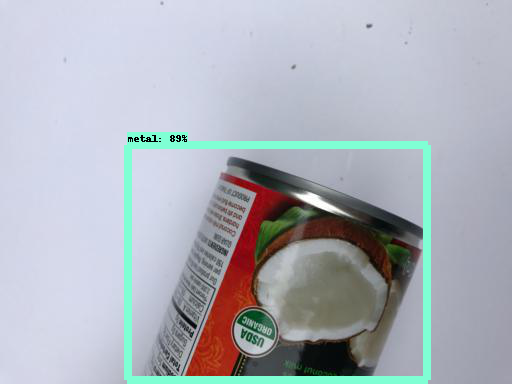

[0.888388   0.20767364 0.1922224  0.14694166 0.13984182 0.1251701
 0.12051018 0.09912492 0.08419999 0.0837988  0.07348012 0.05267632
 0.05153251 0.05019113 0.0489884  0.04805953 0.0465824  0.04448506
 0.04290923 0.04254338 0.04067171 0.0404082  0.04005191 0.04004388
 0.03941894 0.03906578 0.03901177 0.03859828 0.03856055 0.03824633
 0.03714705 0.03683348 0.03680412 0.03667002 0.03597346 0.03550807
 0.03512184 0.03493353 0.03487018 0.03480516 0.03428616 0.03428514
 0.03419581 0.03411194 0.03376818 0.03323517 0.03293406 0.03225055
 0.03221975 0.03169538 0.03165893 0.03137132 0.03061237 0.03050184
 0.03044533 0.03039381 0.03012905 0.0299812  0.02996447 0.02977729
 0.02947744 0.02882896 0.02864856 0.02855026 0.02811579 0.02787145
 0.02786303 0.02775652 0.02761228 0.02738481 0.02737898 0.02722436
 0.02715662 0.02713403 0.02680735 0.02664317 0.02644484 0.02623751
 0.02599197 0.02582224 0.02576714 0.02575918 0.02564388 0.02562538
 0.02556692 0.02499566 0.02478695 0.02477964 0.02476177 0.02463

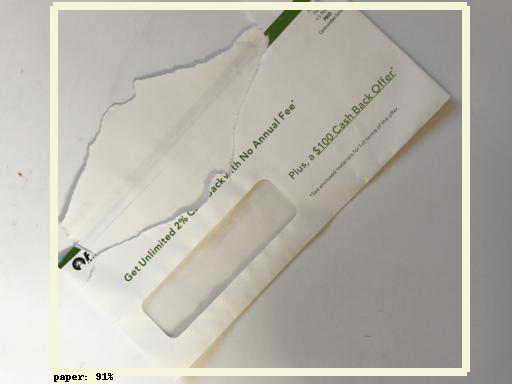

[0.9103139  0.20994788 0.14672275 0.13756624 0.11632995 0.07709232
 0.05088762 0.03483353 0.034641   0.03282654 0.03242702 0.03226396
 0.03059619 0.0305195  0.03034755 0.02882997 0.02849273 0.02828275
 0.02794486 0.02774799 0.02765909 0.02747545 0.02735344 0.02726688
 0.02706395 0.02699313 0.02680924 0.02680149 0.026489   0.02577018
 0.02560036 0.02549196 0.02547704 0.02535765 0.02508318 0.02479047
 0.0244685  0.02438058 0.02405377 0.02362404 0.0234031  0.02335421
 0.02316093 0.02315041 0.02274463 0.0226385  0.02245261 0.02208257
 0.02205814 0.02195222 0.02181286 0.02179239 0.02175703 0.02125886
 0.02123194 0.02102348 0.02083164 0.02070326 0.02066    0.020495
 0.02024188 0.02016207 0.02014758 0.02008987 0.02008454 0.02006464
 0.02005025 0.01994122 0.01954073 0.01947435 0.01947412 0.01937019
 0.01936748 0.01936179 0.0193521  0.01928536 0.01926206 0.01923449
 0.01920527 0.01919554 0.01916825 0.01903071 0.0186563  0.01841263
 0.01840227 0.01819498 0.01813012 0.01803574 0.01790902 0.017903

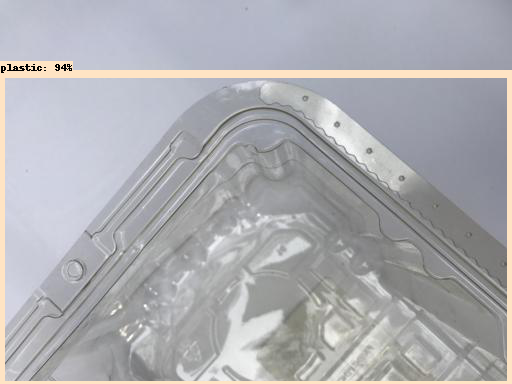

[0.93863773 0.19520862 0.0750239  0.07026725 0.05075324 0.05043143
 0.04963298 0.04925891 0.04405748 0.04373638 0.04229078 0.04080802
 0.04005896 0.03969003 0.03874343 0.03798396 0.03756575 0.03601665
 0.0348807  0.03403663 0.03371626 0.03358088 0.03309143 0.03291215
 0.03250343 0.03249028 0.03222045 0.0320831  0.03108191 0.03078105
 0.02896565 0.02894817 0.02856727 0.02815473 0.0278254  0.02776227
 0.02707415 0.02706274 0.02655647 0.02653139 0.02652885 0.02643858
 0.02636721 0.02625814 0.02602631 0.02599927 0.02575231 0.0252011
 0.02519897 0.02487774 0.0247154  0.02459803 0.0243896  0.02420256
 0.02414264 0.02397482 0.02387399 0.02364702 0.02358222 0.02340525
 0.02334913 0.02325512 0.02322859 0.02309289 0.02307147 0.02293722
 0.02275076 0.0226599  0.02253245 0.0223582  0.02233116 0.02232777
 0.02216605 0.02215257 0.02169694 0.0216897  0.02162479 0.02150891
 0.02135707 0.0212704  0.02124984 0.02107783 0.02088272 0.02064718
 0.02047905 0.02040991 0.02031795 0.0201821  0.02012581 0.02008

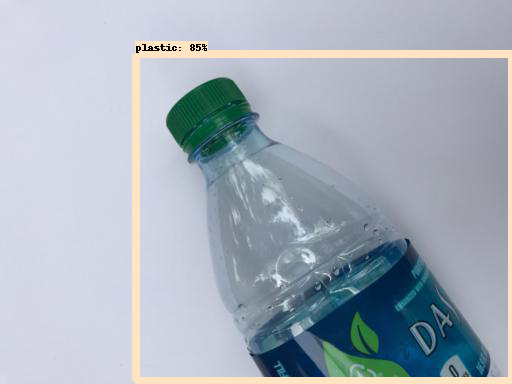

[0.8474798  0.22205843 0.18347658 0.13425647 0.09919471 0.09462751
 0.08425444 0.07210688 0.07076097 0.06285179 0.05117182 0.05037918
 0.0497132  0.04867128 0.0471379  0.04588278 0.04585817 0.04573561
 0.04545627 0.04539571 0.04457194 0.04211101 0.04081183 0.03867334
 0.03831614 0.03617901 0.03552889 0.03491575 0.03462399 0.03414815
 0.03370351 0.03366462 0.03297739 0.03271314 0.03216473 0.03185632
 0.03117656 0.03061398 0.03032691 0.03019307 0.0298274  0.02963995
 0.0292537  0.02840949 0.02836655 0.02782845 0.02743869 0.02729326
 0.0272684  0.02725822 0.02709317 0.02700959 0.02686146 0.02663804
 0.02617928 0.02607418 0.02605451 0.02600827 0.02587791 0.02572517
 0.02548789 0.02534145 0.02511155 0.02487473 0.02470493 0.0246863
 0.02444374 0.02430026 0.023696   0.02363665 0.0235899  0.02346536
 0.02336493 0.02331545 0.02319386 0.02315321 0.02308436 0.02298856
 0.02296477 0.02278928 0.02265866 0.02243111 0.02241808 0.02220434
 0.02216771 0.02201869 0.02200025 0.02192639 0.02168767 0.02162

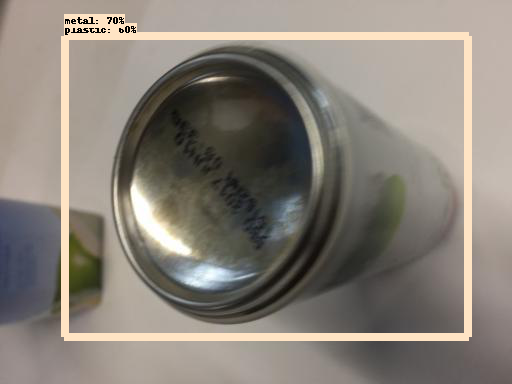

[0.70302814 0.60183185 0.24695306 0.19807087 0.19395301 0.10562564
 0.08892423 0.07626716 0.0646615  0.05982869 0.05972479 0.05944968
 0.05340632 0.05159203 0.04797958 0.04632814 0.04556438 0.04429044
 0.04336879 0.04328063 0.03905413 0.03865207 0.0384772  0.03743251
 0.03658118 0.03657982 0.03605693 0.03587494 0.03536583 0.03459393
 0.03423002 0.03402019 0.03391469 0.03307774 0.03274183 0.03268573
 0.03217118 0.03215354 0.03164237 0.03154792 0.03039149 0.0303194
 0.03017221 0.03005704 0.02976517 0.02958771 0.02950296 0.02936732
 0.02916284 0.02874925 0.02844684 0.02806569 0.02792316 0.02789579
 0.02774306 0.02767339 0.02750725 0.02726273 0.02714814 0.02705096
 0.02697445 0.02687872 0.0268663  0.0264549  0.02642001 0.02597219
 0.02591096 0.02540309 0.0252647  0.0252017  0.02508382 0.02508233
 0.02470444 0.02452639 0.02451063 0.02442749 0.02441179 0.02435483
 0.02414121 0.02395797 0.0238436  0.02369866 0.02369669 0.02366901
 0.02350178 0.0234785  0.02316655 0.02307116 0.02294316 0.02291

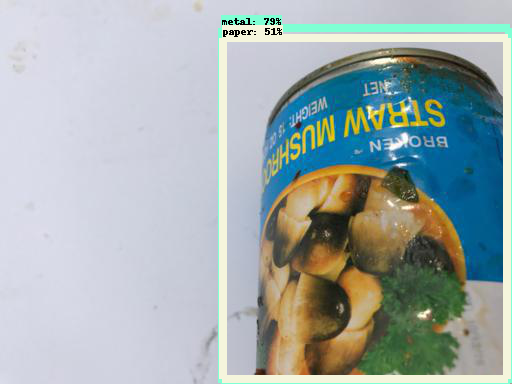

[0.79113495 0.51057166 0.40838194 0.37733316 0.33611953 0.22446944
 0.10730425 0.09946954 0.09425386 0.09395614 0.08649918 0.08600537
 0.08032885 0.07224048 0.06921986 0.06396309 0.06081367 0.05740106
 0.05661851 0.05262895 0.05170748 0.05079882 0.04884158 0.04882881
 0.04759141 0.04749466 0.04749111 0.04697509 0.04653073 0.04632092
 0.04587503 0.04550549 0.04521142 0.04353018 0.04312238 0.04271704
 0.04204084 0.04178829 0.04141195 0.04069022 0.04063709 0.04038625
 0.0396838  0.03931907 0.03910538 0.03817124 0.0376769  0.03733141
 0.03713483 0.036916   0.03683676 0.03682937 0.03680641 0.03661501
 0.03657967 0.0364767  0.03633065 0.03583683 0.0357701  0.03570712
 0.03545527 0.03521444 0.0350205  0.0347403  0.03455056 0.03382406
 0.03381659 0.03380954 0.03357237 0.03352235 0.03318878 0.0331558
 0.0330544  0.03255437 0.03252006 0.03230914 0.0323044  0.03226292
 0.03216358 0.03205325 0.03204036 0.03203036 0.03200129 0.0315751
 0.03145642 0.03130087 0.03122909 0.03088346 0.03065235 0.030610

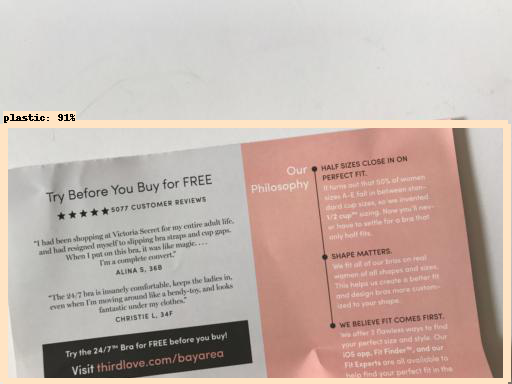

[0.90765685 0.26671645 0.18986642 0.17255422 0.1485068  0.123806
 0.11428171 0.08061244 0.07700007 0.06947275 0.06035827 0.05422428
 0.05285973 0.04786288 0.04437272 0.04429253 0.04368351 0.04330365
 0.03888186 0.03827314 0.03647627 0.0330905  0.03232067 0.0319288
 0.03189797 0.03163474 0.03114029 0.03057965 0.03031905 0.02945335
 0.02895199 0.028703   0.02839588 0.02813375 0.02765549 0.02764618
 0.02737791 0.02691053 0.02676741 0.02669107 0.02611941 0.02606019
 0.0259796  0.02573242 0.02557803 0.02547835 0.02535306 0.0250248
 0.02490654 0.02481411 0.02452484 0.02442987 0.02434502 0.0243283
 0.02427769 0.0242537  0.02391204 0.02384648 0.02378179 0.02376043
 0.02362703 0.0235794  0.02349869 0.02341269 0.02336762 0.02325427
 0.02261982 0.02250031 0.02239669 0.02232293 0.0220621  0.0220211
 0.02191185 0.02185953 0.02177744 0.02172101 0.02156805 0.02154748
 0.021396   0.02118533 0.02118308 0.02117853 0.02116089 0.02109467
 0.02094749 0.02093036 0.02089493 0.02088344 0.02088165 0.02070817
 

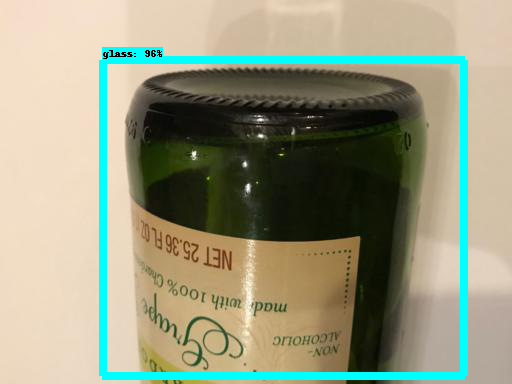

[0.9602742  0.11803485 0.11293016 0.11050812 0.09051248 0.08448656
 0.07918605 0.07704495 0.07417606 0.07045397 0.06884639 0.06404888
 0.05834768 0.05580311 0.04895175 0.04222797 0.04124701 0.04085461
 0.03996228 0.03981419 0.03849959 0.03698086 0.03573292 0.03532468
 0.03493237 0.03488167 0.03443929 0.03417854 0.03387419 0.03384254
 0.03151852 0.03125438 0.03083467 0.03082467 0.0307668  0.03065883
 0.02939036 0.02922222 0.02904372 0.02896515 0.0288945  0.02758362
 0.02756205 0.02709776 0.02695345 0.02686463 0.02669959 0.02632463
 0.02615462 0.0260812  0.02607974 0.02591241 0.02586931 0.025831
 0.02571332 0.02557654 0.02550852 0.02516472 0.0251635  0.02512777
 0.02474988 0.0247365  0.02462835 0.02451206 0.02401888 0.02392014
 0.02379718 0.02377913 0.02374958 0.02371849 0.02370463 0.02346918
 0.02319556 0.02300979 0.02299248 0.02277479 0.02270387 0.02269831
 0.02261917 0.02244577 0.02238279 0.02221932 0.02220474 0.0221489
 0.02212253 0.02204957 0.02202347 0.02178449 0.02146624 0.0212432

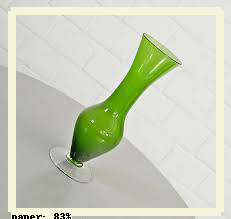

[0.8347784  0.26004845 0.25169888 0.21364307 0.20730153 0.20729528
 0.15470412 0.14839238 0.12280671 0.12268471 0.08320168 0.0803218
 0.07917678 0.07915141 0.07235894 0.07199657 0.06924102 0.06776292
 0.06692703 0.06233343 0.0620797  0.06034934 0.06019869 0.05830257
 0.05513186 0.0524726  0.04952929 0.0475225  0.04617044 0.04604167
 0.04543146 0.04518455 0.04427545 0.04327308 0.04324677 0.03935137
 0.03756717 0.03678195 0.03633321 0.03609941 0.03508754 0.03504283
 0.0348329  0.03459453 0.03434338 0.03395204 0.03234388 0.03225237
 0.03223714 0.03207911 0.03147335 0.03146596 0.0314477  0.03136429
 0.03113269 0.03108521 0.03060639 0.03058278 0.03052774 0.03011535
 0.03009995 0.02920525 0.02914531 0.02899347 0.0288749  0.02844685
 0.0284104  0.02837485 0.02834856 0.02834406 0.0283342  0.0280575
 0.02802002 0.02801631 0.02780493 0.02713322 0.02702744 0.02683504
 0.02679307 0.02673204 0.02672748 0.02668526 0.02661007 0.02644141
 0.02639182 0.02633491 0.02627642 0.02614322 0.02593632 0.025814

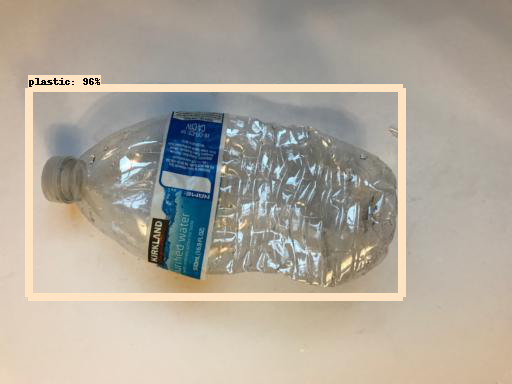

[0.956953   0.12708682 0.11765677 0.10370416 0.09738398 0.07198234
 0.07024729 0.04905292 0.04879845 0.04598869 0.04465772 0.04438891
 0.04309496 0.04109092 0.03956299 0.03578586 0.03468464 0.03459895
 0.03409585 0.03369472 0.03365406 0.0334712  0.03333221 0.03214372
 0.03213506 0.03110486 0.03091454 0.03061922 0.03012325 0.03004912
 0.02892885 0.02882054 0.02879719 0.02817575 0.02816324 0.02799266
 0.02755757 0.02633373 0.02608439 0.02597708 0.02577592 0.02508876
 0.02502256 0.02500119 0.02488537 0.02463321 0.02439022 0.02414905
 0.02409104 0.02399482 0.02371826 0.02278501 0.02265225 0.02237702
 0.02218875 0.02190182 0.02181023 0.02177864 0.02174103 0.02170304
 0.02152638 0.02149143 0.02148164 0.02146997 0.02138376 0.0213742
 0.02132917 0.02127273 0.02120869 0.02103698 0.02097473 0.02092223
 0.02086692 0.02082882 0.0207268  0.02055808 0.02042928 0.02022673
 0.02019677 0.02019004 0.020069   0.01994541 0.01990208 0.01989653
 0.01985076 0.01971656 0.01945546 0.01944981 0.01943292 0.01942

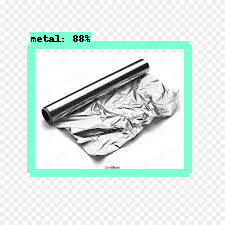

[0.88118    0.35760018 0.300133   0.25413656 0.2306669  0.11813854
 0.07847919 0.05646089 0.05012869 0.04824543 0.0481664  0.04491839
 0.04331049 0.04132258 0.0412986  0.04111459 0.03984335 0.03954908
 0.03922151 0.03891667 0.03875425 0.038318   0.03778687 0.03767133
 0.03717005 0.03675869 0.03659702 0.03636805 0.03626977 0.03626249
 0.03597225 0.0358231  0.03527656 0.03468077 0.03461723 0.0344032
 0.03419079 0.03379456 0.03350748 0.03262236 0.03238555 0.03157645
 0.03145492 0.0310413  0.03094189 0.0307493  0.03071289 0.03051774
 0.03042521 0.03037154 0.03030735 0.03026043 0.03007495 0.03004791
 0.02957509 0.02955188 0.02917672 0.02897309 0.02883759 0.02868235
 0.02848752 0.02832761 0.02831125 0.0282956  0.02811239 0.0277118
 0.02749415 0.02745585 0.02740761 0.02726774 0.02722443 0.02710451
 0.02694368 0.02687219 0.02684562 0.02683423 0.02667128 0.02650427
 0.02640859 0.02640458 0.02633598 0.02615046 0.02598718 0.02593232
 0.02576464 0.02575393 0.02572988 0.02550128 0.02545386 0.025366

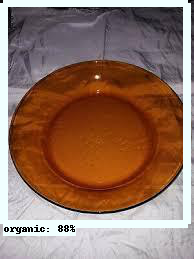

[0.88396037 0.32314682 0.16848636 0.14489633 0.14176427 0.14145258
 0.13515179 0.1337632  0.13131024 0.09076699 0.08869322 0.0885292
 0.0841213  0.07630652 0.07578713 0.07499417 0.07194198 0.07012874
 0.06996967 0.06910539 0.06636828 0.06591662 0.06574455 0.06099662
 0.06008662 0.05703651 0.05625738 0.05518362 0.05462036 0.05403475
 0.05402256 0.05352891 0.05197756 0.05178894 0.0509596  0.04980822
 0.04956029 0.04901891 0.04857107 0.04850222 0.04827118 0.04793474
 0.04790245 0.04783832 0.04781651 0.04728224 0.04680854 0.04572285
 0.04571686 0.04349739 0.04334283 0.04318639 0.04305519 0.04194426
 0.04161369 0.04089141 0.04058489 0.04046725 0.04027165 0.03980312
 0.03973586 0.03957231 0.03916163 0.03915911 0.03884483 0.03853573
 0.03606824 0.03599944 0.0355327  0.03499531 0.03494136 0.03449662
 0.03409828 0.03374414 0.03367142 0.03358191 0.03345419 0.03313608
 0.03302632 0.0327839  0.03253236 0.03230536 0.03226094 0.03190254
 0.03159911 0.03118638 0.03093761 0.03085125 0.03080982 0.03064

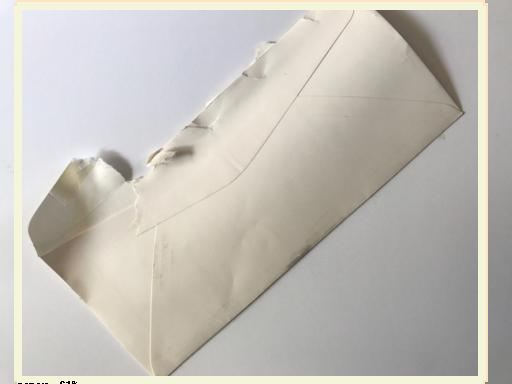

[0.63899845 0.61368    0.27244657 0.13276373 0.1264889  0.10940267
 0.10933908 0.07651348 0.06296626 0.05703458 0.05143115 0.04870378
 0.0480219  0.04704355 0.04692088 0.04557532 0.03906417 0.03595958
 0.03584404 0.03579042 0.03566471 0.03492163 0.03466026 0.0346118
 0.03438963 0.03355021 0.03333652 0.03330306 0.03236281 0.03202776
 0.03123295 0.03079706 0.03076286 0.03033015 0.02981771 0.02959939
 0.02957095 0.02943018 0.02925332 0.02834914 0.02828122 0.02825202
 0.02771897 0.02715999 0.02703463 0.02683632 0.02657101 0.02639757
 0.02594652 0.0256273  0.02560764 0.0252862  0.02526711 0.02510793
 0.0246532  0.02435387 0.02415504 0.02393384 0.02390744 0.02385377
 0.02366692 0.02355616 0.02295328 0.02294686 0.02239539 0.02206995
 0.0220614  0.02157381 0.02143801 0.02135435 0.02114188 0.02114061
 0.02113366 0.02108273 0.02100556 0.02095953 0.02087829 0.02072996
 0.02068597 0.02058979 0.02057542 0.02057387 0.0204616  0.02044038
 0.0203128  0.02029256 0.02014891 0.02014887 0.02006336 0.02001

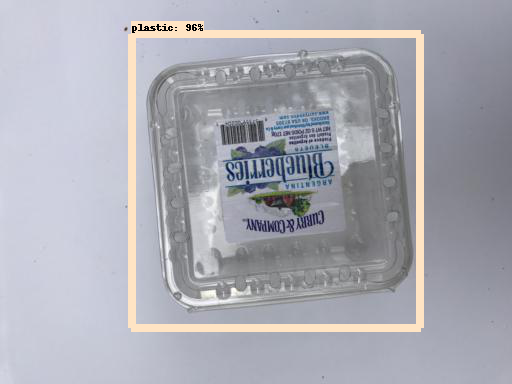

[0.9578526  0.1593284  0.15704918 0.12858264 0.08809814 0.08090952
 0.07450806 0.0726975  0.05106207 0.05012781 0.04502347 0.04446159
 0.04399047 0.04356625 0.03619248 0.0359562  0.03595104 0.0329933
 0.03234975 0.03219523 0.03148838 0.0313997  0.03107351 0.03085584
 0.03078582 0.03066849 0.02992497 0.02947083 0.02801179 0.02705393
 0.02635531 0.02604804 0.02542502 0.02524886 0.0251315  0.02511429
 0.02504052 0.02479975 0.02452929 0.02440203 0.02412696 0.02392169
 0.02375084 0.02360735 0.02353342 0.02320758 0.02282408 0.02282343
 0.02269677 0.02264193 0.02233611 0.02209028 0.02156915 0.02133677
 0.02128295 0.02124225 0.02113394 0.02108285 0.02107569 0.02082588
 0.02059031 0.0205108  0.02040693 0.02030175 0.02023176 0.02016138
 0.02005916 0.019879   0.01963999 0.01957574 0.01946113 0.01944873
 0.01944757 0.01930066 0.01922033 0.01904916 0.01890898 0.01884337
 0.01883528 0.01882373 0.01878866 0.01874292 0.01874193 0.01873886
 0.01863241 0.01863218 0.01859726 0.0185416  0.01843559 0.01843

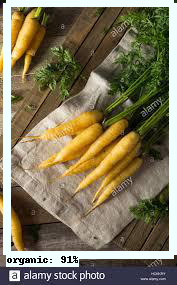

[0.905693   0.17095798 0.13072541 0.12652372 0.1195189  0.10058948
 0.09212703 0.08867899 0.07944372 0.07743651 0.07715981 0.06307963
 0.06134285 0.06051838 0.05864809 0.0567697  0.05540292 0.05519637
 0.05392007 0.05391403 0.05334753 0.05176583 0.04984667 0.04881255
 0.0480695  0.04770862 0.04715734 0.04688958 0.04592076 0.04591307
 0.04529118 0.04486215 0.04410128 0.04320358 0.04253981 0.04227574
 0.04177772 0.04164888 0.04093708 0.04055557 0.04041138 0.04007485
 0.04000695 0.03958797 0.03914449 0.03872592 0.038587   0.03823113
 0.03780593 0.03773535 0.03692758 0.03669674 0.03551977 0.03525839
 0.03510244 0.03493111 0.03460851 0.03410207 0.03374593 0.03359767
 0.03342593 0.03340262 0.03337175 0.03310307 0.03303204 0.03259425
 0.03218801 0.03210432 0.03185873 0.03153909 0.03093782 0.03086368
 0.03082496 0.03068866 0.03066207 0.03049161 0.03045645 0.02946107
 0.02938813 0.02907937 0.02907628 0.02880746 0.02835601 0.02833555
 0.02779645 0.02770634 0.02769663 0.02763567 0.02744223 0.0272

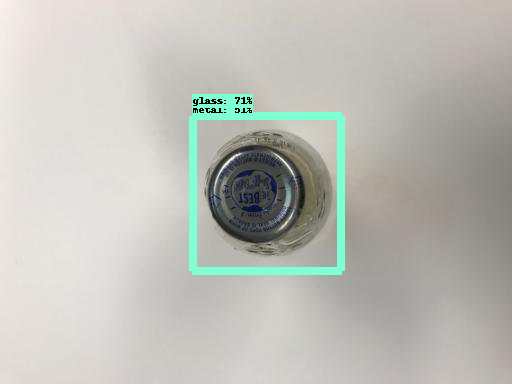

[0.7065306  0.50884295 0.26849747 0.15582494 0.13286881 0.12753402
 0.08055912 0.08013209 0.07806845 0.07198029 0.06438181 0.06230041
 0.05731181 0.05675013 0.05519681 0.05066331 0.0504933  0.05033122
 0.05022021 0.04929226 0.04786527 0.04723274 0.04546968 0.04478823
 0.04373804 0.04349839 0.04245956 0.04160632 0.04051258 0.04030653
 0.04002843 0.03951309 0.03887951 0.03877753 0.03828032 0.0377971
 0.03756108 0.03668588 0.03647085 0.03632509 0.0359816  0.03496366
 0.0348288  0.03444798 0.03429574 0.03399725 0.03381911 0.03272517
 0.03229321 0.03214432 0.03173891 0.03149828 0.03124895 0.03121092
 0.0311873  0.03111589 0.03093935 0.03087835 0.03084316 0.03024975
 0.03017909 0.03000322 0.02978118 0.02963322 0.02940803 0.02924739
 0.02919943 0.02911122 0.02911093 0.02866169 0.02861658 0.02860177
 0.02856644 0.02851862 0.02839821 0.0283443  0.02824714 0.02788276
 0.02778312 0.02773569 0.02770217 0.02758886 0.02750531 0.02746024
 0.02742923 0.02734598 0.02733215 0.02689835 0.02689629 0.02678

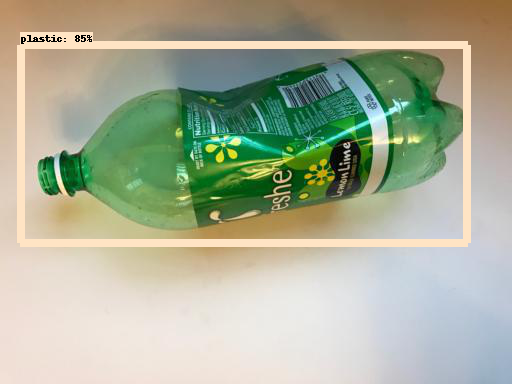

[0.8488795  0.12825899 0.11896576 0.11740726 0.10254762 0.09917422
 0.0975681  0.08189481 0.06430735 0.05862114 0.05274407 0.05197071
 0.05056215 0.04898535 0.0474742  0.04312184 0.04115606 0.03663575
 0.03618883 0.03594676 0.03503053 0.0343362  0.03413866 0.03397712
 0.03352946 0.0330148  0.03278826 0.03198501 0.03184474 0.03183441
 0.03118696 0.03105357 0.03087813 0.03082164 0.03080991 0.0301032
 0.02999294 0.02999283 0.02995904 0.0298541  0.02974725 0.02923018
 0.0292089  0.0289373  0.02867593 0.02866153 0.02852795 0.02813897
 0.02805508 0.0279157  0.02783458 0.02779499 0.0277458  0.02759262
 0.02754991 0.02724518 0.02705371 0.02673003 0.02664232 0.02638384
 0.0263757  0.02613959 0.02605098 0.02588863 0.02584764 0.02548452
 0.02547091 0.0252494  0.02517159 0.02515744 0.02506145 0.02497775
 0.0248741  0.02482582 0.02478718 0.0247159  0.0246225  0.0245441
 0.02419289 0.02418324 0.02403794 0.02401338 0.02390685 0.02382208
 0.02380183 0.02375755 0.02368952 0.0236738  0.02363801 0.023603

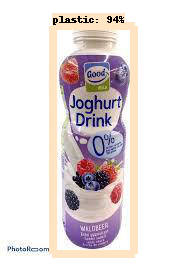

[0.94158965 0.39575663 0.38380986 0.23302905 0.18511073 0.18226671
 0.06249759 0.05443446 0.05009063 0.0467873  0.04638313 0.04577598
 0.04500423 0.04358491 0.0432795  0.04315471 0.04231553 0.04130921
 0.04098227 0.04090372 0.04082855 0.04030781 0.0398373  0.03977764
 0.03904343 0.0390045  0.03827576 0.03767707 0.03700986 0.03688512
 0.0367815  0.03668255 0.0364735  0.03601527 0.03533429 0.03528215
 0.03523163 0.0347398  0.0347333  0.03438093 0.03418398 0.03415954
 0.03404707 0.03398771 0.03370897 0.03346309 0.03334318 0.03310843
 0.03302233 0.03269451 0.03257065 0.03253068 0.03247555 0.03234207
 0.03210365 0.03149996 0.03129532 0.03118868 0.03029479 0.02969594
 0.0294416  0.02915288 0.02888314 0.02888064 0.02873849 0.0287321
 0.02845338 0.02843287 0.02837619 0.02795249 0.02785314 0.02773962
 0.02752146 0.0274899  0.02715615 0.02684396 0.02670061 0.02643588
 0.02639547 0.026336   0.0263073  0.02624366 0.02619439 0.02609467
 0.0260516  0.02586547 0.0256859  0.02532052 0.02522829 0.02519

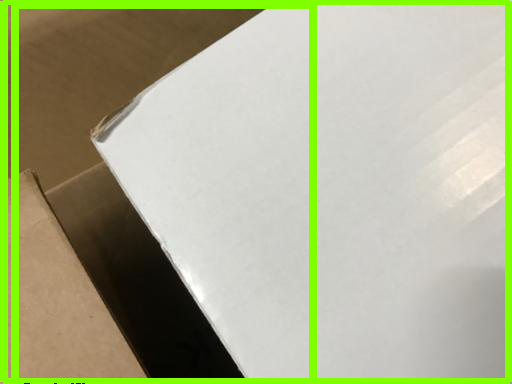

[0.74715585 0.6518148  0.4435188  0.32077095 0.25713888 0.2558384
 0.22996709 0.22921774 0.21714629 0.17589772 0.16366243 0.1518904
 0.13792205 0.13104124 0.13018592 0.12385186 0.12308156 0.11580694
 0.112137   0.10571072 0.10405114 0.10077287 0.09408926 0.08954569
 0.08818816 0.0862907  0.08121911 0.07897682 0.07586816 0.07567649
 0.07450069 0.07285843 0.07051722 0.06874223 0.06715106 0.06690791
 0.06576666 0.06329687 0.06170048 0.06113872 0.06100762 0.06095261
 0.06034563 0.05913852 0.05880199 0.05770195 0.05574258 0.05479915
 0.05477763 0.05314395 0.05288042 0.05250651 0.05166139 0.04892166
 0.04844128 0.04808897 0.04654291 0.04617997 0.04595836 0.04572006
 0.0454379  0.0451787  0.04494042 0.04485043 0.04483458 0.04439672
 0.04396644 0.04366823 0.04253767 0.04223885 0.04206394 0.04155687
 0.04129288 0.04110992 0.0410613  0.04081383 0.04033399 0.03987253
 0.03981264 0.03835174 0.03824891 0.03741553 0.03695596 0.03658151
 0.03631188 0.03618252 0.03617042 0.03595493 0.03595405 0.035715

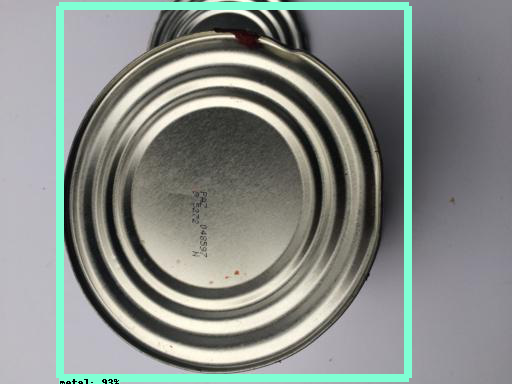

[0.9289231  0.11202742 0.10914476 0.10140867 0.08269753 0.08255146
 0.04977296 0.04954201 0.04707768 0.04372018 0.04025586 0.03413512
 0.03318789 0.03280989 0.03231404 0.03215054 0.03129309 0.02948085
 0.02894268 0.027887   0.02776619 0.02712213 0.02692982 0.02682499
 0.02642847 0.02585103 0.02435613 0.02433277 0.02404906 0.02391397
 0.02391334 0.0237823  0.02364831 0.02340563 0.02319692 0.02316684
 0.02284699 0.02231751 0.02229244 0.02227505 0.02215697 0.02215432
 0.02205553 0.02175867 0.02172632 0.02167056 0.02136717 0.02116102
 0.02104903 0.02101216 0.0206154  0.02051762 0.02049078 0.02019498
 0.02018489 0.02009972 0.02009022 0.01997843 0.01988576 0.01938402
 0.0192316  0.01916213 0.01891414 0.01880727 0.01858952 0.01852078
 0.01847431 0.01838082 0.01837951 0.01827741 0.01824932 0.01823046
 0.01815869 0.0180902  0.01803449 0.01794298 0.01790858 0.01787531
 0.01763291 0.01762716 0.01742963 0.01722001 0.01721389 0.01710098
 0.01708218 0.01691851 0.0168602  0.0167963  0.01663566 0.0165

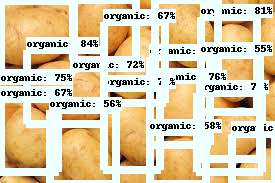

[0.83808374 0.8052683  0.79454714 0.79045993 0.76045436 0.7461946
 0.7231441  0.7072265  0.67073524 0.6657017  0.58197975 0.5785012
 0.5620449  0.5461802  0.496797   0.45588875 0.4200694  0.37232748
 0.35718003 0.3563501  0.3464024  0.34474874 0.3371652  0.3365578
 0.32499608 0.3154887  0.3041525  0.29945517 0.29600698 0.2929212
 0.2838575  0.2742796  0.26921293 0.26810932 0.264164   0.2614303
 0.25629607 0.25288016 0.2513246  0.24422462 0.23641708 0.2358192
 0.23579137 0.23160931 0.22896503 0.22754538 0.22102086 0.21918789
 0.21696994 0.21647409 0.21197477 0.20672512 0.20531881 0.20459692
 0.20244087 0.20117183 0.20079477 0.2002979  0.19995372 0.19882928
 0.19743787 0.19305348 0.19279344 0.19251722 0.19233146 0.18982549
 0.18653145 0.18482023 0.18477386 0.18440935 0.18208352 0.18179755
 0.1809805  0.18081775 0.17878121 0.17846005 0.17596677 0.17577155
 0.17576592 0.17469347 0.17169315 0.17145388 0.17103514 0.16969427
 0.16967802 0.16937499 0.16936484 0.16803087 0.16706017 0.1668229
 0

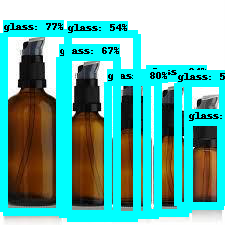

[0.8409727  0.7999224  0.7700667  0.6691118  0.54753757 0.5417572
 0.50246    0.3523973  0.33282572 0.2792756  0.2754687  0.23611546
 0.23181131 0.20206213 0.19011521 0.16282743 0.15791798 0.1523873
 0.14681527 0.146286   0.14464949 0.13999799 0.1376422  0.13050306
 0.13032833 0.1287711  0.11847446 0.11545467 0.11504365 0.11117175
 0.11079477 0.10999876 0.10550708 0.10540833 0.09991746 0.09449447
 0.09316017 0.09224893 0.08976536 0.08912498 0.08780847 0.08658348
 0.08529986 0.08344234 0.08335052 0.08144738 0.08053777 0.0804445
 0.08042732 0.07999052 0.07660763 0.07616456 0.07615626 0.0754959
 0.07543809 0.07318567 0.07272616 0.0725642  0.07180165 0.07179593
 0.07127469 0.06981808 0.06890874 0.0680688  0.06676276 0.0663015
 0.06489348 0.06267969 0.06194597 0.06185536 0.06147256 0.06112311
 0.06107261 0.0602321  0.05973937 0.05879851 0.05836601 0.05790159
 0.05709866 0.05616981 0.05503288 0.05484155 0.05374151 0.05227426
 0.05104839 0.05092632 0.04964818 0.04959692 0.0495662  0.04887417


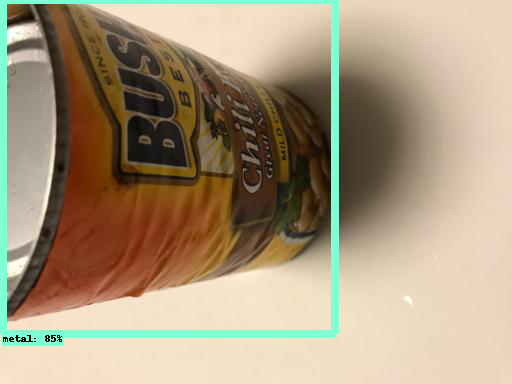

[0.848772   0.27820358 0.1860773  0.14927305 0.14490595 0.08240207
 0.0720835  0.06432837 0.05862781 0.05592771 0.05563479 0.05508978
 0.05439144 0.04883204 0.04871333 0.04838832 0.04714552 0.04641009
 0.04490503 0.04232408 0.04226799 0.04109482 0.04008544 0.03967945
 0.03936258 0.03903702 0.03822657 0.03470383 0.03465284 0.03279458
 0.03237484 0.03200545 0.03086498 0.02889183 0.02886357 0.02849792
 0.02845178 0.02837149 0.02765473 0.02765251 0.02734097 0.02730726
 0.0272834  0.02648729 0.02647509 0.0260629  0.02600992 0.02594412
 0.02589913 0.02580984 0.02569418 0.02569307 0.02561766 0.02556663
 0.02521031 0.02465563 0.02459538 0.02416181 0.02405756 0.02383897
 0.02382452 0.02341807 0.02317107 0.02304845 0.0230154  0.02283929
 0.02272204 0.02267804 0.02264213 0.02244176 0.02238772 0.02229475
 0.02218569 0.02210462 0.02197387 0.02155947 0.02124324 0.02123058
 0.02121353 0.02120264 0.02111069 0.02104996 0.02091011 0.02085633
 0.02083268 0.02073694 0.02067332 0.02056825 0.0205423  0.0203

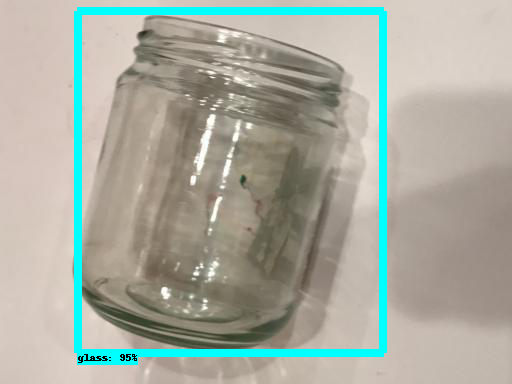

[0.9488477  0.10380132 0.10305239 0.10143342 0.07719018 0.07596465
 0.06916703 0.06871414 0.06193748 0.06124179 0.06022267 0.05611188
 0.05169228 0.04993699 0.04728375 0.04445115 0.04440458 0.04336947
 0.04099552 0.04095604 0.04092943 0.04057961 0.03882328 0.03458833
 0.0341239  0.03354274 0.03306202 0.03263194 0.03229884 0.0314591
 0.03141142 0.03109568 0.03071012 0.03055514 0.03013999 0.02880365
 0.02840497 0.02800727 0.02773014 0.02759487 0.02748921 0.02715268
 0.02709165 0.02682534 0.02593908 0.02527435 0.02499721 0.02482823
 0.02479606 0.0247118  0.02450137 0.02444214 0.0244159  0.02436424
 0.02388152 0.02295593 0.02228081 0.02221338 0.02190218 0.02186394
 0.02154803 0.02126932 0.02125255 0.02091971 0.02076598 0.02055475
 0.02053037 0.02050989 0.02049221 0.02044748 0.02036131 0.02022347
 0.02019267 0.02008729 0.0200547  0.01969902 0.01968447 0.01963605
 0.01953224 0.01932091 0.01929642 0.01929414 0.0191127  0.01905598
 0.01905141 0.01898734 0.018851   0.01869392 0.01864863 0.01858

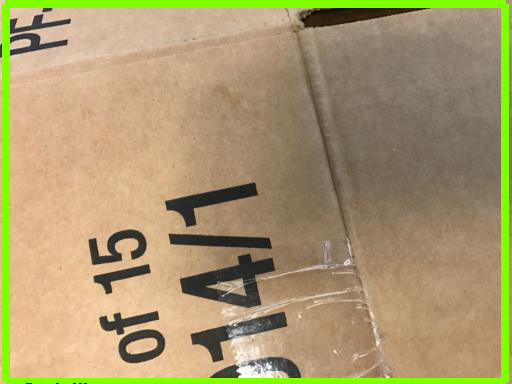

[0.92853737 0.12290191 0.11585959 0.09256352 0.08248259 0.07304672
 0.07179179 0.07025319 0.06927115 0.06600556 0.06310457 0.06065071
 0.06034414 0.05668778 0.05215083 0.0516982  0.0450465  0.04472712
 0.04443527 0.04181551 0.04090134 0.03917741 0.03914776 0.03821902
 0.03751735 0.03730076 0.03607556 0.03541127 0.03482474 0.03416247
 0.03410563 0.03390533 0.0338876  0.0336055  0.03330336 0.03253525
 0.03238717 0.03235824 0.03224712 0.03204051 0.03188503 0.03163369
 0.03161005 0.03140991 0.03136427 0.03082203 0.03074688 0.03074558
 0.03061534 0.03039064 0.0303604  0.03011263 0.02915202 0.02911532
 0.02896056 0.02836872 0.02828149 0.02779366 0.02776185 0.02730061
 0.02727543 0.027182   0.02688321 0.02661039 0.02652585 0.02645396
 0.02639428 0.02637878 0.02631753 0.02619835 0.02617427 0.02607903
 0.02606859 0.02606854 0.02605112 0.02549755 0.02545555 0.02495786
 0.02494304 0.02478208 0.02466753 0.02460701 0.02455878 0.02443263
 0.02434153 0.02403868 0.02384398 0.0235298  0.02331785 0.0232

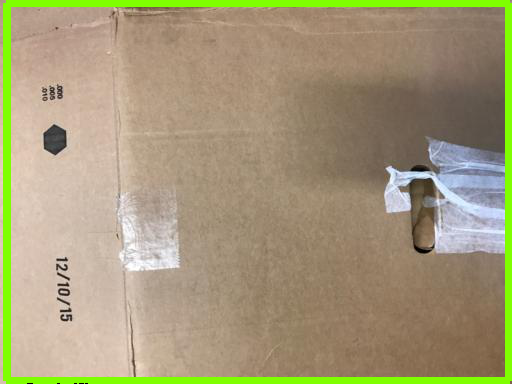

[0.8474258  0.4240299  0.27662432 0.2603853  0.2510431  0.22431478
 0.19229835 0.16894129 0.16844127 0.15555881 0.15454671 0.14222428
 0.10983504 0.10250901 0.08522345 0.07885823 0.07878903 0.074953
 0.06942815 0.06772073 0.06622389 0.06591667 0.06557683 0.06556354
 0.06171881 0.06165661 0.06115118 0.05821853 0.05811471 0.05739331
 0.0571278  0.05661148 0.05544711 0.05537185 0.05492056 0.05451829
 0.05264633 0.05261817 0.05217835 0.05191001 0.05181409 0.05107421
 0.04982345 0.04852219 0.04814626 0.04541712 0.04468272 0.04369075
 0.04335231 0.04237102 0.04213428 0.04188453 0.04183387 0.04092383
 0.04055097 0.03910882 0.03892474 0.03879781 0.0387553  0.03843249
 0.03728945 0.03721635 0.03706711 0.03671328 0.03647555 0.03627468
 0.03473734 0.03466728 0.03412195 0.03408799 0.0339644  0.03370754
 0.03351564 0.03336399 0.03297438 0.03296136 0.03251954 0.03204837
 0.03196999 0.03184547 0.03159215 0.03136608 0.03114579 0.03112165
 0.0306976  0.03068952 0.03052417 0.03025066 0.03020223 0.030100

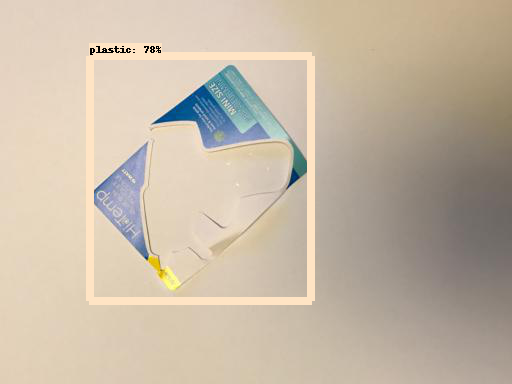

[0.7796501  0.34421524 0.15538365 0.1460763  0.13017178 0.11293989
 0.09853863 0.09163569 0.07996621 0.07650642 0.07323244 0.07135981
 0.06170885 0.0592009  0.05909507 0.056311   0.05616975 0.05615807
 0.05382926 0.04902234 0.04857633 0.04825142 0.04764602 0.04732144
 0.04681396 0.04131129 0.04128898 0.04077768 0.03908673 0.03900326
 0.03887727 0.03766451 0.03740946 0.03734989 0.0368625  0.03478939
 0.03395544 0.03361835 0.03347086 0.03315761 0.03308956 0.03280986
 0.0327697  0.03266596 0.03230795 0.03219719 0.0319739  0.03188805
 0.03178635 0.03126397 0.03107888 0.03074164 0.03070458 0.03061699
 0.03039732 0.03014473 0.02981687 0.02971351 0.02911006 0.02851203
 0.0282093  0.02791733 0.0277066  0.0277037  0.02768625 0.0276539
 0.02763645 0.02737008 0.02729619 0.02726073 0.02688221 0.02687217
 0.02678609 0.02677897 0.02673982 0.0267018  0.02630976 0.02620855
 0.02596743 0.02589624 0.02587215 0.02580033 0.02573093 0.02569176
 0.02555593 0.02545556 0.02530845 0.02498255 0.024847   0.02461

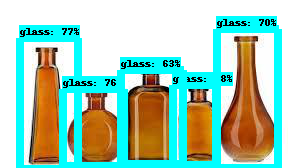

[0.7813142  0.7717175  0.76001495 0.6957808  0.63393056 0.39711636
 0.28831497 0.24944216 0.22180977 0.17819129 0.17523612 0.16430204
 0.16337764 0.16309436 0.14728425 0.14242578 0.13321748 0.12926637
 0.12510093 0.12270293 0.12153789 0.11166375 0.10941936 0.10715146
 0.10513714 0.10494436 0.10089152 0.10016667 0.0995155  0.09773123
 0.09710352 0.09568666 0.09420504 0.09343536 0.08464314 0.08347209
 0.08071431 0.08044772 0.07976966 0.07778371 0.07548644 0.07240143
 0.07196056 0.07158625 0.06813716 0.06748258 0.06674363 0.06637669
 0.06612007 0.0660189  0.06495646 0.06476182 0.0647444  0.06173328
 0.06168265 0.05657824 0.05581134 0.05503071 0.05312455 0.04972323
 0.04949905 0.04919088 0.04913164 0.04898714 0.04878523 0.04876522
 0.04791073 0.04740363 0.04727642 0.0469204  0.04579043 0.04556039
 0.04553341 0.04239623 0.0422982  0.04208976 0.04167881 0.04163192
 0.04107431 0.04049068 0.04037942 0.04030716 0.03931788 0.03910531
 0.03897918 0.03887469 0.03872208 0.03869942 0.03811541 0.0379

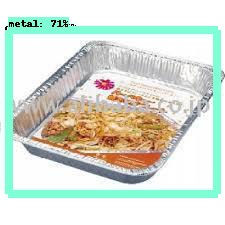

[0.7490427  0.707715   0.16250363 0.1550306  0.11382683 0.0762994
 0.06804036 0.06653353 0.05875212 0.05682673 0.04993431 0.04981131
 0.04909251 0.04906052 0.04662796 0.04550895 0.04519312 0.04485463
 0.04454147 0.04413677 0.04366    0.04329284 0.04297189 0.04241368
 0.04116324 0.04113201 0.04089584 0.04060075 0.04059554 0.04034852
 0.04031493 0.0401192  0.03988813 0.03941962 0.03941428 0.0392419
 0.03904544 0.03901274 0.03845903 0.0379944  0.0378763  0.03691969
 0.03637997 0.03628323 0.03524932 0.03499776 0.03480183 0.03475823
 0.03417227 0.03414622 0.03407701 0.03394664 0.03381725 0.03368391
 0.03329455 0.03291805 0.03278787 0.03215617 0.03173979 0.03101748
 0.0307035  0.03045444 0.03026356 0.02967507 0.02920687 0.02908908
 0.02893093 0.02886557 0.02872622 0.02870448 0.0284726  0.0283987
 0.02839329 0.02830902 0.02826785 0.02823005 0.0280876  0.02800847
 0.02799097 0.02796414 0.02795067 0.0275664  0.02753973 0.0274737
 0.027261   0.02702024 0.02694871 0.02690963 0.02681936 0.02657335

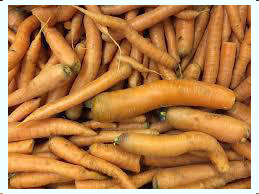

[0.9456775  0.2747651  0.22571366 0.20612124 0.20047575 0.188781
 0.15423621 0.14449702 0.14400169 0.140376   0.12758024 0.12100186
 0.1190457  0.11749601 0.11700352 0.11555838 0.11018109 0.10695773
 0.1059728  0.10208967 0.09786597 0.09751679 0.09581906 0.08851782
 0.08662242 0.08581877 0.08516606 0.08446677 0.08410926 0.08252224
 0.08158515 0.08135948 0.08092262 0.08064743 0.08014143 0.07912561
 0.07904861 0.07742684 0.07716538 0.07669621 0.07546344 0.07532864
 0.07519553 0.0724308  0.07221423 0.07180571 0.07105886 0.07103647
 0.07076748 0.07038967 0.06987712 0.06688827 0.06585517 0.0651918
 0.06477389 0.06452388 0.06303403 0.06299305 0.06297464 0.06220992
 0.06188989 0.06172363 0.06087642 0.06034488 0.05941757 0.05909329
 0.0588691  0.05872126 0.05797737 0.05734821 0.05687115 0.0567585
 0.05657942 0.05643747 0.05623569 0.05574415 0.05556666 0.05494895
 0.05470948 0.05460329 0.05429781 0.05379887 0.05289669 0.05263964
 0.05243202 0.05165126 0.05100887 0.05069524 0.05038944 0.04929974

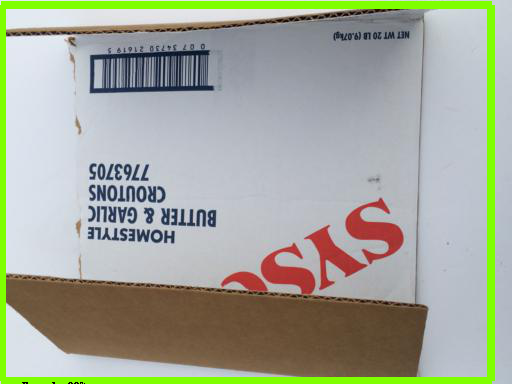

[0.86183023 0.34964067 0.2617975  0.19343776 0.09739241 0.08675981
 0.07404298 0.06811933 0.05271984 0.05142184 0.05041329 0.04923172
 0.04699766 0.0456293  0.04287601 0.042055   0.0396651  0.03776312
 0.0377144  0.03740045 0.03642191 0.03595007 0.03569588 0.0333421
 0.03329267 0.03276255 0.03249443 0.03233382 0.03224299 0.03215462
 0.03172304 0.0317024  0.03104729 0.03097827 0.03027115 0.03021749
 0.03011726 0.02989149 0.02985864 0.0294401  0.02847246 0.02838939
 0.02818295 0.02802921 0.02795352 0.02738113 0.02725711 0.02718585
 0.02714684 0.02655208 0.02636763 0.02633559 0.02633271 0.02587516
 0.02575371 0.02563503 0.02532849 0.02491236 0.02466578 0.02455093
 0.0243017  0.02418409 0.02405366 0.02401547 0.02383516 0.02373776
 0.0237199  0.02363312 0.02344482 0.02321986 0.02317786 0.02304402
 0.02296945 0.02274677 0.02268276 0.02265148 0.02262309 0.02239882
 0.0220383  0.02192696 0.02190767 0.021887   0.02178608 0.02111046
 0.02107474 0.02106638 0.02096693 0.02085163 0.02073897 0.02034

In [ ]:
import ntpath
import pandas as pd
from pathlib import Path
import six


testcsv_path = Path(gdrive_path, 'test_result/predict_result.csv')

if testcsv_path.is_file():
    f = open(testcsv_path, "w+")
    with open(testcsv_path, 'a', newline='') as file:
        file.truncate(0)
        writer = csv.writer(file)
        writer.writerow(["image_name", "acutal_class", "predicted_class","predicted_confidence","correct"])

    f.close()    
else:
    with open(testcsv_path, 'w', newline = '') as file:
        writer = csv.writer(file)
        writer.writerow(["image_name", "acutal_class", "predicted_class","predicted_confidence","correct"])

predicted_class = [];
predicted_confidence = [];
imgnamelist = [];
acutal_class = [];

for image_path in glob.glob('/content/drive/MyDrive/GarbageClassification/dataset_withO/image/test/*.jpg'):
  image_np = load_image_into_numpy_array(image_path)
  output_dict = run_inference_for_single_image(model, image_np)
  if output_dict['detection_classes'][0] in six.viewkeys(category_index):
    result_class = category_index[output_dict['detection_classes'][0]]['name']
    result_confidence = '{}%'.format(int(100 * output_dict['detection_scores'][0]))
    predicted_class.append(result_class)
    predicted_confidence.append(result_confidence)
  imgname = ntpath.basename(image_path)
  imgnamelist.append(imgname)
  test_record_csv = csv.reader(open('/content/drive/MyDrive/GarbageClassification/dataset_withO/csv/test_tfcsv.csv', "r", encoding='utf-8'), delimiter=",")
  for row in test_record_csv:
    #if current rows 2nd value is equal to input, print that row
    if str(imgname) == str(row[0]):
      print(row[0])
      print(imgname == row[0])
      actualimgclass = row[3]
      acutal_class.append(actualimgclass)
  if actualimgclass == result_class:
    correct = 1
  else:
    correct = 0
  with open(testcsv_path, 'a', newline = '') as file:
    writer = csv.writer(file)
    writer.writerow([imgname, actualimgclass, result_class, result_confidence,correct])
    file.close()

  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)
  display(Image.fromarray(image_np))
  print(output_dict['detection_scores'])


In [ ]:
print(output_dict['detection_scores'])

[0.7853466  0.34338203 0.31912273 0.29789293 0.1987635  0.12014142
 0.10635038 0.09297409 0.08944117 0.07591347 0.06747946 0.06579514
 0.06283499 0.05851369 0.0572906  0.05549347 0.05457848 0.04731362
 0.04557684 0.04407731 0.04390258 0.04278567 0.04271456 0.04245731
 0.04236815 0.0407364  0.04012333 0.04007063 0.03999527 0.03944959
 0.03922865 0.038495   0.0383814  0.03758775 0.03728344 0.03700802
 0.03679036 0.03661132 0.03637133 0.03546767 0.03525874 0.03410267
 0.03361417 0.03332796 0.03290266 0.03261347 0.03191865 0.0317899
 0.03121148 0.03081889 0.03031431 0.03025176 0.03009254 0.02997788
 0.02990504 0.02986025 0.02973791 0.02922899 0.02892546 0.02891792
 0.02887801 0.02881332 0.02846079 0.02842423 0.02819868 0.02806844
 0.02803409 0.0278242  0.02770327 0.02758127 0.02725392 0.02698923
 0.02688047 0.02673219 0.02646456 0.02632945 0.02618821 0.02543491
 0.02531937 0.02518494 0.02514312 0.02513971 0.02513582 0.02494446
 0.02475813 0.02472482 0.02465246 0.02441465 0.02439446 0.02349

In [ ]:
print(imgname)
print(type(imgname))
print(ntpath.basename(image_path))
print(acutal_class)
pathtest = '/content/drive/MyDrive/GarbageClassification/dataset2/data/test_image/brown-glass211.jpg'
print(ntpath.basename(pathtest))

white-glass206.jpg
<class 'str'>
white-glass206.jpg
['glass']
brown-glass211.jpg


In [ ]:
# !python /content/models/research/object_detection/model_main_tf2.py \
#     --pipeline_config_path=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/pipeline.config \
#     --model_dir=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/trained_ssd_resnet50 \
#     --checkpoint_dir=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/trained_ssd_resnet50

In [ ]:
# !python /content/models/research/object_detection/model_main_tf2.py \
#     --pipeline_config_path=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/pipeline.config \
#     --model_dir=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/trained_ssd_resnet50 \

In [ ]:
# #install tensorflow 1.15
# !pip install tensorflow==1.15
# #Check tensorflow version
# import tensorflow as tf
# print(tf.__version__)

In [ ]:
# !git clone --q https://github.com/tensorflow/models.git

In [ ]:
# #navigate to /models/research folder to compile protos
# %cd models/research
# # Compile protos.
# !protoc object_detection/protos/*.proto --python_out=.
# # Install TensorFlow Object Detection API.
# !cp object_detection/packages/tf1/setup.py .
# !python -m pip install .

In [ ]:
# !python object_detection/builders/model_builder_tf1_test.py